## Serology dataset analysis

Questions:
- Which antigen/secondary antibody combinations individually provide the best discrimination between positive and negative patients?
- Do patients give similar readings across all assays, or is there variation? In other words, do different assays provide the same or different information?
- Do multiple antigen/secondary antibody combinations provide a better discrimination between positive and negative patients in comparison to individual assays?
- Are there any variables that correlate with severity of disease in positive patients?

In [1]:
import copy
import math
import pickle
import random
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from collections import OrderedDict
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline
from imblearn.under_sampling import RandomUnderSampler
from itertools import combinations
from mlxtend.evaluate import combined_ftest_5x2cv
from scipy.stats import boxcox, f_oneway, gaussian_kde, kendalltau, pearsonr, shapiro
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.decomposition import PCA
from sklearn.ensemble import AdaBoostClassifier, AdaBoostRegressor, ExtraTreesClassifier, RandomForestClassifier
from sklearn.feature_selection import SelectKBest, SequentialFeatureSelector, mutual_info_classif, mutual_info_regression
from sklearn.inspection import permutation_importance
from sklearn.manifold import Isomap, LocallyLinearEmbedding
from sklearn.metrics import make_scorer, mean_squared_error, roc_auc_score
from sklearn.model_selection import GridSearchCV, KFold, StratifiedKFold
from sklearn.preprocessing import MinMaxScaler
from sklearn.svm import LinearSVC
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.diagnostic import lilliefors

Parse in threshold data

In [2]:
thresh_df = pd.read_excel(
    'Threshold_set_summary_LIPS_ELISA_2021_03.xlsx', sheet_name='Full Threshold set', engine='openpyxl'
)

In [3]:
thresh_df

,Original ID,THS ID,TS ID,Sample Date,Sample type,Status,Severity Grade 2,Symptoms,Time since symptom onset,Collection,...,ELISA Spike Pan Norm,ELISA N IgG Norm,ELISA RBD IgG Norm,ELISA Spike IgG Norm,ELISA N IgA Norm,ELISA RBD IgA Norm,ELISA Spike IgA Norm,ELISA N IgM Norm,ELISA RBD IgM Norm,ELISA Spike IgM Norm
0,BLD380707B,ThS_075,NaN,1998-10-26,Serum,Pre-pandemic,NaN,NaN,NaN,1998 Blood Donors,...,0.147037,NaN,NaN,NaN,0.053433,0.396779,0.238757,0.547077,0.147602,0.384084
1,BLD3807089,ThS_162,NaN,1998-10-26,Serum,Pre-pandemic,NaN,NaN,NaN,1998 Blood Donors,...,0.486442,NaN,NaN,NaN,0.152120,0.349786,0.213396,0.294881,0.088639,0.279376
2,BLD3807097,ThS_293,NaN,1998-10-26,Serum,Pre-pandemic,NaN,NaN,NaN,1998 Blood Donors,...,0.193253,NaN,NaN,NaN,0.178288,0.418810,0.102002,0.994225,0.128987,0.309041
3,BLD380712H,ThS_037,NaN,1998-10-26,Serum,Pre-pandemic,NaN,NaN,NaN,1998 Blood Donors,...,0.228985,NaN,NaN,NaN,0.052321,0.210072,0.065641,0.505457,0.092165,0.279201
4,BLD380715B,ThS_004,NaN,1998-10-26,Serum,Pre-pandemic,NaN,NaN,NaN,1998 Blood Donors,...,0.127660,NaN,NaN,NaN,0.536109,0.496763,0.351064,0.367667,0.057040,0.181236
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
448,20V60026746,ThS_110,NaN,2020-05-04,Plasma,Clinically suspected,"Hospitalised, required ventialory support",Yes,21,Discover Plasma,...,1.035171,NaN,NaN,NaN,1.899695,1.152985,1.016807,1.631273,0.227221,0.991641
449,20V60024695,ThS_014,NaN,2020-05-04,Plasma,PCR confirmed,Died,Yes,26,Discover Plasma,...,0.984479,NaN,NaN,NaN,1.763080,1.843525,1.122680,1.755798,0.945962,1.057272
450,20V60030049,ThS_121,NaN,2020-06-11,Plasma,PCR confirmed,"Hospitalised, required ventialory support",Yes,44,Discover Plasma,...,1.003745,NaN,NaN,NaN,1.457683,1.774840,1.091591,1.763433,0.601476,0.807185
451,20V60028207,ThS_232,NaN,2020-05-12,Plasma,PCR confirmed,NaN,Yes,ND,Discover Plasma,...,0.875222,NaN,NaN,NaN,2.240031,0.725000,1.162952,1.239224,1.213671,1.323004


In [4]:
thresh_df = thresh_df.iloc[0:(thresh_df.shape[0]-1)]

In [5]:
thresh_df

,Original ID,THS ID,TS ID,Sample Date,Sample type,Status,Severity Grade 2,Symptoms,Time since symptom onset,Collection,...,ELISA Spike Pan Norm,ELISA N IgG Norm,ELISA RBD IgG Norm,ELISA Spike IgG Norm,ELISA N IgA Norm,ELISA RBD IgA Norm,ELISA Spike IgA Norm,ELISA N IgM Norm,ELISA RBD IgM Norm,ELISA Spike IgM Norm
0,BLD380707B,ThS_075,NaN,1998-10-26,Serum,Pre-pandemic,NaN,NaN,NaN,1998 Blood Donors,...,0.147037,NaN,NaN,NaN,0.053433,0.396779,0.238757,0.547077,0.147602,0.384084
1,BLD3807089,ThS_162,NaN,1998-10-26,Serum,Pre-pandemic,NaN,NaN,NaN,1998 Blood Donors,...,0.486442,NaN,NaN,NaN,0.152120,0.349786,0.213396,0.294881,0.088639,0.279376
2,BLD3807097,ThS_293,NaN,1998-10-26,Serum,Pre-pandemic,NaN,NaN,NaN,1998 Blood Donors,...,0.193253,NaN,NaN,NaN,0.178288,0.418810,0.102002,0.994225,0.128987,0.309041
3,BLD380712H,ThS_037,NaN,1998-10-26,Serum,Pre-pandemic,NaN,NaN,NaN,1998 Blood Donors,...,0.228985,NaN,NaN,NaN,0.052321,0.210072,0.065641,0.505457,0.092165,0.279201
4,BLD380715B,ThS_004,NaN,1998-10-26,Serum,Pre-pandemic,NaN,NaN,NaN,1998 Blood Donors,...,0.127660,NaN,NaN,NaN,0.536109,0.496763,0.351064,0.367667,0.057040,0.181236
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
447,20V60048685,ThS_328,NaN,2020-06-01,Plasma,PCR confirmed,"Hospitalised, no ventilatory support",Yes,9,Discover Plasma,...,0.825579,NaN,NaN,NaN,0.902701,2.266276,1.468620,0.887706,0.300747,0.498769
448,20V60026746,ThS_110,NaN,2020-05-04,Plasma,Clinically suspected,"Hospitalised, required ventialory support",Yes,21,Discover Plasma,...,1.035171,NaN,NaN,NaN,1.899695,1.152985,1.016807,1.631273,0.227221,0.991641
449,20V60024695,ThS_014,NaN,2020-05-04,Plasma,PCR confirmed,Died,Yes,26,Discover Plasma,...,0.984479,NaN,NaN,NaN,1.763080,1.843525,1.122680,1.755798,0.945962,1.057272
450,20V60030049,ThS_121,NaN,2020-06-11,Plasma,PCR confirmed,"Hospitalised, required ventialory support",Yes,44,Discover Plasma,...,1.003745,NaN,NaN,NaN,1.457683,1.774840,1.091591,1.763433,0.601476,0.807185


In [6]:
thresh_df.columns

Index(['Original ID', 'THS ID', 'TS ID', 'Sample Date', 'Sample type',
       'Status', 'Severity Grade 2', 'Symptoms', 'Time since symptom onset',
       'Collection', 'Age group', 'Age', 'Sex', 'Lab ID_1', 'Lab ID_2',
       'Lab ID_3', 'Comment', 'Threshold', 'LIPS Average Bridging',
       'LIPS Average IgG', 'LIPS Average IgA', 'LIPS Average IgM',
       'ELISA Set ID check', 'ELISA Threshold Status', 'ELISA N Pan Norm',
       'ELISA RBD Pan Norm', 'ELISA Spike Pan Norm', 'ELISA N IgG Norm',
       'ELISA RBD IgG Norm', 'ELISA Spike IgG Norm', 'ELISA N IgA Norm',
       'ELISA RBD IgA Norm', 'ELISA Spike IgA Norm', 'ELISA N IgM Norm',
       'ELISA RBD IgM Norm', 'ELISA Spike IgM Norm'],
      dtype='object')

In [7]:
thresh_keep_cols = ['Sample type', 'Status', 'Severity Grade 2', 'Symptoms', 'Time since symptom onset',
                    'Collection', 'Age group', 'Age', 'Sex', 'Comment', 'LIPS Average Bridging',
                    'LIPS Average IgG', 'LIPS Average IgA', 'LIPS Average IgM', 'ELISA N Pan Norm',
                    'ELISA RBD Pan Norm', 'ELISA Spike Pan Norm', 'ELISA N IgG Norm', 'ELISA RBD IgG Norm',
                    'ELISA Spike IgG Norm', 'ELISA N IgA Norm', 'ELISA RBD IgA Norm', 'ELISA Spike IgA Norm',
                    'ELISA N IgM Norm', 'ELISA RBD IgM Norm', 'ELISA Spike IgM Norm']
thresh_cont_cols = ['LIPS Average Bridging', 'LIPS Average IgG', 'LIPS Average IgA', 'LIPS Average IgM',
                    'ELISA N Pan Norm', 'ELISA RBD Pan Norm', 'ELISA Spike Pan Norm', 'ELISA N IgG Norm',
                    'ELISA RBD IgG Norm', 'ELISA Spike IgG Norm', 'ELISA N IgA Norm', 'ELISA RBD IgA Norm',
                    'ELISA Spike IgA Norm', 'ELISA N IgM Norm', 'ELISA RBD IgM Norm', 'ELISA Spike IgM Norm']
thresh_disc_cols = ['Sample type', 'Severity Grade 2', 'Symptoms', 'Time since symptom onset', 'Collection',
                    'Age group', 'Age', 'Sex', 'Comment']
thresh_output_cols = ['Status']

In [8]:
thresh_df = thresh_df[thresh_keep_cols]

In [9]:
thresh_df

,Sample type,Status,Severity Grade 2,Symptoms,Time since symptom onset,Collection,Age group,Age,Sex,Comment,...,ELISA Spike Pan Norm,ELISA N IgG Norm,ELISA RBD IgG Norm,ELISA Spike IgG Norm,ELISA N IgA Norm,ELISA RBD IgA Norm,ELISA Spike IgA Norm,ELISA N IgM Norm,ELISA RBD IgM Norm,ELISA Spike IgM Norm
0,Serum,Pre-pandemic,NaN,NaN,NaN,1998 Blood Donors,Adult,40.257357974,M,Threshold set,...,0.147037,NaN,NaN,NaN,0.053433,0.396779,0.238757,0.547077,0.147602,0.384084
1,Serum,Pre-pandemic,NaN,NaN,NaN,1998 Blood Donors,Adult,65.029431896,M,Threshold set,...,0.486442,NaN,NaN,NaN,0.152120,0.349786,0.213396,0.294881,0.088639,0.279376
2,Serum,Pre-pandemic,NaN,NaN,NaN,1998 Blood Donors,Adult,57.278576318,F,Threshold set,...,0.193253,NaN,NaN,NaN,0.178288,0.418810,0.102002,0.994225,0.128987,0.309041
3,Serum,Pre-pandemic,NaN,NaN,NaN,1998 Blood Donors,Adult,45.905544148,F,Threshold set,...,0.228985,NaN,NaN,NaN,0.052321,0.210072,0.065641,0.505457,0.092165,0.279201
4,Serum,Pre-pandemic,NaN,NaN,NaN,1998 Blood Donors,Adult,54.116358658,F,Threshold set,...,0.127660,NaN,NaN,NaN,0.536109,0.496763,0.351064,0.367667,0.057040,0.181236
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
447,Plasma,PCR confirmed,"Hospitalised, no ventilatory support",Yes,9,Discover Plasma,Adult,42,M,Threshold set,...,0.825579,NaN,NaN,NaN,0.902701,2.266276,1.468620,0.887706,0.300747,0.498769
448,Plasma,Clinically suspected,"Hospitalised, required ventialory support",Yes,21,Discover Plasma,Adult,61,F,Threshold set,...,1.035171,NaN,NaN,NaN,1.899695,1.152985,1.016807,1.631273,0.227221,0.991641
449,Plasma,PCR confirmed,Died,Yes,26,Discover Plasma,Adult,66,M,Threshold set,...,0.984479,NaN,NaN,NaN,1.763080,1.843525,1.122680,1.755798,0.945962,1.057272
450,Plasma,PCR confirmed,"Hospitalised, required ventialory support",Yes,44,Discover Plasma,Adult,50,M,Threshold set,...,1.003745,NaN,NaN,NaN,1.457683,1.774840,1.091591,1.763433,0.601476,0.807185


Parse in validation data

In [10]:
val_df = pd.read_excel('Validation_set_2021_30.xlsx', sheet_name='in', engine='openpyxl')

In [11]:
val_df

,Unique ID,Original Sample ID,Sample Date,Included,CMM Code,DM Code,Match,Study Number,Sample Date.1,Status,...,C19 IgA LIPS Date,LIPSIgA_98th,LIPSIgA_99th,LIPSIgA_Jmax,C19 IgM LIPS LU Units,C19 IgM LIPS Date,LIPSIgM_98th,LIPSIgM_99th,LIPSIgM_Jmax,Bridging comment
0,599_T2,599,2020-08-06,Yes,54.0,98.0,True,599,2020-06-08 00:00:00,COVID-19,...,30/11/2020,1.0,1.0,1.0,10.753943,NaT,0.0,0.0,1.0,NaN
1,585_T2,585,2020-08-06,Yes,119.0,97.0,True,585,2020-06-08 00:00:00,COVID-19,...,2020-01-12 00:00:00,1.0,1.0,1.0,20.857981,NaT,1.0,1.0,1.0,NaN
2,20V60020250_T2,20V60020250,2020-07-21,Yes,65.0,157.0,True,20V60020250,2020-07-21 00:00:00,COVID-19,...,30/11/2020,1.0,1.0,1.0,13.462478,NaT,0.0,0.0,1.0,NaN
3,588_T2,588,2020-08-06,Yes,53.0,108.0,True,588,2020-06-08 00:00:00,COVID-19,...,30/11/2020,1.0,1.0,1.0,20.707046,NaT,1.0,1.0,1.0,NaN
4,682,682,2020-07-02,Yes,138.0,75.0,True,682,2020-02-07 00:00:00,COVID-19,...,2020-01-12 00:00:00,1.0,1.0,1.0,30.754306,2020-12-03,1.0,1.0,1.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
802,Q1TD16,Q1TD16,NaT,Yes,546.0,681.0,True,Q1TD16,28/02/2008,Pre-pandemic,...,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN
803,RH16,RH16,NaT,Yes,570.0,608.0,True,RH16,28/06/2007,Pre-pandemic,...,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN
804,RW03,RW03,NaT,Yes,266.0,670.0,True,RW03,19/07/2006,Pre-pandemic,...,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN
805,BLD7125118_Repeat,BLD7125118,NaT,No,470.0,NaN,True,BlD7125118,26/10/1998,Pre-pandemic,...,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN


In [12]:
list(val_df.columns)

['Unique ID',
 'Original Sample ID',
 'Sample Date',
 'Included',
 'CMM Code',
 'DM Code',
 'Match',
 'Study Number',
 'Sample Date.1',
 'Status',
 'Status2',
 'Collection',
 'Other ID',
 'Status3',
 'Severity grade 1',
 'Severity grade 2',
 'Baseline or Repeat',
 'Hospitalised',
 'Date of symptom onset',
 'Days since symptom onset (or PCR test)',
 'Week since symptom onset',
 'Time period',
 'Timepoint',
 'Date symptom resolution',
 'Duration of symptoms',
 'Approx Age',
 'Gender',
 'Blood group',
 'Month of Birth',
 'Year of Birth',
 'CMM code',
 'V Code Set 2',
 'N_Pan_number',
 'N_Pan_raw',
 'N_Pan_Norm',
 'N_Pan_Int',
 'N_Pan_Result_Norm_Threshold1_99th',
 'N_Pan_Result_Norm_Threshold2_98th',
 'N_Pan_Result_Norm_Threshold3_Jmax',
 'RBD_Pan_number',
 'RBD_Pan_raw',
 'RBD_Pan_Norm',
 'RBD_Pan_Int',
 'RBD_Pan_Result_Norm_Threshold1_99th',
 'RBD_Pan_Result_Norm_Threshold2_98th',
 'RBD_Pan_Result_Norm_Threshold3_Jmax',
 'Spike_Pan_number',
 'Spike_Pan_raw',
 'Spike_Pan_Norm',
 'Spike_P

In [13]:
# Status3 = Proven or suspected (positive samples only)
val_keep_cols = ['Status3', 'Collection', 'Severity grade 2', 'Hospitalised',
                 'Days since symptom onset (or PCR test)', 'Time period', 'Approx Age', 'Gender',
                 'N_Pan_Norm', 'RBD_Pan_Norm', 'Spike_Pan_Norm', 'N_IgA_Norm', 'RBD_IgA_Norm',
                 'Spike_IgA_Norm', 'N_IgG_Norm', 'RBD_IgG_Norm', 'Spike_IgG_Norm', 'N_IgM_Norm',
                 'RBD_IgM_Norm', 'Spike_IgM_Norm', 'Br', 'C19 IgG LIPS LU Units', 'C19 IgA LIPS LU Units',
                 'C19 IgM LIPS LU Units']
val_cont_cols = ['N_Pan_Norm', 'RBD_Pan_Norm', 'Spike_Pan_Norm', 'N_IgA_Norm', 'RBD_IgA_Norm', 'Spike_IgA_Norm',
                 'N_IgG_Norm', 'RBD_IgG_Norm', 'Spike_IgG_Norm', 'N_IgM_Norm', 'RBD_IgM_Norm', 'Spike_IgM_Norm',
                 'Br', 'C19 IgG LIPS LU Units', 'C19 IgA LIPS LU Units', 'C19 IgM LIPS LU Units']
val_disc_cols = ['Collection', 'Severity grade 2', 'Hospitalised', 'Days since symptom onset (or PCR test)',
                 'Time period', 'Approx Age', 'Gender']
val_output_cols = ['Status3']

In [14]:
val_df = val_df[val_keep_cols]

In [15]:
val_df

,Status3,Collection,Severity grade 2,Hospitalised,Days since symptom onset (or PCR test),Time period,Approx Age,Gender,N_Pan_Norm,RBD_Pan_Norm,...,N_IgG_Norm,RBD_IgG_Norm,Spike_IgG_Norm,N_IgM_Norm,RBD_IgM_Norm,Spike_IgM_Norm,Br,C19 IgG LIPS LU Units,C19 IgA LIPS LU Units,C19 IgM LIPS LU Units
0,Proven,Biobank,Mild,No,133.0,Late Convalescent,46,F,0.43,0.61,...,0.373109,0.411204,0.631434,0.629605,0.169966,0.518306,483.133610,824.886942,135.408800,10.753943
1,Proven,Biobank,Mild,No,128.0,Late Convalescent,28,F,0.48,0.74,...,0.301681,0.468913,0.656289,0.818121,0.363744,0.561876,688.589666,816.074114,300.096784,20.857981
2,Proven,Discover,"Hospitalised, No Ventilatory Support",Yes,126.0,Late Convalescent,78,M,1.01,1.06,...,1.175070,1.162865,1.158172,0.893794,0.444386,0.512859,2582.117151,1978.332048,227.083835,13.462478
3,Proven,Biobank,"Hospitalised, No Ventilatory Support",Yes,123.0,Late Convalescent,18,F,0.35,0.70,...,0.369468,0.532198,0.654281,1.265516,0.576202,0.753404,1120.728704,946.327358,145.272394,20.707046
4,Proven,Biobank,"Hospitalised, No Ventilatory Support",Yes,121.0,Late Convalescent,54.7139,F,0.64,0.88,...,0.526611,0.948286,1.041426,2.020909,0.427942,0.754009,432.533413,440.907148,88.510457,30.754306
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
802,Pre-pandemic,Biobank,NaN,NaN,NaN,Pre-pandemic,23.2861,M,0.15,0.15,...,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN
803,Pre-pandemic,Biobank,NaN,NaN,NaN,Pre-pandemic,24.7028,M,0.12,0.18,...,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN
804,Pre-pandemic,Biobank,NaN,NaN,NaN,Pre-pandemic,25.7611,F,0.20,0.18,...,0.153629,0.104396,0.071051,0.794948,0.112776,0.349312,0.000000,NaN,NaN,NaN
805,Pre-pandemic,1998 Blood donors,NaN,NaN,NaN,Pre-pandemic,43.3292,M,0.18,0.23,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Make labels consistent between thresh_df and val_df

In [16]:
# Makes "status" labels consistent
label_conv_dict = {'Pre-pandemic': 'Pre-pandemic',
                   'Suspected': 'Clinically suspected',
                   'Proven': 'PCR confirmed'}
val_df = val_df.rename({'Status3': 'Status'}, axis=1)
val_df['Status'] = [label_conv_dict[label] for label in val_df['Status'].tolist()]

In [17]:
# Makes "severity" labels consistent
val_label_conv_dict = {'Asymptommatic': 'Asymptomatic',
                       'Died': 'Died',
                       'Healthy': 'Healthy',
                       'Hospitalised, No Ventilatory Support': 'Hospitalised, no ventilatory support',
                       'Hospitalised, Required Vantilatory support/High care': 'Hospitalised, required ventilatory support/High care',
                       'Mild': 'Mild'}
thresh_label_conv_dict = {'Asymptommatic': 'Asymptomatic',
                          'Died': 'Died',
                          'Healthy': 'Healthy',
                          'Hospitalised, no ventilatory support': 'Hospitalised, no ventilatory support',
                          'Hospitalised, required ventialory support': 'Hospitalised, required ventilatory support/High care',
                          'Mild': 'Mild'}
val_df = val_df.rename({'Severity grade 2': 'Severity'}, axis=1)
thresh_df = thresh_df.rename({'Severity Grade 2': 'Severity'}, axis=1)
val_df['Severity'] = [val_label_conv_dict[label] if type(label) != float else label
                      for label in val_df['Severity'].tolist()]
thresh_df['Severity'] = [thresh_label_conv_dict[label] if type(label) != float else label
                         for label in thresh_df['Severity'].tolist()]

In [18]:
# Renames "Approx Age" column to "Age" so use same label in both thresh_df and val_df
val_df = val_df.rename({'Approx Age': 'Age'}, axis=1)
val_df['Age'] = [np.nan if type(age) == str else age for age in val_df['Age']]

# Renames "Gender" column to "Sex" so use same label in both thresh_df and val_df
val_df = val_df.rename({'Gender': 'Sex'}, axis=1)
val_df['Sex'] = [sex.upper().strip() if type(sex) == str else sex for sex in val_df['Sex'].tolist()]

# Renames "Days since symptom onset (or PCR test)" to "Time since symptom onset" to match thresh_df
val_df = val_df.rename({'Days since symptom onset (or PCR test)': 'Time since symptom onset'}, axis=1)

In [19]:
# Changes "serum" labels to "Serum" to prevent two recorded categories for the same sample type
thresh_df['Sample type'] = [sample.strip().capitalize() for sample in thresh_df['Sample type']]

# Changes "ND" to nan in "Time since symptom onset"
thresh_df['Time since symptom onset'] = [np.nan if time == 'ND' else time
                                         for time in thresh_df['Time since symptom onset']]

In [20]:
# Changes val_df assay names to match thresh_df
val_df = val_df.rename({'N_Pan_Norm': 'ELISA N Pan Norm'}, axis=1)
val_df = val_df.rename({'RBD_Pan_Norm': 'ELISA RBD Pan Norm'}, axis=1)
val_df = val_df.rename({'Spike_Pan_Norm': 'ELISA Spike Pan Norm'}, axis=1)
val_df = val_df.rename({'N_IgA_Norm': 'ELISA N IgA Norm'}, axis=1)
val_df = val_df.rename({'RBD_IgA_Norm': 'ELISA RBD IgA Norm'}, axis=1)
val_df = val_df.rename({'Spike_IgA_Norm': 'ELISA Spike IgA Norm'}, axis=1)
val_df = val_df.rename({'N_IgG_Norm': 'ELISA N IgG Norm'}, axis=1)
val_df = val_df.rename({'RBD_IgG_Norm': 'ELISA RBD IgG Norm'}, axis=1)
val_df = val_df.rename({'Spike_IgG_Norm': 'ELISA Spike IgG Norm'}, axis=1)
val_df = val_df.rename({'N_IgM_Norm': 'ELISA N IgM Norm'}, axis=1)
val_df = val_df.rename({'RBD_IgM_Norm': 'ELISA RBD IgM Norm'}, axis=1)
val_df = val_df.rename({'Spike_IgM_Norm': 'ELISA Spike IgM Norm'}, axis=1)
val_df = val_df.rename({'Br': 'LIPS Average Bridging'}, axis=1)
val_df = val_df.rename({'C19 IgG LIPS LU Units': 'LIPS Average IgG'}, axis=1)
val_df = val_df.rename({'C19 IgA LIPS LU Units': 'LIPS Average IgA'}, axis=1)
val_df = val_df.rename({'C19 IgM LIPS LU Units': 'LIPS Average IgM'}, axis=1)

In [21]:
# Are there any cases with NaN: a) "Age", or; b) "Sex" in val_df?
# There are numerous individuals with unknown sex and/or age (too many to delete the unlabelled individuals from
# the dataset).
for n in range(val_df.shape[0]):
    age = val_df['Age'][n]
    sex = val_df['Sex'][n]
    for m, cat in enumerate([age, sex]):
        if type(cat) in [float, np.float64]:
            if np.isnan(cat):
                print(n, m, cat)

94 0 nan
129 0 nan
223 0 nan
223 1 nan
224 0 nan
224 1 nan
226 0 nan
226 1 nan
230 0 nan
230 1 nan
231 0 nan
231 1 nan
233 0 nan
233 1 nan
237 0 nan
237 1 nan
241 0 nan
241 1 nan
245 0 nan
245 1 nan
248 0 nan
248 1 nan
251 0 nan
251 1 nan
252 0 nan
252 1 nan
259 0 nan
259 1 nan
264 0 nan
264 1 nan
266 0 nan
266 1 nan
270 0 nan
270 1 nan
277 0 nan
277 1 nan
282 0 nan
282 1 nan
285 0 nan
285 1 nan
290 0 nan
290 1 nan
294 0 nan
294 1 nan
299 0 nan
299 1 nan
300 0 nan
300 1 nan
304 0 nan
304 1 nan
306 0 nan
306 1 nan
308 0 nan
308 1 nan
309 0 nan
309 1 nan
313 0 nan
313 1 nan
315 0 nan
315 1 nan
318 0 nan
318 1 nan
324 0 nan
324 1 nan
326 0 nan
326 1 nan
328 0 nan
328 1 nan
330 0 nan
330 1 nan
336 0 nan
336 1 nan
340 0 nan
340 1 nan
343 0 nan
343 1 nan
347 0 nan
347 1 nan
349 0 nan
349 1 nan
351 0 nan
351 1 nan
356 0 nan
356 1 nan
361 0 nan
361 1 nan
364 0 nan
364 1 nan
366 0 nan
366 1 nan
367 0 nan
367 1 nan
368 0 nan
368 1 nan
373 0 nan
373 1 nan
374 0 nan
374 1 nan
379 0 nan
379 1 nan
3

In [22]:
# Are there any positive cases with NaN: a) "Time since symptom onset"; b) "Hospitalised";
# c) "Severity", or d); "Time period" in val_df?
# No, there aren't
pos_val_df = val_df[val_df['Status'] != 'Pre-pandemic'].reset_index(drop=True)
for n in range(pos_val_df.shape[0]):
    days = pos_val_df['Time since symptom onset'][n]
    hospitalised = pos_val_df['Hospitalised'][n]
    severity = pos_val_df['Severity'][n]
    time = pos_val_df['Time period'][n]
    for m, cat in enumerate([days, hospitalised, severity, time]):
        if type(cat) in [float, np.float64]:
            if np.isnan(cat):
                print(n, cat)

In [23]:
# Are there negative cases with a "Severity"/"Hospitalised"/"Time period"/"Time since symptom onset" score
# in val_df?
# No, there are no mislabelled negative cases
neg_val_df = val_df[val_df['Status'] == 'Pre-pandemic'].reset_index(drop=True)
for n in range(neg_val_df.shape[0]):
    days = neg_val_df['Time since symptom onset'][n]
    hospitalised = neg_val_df['Hospitalised'][n]
    severity = neg_val_df['Severity'][n]
    time = neg_val_df['Time period'][n]
    for m, cat in enumerate([days, hospitalised, severity, time]):
        if cat == time:
            if cat != 'Pre-pandemic':
                print(n, m, cat)
        else:
            if not type(cat) in [float, np.float64]:
                print(n, m, cat)
            else:
                if not np.isnan(cat):
                    print(n, m, cat)

In [24]:
# Are there any cases with NaN: a) "Age"; b) "Age group", or; c) "Sex" in thresh_df?
# There are numerous individuals with unknown sex (too many to delete the unlabelled individuals from the
# dataset); there is a smaller fraction with unknown age, and none with unknown age group ("child", "teen"
# or "adult").
for n in range(thresh_df.shape[0]):
    age = thresh_df['Age'][n]
    age_group = thresh_df['Age group'][n]
    sex = thresh_df['Sex'][n]
    for m, cat in enumerate([age, age_group, sex]):
        if type(cat) in [float, np.float64]:
            if np.isnan(cat):
                print(n, m, cat)

226 2 nan
227 2 nan
228 2 nan
229 2 nan
230 2 nan
231 2 nan
232 2 nan
233 2 nan
234 2 nan
235 2 nan
236 2 nan
237 2 nan
238 2 nan
239 2 nan
240 2 nan
241 2 nan
242 2 nan
243 2 nan
244 2 nan
245 2 nan
246 2 nan
247 2 nan
248 2 nan
249 2 nan
250 2 nan
251 2 nan
252 2 nan
253 2 nan
254 2 nan
255 2 nan
256 2 nan
257 2 nan
258 2 nan
259 2 nan
260 2 nan
261 2 nan
262 2 nan
263 2 nan
264 2 nan
265 2 nan
266 2 nan
267 2 nan
268 2 nan
269 2 nan
270 2 nan
271 2 nan
272 2 nan
273 2 nan
274 2 nan
275 2 nan
276 2 nan
277 2 nan
278 2 nan
279 2 nan
280 2 nan
281 2 nan
282 2 nan
283 2 nan
284 2 nan
285 2 nan
286 2 nan
287 2 nan
288 2 nan
289 2 nan
290 2 nan
291 2 nan
292 2 nan
293 2 nan
294 2 nan
295 2 nan
296 2 nan
297 2 nan
298 2 nan
299 2 nan
300 2 nan
301 2 nan
302 2 nan
303 2 nan
304 2 nan
305 2 nan
306 2 nan
307 2 nan
308 2 nan
309 2 nan
310 2 nan
311 2 nan
312 2 nan
313 2 nan
314 2 nan
315 2 nan
316 2 nan
317 2 nan
318 2 nan
319 2 nan
320 2 nan
321 2 nan
322 2 nan
323 2 nan
324 2 nan
325 2 nan


In [25]:
# Are there any positive cases with NaN: a) "Time since symptom onset"; b) "Symptoms", or; c) "Severity" in
# thresh_df?
# Only three and one positive samples where "Time since symptom onset" and "Severity" aren't recorded,
# respectively. No samples where "Symptoms" aren't recorded
pos_thresh_df = thresh_df[thresh_df['Status'] != 'Pre-pandemic'].reset_index(drop=True)
for n in range(pos_thresh_df.shape[0]):
    days = pos_thresh_df['Time since symptom onset'][n]
    symptoms = pos_thresh_df['Symptoms'][n]
    severity = pos_thresh_df['Severity'][n]
    for m, cat in enumerate([days, symptoms, severity]):
        if type(cat) in [float, np.float64]:
            if np.isnan(cat):
                print(n, m, cat)

0 0 nan
1 0 nan
48 0 nan
48 2 nan


In [26]:
# Are there are negative cases with a "Severity"/"Hospitalised"/"Time period"/"Time since symptom onset" score?
# No, there are no mislabelled negative cases
neg_thresh_df = thresh_df[thresh_df['Status'] == 'Pre-pandemic'].reset_index(drop=True)
for n in range(neg_thresh_df.shape[0]):
    days = neg_thresh_df['Time since symptom onset'][n]
    symptoms = neg_thresh_df['Symptoms'][n]
    severity = neg_thresh_df['Severity'][n]
    for m, cat in enumerate([days, symptoms, severity]):
        if not type(cat) in [float, np.float64]:
            print(n, m, cat)
        else:
            if not np.isnan(cat):
                print(n, m, cat)

So, are numerous samples in both thresh_df and val_df with unrecorded values for age and/or sex (especially the latter). (In contrast, all bar three positive samples across both datasets have complete data available for severity, symptoms and time since symptom onset.) **Would lose far too much data by discarding the patients with incomplete data from the analysis, so just need to bear in mind that when compare assay results to these variables, I will only be able to examine a subset of the data.**

In [27]:
# Is there agreement between "Severity" == "Asymptomatic" and "Symptoms" == "No" (thresh_df only, since
# "Symptoms" category not available for val_df)?
# Yes, so don't appear to be any errors in labelling
for n in range(thresh_df.shape[0]):
    status = thresh_df['Status'][n]
    severity = thresh_df['Severity'][n]
    symptoms = thresh_df['Symptoms'][n]
    if severity == 'Asymptomatic':
        if not status in ['PCR confirmed', 'Clinically suspected'] or symptoms != 'No':
            print(n, status, severity, symptoms)
    elif severity == 'Healthy':
        if symptoms != 'No':
            print(n, status, severity, symptoms)
    else:
        if symptoms not in ['Yes', np.nan]:
            print(n, status, severity, symptoms)

In [28]:
# Update column names in column lists
val_keep_cols = ['Status', 'Collection', 'Severity', 'Hospitalised', 'Time since symptom onset',
                 'Time period', 'Age', 'Sex', 'ELISA N Pan Norm', 'ELISA RBD Pan Norm', 'ELISA Spike Pan Norm',
                 'ELISA N IgA Norm', 'ELISA RBD IgA Norm', 'ELISA Spike IgA Norm', 'ELISA N IgG Norm',
                 'ELISA RBD IgG Norm', 'ELISA Spike IgG Norm', 'ELISA N IgM Norm', 'ELISA RBD IgM Norm',
                 'ELISA Spike IgM Norm', 'LIPS Average Bridging', 'C19 IgG LIPS LU Units',
                 'C19 IgA LIPS LU Units', 'C19 IgM LIPS LU Units']
val_cont_cols = ['ELISA N Pan Norm', 'ELISA RBD Pan Norm', 'ELISA Spike Pan Norm', 'ELISA N IgA Norm',
                 'ELISA RBD IgA Norm', 'ELISA Spike IgA Norm', 'ELISA N IgG Norm', 'ELISA RBD IgG Norm',
                 'ELISA Spike IgG Norm', 'ELISA N IgM Norm', 'ELISA RBD IgM Norm', 'ELISA Spike IgM Norm',
                 'LIPS Average Bridging', 'LIPS Average IgG', 'LIPS Average IgA', 'LIPS Average IgM']
val_disc_cols = ['Collection', 'Severity', 'Hospitalised', 'Time since symptom onset', 'Time period',
                 'Age', 'Sex']
val_output_cols = ['Status']

thresh_keep_cols = ['Sample type', 'Status', 'Severity', 'Symptoms', 'Time since symptom onset', 'Collection',
                    'Age group', 'Age', 'Sex', 'Comment', 'LIPS Average Bridging', 'LIPS Average IgG',
                    'LIPS Average IgA', 'LIPS Average IgM', 'ELISA N Pan Norm', 'ELISA RBD Pan Norm',
                    'ELISA Spike Pan Norm', 'ELISA N IgG Norm', 'ELISA RBD IgG Norm', 'ELISA Spike IgG Norm',
                    'ELISA N IgA Norm', 'ELISA RBD IgA Norm', 'ELISA Spike IgA Norm', 'ELISA N IgM Norm',
                    'ELISA RBD IgM Norm', 'ELISA Spike IgM Norm']
thresh_cont_cols = ['LIPS Average Bridging', 'LIPS Average IgG', 'LIPS Average IgA', 'LIPS Average IgM',
                    'ELISA N Pan Norm', 'ELISA RBD Pan Norm', 'ELISA Spike Pan Norm', 'ELISA N IgG Norm',
                    'ELISA RBD IgG Norm', 'ELISA Spike IgG Norm', 'ELISA N IgA Norm', 'ELISA RBD IgA Norm',
                    'ELISA Spike IgA Norm', 'ELISA N IgM Norm', 'ELISA RBD IgM Norm', 'ELISA Spike IgM Norm']
thresh_disc_cols = ['Sample type', 'Severity', 'Symptoms', 'Time since symptom onset', 'Collection',
                    'Age group', 'Age', 'Sex', 'Comment']
thresh_output_cols = ['Status']

Combine the threshold and validaton dataframes

In [29]:
# Add "dataset_id" column to thresh and val dataframes so know which samples came from which dataset originally
val_df['Dataset ID'] = ['Validation set']*val_df.shape[0]
thresh_df['Dataset ID'] = ['Threshold set']*thresh_df.shape[0]

In [30]:
common_cols = [col for col in thresh_df.columns if col in val_df.columns]
comb_df = pd.concat([thresh_df[common_cols], val_df[common_cols]], axis=0).reset_index(drop=True)
comb_df

,Status,Severity,Time since symptom onset,Collection,Age,Sex,LIPS Average Bridging,LIPS Average IgG,LIPS Average IgA,LIPS Average IgM,...,ELISA N IgG Norm,ELISA RBD IgG Norm,ELISA Spike IgG Norm,ELISA N IgA Norm,ELISA RBD IgA Norm,ELISA Spike IgA Norm,ELISA N IgM Norm,ELISA RBD IgM Norm,ELISA Spike IgM Norm,Dataset ID
0,Pre-pandemic,NaN,NaN,1998 Blood Donors,40.257357974,M,0.185575,0.531158,0.423667,1.595022,...,NaN,NaN,NaN,0.053433,0.396779,0.238757,0.547077,0.147602,0.384084,Threshold set
1,Pre-pandemic,NaN,NaN,1998 Blood Donors,65.029431896,M,0.000000,0.143672,NaN,NaN,...,NaN,NaN,NaN,0.152120,0.349786,0.213396,0.294881,0.088639,0.279376,Threshold set
2,Pre-pandemic,NaN,NaN,1998 Blood Donors,57.278576318,F,0.000000,0.000206,NaN,NaN,...,NaN,NaN,NaN,0.178288,0.418810,0.102002,0.994225,0.128987,0.309041,Threshold set
3,Pre-pandemic,NaN,NaN,1998 Blood Donors,45.905544148,F,0.000000,0.022273,1.594927,1.036069,...,NaN,NaN,NaN,0.052321,0.210072,0.065641,0.505457,0.092165,0.279201,Threshold set
4,Pre-pandemic,NaN,NaN,1998 Blood Donors,54.116358658,F,0.000000,NaN,NaN,NaN,...,NaN,NaN,NaN,0.536109,0.496763,0.351064,0.367667,0.057040,0.181236,Threshold set
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1254,Pre-pandemic,NaN,NaN,Biobank,23.2861,M,0.000000,NaN,NaN,NaN,...,NaN,NaN,NaN,0.240000,0.230000,0.050000,NaN,NaN,NaN,Validation set
1255,Pre-pandemic,NaN,NaN,Biobank,24.7028,M,0.000000,NaN,NaN,NaN,...,NaN,NaN,NaN,0.150000,0.170000,0.080000,NaN,NaN,NaN,Validation set
1256,Pre-pandemic,NaN,NaN,Biobank,25.7611,F,0.000000,NaN,NaN,NaN,...,0.153629,0.104396,0.071051,0.840000,0.170000,0.080000,0.794948,0.112776,0.349312,Validation set
1257,Pre-pandemic,NaN,NaN,1998 Blood donors,43.3292,M,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.060000,0.100000,0.040000,NaN,NaN,NaN,Validation set


In [31]:
# Check shape of combined dataframe equals sum of thresh_df and val_df
comb_df.shape[0] == thresh_df.shape[0] + val_df.shape[0]

True

### Analysis

In [32]:
# Checks number of non-NaN values for each assay, to decide which assays to assess
print('Total number of threshold samples: {}'.format(thresh_df.shape[0]))

for assay in thresh_cont_cols:
    sub_thresh_df = thresh_df[~np.isnan(thresh_df[assay])].reset_index(drop=True)
    print('{}: {}'.format(assay, sub_thresh_df.shape[0]))
    
print('\n\n\nTotal number of validation samples: {}'.format(val_df.shape[0]))

for assay in val_cont_cols:
    sub_val_df = val_df[~np.isnan(val_df[assay])].reset_index(drop=True)
    print('{}: {}'.format(assay, sub_val_df.shape[0]))

Total number of threshold samples: 452
LIPS Average Bridging: 449
LIPS Average IgG: 198
LIPS Average IgA: 184
LIPS Average IgM: 184
ELISA N Pan Norm: 448
ELISA RBD Pan Norm: 448
ELISA Spike Pan Norm: 448
ELISA N IgG Norm: 161
ELISA RBD IgG Norm: 161
ELISA Spike IgG Norm: 161
ELISA N IgA Norm: 448
ELISA RBD IgA Norm: 448
ELISA Spike IgA Norm: 448
ELISA N IgM Norm: 443
ELISA RBD IgM Norm: 443
ELISA Spike IgM Norm: 443



Total number of validation samples: 807
ELISA N Pan Norm: 804
ELISA RBD Pan Norm: 804
ELISA Spike Pan Norm: 804
ELISA N IgA Norm: 804
ELISA RBD IgA Norm: 804
ELISA Spike IgA Norm: 804
ELISA N IgG Norm: 317
ELISA RBD IgG Norm: 314
ELISA Spike IgG Norm: 310
ELISA N IgM Norm: 316
ELISA RBD IgM Norm: 315
ELISA Spike IgM Norm: 314
LIPS Average Bridging: 805
LIPS Average IgG: 285
LIPS Average IgA: 285
LIPS Average IgM: 285


There are values for almost all patients for:
- LIPS Average Bridging
- ELISA N PanIg
- ELISA RBD PanIg
- ELISA Spike PanIg
- ELISA N IgA
- ELISA RBD IgA
- ELISA Spike IgA
- ELISA N IgM (threshold dataset only)
- ELISA RBD IgM (threshold dataset only)
- ELISA Spike IgM (threshold dataset only)

There are only a subset of values available for:
- LIPS Average IgG
- LIPS Average IgA
- LIPS Average IgM
- ELISA N IgG
- ELISA RBD IgG
- ELISA Spike IgG
- ELISA N IgM (validation dataset only)
- ELISA RBD IgM (validation dataset only)
- ELISA Spike IgM (threshold dataset only)

So, keep the former, discard the latter (keep/discard IgM data as appropriate for threshold/validation datasets (and combined dataset)) - too small a fraction of values available for the latter to e.g. oversample missing values in order to get a "complete" dataset.

In [33]:
thresh_pre_pandemic = thresh_df['Status'].tolist().count('Pre-pandemic')
thresh_healthy_donor = thresh_df['Status'].tolist().count('Healthy donor')
thresh_clinically_suspected = thresh_df['Status'].tolist().count('Clinically suspected')
thresh_pcr_confirmed = thresh_df['Status'].tolist().count('PCR confirmed')
thresh_total = thresh_pre_pandemic + thresh_healthy_donor + thresh_clinically_suspected + thresh_pcr_confirmed

val_pre_pandemic = val_df['Status'].tolist().count('Pre-pandemic')
val_healthy_donor = val_df['Status'].tolist().count('Healthy donor')
val_clinically_suspected = val_df['Status'].tolist().count('Clinically suspected')
val_pcr_confirmed = val_df['Status'].tolist().count('PCR confirmed')
val_total = val_pre_pandemic + val_healthy_donor + val_clinically_suspected + val_pcr_confirmed

print('Number of filtered samples (threshold dataset): {}'.format(thresh_df.shape[0]))
print('Number of pre-pandemic samples (threshold dataset): {}'.format(thresh_pre_pandemic))
print('Number of healthy donor samples (threshold dataset): {}'.format(thresh_healthy_donor))
print('Number of clinically suspected samples (threshold dataset): {}'.format(thresh_clinically_suspected))
print('Number of PCR confirmed samples (threshold dataset): {}'.format(thresh_pcr_confirmed))
print('Number of samples with known label (threshold dataset): {}'.format(thresh_total))
print('\n\n')
print('Number of filtered samples (validation dataset): {}'.format(val_df.shape[0]))
print('Number of pre-pandemic samples (validation dataset): {}'.format(val_pre_pandemic))
print('Number of healthy donor samples (validation dataset): {}'.format(val_healthy_donor))
print('Number of clinically suspected samples (validation dataset): {}'.format(val_clinically_suspected))
print('Number of PCR confirmed samples (validation dataset): {}'.format(val_pcr_confirmed))
print('Number of samples with known label (validation dataset): {}'.format(val_total))

Number of filtered samples (threshold dataset): 452
Number of pre-pandemic samples (threshold dataset): 403
Number of healthy donor samples (threshold dataset): 2
Number of clinically suspected samples (threshold dataset): 2
Number of PCR confirmed samples (threshold dataset): 45
Number of samples with known label (threshold dataset): 452



Number of filtered samples (validation dataset): 807
Number of pre-pandemic samples (validation dataset): 585
Number of healthy donor samples (validation dataset): 0
Number of clinically suspected samples (validation dataset): 32
Number of PCR confirmed samples (validation dataset): 190
Number of samples with known label (validation dataset): 807


Threshold dataset is imbalanced, ~10% of samples are positive, rest are negative (so will need to test whether class balancing is required before any ML). Discard "healthy donor" and "clinically suspected" samples since there are only 2 samples of each, and there is ambiguity as to whether these samples are positive or negative. There are no samples with unknown labels.

Validation set is also unbalanced, but to a lesser extent than the threshold dataset; ~25% of samples are positive, the rest are negative. Since there is ambiguity as to whether "Clinically suspected" samples are positive or not, and they constitute ~5% of the total samples (a larger fraction than ideal, but nonetheless not large enough to persuade me to retain them) => discard these samples. There are no samples with unknown labels.

In [34]:
# Discard LIPS Average IgG, LIPS Average IgA, LIPS Average IgM, ELISA N IgG, ELISA RBD IgG and ELISA Spike IgG
# assays, as well as "healthy donor" and "clinically suspected" samples, in thresh_df.
# Discard LIPS Average IgG, LIPS Average IgA, LIPS Average IgM, ELISA N IgG, ELISA RBD IgG, ELISA Spike IgG,
# ELISA N IgM, ELISA RBD IgM and ELISA Spike IgM assays, as well as "clinically suspected" samples, in val_df.

thresh_upd_cont_cols = ['LIPS Average Bridging',
                        'ELISA N Pan Norm', 'ELISA RBD Pan Norm', 'ELISA Spike Pan Norm',
                        'ELISA N IgA Norm', 'ELISA RBD IgA Norm', 'ELISA Spike IgA Norm',
                        'ELISA N IgM Norm', 'ELISA RBD IgM Norm', 'ELISA Spike IgM Norm']
val_upd_cont_cols = ['LIPS Average Bridging',
                     'ELISA N Pan Norm', 'ELISA RBD Pan Norm', 'ELISA Spike Pan Norm',
                     'ELISA N IgA Norm', 'ELISA RBD IgA Norm', 'ELISA Spike IgA Norm']

# Filter dataframe to remove samples with NaN values for one or more of the retained assays
no_blank_thresh_df = thresh_df[
      (~np.isnan(thresh_df['LIPS Average Bridging']))
    & (~np.isnan(thresh_df['ELISA N Pan Norm']))
    & (~np.isnan(thresh_df['ELISA RBD Pan Norm']))
    & (~np.isnan(thresh_df['ELISA Spike Pan Norm']))
    & (~np.isnan(thresh_df['ELISA N IgA Norm']))
    & (~np.isnan(thresh_df['ELISA RBD IgA Norm']))
    & (~np.isnan(thresh_df['ELISA Spike IgA Norm']))
    & (~np.isnan(thresh_df['ELISA N IgM Norm']))
    & (~np.isnan(thresh_df['ELISA RBD IgM Norm']))
    & (~np.isnan(thresh_df['ELISA Spike IgM Norm']))
    & (~thresh_df['Status'].isin(['Healthy donor', 'Clinically suspected']))
].reset_index(drop=True)
cont_thresh_df = copy.deepcopy(no_blank_thresh_df)[
    thresh_upd_cont_cols + thresh_output_cols + ['Dataset ID']
].reset_index(drop=True)

no_blank_val_df = val_df[
      (~np.isnan(val_df['LIPS Average Bridging']))
    & (~np.isnan(val_df['ELISA N Pan Norm']))
    & (~np.isnan(val_df['ELISA RBD Pan Norm']))
    & (~np.isnan(val_df['ELISA Spike Pan Norm']))
    & (~np.isnan(val_df['ELISA N IgA Norm']))
    & (~np.isnan(val_df['ELISA RBD IgA Norm']))
    & (~np.isnan(val_df['ELISA Spike IgA Norm']))
    & (val_df['Status'] != 'Clinically suspected')
].reset_index(drop=True)
cont_val_df = copy.deepcopy(no_blank_val_df)[
    val_upd_cont_cols + val_output_cols + ['Dataset ID']
].reset_index(drop=True)

# Check that data doesn't contain any unrecognised values
thresh_pre_pandemic = cont_thresh_df['Status'].tolist().count('Pre-pandemic')
thresh_healthy_donor = cont_thresh_df['Status'].tolist().count('Healthy donor')
thresh_clinically_suspected = cont_thresh_df['Status'].tolist().count('Clinically suspected')
thresh_pcr_confirmed = cont_thresh_df['Status'].tolist().count('PCR confirmed')
thresh_total = thresh_pre_pandemic + thresh_healthy_donor + thresh_clinically_suspected + thresh_pcr_confirmed

val_pre_pandemic = cont_val_df['Status'].tolist().count('Pre-pandemic')
val_clinically_suspected = cont_val_df['Status'].tolist().count('Clinically suspected')
val_pcr_confirmed = cont_val_df['Status'].tolist().count('PCR confirmed')
val_total = val_pre_pandemic + val_clinically_suspected + val_pcr_confirmed

print('Number of filtered samples (threshold dataset): {}'.format(cont_thresh_df.shape[0]))
print('Number of pre-pandemic samples (threshold dataset): {}'.format(thresh_pre_pandemic))
print('Number of healthy donor samples (threshold dataset): {}'.format(thresh_healthy_donor))
print('Number of clinically suspected samples (threshold dataset): {}'.format(thresh_clinically_suspected))
print('Number of PCR confirmed samples (threshold dataset): {}'.format(thresh_pcr_confirmed))
print('Number of samples with known label (threshold dataset): {}'.format(thresh_total))

print('\nNo non-numeric values (threshold dataset): {}'.format(
    cont_thresh_df[thresh_upd_cont_cols].values.dtype == np.float64
))
print('No "Oops!" samples (threshold dataset): {}'.format(
    no_blank_thresh_df[~no_blank_thresh_df['Comment'].isin(['Oops!', 'Opps!'])].shape[0] == no_blank_thresh_df.shape[0]
))

print('\n\n\n')
print('Number of filtered samples (validation dataset): {}'.format(cont_val_df.shape[0]))
print('Number of pre-pandemic samples (validation dataset): {}'.format(val_pre_pandemic))
print('Number of clinically suspected samples (validation dataset): {}'.format(val_clinically_suspected))
print('Number of PCR confirmed samples (validation dataset): {}'.format(val_pcr_confirmed))
print('Number of samples with known label (validation dataset): {}'.format(val_total))

print('\nNo non-numeric values (validation dataset): {}'.format(
    cont_val_df[val_upd_cont_cols].values.dtype == np.float64
))

Number of filtered samples (threshold dataset): 436
Number of pre-pandemic samples (threshold dataset): 392
Number of healthy donor samples (threshold dataset): 0
Number of clinically suspected samples (threshold dataset): 0
Number of PCR confirmed samples (threshold dataset): 44
Number of samples with known label (threshold dataset): 436

No non-numeric values (threshold dataset): True
No "Oops!" samples (threshold dataset): True




Number of filtered samples (validation dataset): 771
Number of pre-pandemic samples (validation dataset): 581
Number of clinically suspected samples (validation dataset): 0
Number of PCR confirmed samples (validation dataset): 190
Number of samples with known label (validation dataset): 771

No non-numeric values (validation dataset): True


In [35]:
cont_thresh_df

,LIPS Average Bridging,ELISA N Pan Norm,ELISA RBD Pan Norm,ELISA Spike Pan Norm,ELISA N IgA Norm,ELISA RBD IgA Norm,ELISA Spike IgA Norm,ELISA N IgM Norm,ELISA RBD IgM Norm,ELISA Spike IgM Norm,Status,Dataset ID
0,0.185575,0.104480,0.260528,0.147037,0.053433,0.396779,0.238757,0.547077,0.147602,0.384084,Pre-pandemic,Threshold set
1,0.000000,0.194480,0.742946,0.486442,0.152120,0.349786,0.213396,0.294881,0.088639,0.279376,Pre-pandemic,Threshold set
2,0.000000,0.188077,0.357621,0.193253,0.178288,0.418810,0.102002,0.994225,0.128987,0.309041,Pre-pandemic,Threshold set
3,0.000000,0.132947,0.317966,0.228985,0.052321,0.210072,0.065641,0.505457,0.092165,0.279201,Pre-pandemic,Threshold set
4,0.000000,0.179132,0.248891,0.127660,0.536109,0.496763,0.351064,0.367667,0.057040,0.181236,Pre-pandemic,Threshold set
...,...,...,...,...,...,...,...,...,...,...,...,...
431,2114.967547,0.974398,1.040943,0.952268,2.148123,2.135910,1.259023,2.753846,1.099116,1.197632,PCR confirmed,Threshold set
432,78.403027,0.524749,0.679090,0.825579,0.902701,2.266276,1.468620,0.887706,0.300747,0.498769,PCR confirmed,Threshold set
433,1842.237479,1.036275,1.061470,0.984479,1.763080,1.843525,1.122680,1.755798,0.945962,1.057272,PCR confirmed,Threshold set
434,3543.782647,0.955360,0.987816,1.003745,1.457683,1.774840,1.091591,1.763433,0.601476,0.807185,PCR confirmed,Threshold set


In [36]:
cont_val_df

,LIPS Average Bridging,ELISA N Pan Norm,ELISA RBD Pan Norm,ELISA Spike Pan Norm,ELISA N IgA Norm,ELISA RBD IgA Norm,ELISA Spike IgA Norm,Status,Dataset ID
0,483.133610,0.43,0.61,0.82,0.17,0.46,0.34,PCR confirmed,Validation set
1,688.589666,0.48,0.74,0.87,0.21,0.45,0.35,PCR confirmed,Validation set
2,2582.117151,1.01,1.06,1.05,0.79,0.81,0.80,PCR confirmed,Validation set
3,1120.728704,0.35,0.70,0.76,0.10,0.52,0.34,PCR confirmed,Validation set
4,432.533413,0.64,0.88,1.02,1.23,2.09,0.94,PCR confirmed,Validation set
...,...,...,...,...,...,...,...,...,...
766,0.000000,0.06,0.25,0.38,0.11,0.26,0.11,Pre-pandemic,Validation set
767,0.000000,0.15,0.21,0.20,0.07,0.16,0.11,Pre-pandemic,Validation set
768,0.000000,0.15,0.15,0.17,0.24,0.23,0.05,Pre-pandemic,Validation set
769,0.000000,0.12,0.18,0.22,0.15,0.17,0.08,Pre-pandemic,Validation set


In [37]:
cont_comb_df = pd.concat([cont_thresh_df, cont_val_df], axis=0).reset_index(drop=True)
cont_comb_df = cont_comb_df[val_upd_cont_cols + val_output_cols + ['Dataset ID']]
cont_comb_df

,LIPS Average Bridging,ELISA N Pan Norm,ELISA RBD Pan Norm,ELISA Spike Pan Norm,ELISA N IgA Norm,ELISA RBD IgA Norm,ELISA Spike IgA Norm,Status,Dataset ID
0,0.185575,0.104480,0.260528,0.147037,0.053433,0.396779,0.238757,Pre-pandemic,Threshold set
1,0.000000,0.194480,0.742946,0.486442,0.152120,0.349786,0.213396,Pre-pandemic,Threshold set
2,0.000000,0.188077,0.357621,0.193253,0.178288,0.418810,0.102002,Pre-pandemic,Threshold set
3,0.000000,0.132947,0.317966,0.228985,0.052321,0.210072,0.065641,Pre-pandemic,Threshold set
4,0.000000,0.179132,0.248891,0.127660,0.536109,0.496763,0.351064,Pre-pandemic,Threshold set
...,...,...,...,...,...,...,...,...,...
1202,0.000000,0.060000,0.250000,0.380000,0.110000,0.260000,0.110000,Pre-pandemic,Validation set
1203,0.000000,0.150000,0.210000,0.200000,0.070000,0.160000,0.110000,Pre-pandemic,Validation set
1204,0.000000,0.150000,0.150000,0.170000,0.240000,0.230000,0.050000,Pre-pandemic,Validation set
1205,0.000000,0.120000,0.180000,0.220000,0.150000,0.170000,0.080000,Pre-pandemic,Validation set


In [38]:
# Create sub-dataframe from cont_thresh_df, cont_val_df and cont_comb_df with just the positive samples
pos_cont_thresh_df = cont_thresh_df[cont_thresh_df['Status'] == 'PCR confirmed'].reset_index(drop=True)
pos_cont_val_df = cont_val_df[cont_val_df['Status'] == 'PCR confirmed'].reset_index(drop=True)
pos_cont_comb_df = cont_comb_df[cont_comb_df['Status'] == 'PCR confirmed'].reset_index(drop=True)

In [39]:
pos_cont_thresh_df

,LIPS Average Bridging,ELISA N Pan Norm,ELISA RBD Pan Norm,ELISA Spike Pan Norm,ELISA N IgA Norm,ELISA RBD IgA Norm,ELISA Spike IgA Norm,ELISA N IgM Norm,ELISA RBD IgM Norm,ELISA Spike IgM Norm,Status,Dataset ID
0,39.102852,0.165557,0.719599,0.952091,0.141039,1.263993,0.804554,0.350545,0.833899,1.049392,PCR confirmed,Threshold set
1,9.937784,0.422742,0.440185,0.724818,0.092915,0.807971,0.627418,0.366379,0.307320,0.569814,PCR confirmed,Threshold set
2,149.817355,0.331153,0.912135,0.997533,0.165799,0.773532,0.732919,0.936624,0.916179,1.195824,PCR confirmed,Threshold set
3,74.617161,0.867637,0.911616,0.923183,2.367670,1.466201,0.765012,1.847931,0.641035,0.918358,PCR confirmed,Threshold set
4,118.081965,0.445961,0.752218,0.796652,0.457627,1.188129,0.729742,0.700546,0.441309,0.757724,PCR confirmed,Threshold set
5,222.492903,0.379358,0.954959,0.968658,0.343786,0.338768,0.625526,1.267960,0.398278,0.643456,PCR confirmed,Threshold set
6,102.353188,0.922301,1.006248,0.960414,1.359244,0.530215,0.991966,2.535821,0.583289,0.939516,PCR confirmed,Threshold set
7,55.182509,0.610693,0.818683,0.899598,0.270544,0.956200,0.749469,0.483692,0.545942,0.749753,PCR confirmed,Threshold set
8,16.364009,0.620653,0.715406,0.867301,0.285658,1.470977,0.920208,0.750722,0.278526,0.739391,PCR confirmed,Threshold set
9,108.931338,0.888041,1.002124,1.016436,1.075674,0.836517,0.399506,1.692974,0.763288,1.057657,PCR confirmed,Threshold set


In [40]:
pos_cont_val_df

,LIPS Average Bridging,ELISA N Pan Norm,ELISA RBD Pan Norm,ELISA Spike Pan Norm,ELISA N IgA Norm,ELISA RBD IgA Norm,ELISA Spike IgA Norm,Status,Dataset ID
0,483.133610,0.43,0.61,0.82,0.17,0.46,0.34,PCR confirmed,Validation set
1,688.589666,0.48,0.74,0.87,0.21,0.45,0.35,PCR confirmed,Validation set
2,2582.117151,1.01,1.06,1.05,0.79,0.81,0.80,PCR confirmed,Validation set
3,1120.728704,0.35,0.70,0.76,0.10,0.52,0.34,PCR confirmed,Validation set
4,432.533413,0.64,0.88,1.02,1.23,2.09,0.94,PCR confirmed,Validation set
...,...,...,...,...,...,...,...,...,...
185,15.108323,0.14,0.32,0.47,0.13,0.32,0.50,PCR confirmed,Validation set
186,2.176956,0.93,0.88,0.80,1.13,0.48,0.59,PCR confirmed,Validation set
187,280.516713,1.02,0.78,1.16,0.93,0.92,0.59,PCR confirmed,Validation set
188,1.765759,0.29,0.27,0.65,0.20,1.63,1.08,PCR confirmed,Validation set


In [41]:
pos_cont_comb_df

,LIPS Average Bridging,ELISA N Pan Norm,ELISA RBD Pan Norm,ELISA Spike Pan Norm,ELISA N IgA Norm,ELISA RBD IgA Norm,ELISA Spike IgA Norm,Status,Dataset ID
0,39.102852,0.165557,0.719599,0.952091,0.141039,1.263993,0.804554,PCR confirmed,Threshold set
1,9.937784,0.422742,0.440185,0.724818,0.092915,0.807971,0.627418,PCR confirmed,Threshold set
2,149.817355,0.331153,0.912135,0.997533,0.165799,0.773532,0.732919,PCR confirmed,Threshold set
3,74.617161,0.867637,0.911616,0.923183,2.367670,1.466201,0.765012,PCR confirmed,Threshold set
4,118.081965,0.445961,0.752218,0.796652,0.457627,1.188129,0.729742,PCR confirmed,Threshold set
...,...,...,...,...,...,...,...,...,...
229,15.108323,0.140000,0.320000,0.470000,0.130000,0.320000,0.500000,PCR confirmed,Validation set
230,2.176956,0.930000,0.880000,0.800000,1.130000,0.480000,0.590000,PCR confirmed,Validation set
231,280.516713,1.020000,0.780000,1.160000,0.930000,0.920000,0.590000,PCR confirmed,Validation set
232,1.765759,0.290000,0.270000,0.650000,0.200000,1.630000,1.080000,PCR confirmed,Validation set


In [42]:
# Check that number of positive samples in comb_df equals the sum of the positive samples in thresh_df and val_df
pos_cont_comb_df.shape[0] == pos_cont_thresh_df.shape[0] + pos_cont_val_df.shape[0]

True







Threshold
LIPS Average Bridging:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 1.0210126857778839e-39
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

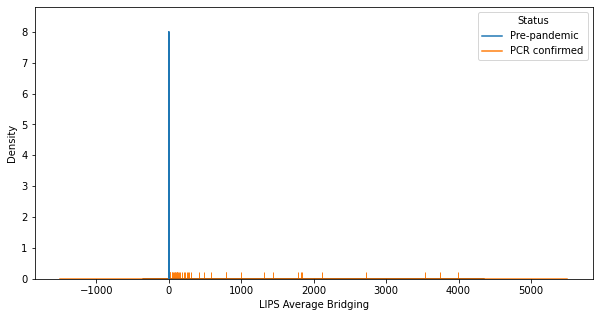

ELISA N Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 1.2678851975313812e-30
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

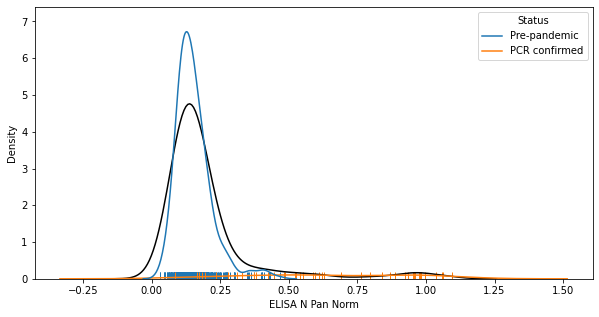

ELISA RBD Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 2.381819269455163e-19
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

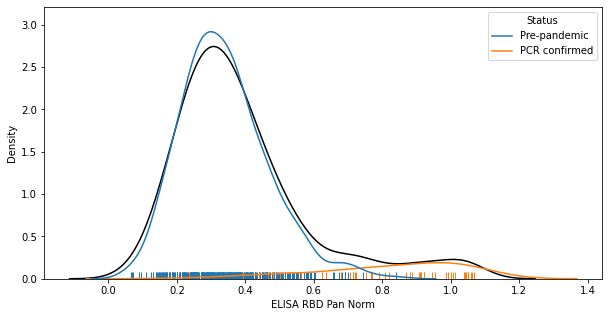

ELISA Spike Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 1.2396422961487394e-26
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

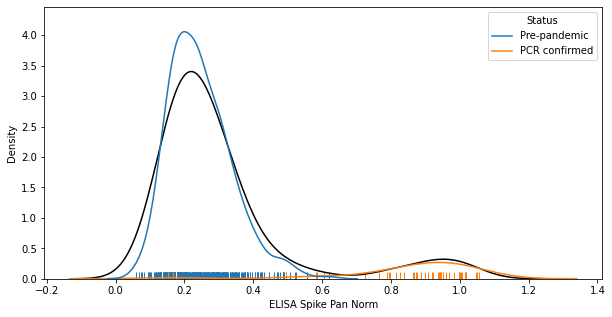

ELISA N IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 4.246337884988681e-34
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

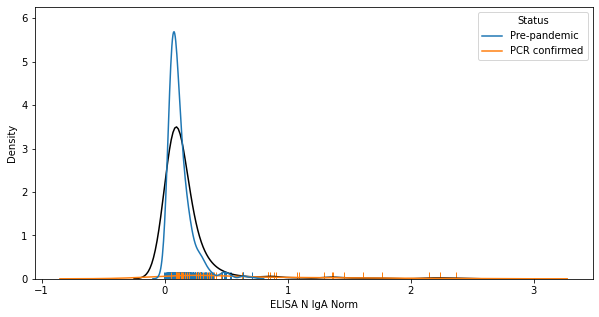

ELISA RBD IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 4.021384094339325e-28
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

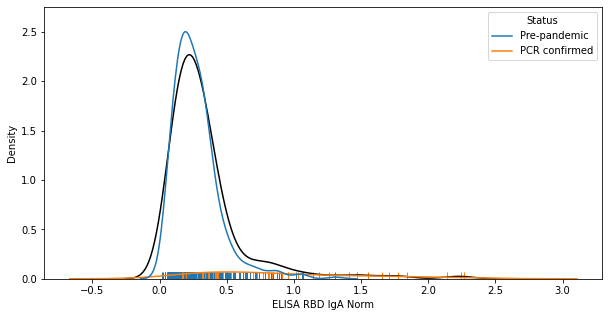

ELISA Spike IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 3.219357787806053e-30
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

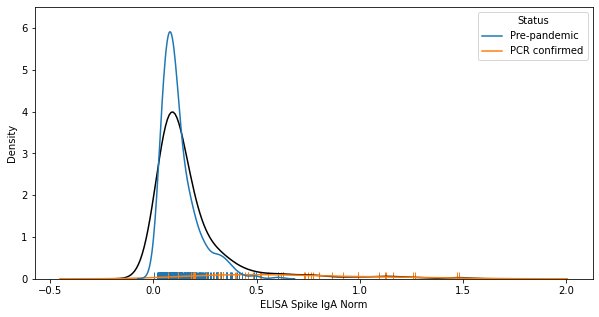

ELISA N IgM Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 7.861535915437398e-19
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

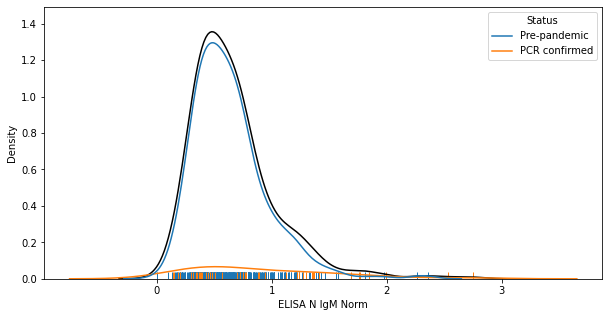

ELISA RBD IgM Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 1.9939643826376872e-28
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

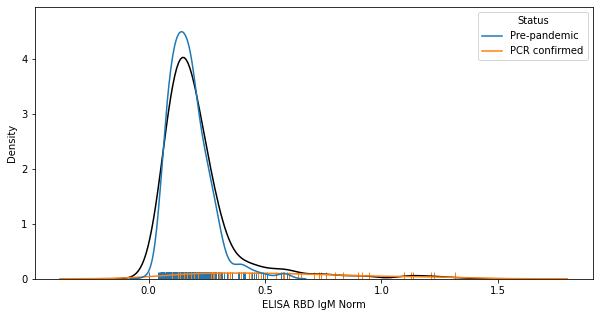

ELISA Spike IgM Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 1.4832969921774186e-12
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

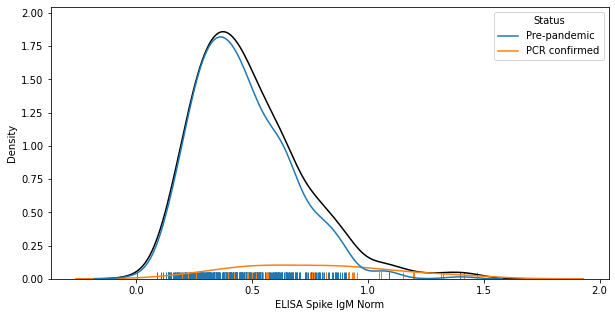







Validation
LIPS Average Bridging:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 9.80908925027372e-45
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

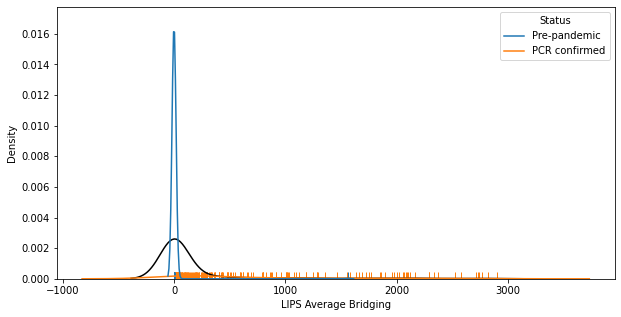

ELISA N Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 5.44551431438271e-35
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

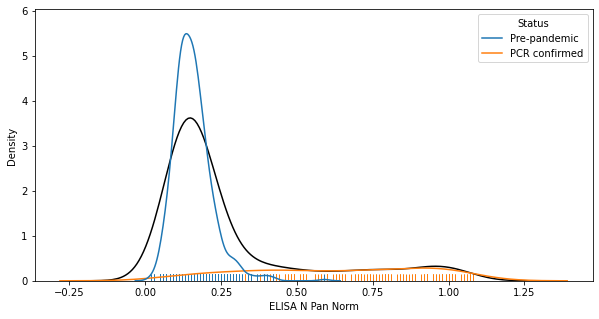

ELISA RBD Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 8.121950511300322e-29
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

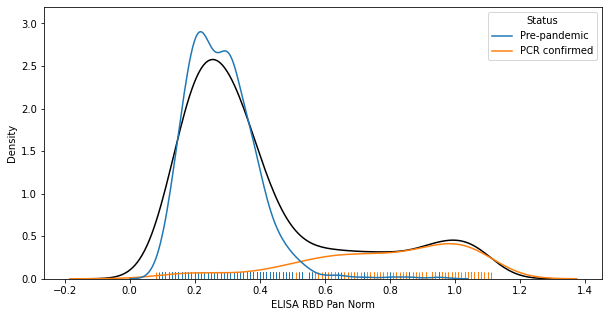

ELISA Spike Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 1.0985406601654805e-29
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

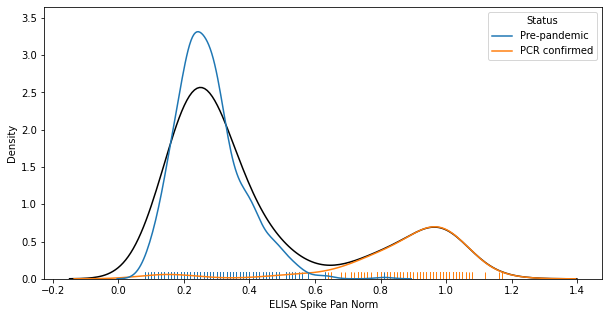

ELISA N IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 7.50367301676653e-41
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

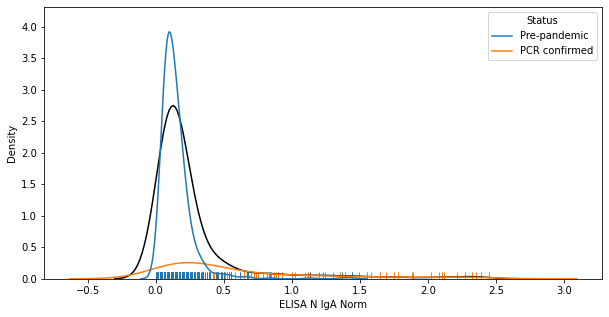

ELISA RBD IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 5.045611430106556e-32
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

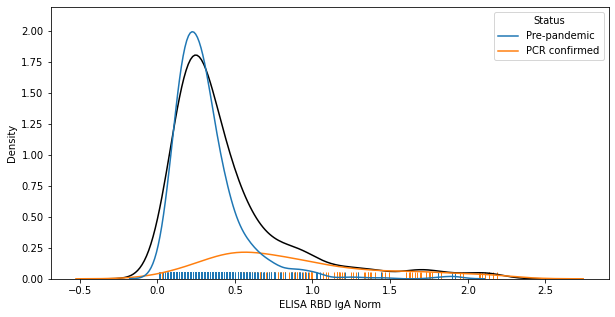

ELISA Spike IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 3.748835743511766e-32
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

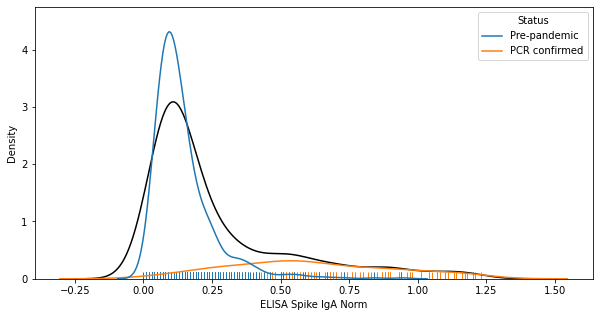







All data
LIPS Average Bridging:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 0.0
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

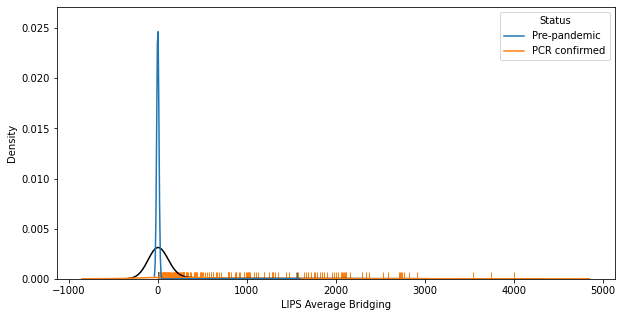

ELISA N Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 1.1630777253895982e-43
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

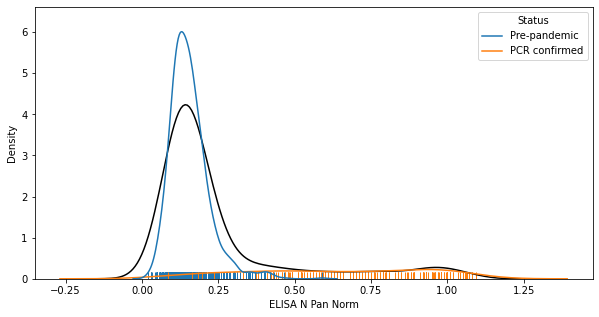

ELISA RBD Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 6.439016884936264e-34
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

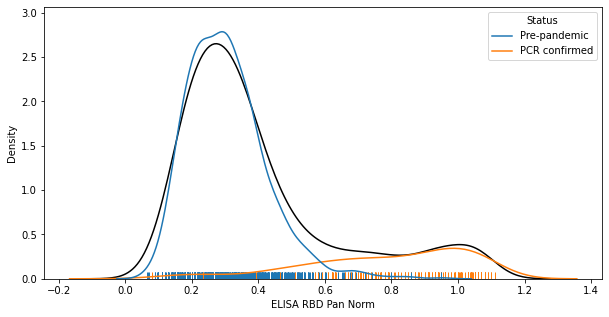

ELISA Spike Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 6.079521616566119e-38
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

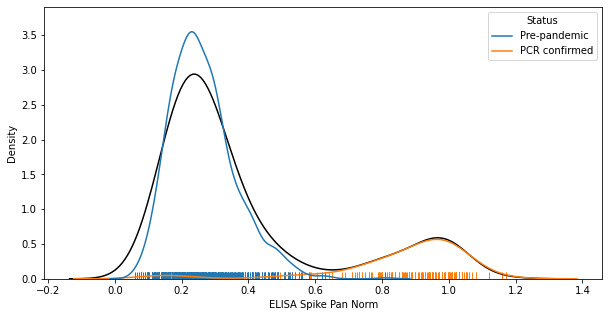

ELISA N IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 0.0
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

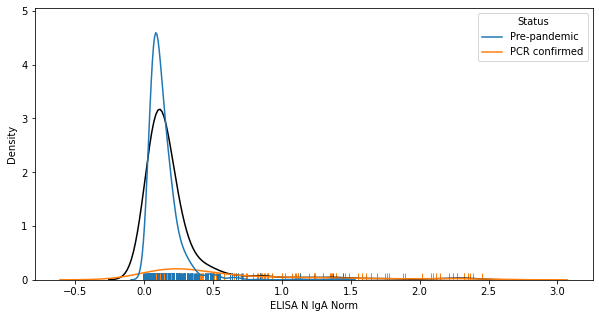

ELISA RBD IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 2.6893019478089727e-40
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

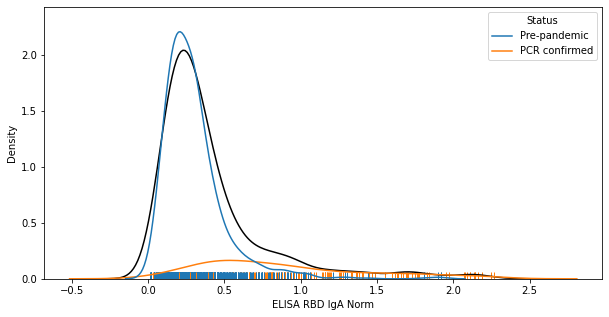

ELISA Spike IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 3.2753950305128274e-41
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

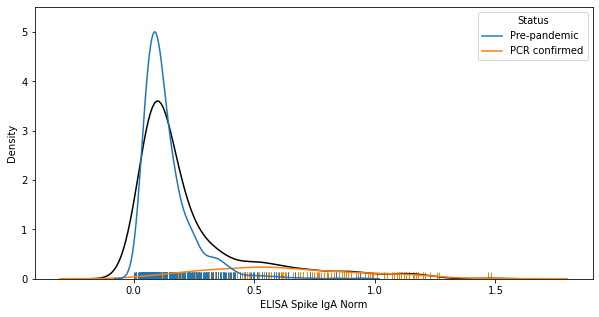

In [43]:
# What does the distribution of the original (unscaled) data look like? Several ML algorithms make assumptions
# about the distribution of continuous variables, therefore we need to see to what extent the data meet these
# assumptions or not. Also calculates Shapiro-Wilks and KS (Lilliefors) tests to see whether distribution is
# significantly different from a normal distribution.
# (FYI, the Shapiro-Wilks test struggles with multiple repeat values, hence may not return an accurate p value for
# the LIPS data in particular, which is zero-inflated.)

for label, df in {'Threshold': cont_thresh_df, 'Validation': cont_val_df, 'All data': cont_comb_df}.items():
    if label == 'Threshold':
        cols = thresh_upd_cont_cols
    else:
        cols = val_upd_cont_cols

    print('\n\n\n\n\n\n{}'.format(label))
    for col in cols:
        print('{}:'.format(col))

        shap_diff = shapiro(df[col])[1]
        print('Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? {}'.format(
            shap_diff
        ))
        lilliefors_diff = lilliefors(df[col], 'norm')[1]
        print('Significantly different from normal distribution (Lilliefors test, p < 0.05)? {}'.format(
            lilliefors_diff
        ))

        plt.clf()
        plt.figure(figsize=(10, 5))
        sns.kdeplot(data=df, x=col, color='k')
        sns.kdeplot(data=df, x=col, hue='Status',
                    hue_order={'Pre-pandemic': 'tab:blue', 'PCR confirmed': 'tab:orange'})
        sns.rugplot(data=df, x=col, hue='Status',
                    hue_order={'Pre-pandemic': 'tab:blue', 'PCR confirmed': 'tab:orange'})
        plt.show()

So, all of the data is positively skewed. The LIPS data also has strong zero-inflation. Are there any methods I can use to transform the data to a normal distribution (assumed by many ML models and feature selection algorithms)?







Threshold
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 3.8875589908857525e-38
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

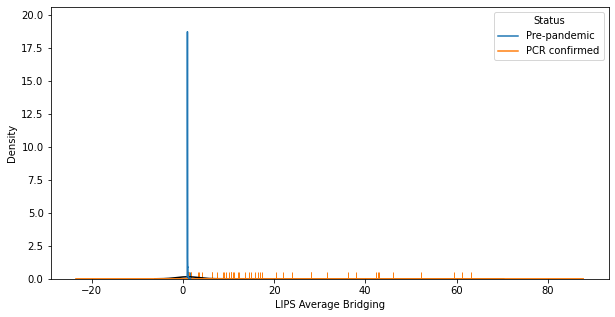

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 1.7925820156932325e-29
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

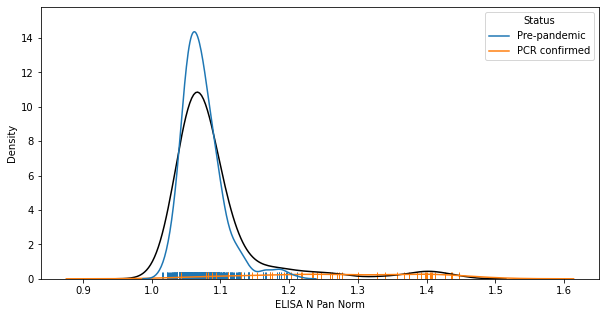

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 2.988757077875779e-17
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

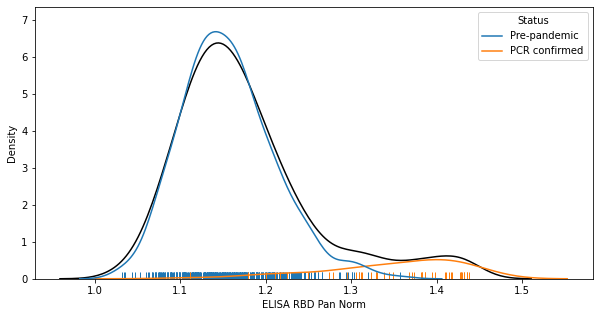

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 2.9922233692131622e-25
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

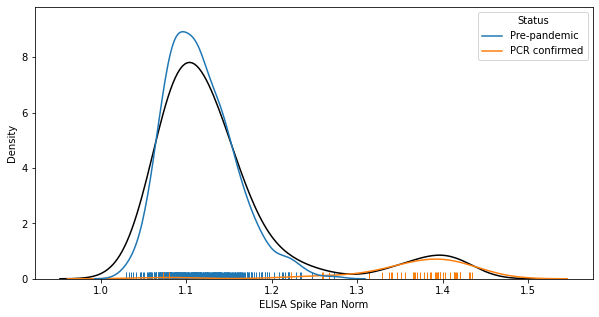

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 2.3464291059945292e-32
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

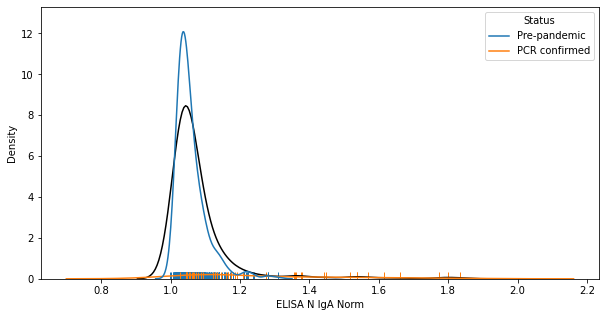

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 2.0939637266941663e-25
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

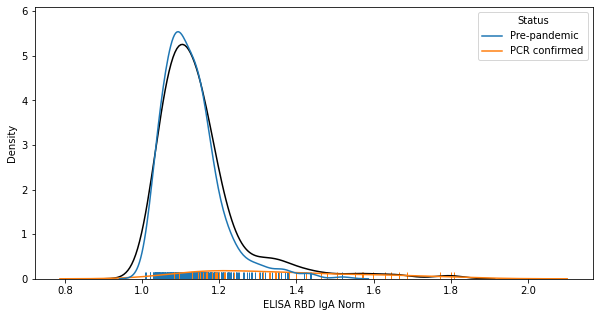

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 1.1354371746502204e-28
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

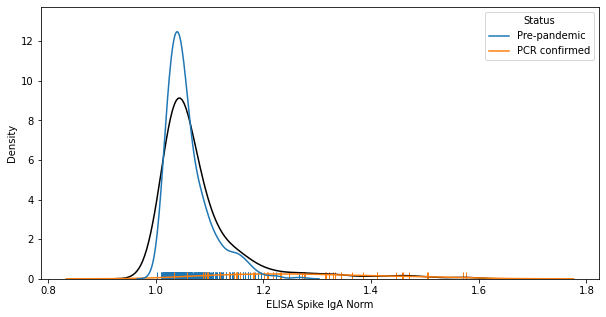

ELISA N IgM Norm
Significantly different from normal distribution (< 0.05)? 1.0817020700383886e-14
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

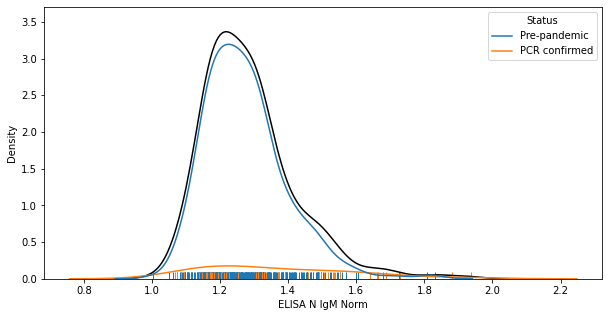

ELISA RBD IgM Norm
Significantly different from normal distribution (< 0.05)? 1.2007076193558093e-26
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

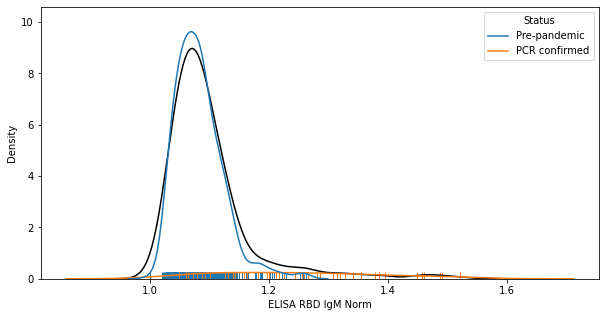

ELISA Spike IgM Norm
Significantly different from normal distribution (< 0.05)? 1.7667181051450598e-09
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

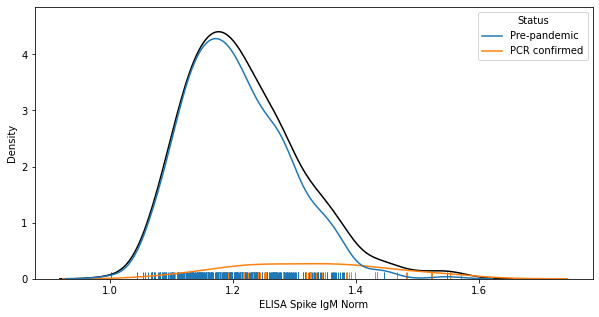







Validation
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 7.331593565347443e-42
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

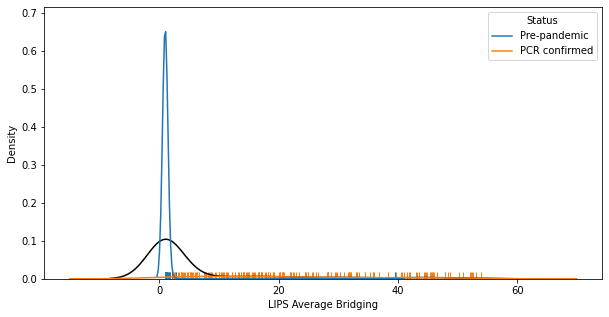

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 7.2681059075406855e-34
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

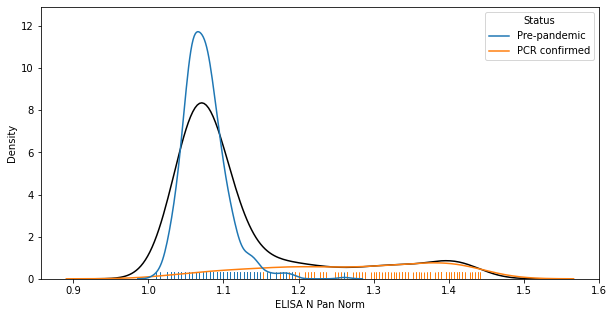

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 3.0592613313103876e-27
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

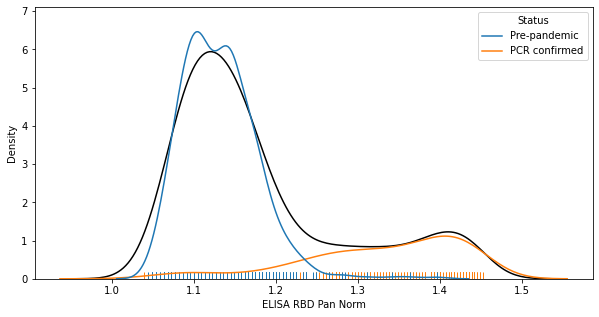

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 1.8723103695467939e-28
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

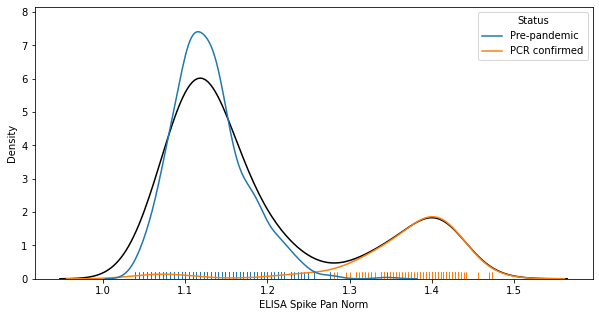

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 7.690610435802854e-39
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

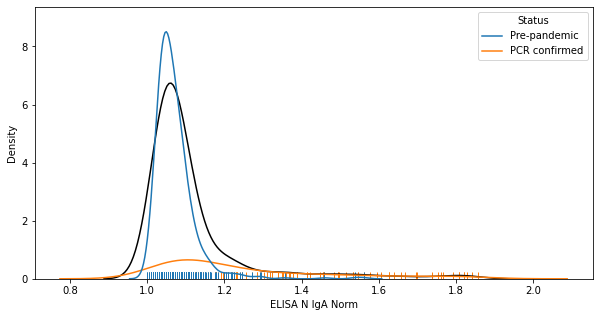

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 7.39636422884283e-29
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

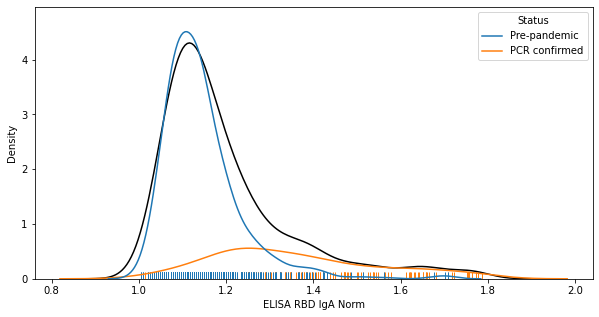

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 1.344970167397288e-30
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

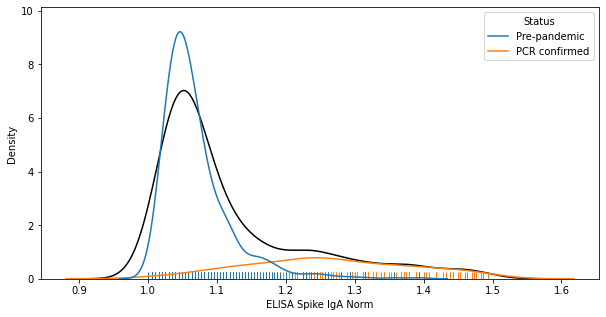







All data
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 0.0
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

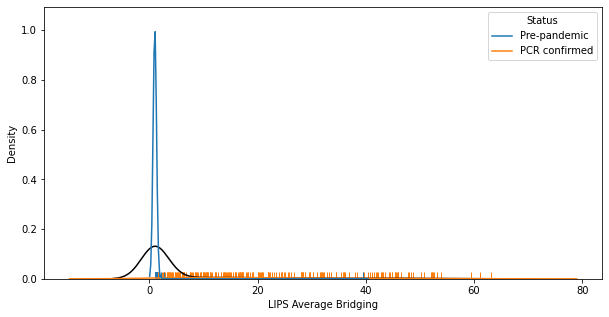

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 2.390615180138138e-42
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

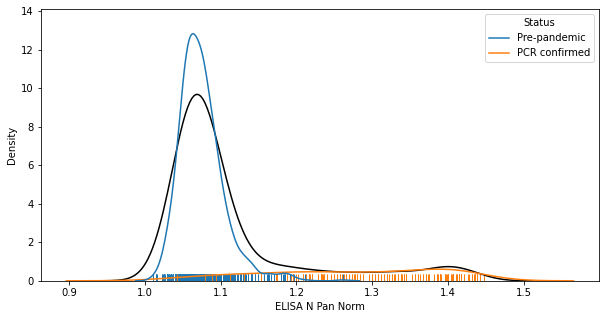

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 9.39125300237049e-32
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

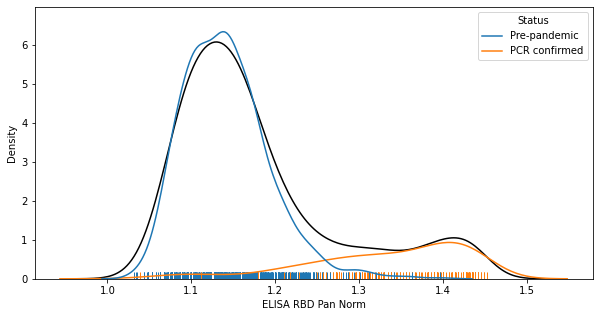

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 2.0662773189765937e-36
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

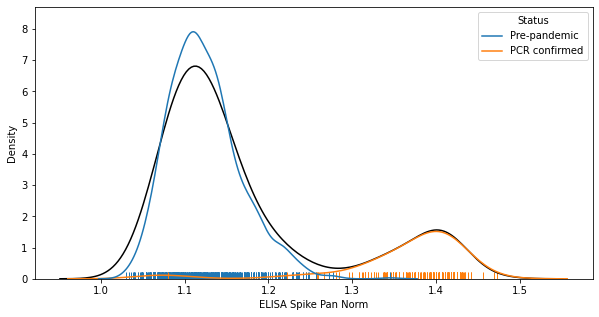

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 0.0
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

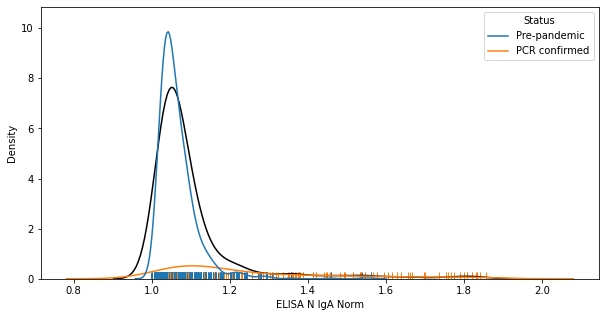

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 8.806867136123353e-37
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

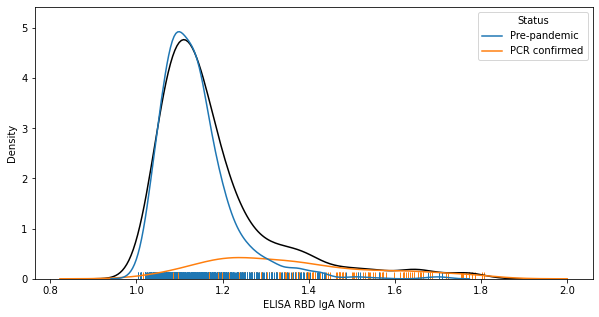

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 2.128753134811295e-39
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

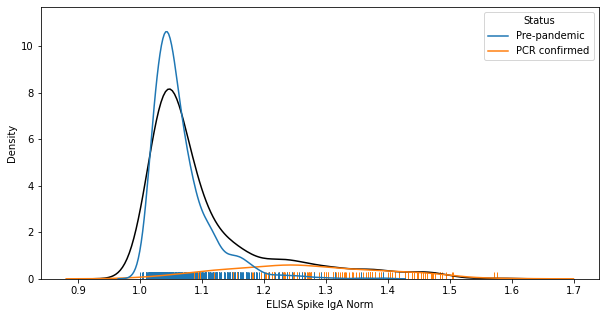

In [44]:
# What do the sqrt distributions look like?
for label, df in {'Threshold': cont_thresh_df, 'Validation': cont_val_df, 'All data': cont_comb_df}.items():
    if label == 'Threshold':
        cols = thresh_upd_cont_cols
    else:
        cols = val_upd_cont_cols

    print('\n\n\n\n\n\n{}'.format(label))
    for col in cols:
        print(col)

        plot_df = copy.deepcopy(df)
        plot_df[col] = np.sqrt(plot_df[col]+1)

        shap_diff = shapiro(plot_df[col])[1]
        print('Significantly different from normal distribution (< 0.05)? {}'.format(shap_diff))
        lilliefors_diff = lilliefors(plot_df[col], 'norm')[1]
        print('Significantly different from normal distribution (Lilliefors test, p < 0.05)? {}'.format(
            lilliefors_diff
        ))

        plt.clf()
        plt.figure(figsize=(10, 5))
        sns.kdeplot(data=plot_df, x=col, color='k')
        sns.kdeplot(data=plot_df, x=col, hue='Status',
                    hue_order={'Pre-pandemic': 'tab:blue', 'PCR confirmed': 'tab:orange'})
        sns.rugplot(data=plot_df, x=col, hue='Status',
                    hue_order={'Pre-pandemic': 'tab:blue', 'PCR confirmed': 'tab:orange'})
        plt.show()







Threshold
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 4.183908573877959e-34
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

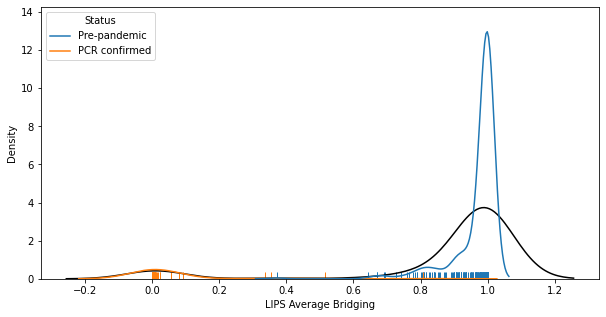

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 1.7100554459641443e-25
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

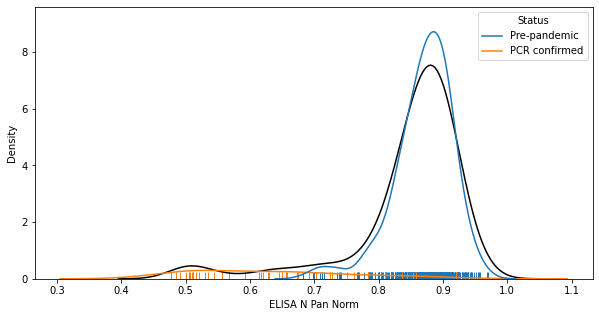

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 3.7435490818360506e-10
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

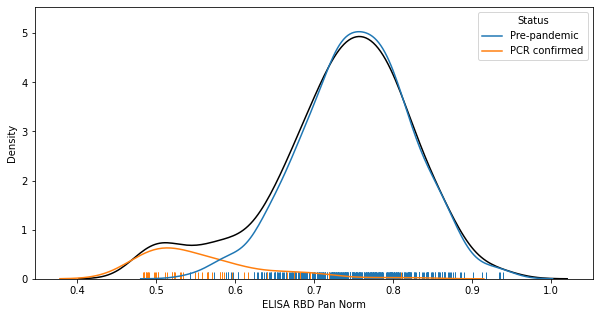

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 2.4017578441976427e-20
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

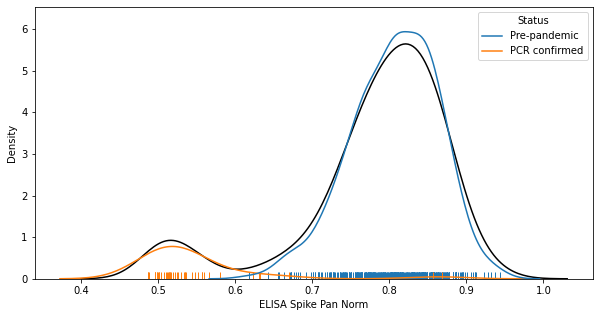

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 2.698360356066691e-26
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

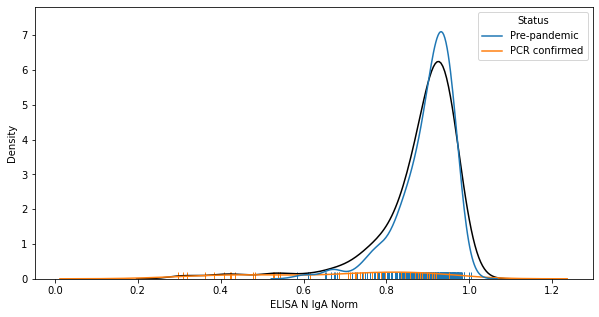

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 6.9811380839647605e-16
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

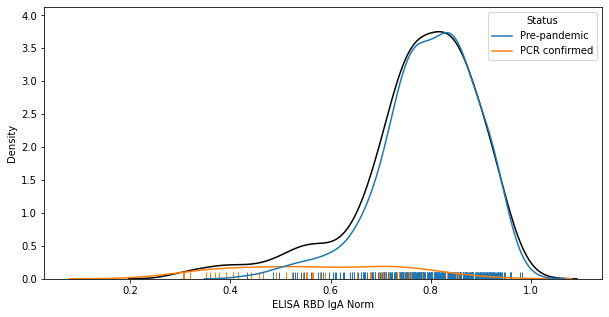

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 1.0890921360755378e-23
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

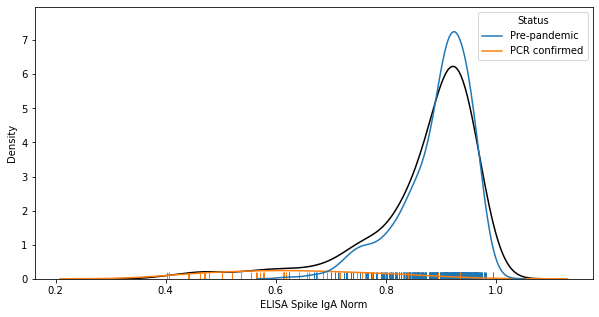

ELISA N IgM Norm
Significantly different from normal distribution (< 0.05)? 0.08957832306623459
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.1743531989504224


<Figure size 432x288 with 0 Axes>

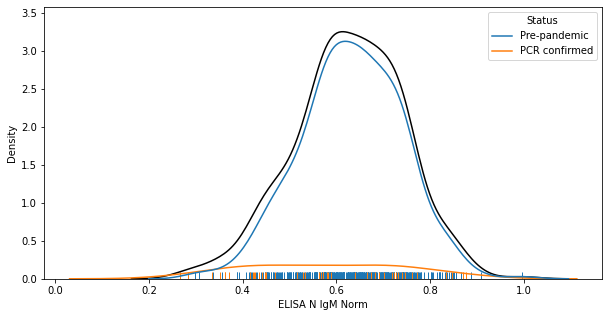

ELISA RBD IgM Norm
Significantly different from normal distribution (< 0.05)? 1.1790402230164277e-20
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

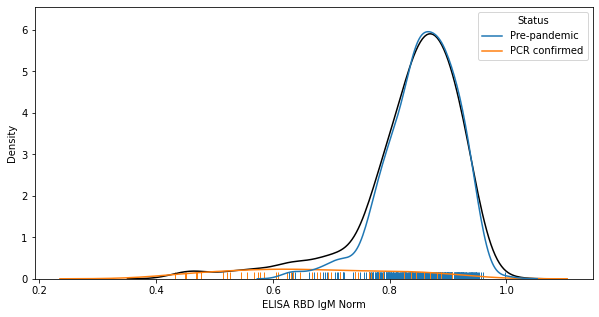

ELISA Spike IgM Norm
Significantly different from normal distribution (< 0.05)? 0.2390904724597931
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.38882877216318545


<Figure size 432x288 with 0 Axes>

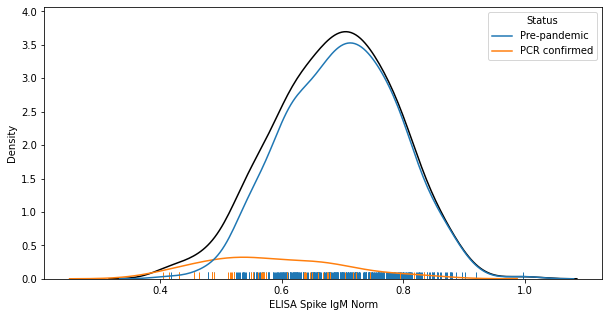







Validation
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 2.3853135075282114e-38
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

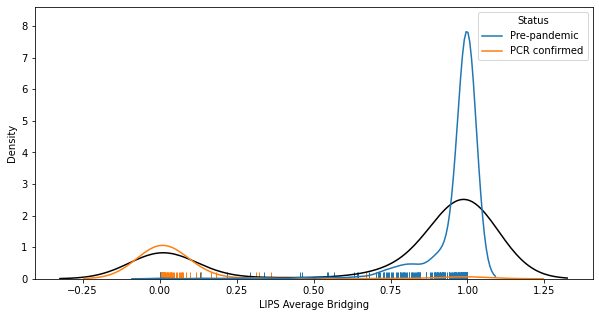

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 4.903761070839439e-30
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

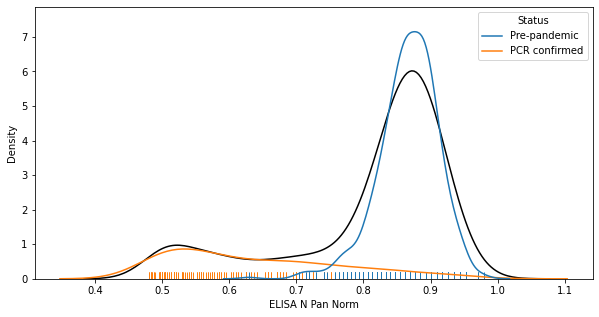

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 6.026394464393106e-22
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

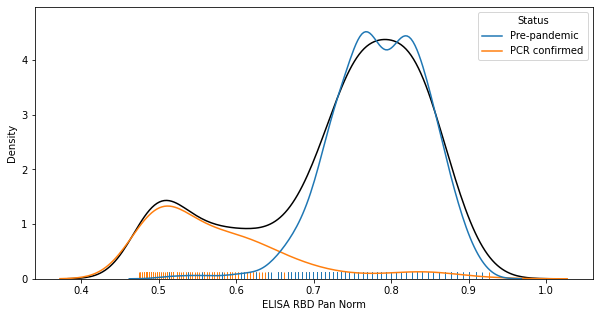

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 3.125388809256032e-24
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

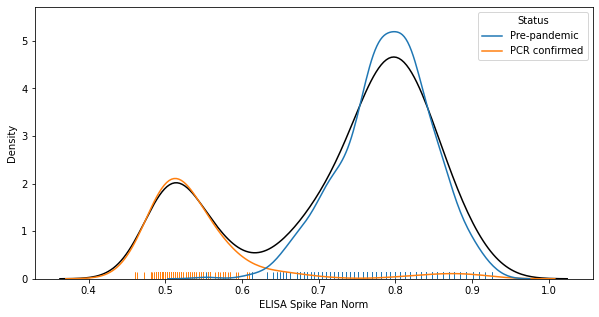

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 1.053726536712698e-31
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

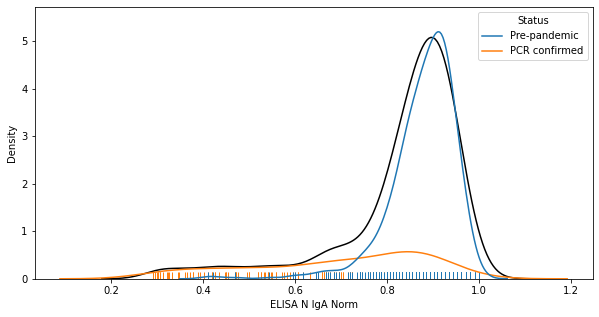

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 9.522698426335017e-18
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

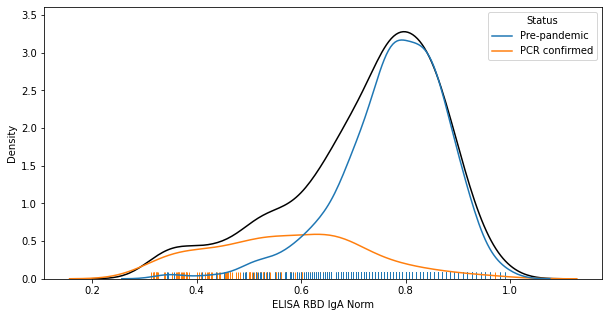

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 8.591858211394437e-26
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

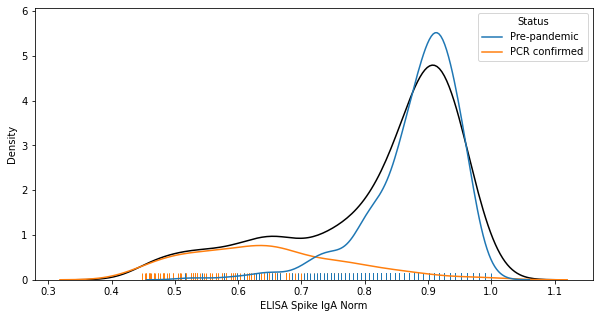







All data
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 0.0
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

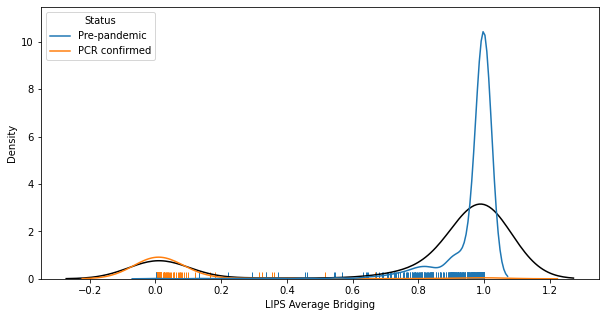

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 8.047513587654678e-38
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

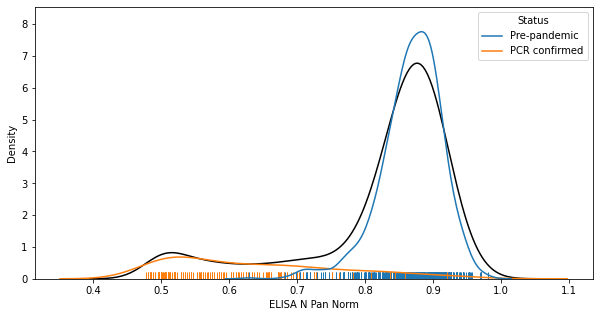

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 2.6059599935544095e-24
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

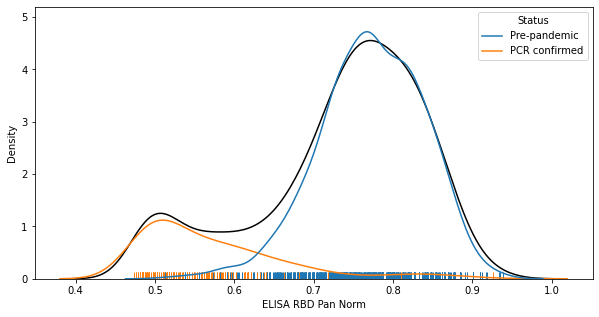

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 5.216762114542495e-31
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

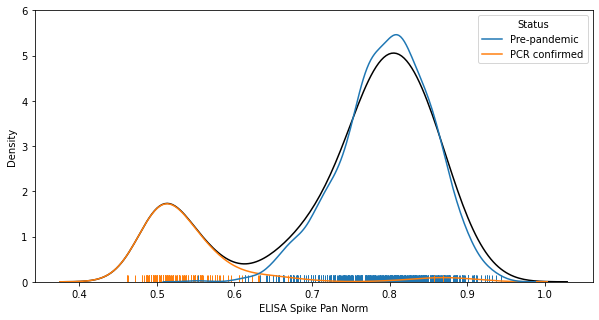

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 4.01213750722085e-39
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

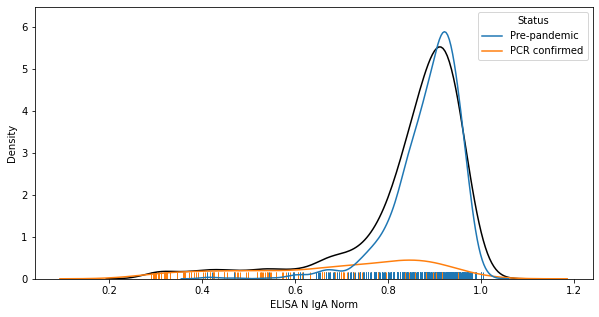

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 3.5766913999675414e-24
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

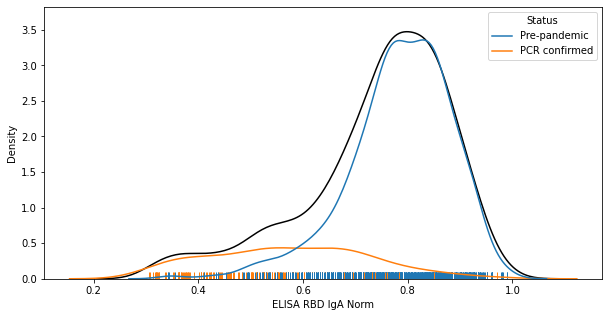

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 1.0901563078529703e-33
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

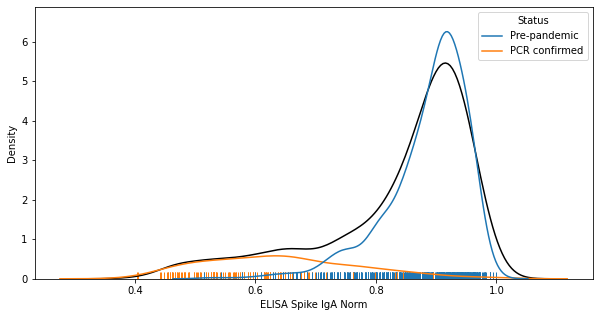

In [45]:
# What do the reciprocal distributions look like?
for label, df in {'Threshold': cont_thresh_df, 'Validation': cont_val_df, 'All data': cont_comb_df}.items():
    if label == 'Threshold':
        cols = thresh_upd_cont_cols
    else:
        cols = val_upd_cont_cols

    print('\n\n\n\n\n\n{}'.format(label))
    for col in cols:
        print(col)

        plot_df = copy.deepcopy(df)
        plot_df[col] = 1/(plot_df[col]+1)

        shap_diff = shapiro(plot_df[col])[1]
        print('Significantly different from normal distribution (< 0.05)? {}'.format(shap_diff))
        lilliefors_diff = lilliefors(plot_df[col], 'norm')[1]
        print('Significantly different from normal distribution (Lilliefors test, p < 0.05)? {}'.format(
            lilliefors_diff
        ))

        plt.clf()
        plt.figure(figsize=(10, 5))
        sns.kdeplot(data=plot_df, x=col, color='k')
        sns.kdeplot(data=plot_df, x=col, hue='Status',
                    hue_order={'Pre-pandemic': 'tab:blue', 'PCR confirmed': 'tab:orange'})
        sns.rugplot(data=plot_df, x=col, hue='Status',
                    hue_order={'Pre-pandemic': 'tab:blue', 'PCR confirmed': 'tab:orange'})
        plt.show()







Threshold
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 3.0149966470371657e-36
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

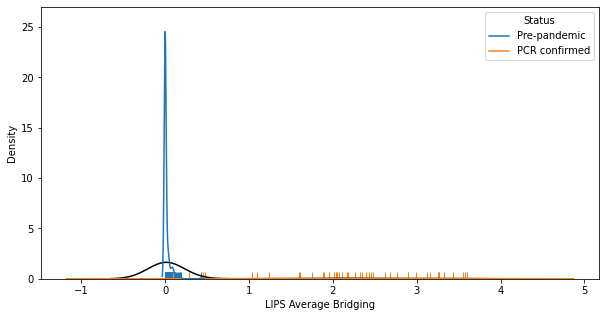

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 3.1316261267442964e-28
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

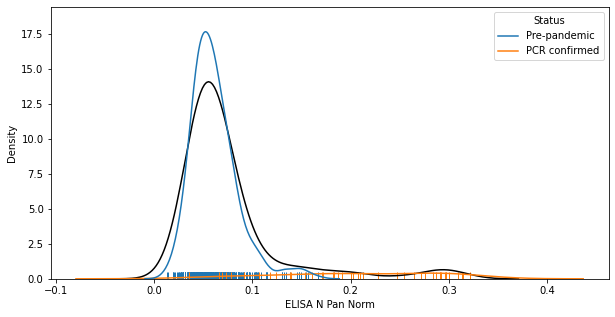

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 5.3030505130940465e-15
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

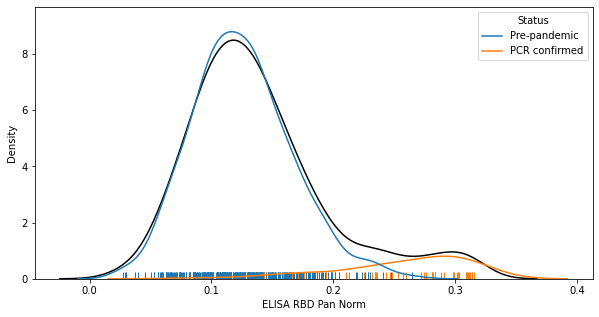

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 9.697209150365891e-24
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

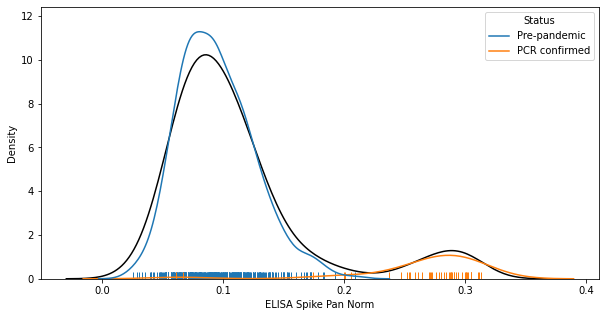

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 1.9503459964888435e-30
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

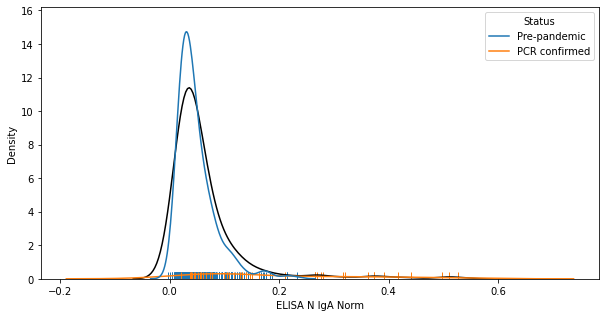

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 2.0216816207388635e-22
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

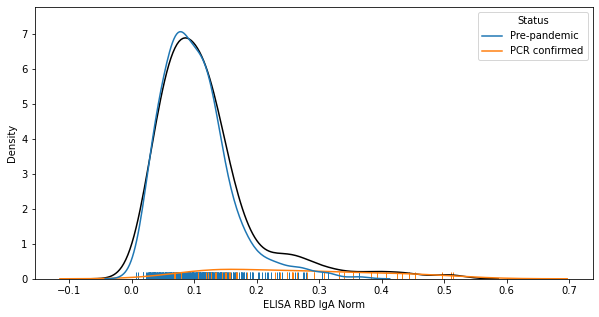

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 4.751450980590061e-27
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

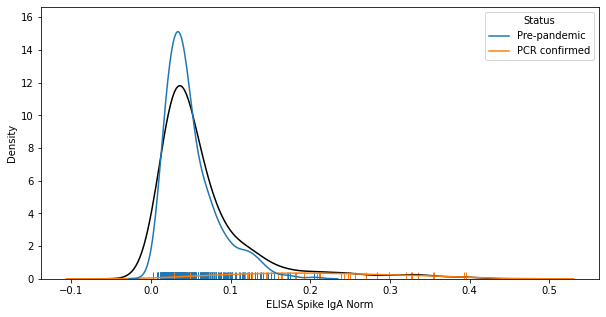

ELISA N IgM Norm
Significantly different from normal distribution (< 0.05)? 3.256921676797475e-10
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

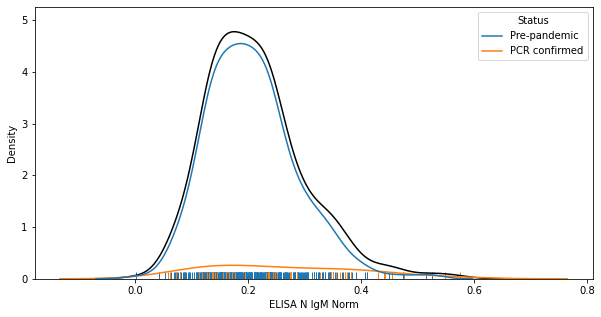

ELISA RBD IgM Norm
Significantly different from normal distribution (< 0.05)? 9.546924837034046e-25
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

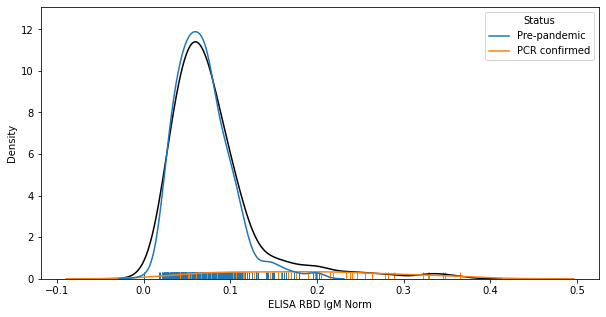

ELISA Spike IgM Norm
Significantly different from normal distribution (< 0.05)? 2.4811561161186546e-06
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.005514868393746671


<Figure size 432x288 with 0 Axes>

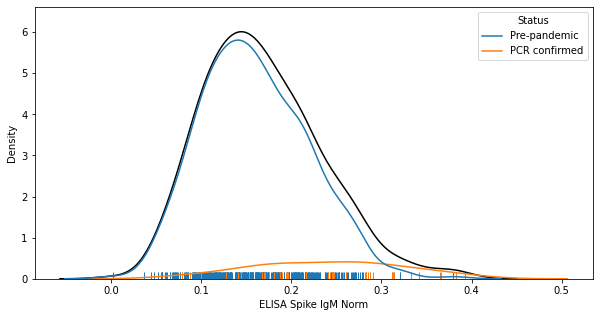







Validation
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 1.9234208708337796e-39
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

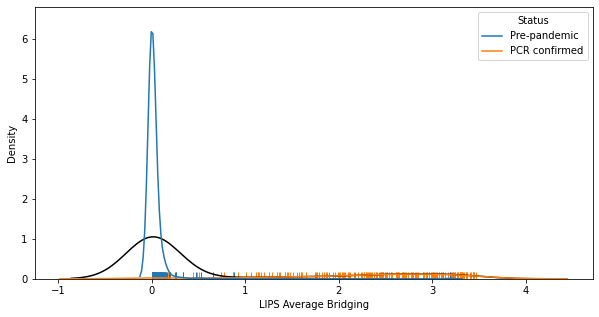

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 1.1595111541341569e-32
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

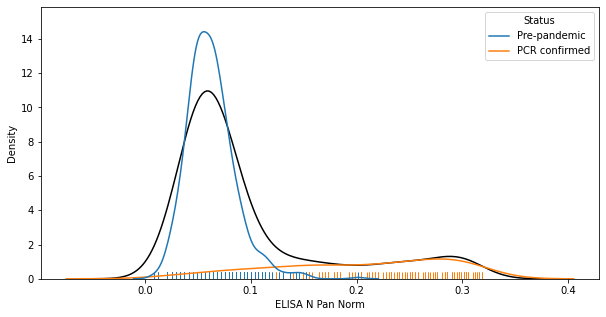

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 1.462269921551149e-25
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

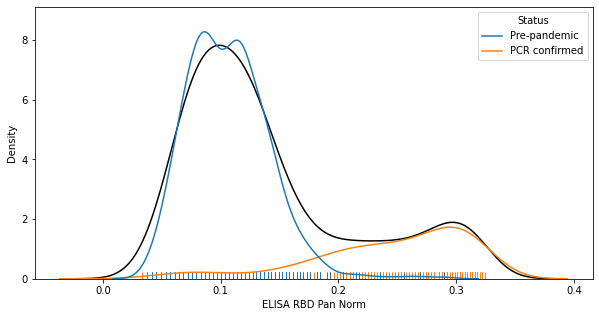

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 3.9552534378389005e-27
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

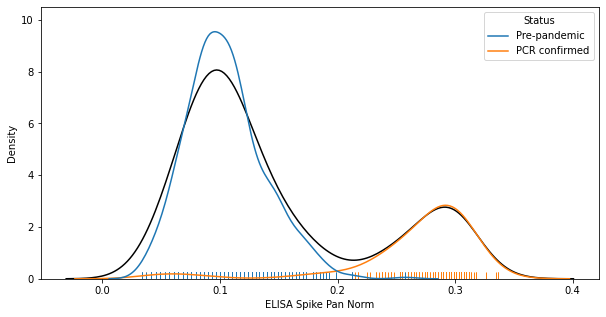

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 1.2906965100832828e-36
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

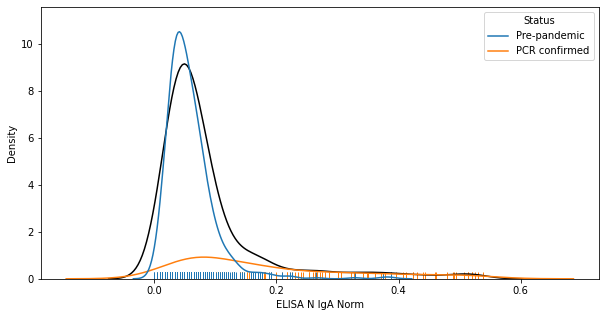

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 2.229250660230208e-25
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

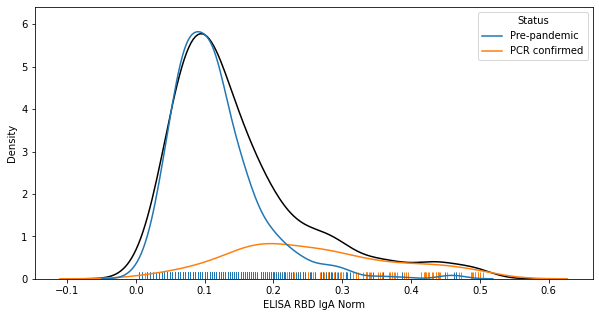

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 5.240642554994139e-29
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

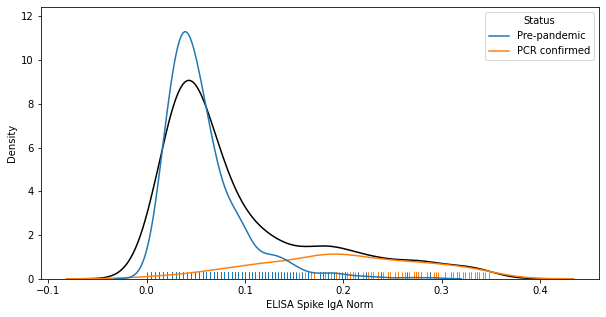







All data
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 0.0
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

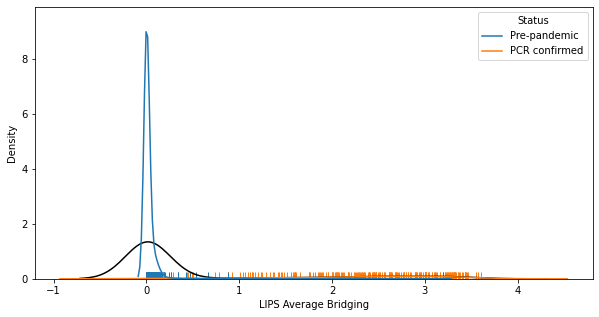

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 6.177904539668821e-41
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

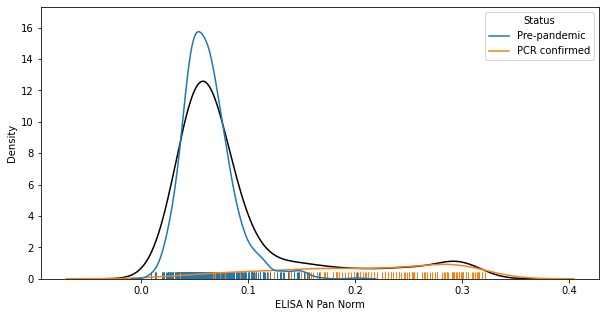

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 2.0148674331964386e-29
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

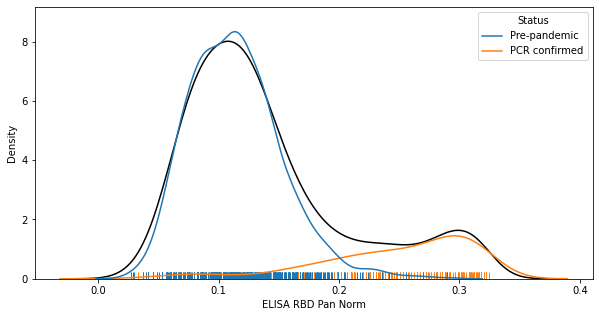

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 9.62141379984636e-35
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

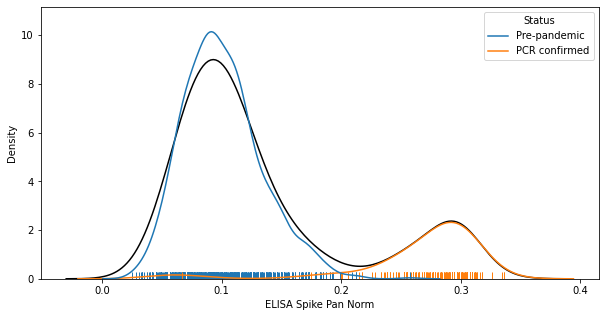

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 1.2611686178923354e-44
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

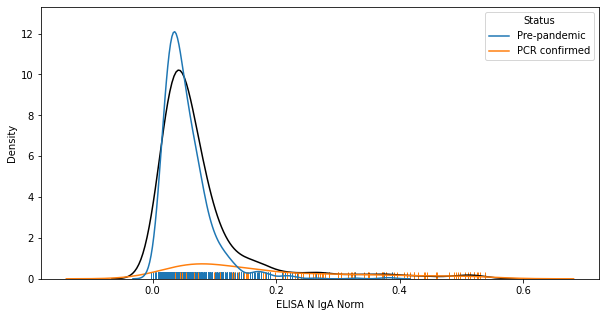

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 6.885644769669742e-33
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

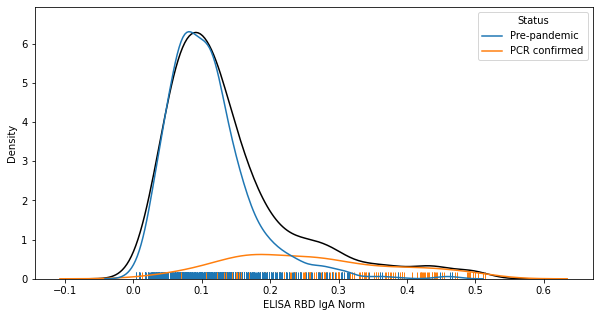

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 1.5801515683126965e-37
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

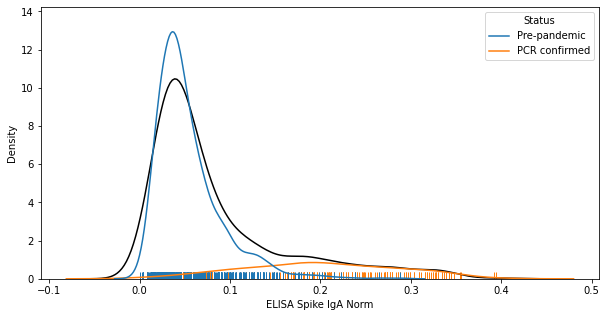

In [46]:
# What do the log distributions look like?
for label, df in {'Threshold': cont_thresh_df, 'Validation': cont_val_df, 'All data': cont_comb_df}.items():
    if label == 'Threshold':
        cols = thresh_upd_cont_cols
    else:
        cols = val_upd_cont_cols

    print('\n\n\n\n\n\n{}'.format(label))
    for col in cols:
        print(col)

        plot_df = copy.deepcopy(df)
        plot_df[col] = np.log10(plot_df[col]+1)

        shap_diff = shapiro(plot_df[col])[1]
        print('Significantly different from normal distribution (< 0.05)? {}'.format(shap_diff))
        lilliefors_diff = lilliefors(plot_df[col], 'norm')[1]
        print('Significantly different from normal distribution (Lilliefors test, p < 0.05)? {}'.format(
            lilliefors_diff
        ))

        plt.clf()
        plt.figure(figsize=(10, 5))
        sns.kdeplot(data=plot_df, x=col, color='k')
        sns.kdeplot(data=plot_df, x=col, hue='Status',
                    hue_order={'Pre-pandemic': 'tab:blue', 'PCR confirmed': 'tab:orange'})
        sns.rugplot(data=plot_df, x=col, hue='Status',
                    hue_order={'Pre-pandemic': 'tab:blue', 'PCR confirmed': 'tab:orange'})
        plt.show()







Threshold
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 8.855912891602056e-33
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

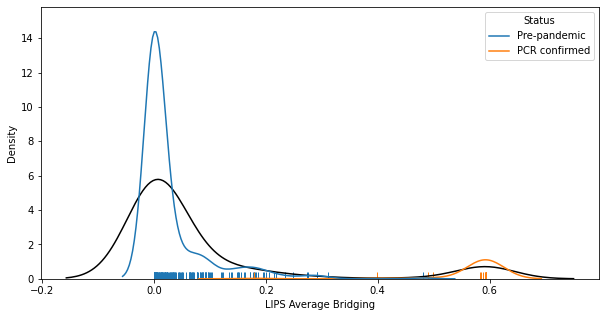

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 5.361936018744018e-06
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.013390177039212237


<Figure size 432x288 with 0 Axes>

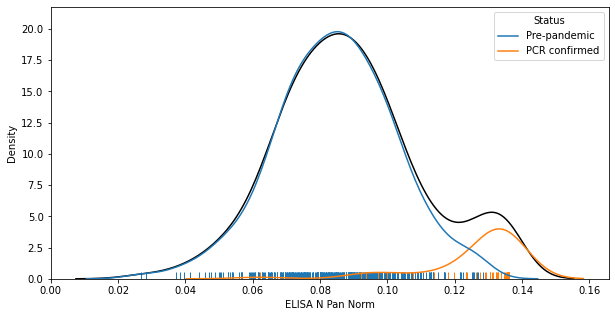

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 0.008406705223023891
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.31220294063409815


<Figure size 432x288 with 0 Axes>

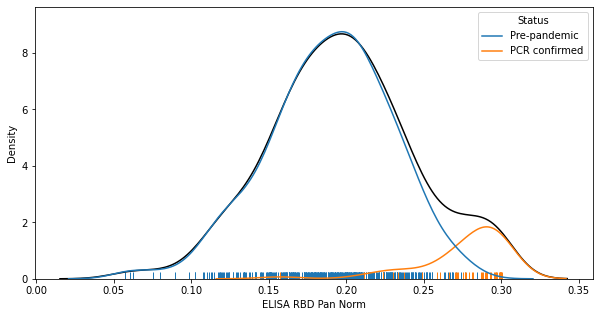

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 3.0497834814013913e-05
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.007156194925602387


<Figure size 432x288 with 0 Axes>

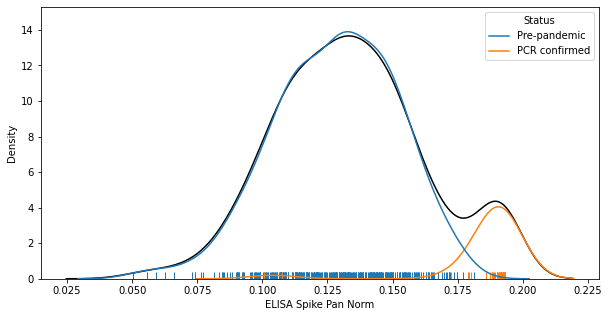

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 7.500828047568575e-08
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

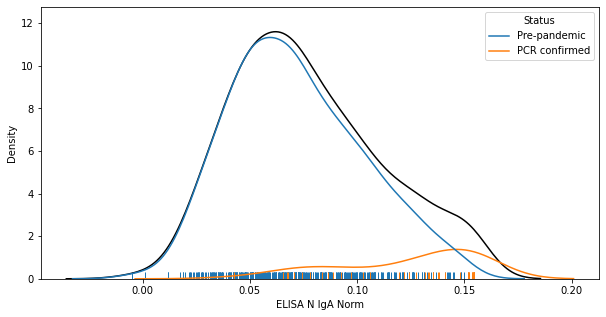

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 0.005508072674274445
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.573823288377934


<Figure size 432x288 with 0 Axes>

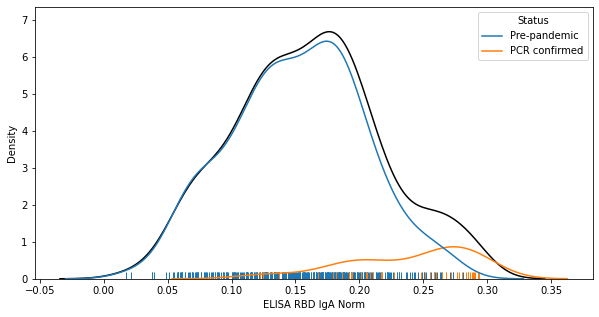

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 7.4107044945037615e-09
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

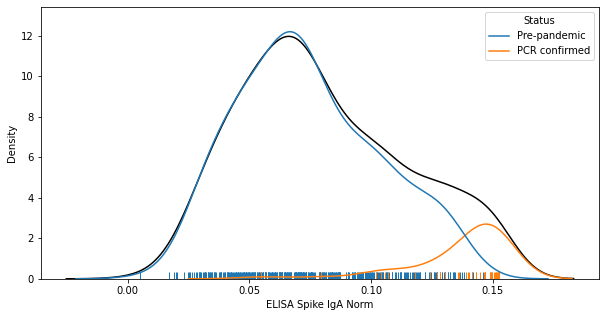

ELISA N IgM Norm
Significantly different from normal distribution (< 0.05)? 0.7637573480606079
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.7728256307723901


<Figure size 432x288 with 0 Axes>

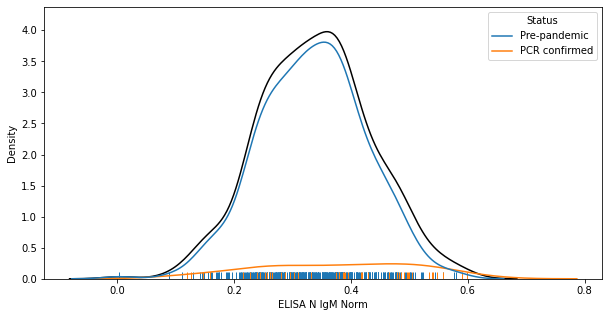

ELISA RBD IgM Norm
Significantly different from normal distribution (< 0.05)? 0.005050959996879101
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.5730300817483059


<Figure size 432x288 with 0 Axes>

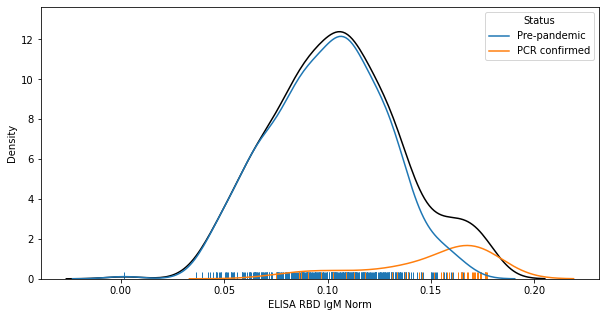

ELISA Spike IgM Norm
Significantly different from normal distribution (< 0.05)? 0.6732020378112793
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.7610902569947561


<Figure size 432x288 with 0 Axes>

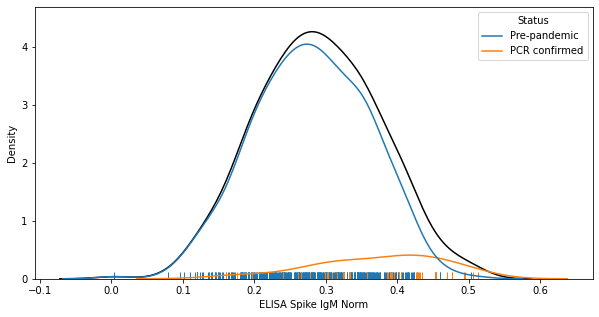







Validation
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 8.848922345115283e-39
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

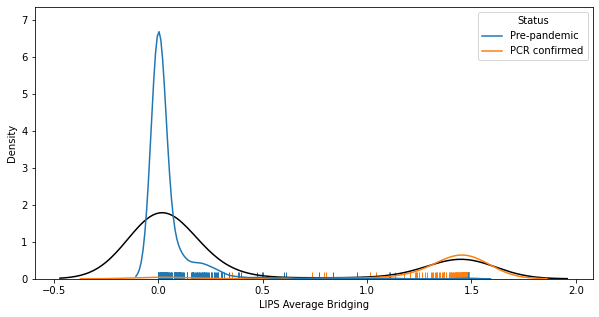

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 1.7226913729610598e-16
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

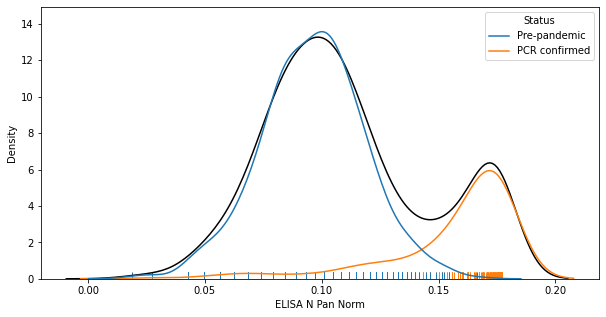

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 4.0956908003986214e-13
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

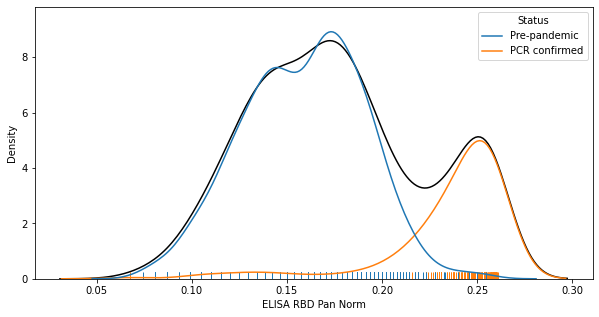

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 6.140800932158505e-17
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

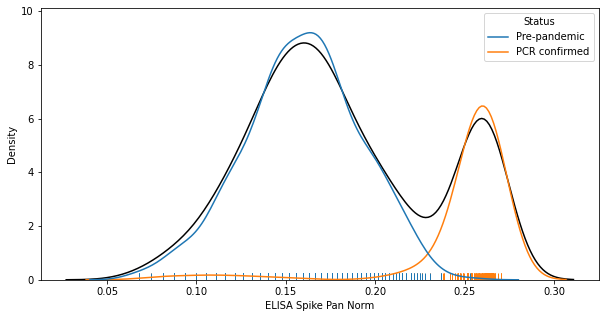

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 9.726171690954688e-13
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

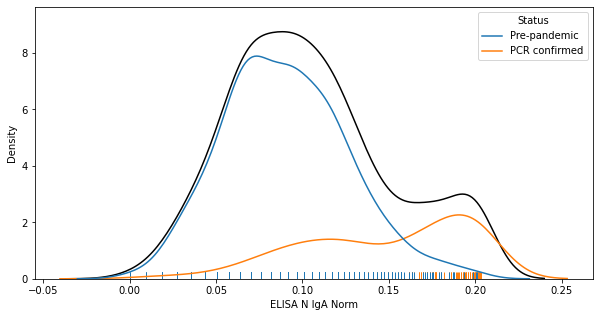

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 2.095737841045775e-07
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

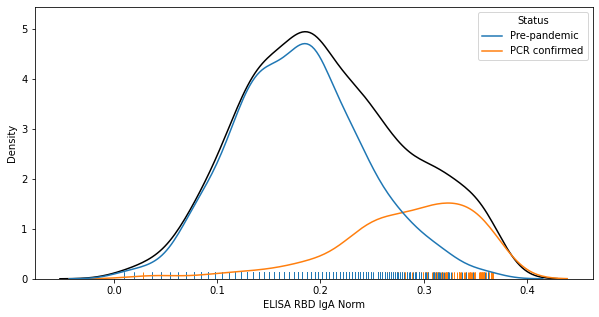

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 1.2542809619893496e-16
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

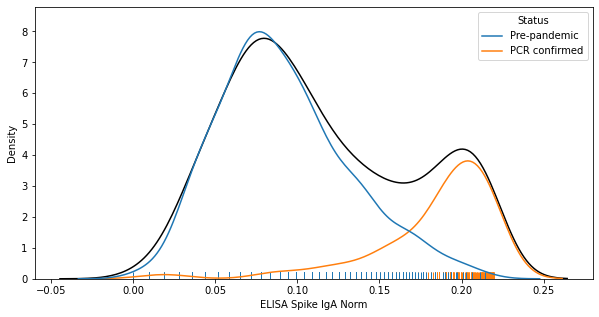







All data
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 0.0
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

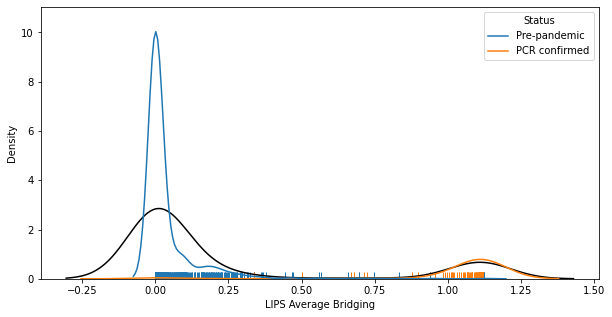

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 1.792850284801521e-18
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

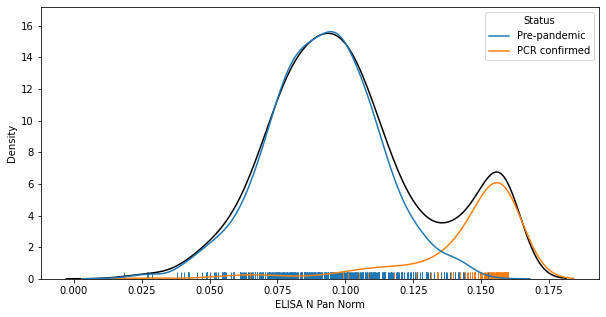

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 1.4114102681733742e-12
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

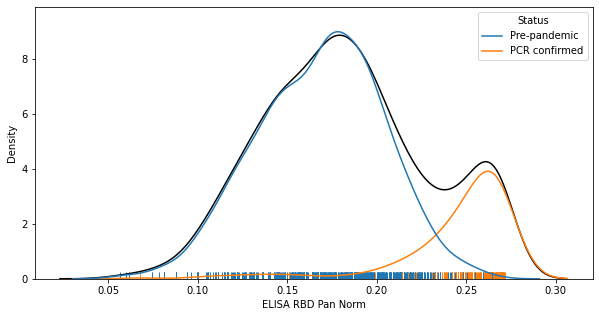

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 2.5171225981177452e-18
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

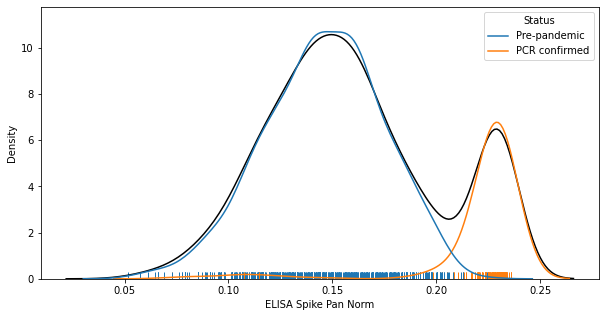

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 7.001706161506463e-16
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

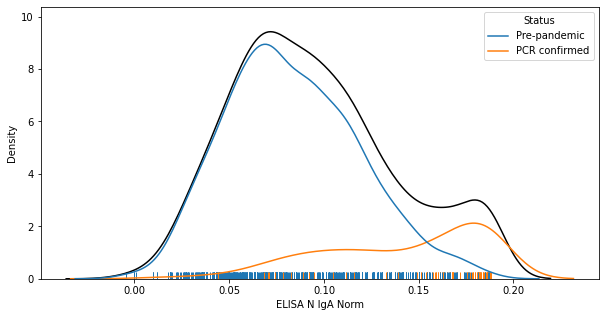

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 5.149728643516482e-09
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

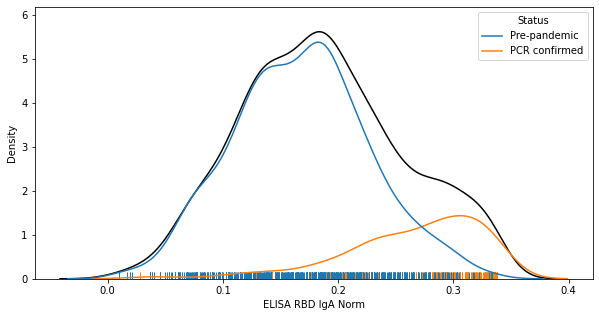

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 6.315005696489814e-20
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

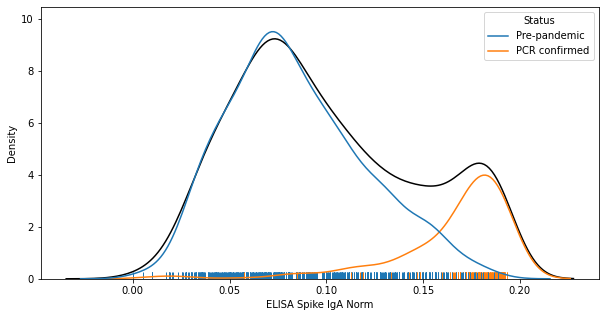

In [47]:
# Box-Cox transformation
for label, df in {'Threshold': cont_thresh_df, 'Validation': cont_val_df, 'All data': cont_comb_df}.items():
    if label == 'Threshold':
        cols = thresh_upd_cont_cols
    else:
        cols = val_upd_cont_cols

    print('\n\n\n\n\n\n{}'.format(label))
    for col in cols:
        print(col)

        plot_df = copy.deepcopy(df)
        transformed_col = boxcox(plot_df[col]+1, lmbda=None)[0]
        plot_df[col] = transformed_col

        shap_diff = shapiro(plot_df[col])[1]
        print('Significantly different from normal distribution (< 0.05)? {}'.format(shap_diff))
        lilliefors_diff = lilliefors(plot_df[col], 'norm')[1]
        print('Significantly different from normal distribution (Lilliefors test, p < 0.05)? {}'.format(
            lilliefors_diff
        ))

        plt.clf()
        plt.figure(figsize=(10, 5))
        sns.kdeplot(data=plot_df, x=col, color='k')
        sns.kdeplot(data=plot_df, x=col, hue='Status',
                    hue_order={'Pre-pandemic': 'tab:blue', 'PCR confirmed': 'tab:orange'})
        sns.rugplot(data=plot_df, x=col, hue='Status',
                    hue_order={'Pre-pandemic': 'tab:blue', 'PCR confirmed': 'tab:orange'})
        plt.show()

None of the assays for either the validation dataset or the combined dataset can be transformed to a normal distribution. This is clearly because they have a greater fraction of positive samples than the threshold dataset.

The Box-Cox transformation can be used to transform a subset of the assays (namely RBD PanIg, RBD IgA, and N, Spike and RBD IgM) in the threshold dataset to an approximately normal distribution. However, as mentioned above this is because the threshold dataset only has ~10% positive samples, and the ~ normal distribution of the transformed negative data obscures the positive data. Moreover, the Box-Cox transformation does not work for all of the assays; in particular the zero-inflated LIPS data remains distinctly non-normal.

So, when scaling the data, don't standardise because even the transformed data are not normally distributed, and accordingly avoid ML algorithms and feature selection methods etc. that assume that each of the features are normally distributed.







Threshold
LIPS Average Bridging:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 2.2535974864013042e-08
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

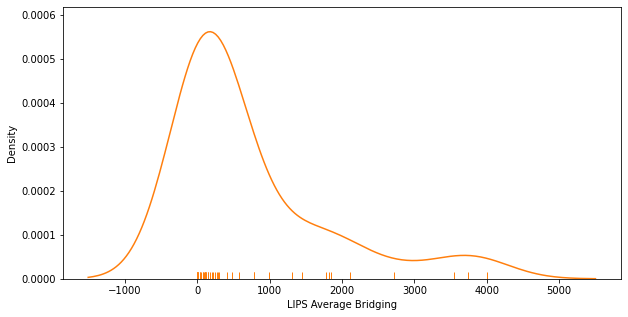

ELISA N Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 0.021275166422128677
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.07860187113672762


<Figure size 432x288 with 0 Axes>

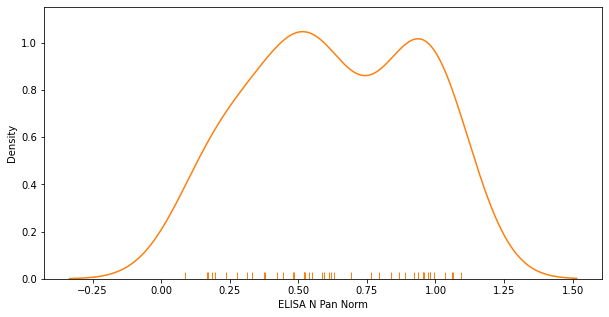

ELISA RBD Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 0.0021988314110785723
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.04166494408721283


<Figure size 432x288 with 0 Axes>

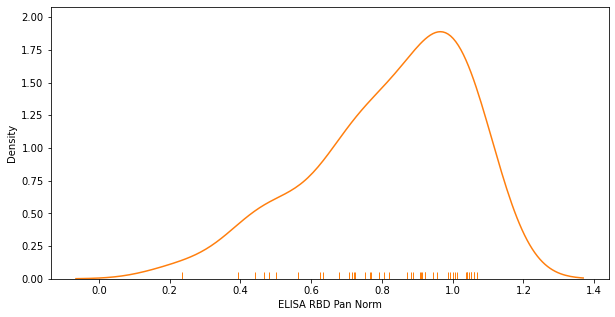

ELISA Spike Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 5.27383747339627e-07
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

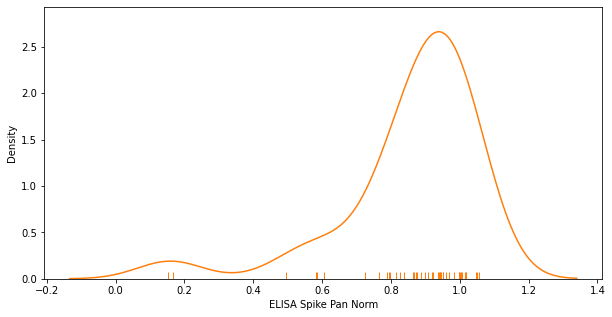

ELISA N IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 9.713458894111682e-06
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

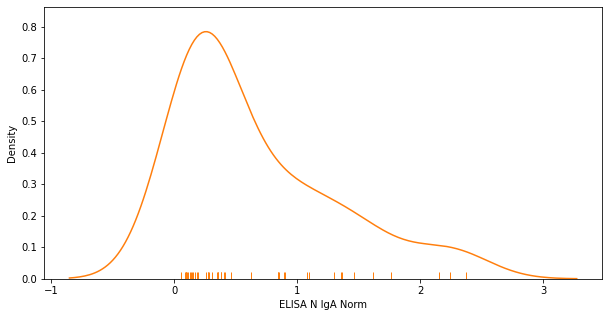

ELISA RBD IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 0.0014874127227813005
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.016480701194629917


<Figure size 432x288 with 0 Axes>

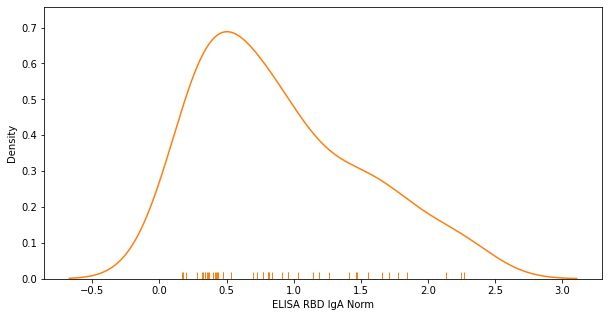

ELISA Spike IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 0.07999781519174576
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.2108744907106102


<Figure size 432x288 with 0 Axes>

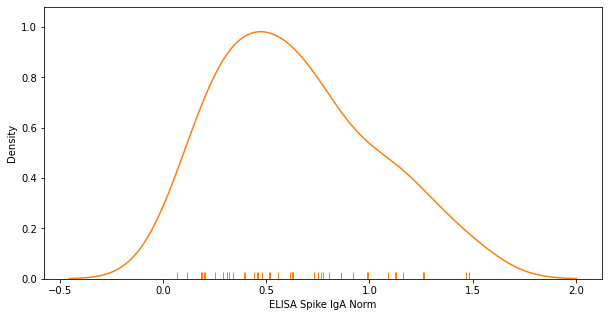

ELISA N IgM Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 0.0013728233752772212
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.013377254744449544


<Figure size 432x288 with 0 Axes>

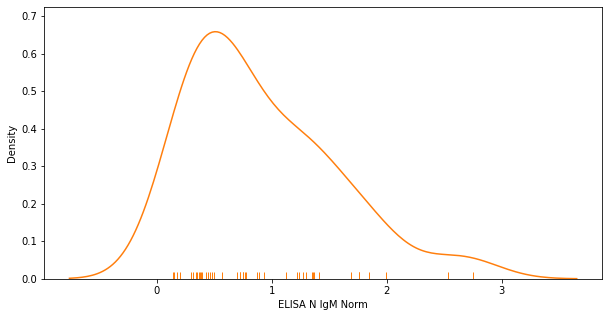

ELISA RBD IgM Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 0.022010577842593193
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.38795429955161376


<Figure size 432x288 with 0 Axes>

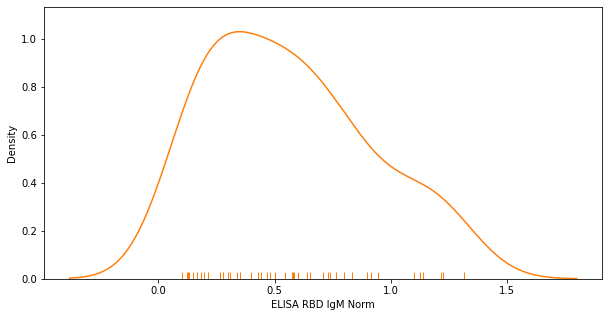

ELISA Spike IgM Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 0.38819798827171326
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.19251344142909443


<Figure size 432x288 with 0 Axes>

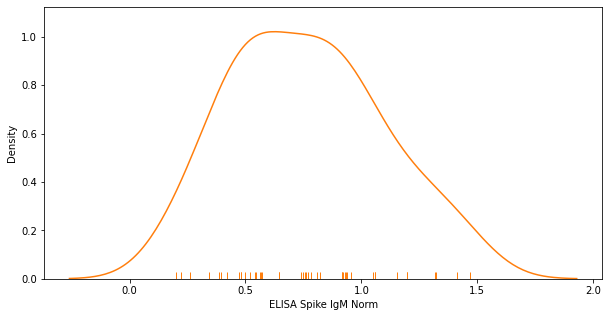







Validation
LIPS Average Bridging:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 9.067330999262043e-15
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

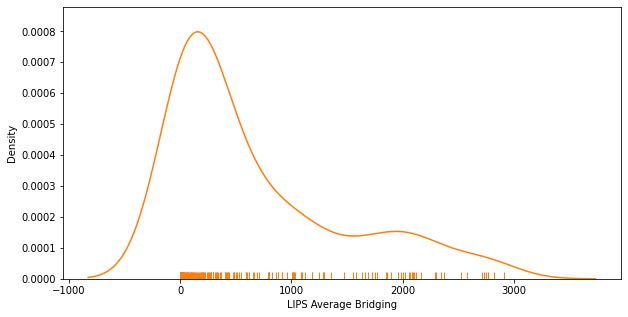

ELISA N Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 1.9547712781786686e-06
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0011814808819013366


<Figure size 432x288 with 0 Axes>

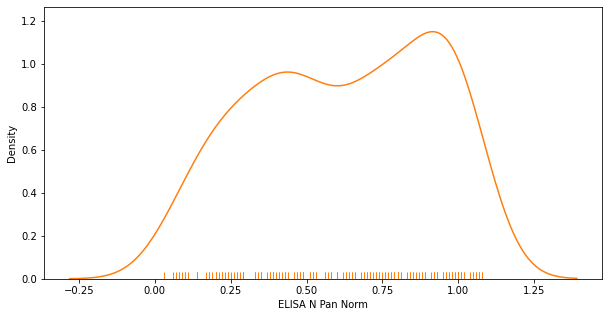

ELISA RBD Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 3.413934024365517e-08
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

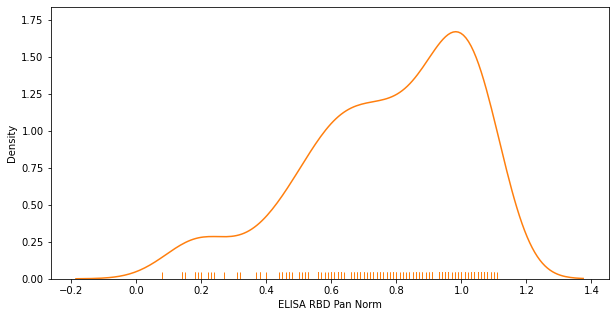

ELISA Spike Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 1.7269091735219125e-15
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

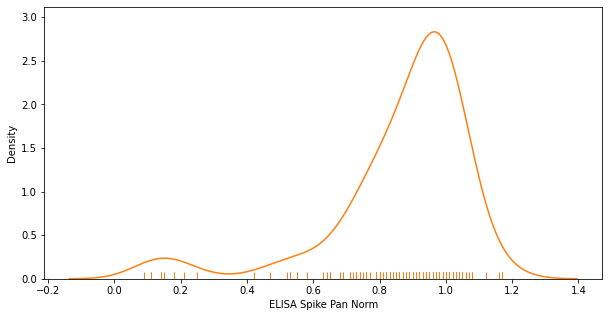

ELISA N IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 3.867513897164035e-15
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

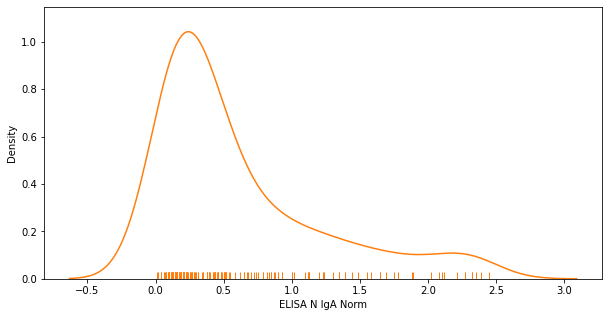

ELISA RBD IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 4.0916766863574594e-08
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

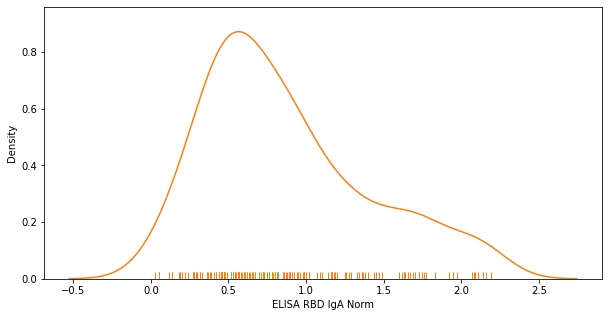

ELISA Spike IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 0.003678187495097518
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.11288251477958247


<Figure size 432x288 with 0 Axes>

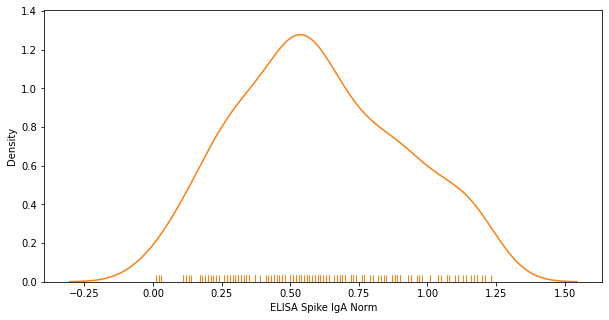







All data
LIPS Average Bridging:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 2.3560051028672178e-17
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

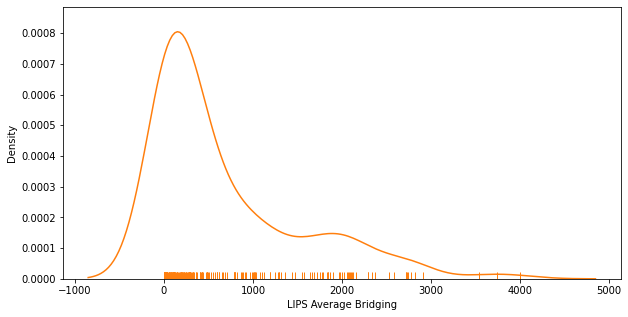

ELISA N Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 1.8982194660566165e-07
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

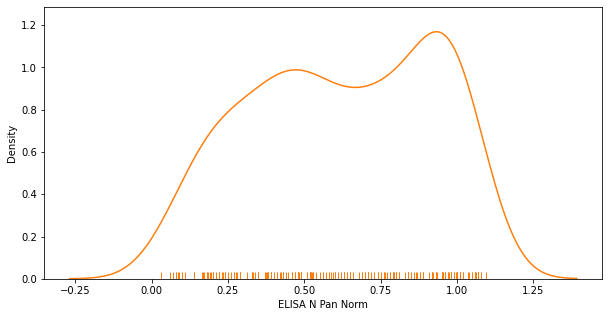

ELISA RBD Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 1.3587595493191884e-09
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

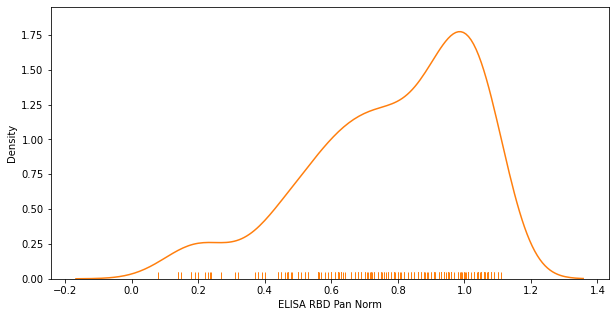

ELISA Spike Pan Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 2.335217061457025e-17
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

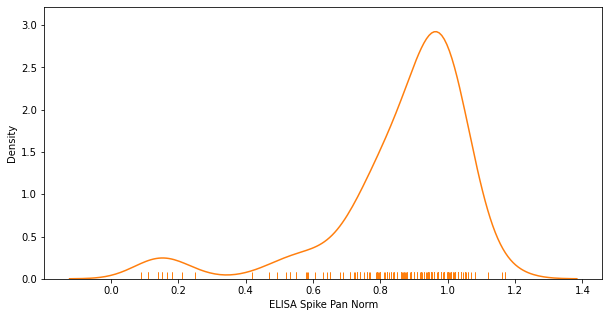

ELISA N IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 1.234664208326532e-16
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

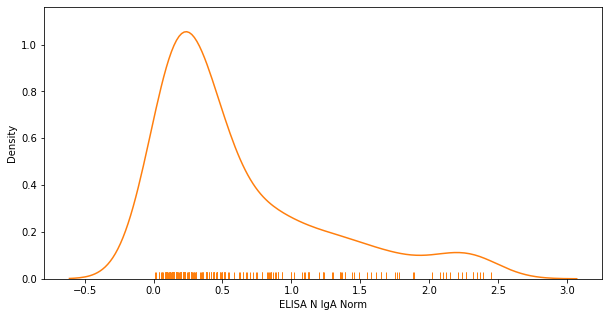

ELISA RBD IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 2.0203532180573802e-09
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

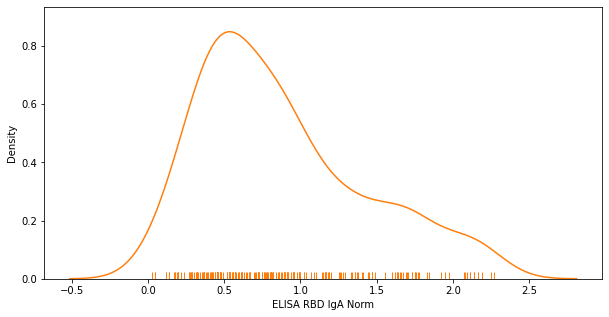

ELISA Spike IgA Norm:
Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? 0.0016283572185784578
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.029890284895175426


<Figure size 432x288 with 0 Axes>

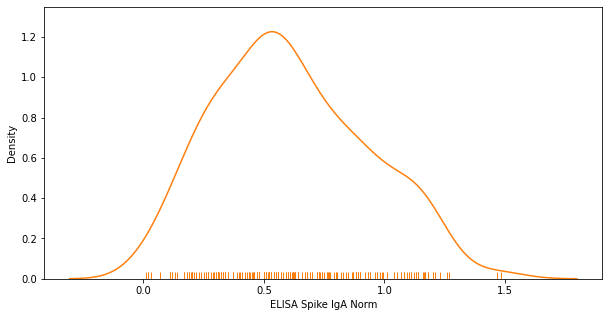

In [48]:
# What does the distribution of the original (unscaled) data look like for positive samples only? Several ML
# algorithms make assumptions about the distribution of continuous variables, therefore we need to see to what
# extent the data meet these assumptions or not. Also calculates Shapiro-Wilks and KS (Lilliefors) tests to see
# whether distribution is significantly different from a normal distribution.
# (FYI, the Shapiro-Wilks test struggles with multiple repeat values, hence may not return an accurate p value for
# the LIPS data in particular.)

for label, df in {'Threshold': pos_cont_thresh_df, 'Validation': pos_cont_val_df, 'All data': pos_cont_comb_df}.items():
    if label == 'Threshold':
        cols = thresh_upd_cont_cols
    else:
        cols = val_upd_cont_cols

    print('\n\n\n\n\n\n{}'.format(label))
    for col in cols:
        print('{}:'.format(col))

        shap_diff = shapiro(df[col])[1]
        print('Significantly different from normal distribution (Shapiro-Wilk test, p < 0.05)? {}'.format(
            shap_diff
        ))
        lilliefors_diff = lilliefors(df[col], 'norm')[1]
        print('Significantly different from normal distribution (Lilliefors test, p < 0.05)? {}'.format(
            lilliefors_diff
        ))

        plt.clf()
        plt.figure(figsize=(10, 5))
        sns.kdeplot(data=df, x=col, color='tab:orange')
        sns.rugplot(data=df, x=col, color='tab:orange')
        plt.show()







Threshold
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 0.04455072805285454
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.19430583567994364


<Figure size 432x288 with 0 Axes>

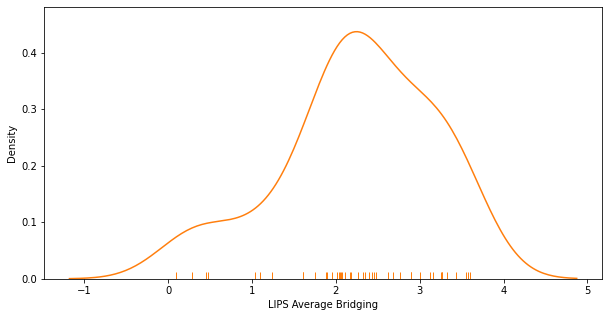

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 0.016656160354614258
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0781992848611208


<Figure size 432x288 with 0 Axes>

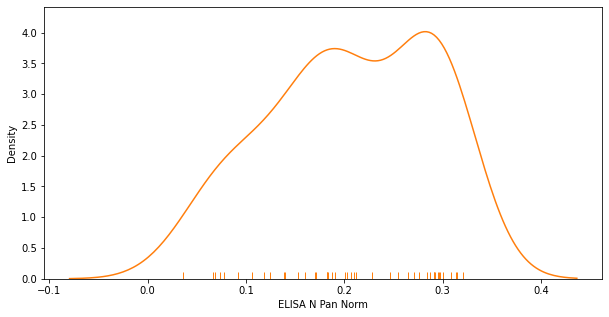

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 0.0003978418535552919
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.013423144887866235


<Figure size 432x288 with 0 Axes>

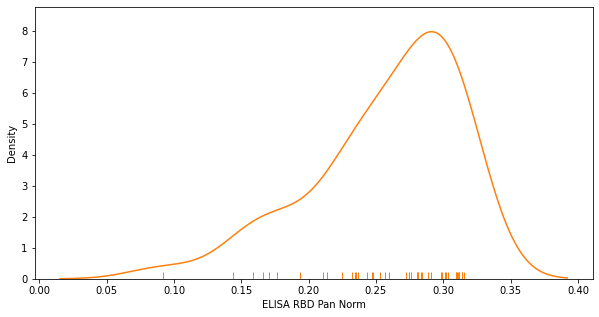

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 3.219276578647623e-08
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

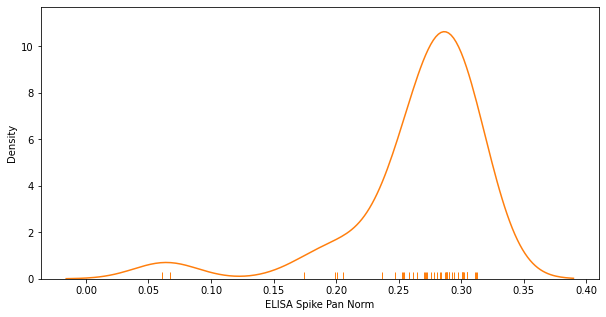

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 0.0002830525627359748
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

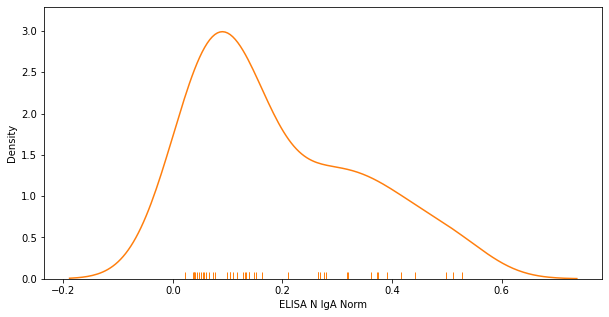

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 0.025316370651125908
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.022236887982940632


<Figure size 432x288 with 0 Axes>

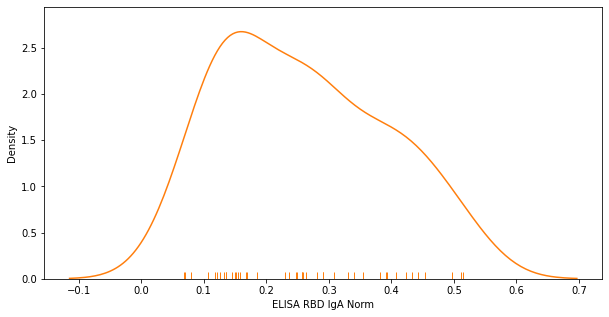

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 0.46189650893211365
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.8792481261669517


<Figure size 432x288 with 0 Axes>

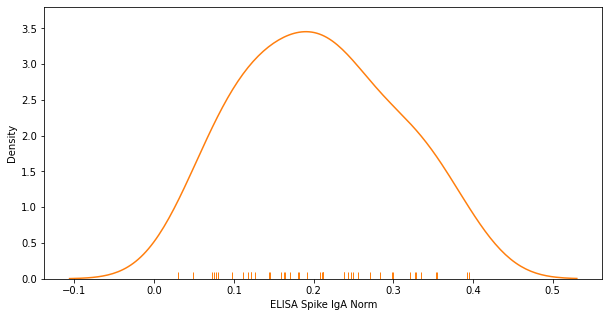

ELISA N IgM Norm
Significantly different from normal distribution (< 0.05)? 0.0786537155508995
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.1330252668337687


<Figure size 432x288 with 0 Axes>

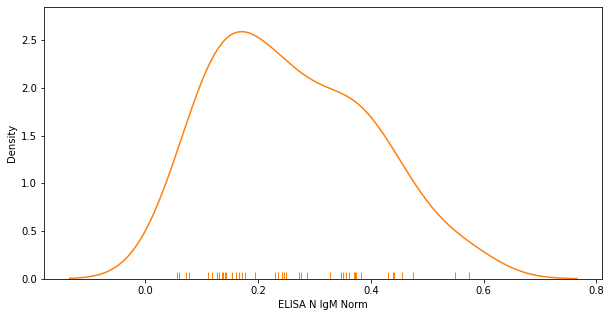

ELISA RBD IgM Norm
Significantly different from normal distribution (< 0.05)? 0.0974460244178772
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.5693248323992749


<Figure size 432x288 with 0 Axes>

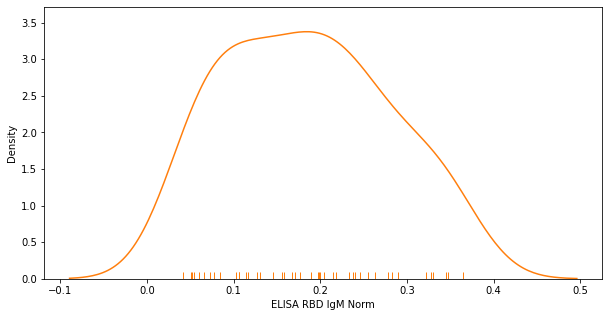

ELISA Spike IgM Norm
Significantly different from normal distribution (< 0.05)? 0.6419320702552795
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.4498167018871066


<Figure size 432x288 with 0 Axes>

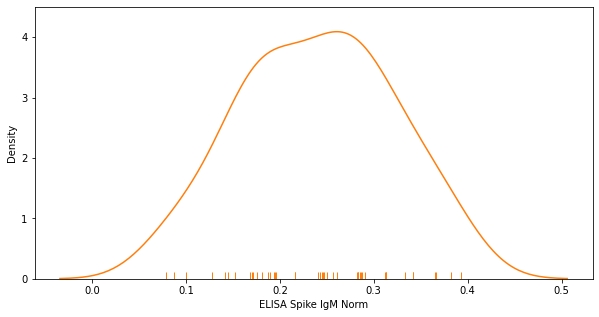







Validation
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 9.12477371439735e-10
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

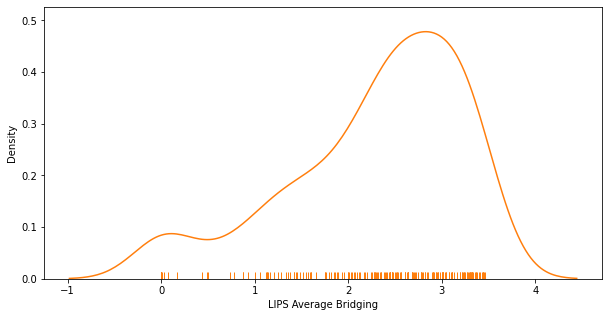

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 3.611640977396746e-07
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

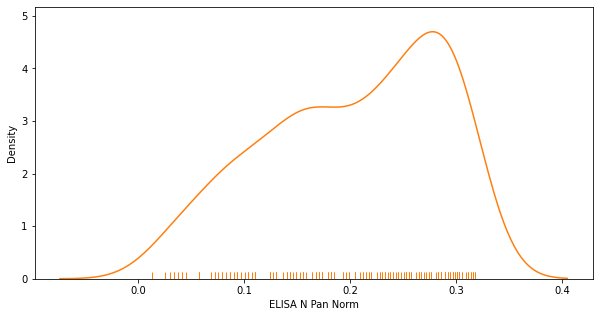

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 2.440369850642554e-10
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

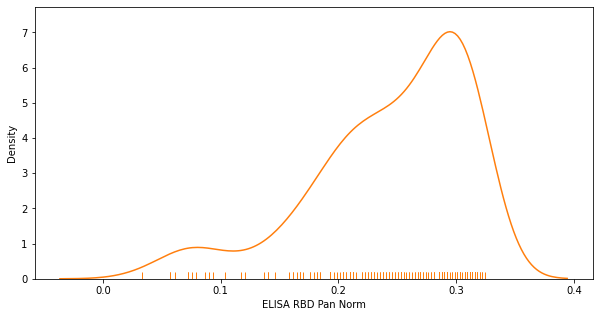

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 6.727508725549915e-18
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

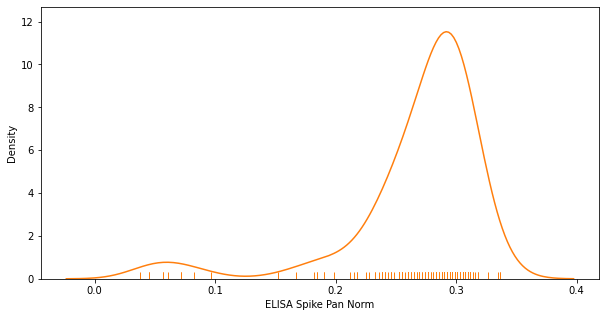

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 1.1500684085619106e-11
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

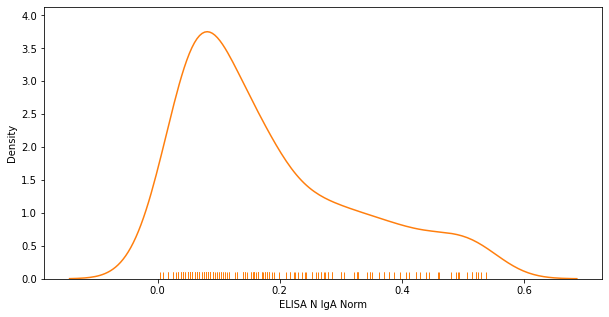

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 0.0010352178942412138
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.014971070715699527


<Figure size 432x288 with 0 Axes>

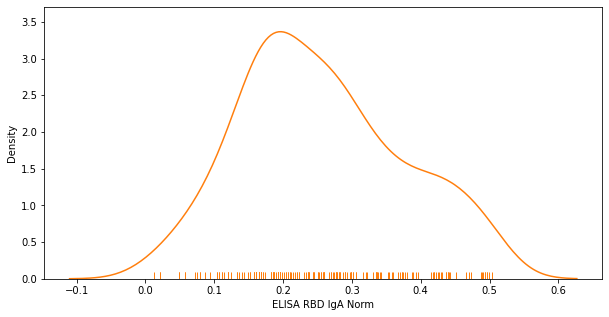

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 0.016603870317339897
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.13179883006084311


<Figure size 432x288 with 0 Axes>

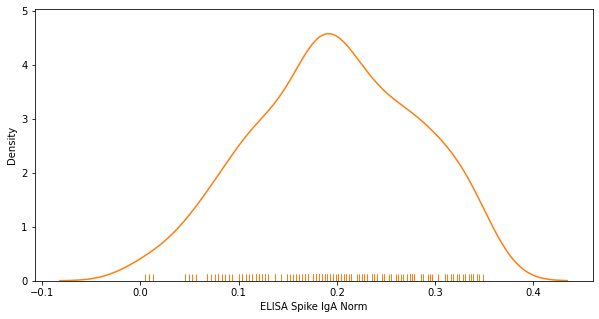







All data
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 4.6115652962974707e-10
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

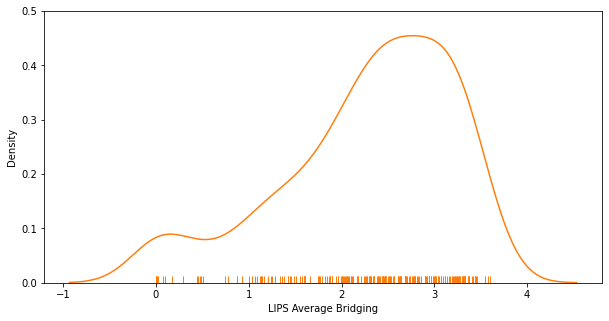

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 3.602460196816537e-08
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

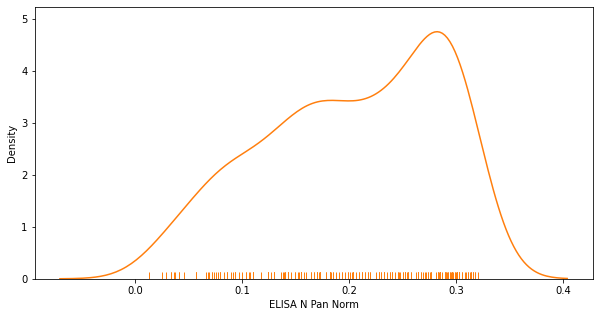

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 6.789115710587046e-12
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

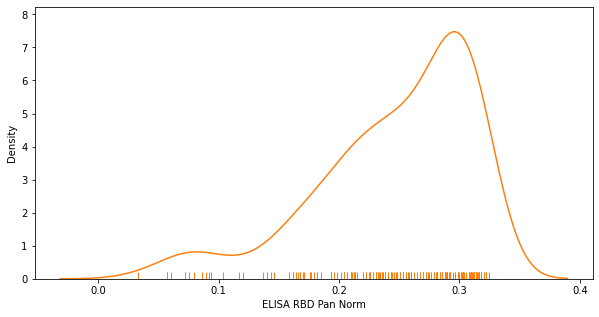

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 6.649220268173622e-20
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

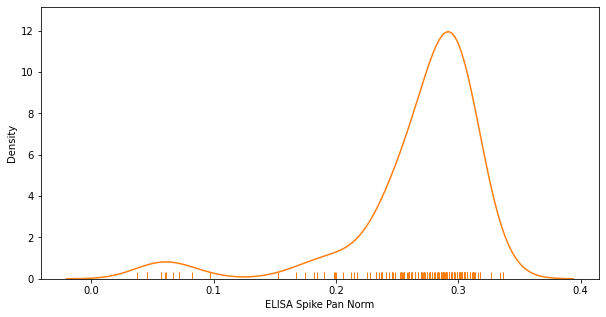

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 5.371991913805108e-13
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

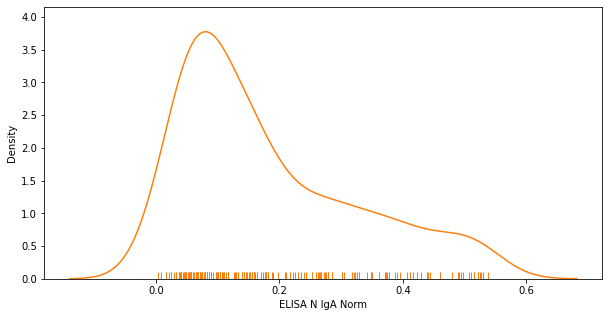

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 0.00011362264194758609
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0022054773060044817


<Figure size 432x288 with 0 Axes>

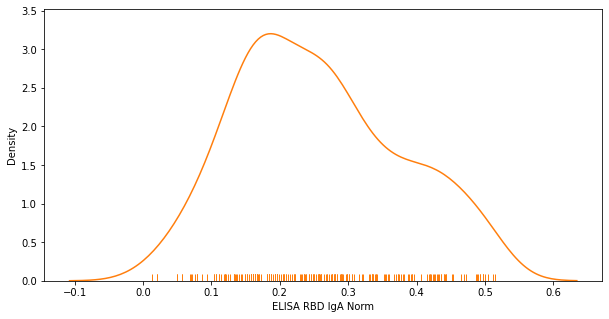

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 0.05388391390442848
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.2651922729649362


<Figure size 432x288 with 0 Axes>

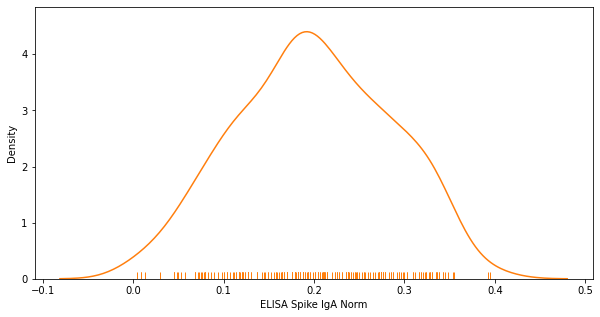

In [49]:
# What do the log distributions look like?
for label, df in {'Threshold': pos_cont_thresh_df, 'Validation': pos_cont_val_df, 'All data': pos_cont_comb_df}.items():
    if label == 'Threshold':
        cols = thresh_upd_cont_cols
    else:
        cols = val_upd_cont_cols

    print('\n\n\n\n\n\n{}'.format(label))
    for col in cols:
        print(col)

        plot_df = copy.deepcopy(df)
        plot_df[col] = np.log10(plot_df[col]+1)

        shap_diff = shapiro(plot_df[col])[1]
        print('Significantly different from normal distribution (< 0.05)? {}'.format(shap_diff))
        lilliefors_diff = lilliefors(plot_df[col], 'norm')[1]
        print('Significantly different from normal distribution (Lilliefors test, p < 0.05)? {}'.format(
            lilliefors_diff
        ))

        plt.clf()
        plt.figure(figsize=(10, 5))
        sns.kdeplot(data=plot_df, x=col, color='tab:orange')
        sns.rugplot(data=plot_df, x=col, color='tab:orange')
        plt.show()







Threshold
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 0.30213919281959534
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.6716624897941896


<Figure size 432x288 with 0 Axes>

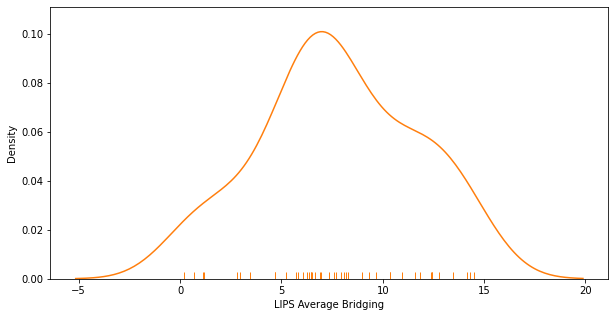

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 0.020891545340418816
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0778201280027242


<Figure size 432x288 with 0 Axes>

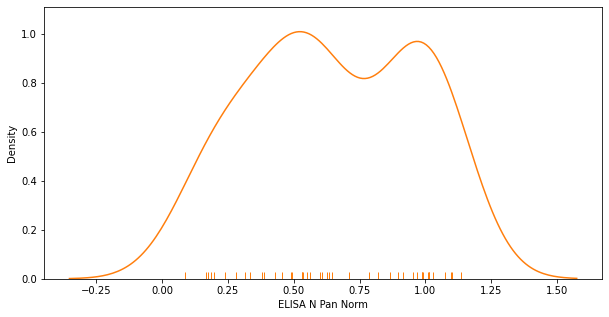

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 0.02604988031089306
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.23008722322608163


<Figure size 432x288 with 0 Axes>

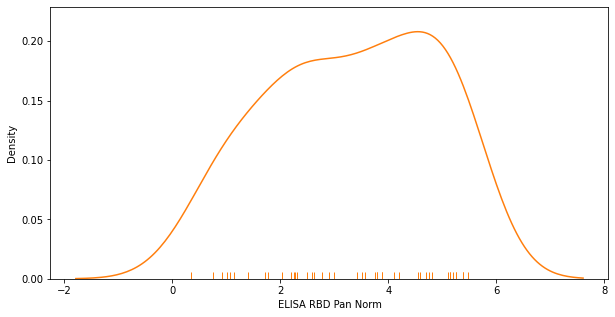

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 0.1936889886856079
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.49989086343713984


<Figure size 432x288 with 0 Axes>

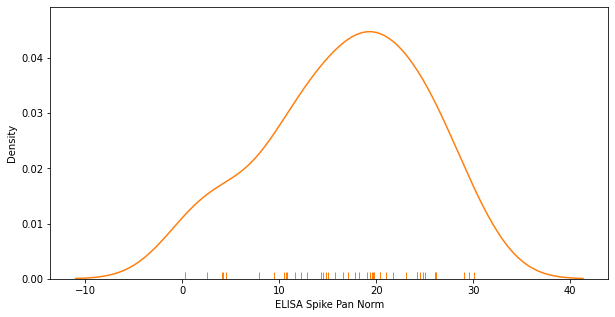

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 0.0044548651203513145
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.05507643120800049


<Figure size 432x288 with 0 Axes>

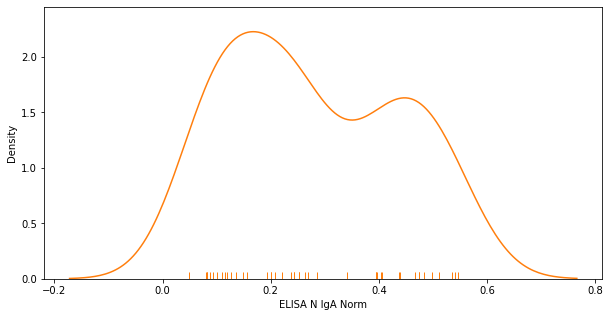

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 0.060442570596933365
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.04854937058767683


<Figure size 432x288 with 0 Axes>

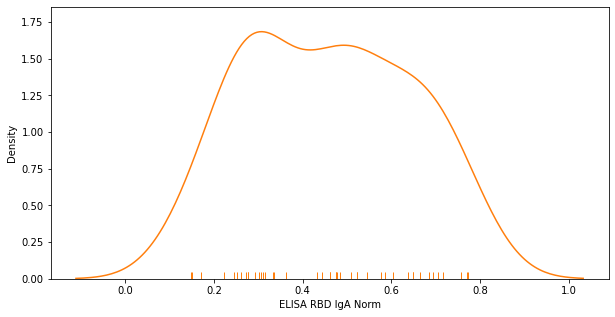

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 0.5474334359169006
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.9119412967410718


<Figure size 432x288 with 0 Axes>

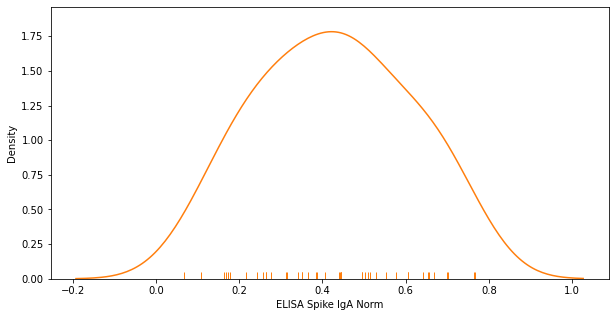

ELISA N IgM Norm
Significantly different from normal distribution (< 0.05)? 0.2040960043668747
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.2593467998567988


<Figure size 432x288 with 0 Axes>

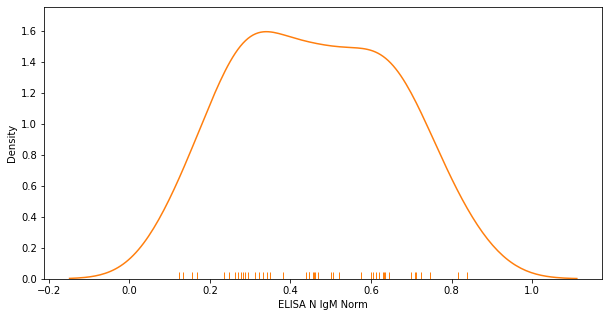

ELISA RBD IgM Norm
Significantly different from normal distribution (< 0.05)? 0.12062864750623703
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.6967191633796935


<Figure size 432x288 with 0 Axes>

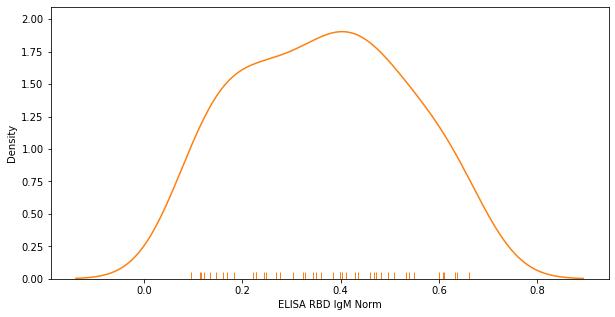

ELISA Spike IgM Norm
Significantly different from normal distribution (< 0.05)? 0.6455520391464233
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.41212867954444987


<Figure size 432x288 with 0 Axes>

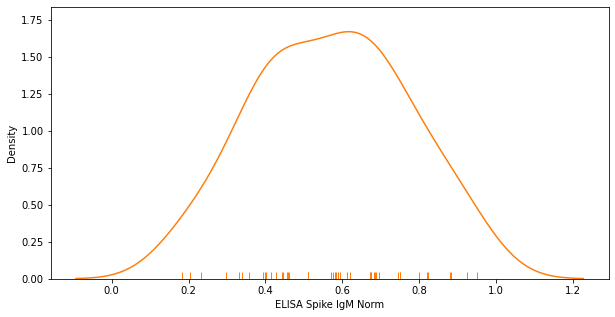







Validation
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 7.416851440211758e-05
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.13459960977496283


<Figure size 432x288 with 0 Axes>

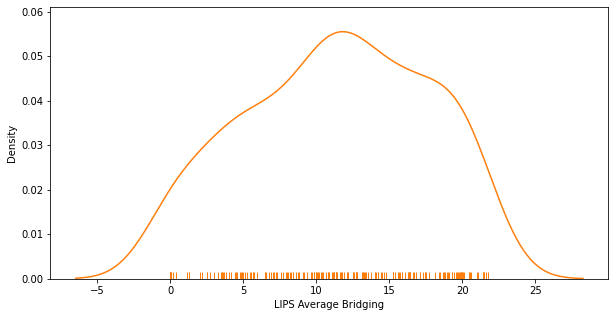

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 2.1808937162859365e-06
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

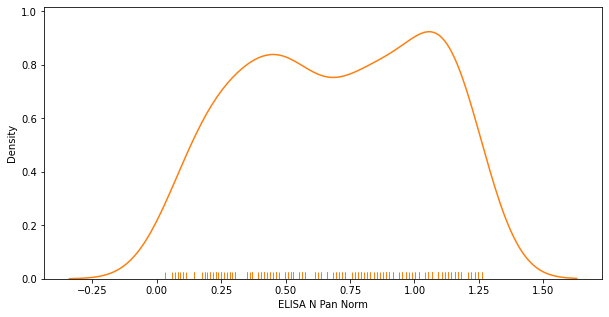

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 7.746565643174108e-06
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

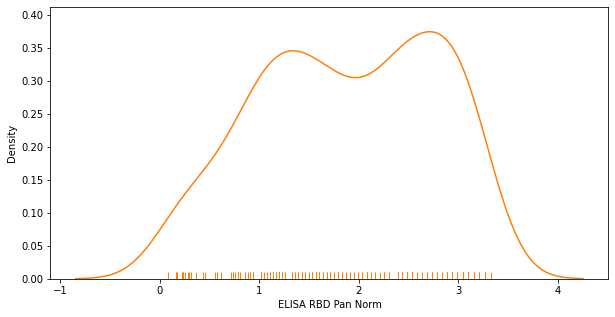

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 0.0008916394435800612
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

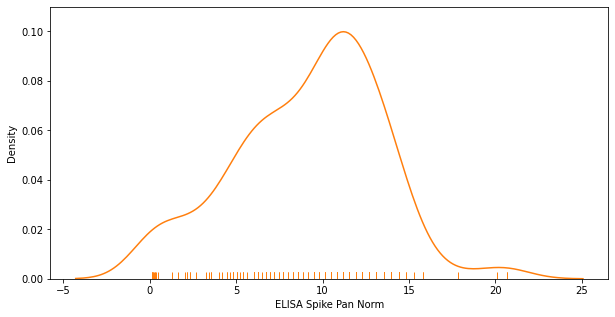

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 7.249462328218215e-07
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

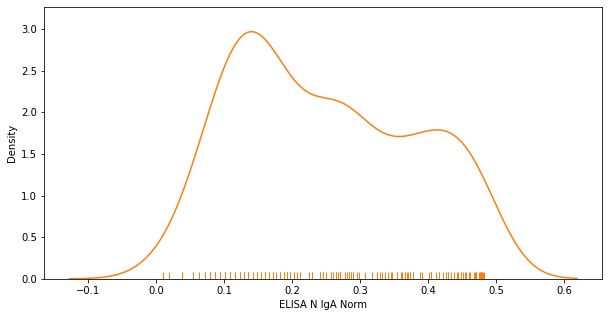

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 0.018606074154376984
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.1468432639111747


<Figure size 432x288 with 0 Axes>

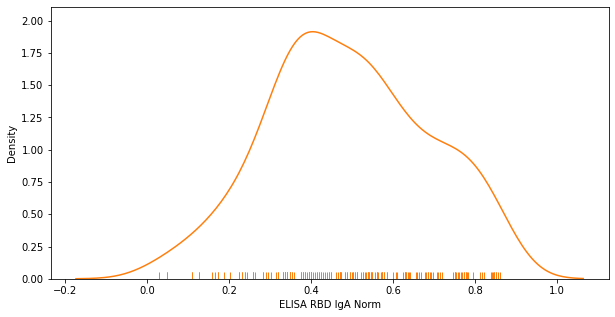

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 0.020139923319220543
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.14719530751396884


<Figure size 432x288 with 0 Axes>

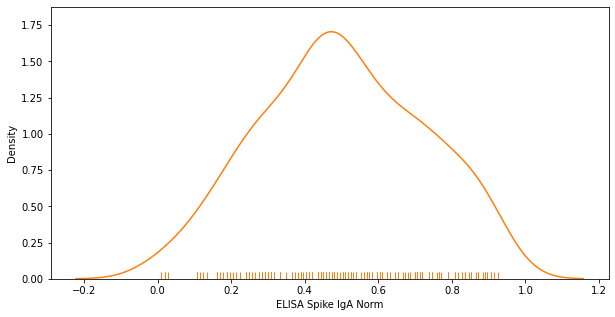







All data
LIPS Average Bridging
Significantly different from normal distribution (< 0.05)? 0.00010937800107058138
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.09966854657585247


<Figure size 432x288 with 0 Axes>

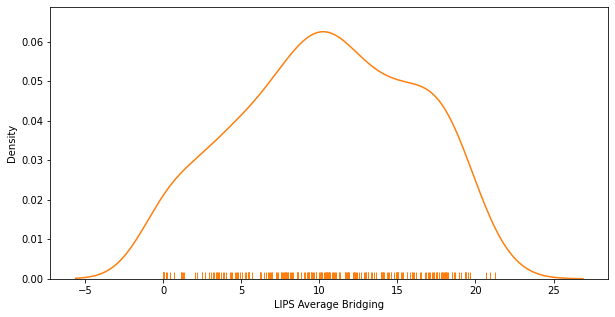

ELISA N Pan Norm
Significantly different from normal distribution (< 0.05)? 1.9976761223006179e-07
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

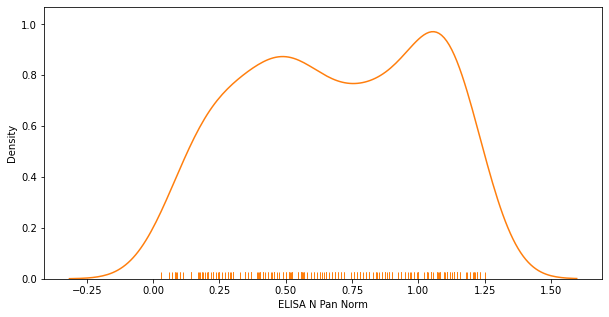

ELISA RBD Pan Norm
Significantly different from normal distribution (< 0.05)? 7.885172408350627e-07
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

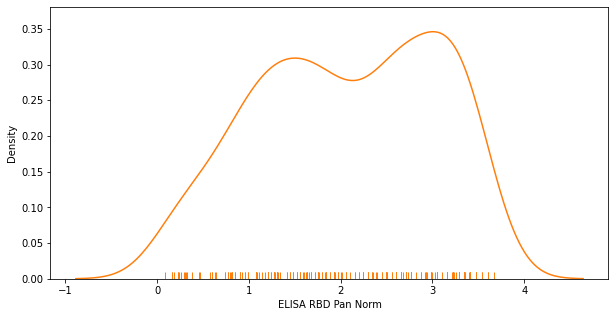

ELISA Spike Pan Norm
Significantly different from normal distribution (< 0.05)? 0.00020401706569828093
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

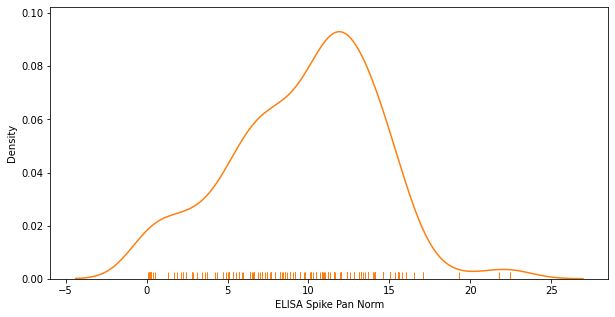

ELISA N IgA Norm
Significantly different from normal distribution (< 0.05)? 3.20979012258249e-08
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.0009999999999998899


<Figure size 432x288 with 0 Axes>

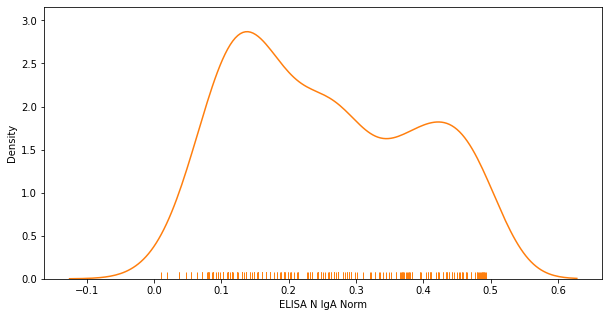

ELISA RBD IgA Norm
Significantly different from normal distribution (< 0.05)? 0.0043392363004386425
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.04848549144225996


<Figure size 432x288 with 0 Axes>

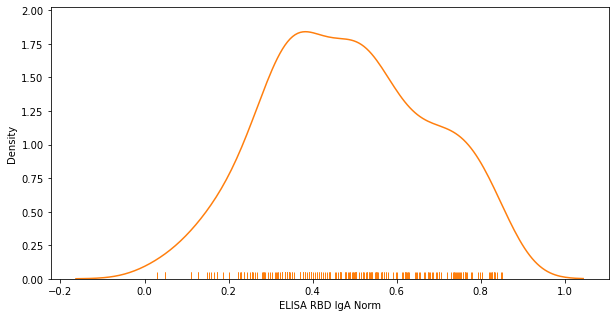

ELISA Spike IgA Norm
Significantly different from normal distribution (< 0.05)? 0.05561282858252525
Significantly different from normal distribution (Lilliefors test, p < 0.05)? 0.24636942439837


<Figure size 432x288 with 0 Axes>

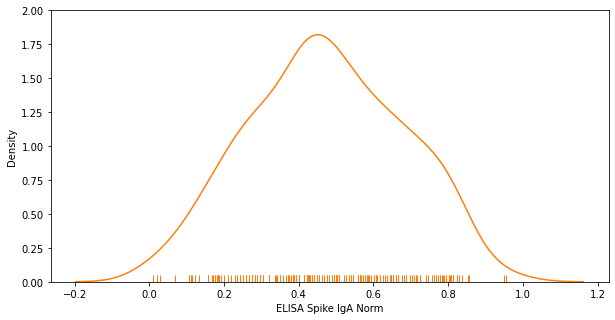

In [50]:
# Box-Cox transformation
for label, df in {'Threshold': pos_cont_thresh_df, 'Validation': pos_cont_val_df, 'All data': pos_cont_comb_df}.items():
    if label == 'Threshold':
        cols = thresh_upd_cont_cols
    else:
        cols = val_upd_cont_cols

    print('\n\n\n\n\n\n{}'.format(label))
    for col in cols:
        print(col)

        plot_df = copy.deepcopy(df)
        transformed_col = boxcox(plot_df[col]+1, lmbda=None)[0]
        plot_df[col] = transformed_col

        shap_diff = shapiro(plot_df[col])[1]
        print('Significantly different from normal distribution (< 0.05)? {}'.format(shap_diff))
        lilliefors_diff = lilliefors(plot_df[col], 'norm')[1]
        print('Significantly different from normal distribution (Lilliefors test, p < 0.05)? {}'.format(
            lilliefors_diff
        ))

        plt.clf()
        plt.figure(figsize=(10, 5))
        sns.kdeplot(data=plot_df, x=col, color='tab:orange')
        sns.rugplot(data=plot_df, x=col, color='tab:orange')
        plt.show()

As might be expected, the distribution of positive samples only is much closer to a normal distribution as compared to all values. Both taking the logarithm and the Box-Cox transform do a good job at transforming the data to an approximately normal distribution (there are a few assays that are exceptions, however they don't deviate so far from a normal distribution that I would be overly concerned about the performance of an ML algorithm that assumes normally distributed data). These transforms perform better on the threshold data than the validation data/all data, but remember that there are ~ 5x fewer samples in the threshold set (=> deviation from normality will be harder to distinguish from noise).

So, in subsequent analysis of the positive samples, could use ML algorithms that require standardisation of data.

In [51]:
# Scale data so values from all assays are on the same scale (to avoid issues with upweighting larger
# scales in subsequent analysis - although not a problem for tree-based algorithms, is a problem for SVM).
# Since data is heavily positively skewed, and LIPS data is on a very different scale to the ELISA data, use
# MinMaxScaler as opposed to any method that makes assumptions about the data following an approximate Gaussian
# distribution (such as e.g. RobustScaler)

thresh_min_max_transform = MinMaxScaler().fit(cont_thresh_df[thresh_upd_cont_cols])
scaled_thresh_df = pd.DataFrame(
    thresh_min_max_transform.transform(cont_thresh_df[thresh_upd_cont_cols]), index=range(cont_thresh_df.shape[0]),
    columns=thresh_upd_cont_cols
)
scaled_thresh_df = pd.concat(
    [scaled_thresh_df, cont_thresh_df[thresh_output_cols + ['Dataset ID']]], axis=1
).reset_index(drop=True)

val_min_max_transform = MinMaxScaler().fit(cont_val_df[val_upd_cont_cols])
scaled_val_df = pd.DataFrame(
    val_min_max_transform.transform(cont_val_df[val_upd_cont_cols]), index=range(cont_val_df.shape[0]),
    columns=val_upd_cont_cols
)
scaled_val_df = pd.concat(
    [scaled_val_df, cont_val_df[val_output_cols + ['Dataset ID']]], axis=1
).reset_index(drop=True)

comb_min_max_transform = MinMaxScaler().fit(cont_comb_df[val_upd_cont_cols])
scaled_comb_df = pd.DataFrame(
    comb_min_max_transform.transform(cont_comb_df[val_upd_cont_cols]), index=range(cont_comb_df.shape[0]),
    columns=val_upd_cont_cols
)
scaled_comb_df = pd.concat(
    [scaled_comb_df, cont_comb_df[val_output_cols + ['Dataset ID']]], axis=1
).reset_index(drop=True)

In [52]:
scaled_thresh_df

,LIPS Average Bridging,ELISA N Pan Norm,ELISA RBD Pan Norm,ELISA Spike Pan Norm,ELISA N IgA Norm,ELISA RBD IgA Norm,ELISA Spike IgA Norm,ELISA N IgM Norm,ELISA RBD IgM Norm,ELISA Spike IgM Norm,Status,Dataset ID
0,0.000046,0.069847,0.194924,0.087520,0.024489,0.168545,0.158084,0.197668,0.111154,0.259327,Pre-pandemic,Threshold set
1,0.000000,0.154426,0.675641,0.428489,0.066088,0.147645,0.140907,0.105975,0.066251,0.187902,Pre-pandemic,Threshold set
2,0.000000,0.148408,0.291675,0.133949,0.077119,0.178343,0.065457,0.360241,0.096977,0.208137,Pre-pandemic,Threshold set
3,0.000000,0.096599,0.252159,0.169846,0.024020,0.085507,0.040829,0.182536,0.068936,0.187783,Pre-pandemic,Threshold set
4,0.000000,0.140003,0.183328,0.068053,0.227950,0.213012,0.234152,0.132439,0.042187,0.120958,Pre-pandemic,Threshold set
...,...,...,...,...,...,...,...,...,...,...,...,...
431,0.529247,0.887369,0.972587,0.896462,0.907455,0.942020,0.849132,1.000000,0.835777,0.814271,PCR confirmed,Threshold set
432,0.019619,0.464803,0.612010,0.769190,0.382477,1.000000,0.991096,0.321513,0.227781,0.337556,PCR confirmed,Threshold set
433,0.461000,0.945520,0.993042,0.928822,0.745150,0.811982,0.756784,0.637132,0.719143,0.718527,PCR confirmed,Threshold set
434,0.886792,0.869479,0.919648,0.948176,0.616417,0.781435,0.735726,0.639908,0.456800,0.547935,PCR confirmed,Threshold set


In [53]:
scaled_val_df

,LIPS Average Bridging,ELISA N Pan Norm,ELISA RBD Pan Norm,ELISA Spike Pan Norm,ELISA N IgA Norm,ELISA RBD IgA Norm,ELISA Spike IgA Norm,Status,Dataset ID
0,0.166234,0.386792,0.514563,0.678899,0.069388,0.206422,0.276423,PCR confirmed,Validation set
1,0.236926,0.433962,0.640777,0.724771,0.085714,0.201835,0.284553,PCR confirmed,Validation set
2,0.888439,0.933962,0.951456,0.889908,0.322449,0.366972,0.650407,PCR confirmed,Validation set
3,0.385614,0.311321,0.601942,0.623853,0.040816,0.233945,0.276423,PCR confirmed,Validation set
4,0.148823,0.584906,0.776699,0.862385,0.502041,0.954128,0.764228,PCR confirmed,Validation set
...,...,...,...,...,...,...,...,...,...
766,0.000000,0.037736,0.165049,0.275229,0.044898,0.114679,0.089431,Pre-pandemic,Validation set
767,0.000000,0.122642,0.126214,0.110092,0.028571,0.068807,0.089431,Pre-pandemic,Validation set
768,0.000000,0.122642,0.067961,0.082569,0.097959,0.100917,0.040650,Pre-pandemic,Validation set
769,0.000000,0.094340,0.097087,0.128440,0.061224,0.073394,0.065041,Pre-pandemic,Validation set


In [54]:
scaled_comb_df

,LIPS Average Bridging,ELISA N Pan Norm,ELISA RBD Pan Norm,ELISA Spike Pan Norm,ELISA N IgA Norm,ELISA RBD IgA Norm,ELISA Spike IgA Norm,Status,Dataset ID
0,0.000046,0.078642,0.187175,0.078480,0.023668,0.171424,0.161130,Pre-pandemic,Threshold set
1,0.000000,0.162421,0.648781,0.384227,0.063871,0.150596,0.144015,Pre-pandemic,Threshold set
2,0.000000,0.156460,0.280080,0.120112,0.074532,0.181188,0.068838,Pre-pandemic,Threshold set
3,0.000000,0.105141,0.242135,0.152301,0.023215,0.088674,0.044299,Pre-pandemic,Threshold set
4,0.000000,0.148134,0.176040,0.061024,0.220304,0.215737,0.236923,Pre-pandemic,Threshold set
...,...,...,...,...,...,...,...,...,...
1202,0.000000,0.037235,0.177101,0.288341,0.046712,0.110802,0.074236,Pre-pandemic,Validation set
1203,0.000000,0.121015,0.138827,0.126190,0.030417,0.066481,0.074236,Pre-pandemic,Validation set
1204,0.000000,0.121015,0.081415,0.099165,0.099673,0.097506,0.033744,Pre-pandemic,Validation set
1205,0.000000,0.093088,0.110121,0.144207,0.063008,0.070913,0.053990,Pre-pandemic,Validation set


In [55]:
# Scales data in positive-only samples dataframe

pos_thresh_min_max_transform = MinMaxScaler().fit(pos_cont_thresh_df[thresh_upd_cont_cols])
pos_scaled_thresh_df = pd.DataFrame(
    pos_thresh_min_max_transform.transform(pos_cont_thresh_df[thresh_upd_cont_cols]),
    index=range(pos_cont_thresh_df.shape[0]), columns=thresh_upd_cont_cols
)
pos_scaled_thresh_df = pd.concat(
    [pos_scaled_thresh_df, pos_cont_thresh_df[thresh_output_cols + ['Dataset ID']]], axis=1
).reset_index(drop=True)

pos_val_min_max_transform = MinMaxScaler().fit(pos_cont_val_df[val_upd_cont_cols])
pos_scaled_val_df = pd.DataFrame(
    pos_val_min_max_transform.transform(pos_cont_val_df[val_upd_cont_cols]),
    index=range(pos_cont_val_df.shape[0]), columns=val_upd_cont_cols
)
pos_scaled_val_df = pd.concat(
    [pos_scaled_val_df, pos_cont_val_df[val_output_cols + ['Dataset ID']]], axis=1
).reset_index(drop=True)

pos_comb_min_max_transform = MinMaxScaler().fit(pos_cont_comb_df[val_upd_cont_cols])
pos_scaled_comb_df = pd.DataFrame(
    pos_comb_min_max_transform.transform(pos_cont_comb_df[val_upd_cont_cols]),
    index=range(pos_cont_comb_df.shape[0]), columns=val_upd_cont_cols
)
pos_scaled_comb_df = pd.concat(
    [pos_scaled_comb_df, pos_cont_comb_df[val_output_cols + ['Dataset ID']]], axis=1
).reset_index(drop=True)

In [56]:
pos_scaled_thresh_df

,LIPS Average Bridging,ELISA N Pan Norm,ELISA RBD Pan Norm,ELISA Spike Pan Norm,ELISA N IgA Norm,ELISA RBD IgA Norm,ELISA Spike IgA Norm,ELISA N IgM Norm,ELISA RBD IgM Norm,ELISA Spike IgM Norm,Status,Dataset ID
0,0.009726,0.078470,0.581315,0.885828,0.038743,0.521908,0.520238,0.080550,0.603412,0.668859,PCR confirmed,Threshold set
1,0.002428,0.333672,0.245971,0.634487,0.017968,0.304385,0.394748,0.086608,0.169117,0.291213,PCR confirmed,Threshold set
2,0.037433,0.242790,0.812392,0.936082,0.049432,0.287958,0.469489,0.304771,0.671271,0.784168,PCR confirmed,Threshold set
3,0.018614,0.775137,0.811768,0.853859,1.000000,0.618362,0.492225,0.653417,0.444347,0.565676,PCR confirmed,Threshold set
4,0.029491,0.356712,0.620464,0.713928,0.175417,0.485721,0.467238,0.214452,0.279624,0.439184,PCR confirmed,Threshold set
5,0.055620,0.290623,0.863788,0.904149,0.126271,0.080574,0.393407,0.431533,0.244134,0.349202,PCR confirmed,Threshold set
6,0.025555,0.829380,0.925344,0.895032,0.564653,0.171895,0.653007,0.916588,0.396722,0.582337,PCR confirmed,Threshold set
7,0.013750,0.520174,0.700233,0.827775,0.094652,0.375090,0.481214,0.131489,0.365919,0.432907,PCR confirmed,Threshold set
8,0.004036,0.530057,0.576283,0.792059,0.101176,0.620640,0.602172,0.233649,0.145369,0.424747,PCR confirmed,Threshold set
9,0.027201,0.795384,0.920394,0.956987,0.442233,0.318002,0.233287,0.594134,0.545175,0.675368,PCR confirmed,Threshold set


In [57]:
pos_scaled_val_df

,LIPS Average Bridging,ELISA N Pan Norm,ELISA RBD Pan Norm,ELISA Spike Pan Norm,ELISA N IgA Norm,ELISA RBD IgA Norm,ELISA Spike IgA Norm,Status,Dataset ID
0,0.166234,0.380952,0.514563,0.675926,0.065574,0.199074,0.270492,PCR confirmed,Validation set
1,0.236926,0.428571,0.640777,0.722222,0.081967,0.194444,0.278689,PCR confirmed,Validation set
2,0.888439,0.933333,0.951456,0.888889,0.319672,0.361111,0.647541,PCR confirmed,Validation set
3,0.385614,0.304762,0.601942,0.620370,0.036885,0.226852,0.270492,PCR confirmed,Validation set
4,0.148823,0.580952,0.776699,0.861111,0.500000,0.953704,0.762295,PCR confirmed,Validation set
...,...,...,...,...,...,...,...,...,...
185,0.005198,0.104762,0.233010,0.351852,0.049180,0.134259,0.401639,PCR confirmed,Validation set
186,0.000749,0.857143,0.776699,0.657407,0.459016,0.208333,0.475410,PCR confirmed,Validation set
187,0.096518,0.942857,0.679612,0.990741,0.377049,0.412037,0.475410,PCR confirmed,Validation set
188,0.000608,0.247619,0.184466,0.518519,0.077869,0.740741,0.877049,PCR confirmed,Validation set


In [58]:
pos_scaled_comb_df

,LIPS Average Bridging,ELISA N Pan Norm,ELISA RBD Pan Norm,ELISA Spike Pan Norm,ELISA N IgA Norm,ELISA RBD IgA Norm,ELISA Spike IgA Norm,Status,Dataset ID
0,0.009785,0.127373,0.620970,0.798233,0.053704,0.551807,0.539864,PCR confirmed,Threshold set
1,0.002487,0.369033,0.349694,0.587794,0.033982,0.347887,0.419508,PCR confirmed,Threshold set
2,0.037490,0.282973,0.807898,0.840308,0.063852,0.332487,0.491192,PCR confirmed,Threshold set
3,0.018672,0.787070,0.807394,0.771466,0.966258,0.642229,0.512998,PCR confirmed,Threshold set
4,0.029549,0.390850,0.652639,0.654307,0.183454,0.517883,0.489033,PCR confirmed,Threshold set
...,...,...,...,...,...,...,...,...,...
229,0.003781,0.103360,0.233010,0.351852,0.049180,0.129680,0.332933,PCR confirmed,Validation set
230,0.000545,0.845669,0.776699,0.657407,0.459016,0.201227,0.394084,PCR confirmed,Validation set
231,0.070196,0.930236,0.679612,0.990741,0.377049,0.397983,0.394084,PCR confirmed,Validation set
232,0.000442,0.244304,0.184466,0.518519,0.077869,0.715475,0.727018,PCR confirmed,Validation set


#### Q1: Which individual assays are best at discriminating between positive and negative samples? 

<Figure size 432x288 with 0 Axes>

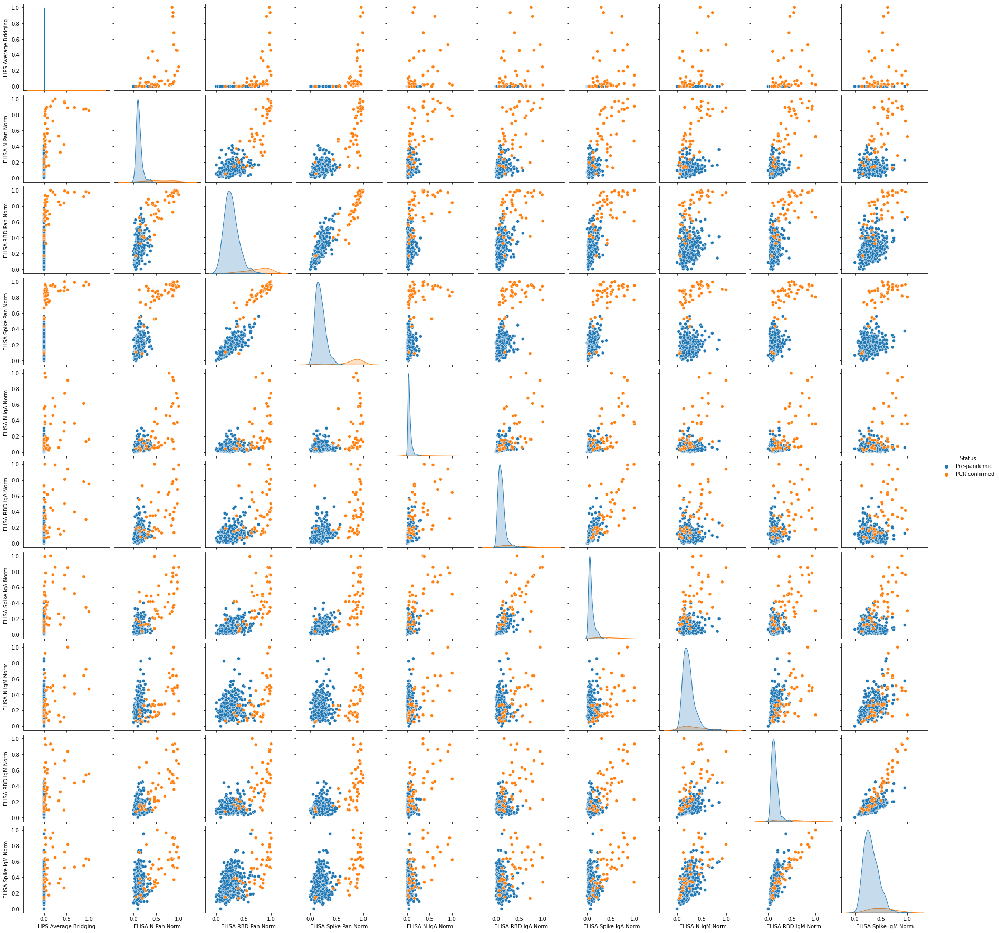

In [59]:
plt.clf()
sns.pairplot(scaled_thresh_df.drop('Dataset ID', axis=1), hue='Status',
             hue_order={'Pre-pandemic': 'tab:blue', 'PCR confirmed': 'tab:orange'})
plt.show()

<Figure size 432x288 with 0 Axes>

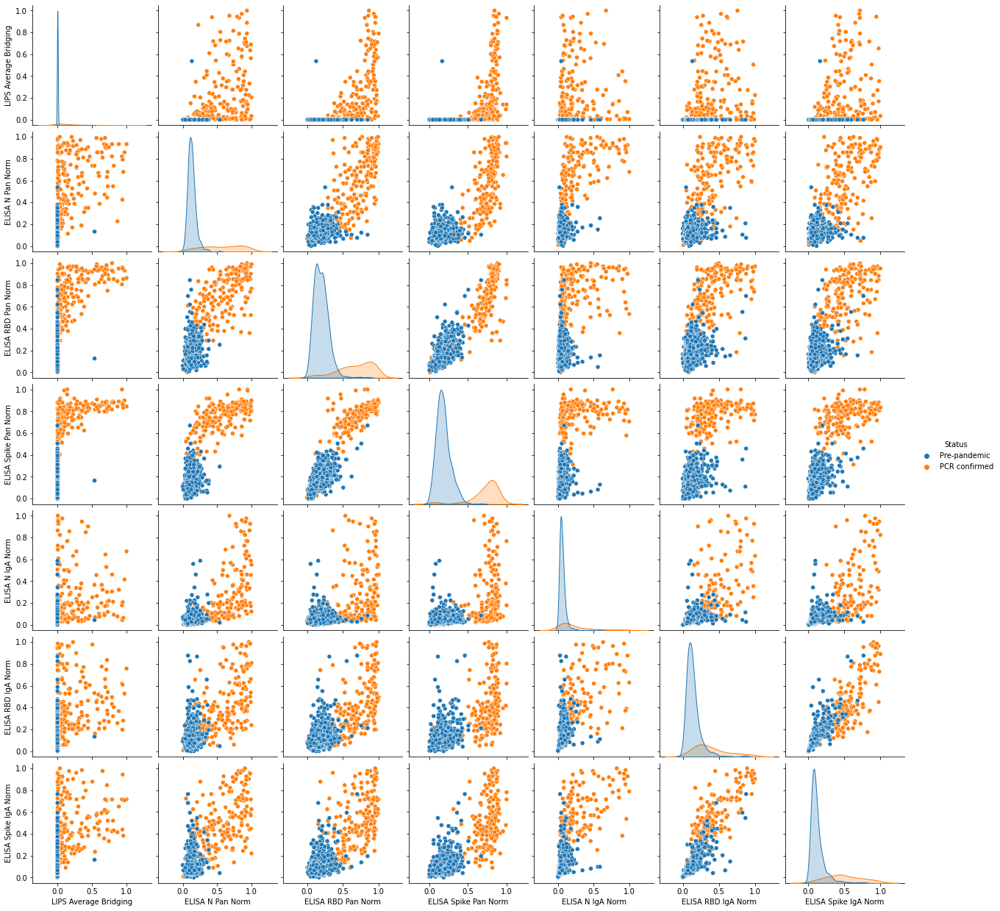

In [60]:
plt.clf()
sns.pairplot(scaled_val_df.drop('Dataset ID', axis=1), hue='Status',
             hue_order={'Pre-pandemic': 'tab:blue', 'PCR confirmed': 'tab:orange'})
plt.show()

<Figure size 432x288 with 0 Axes>

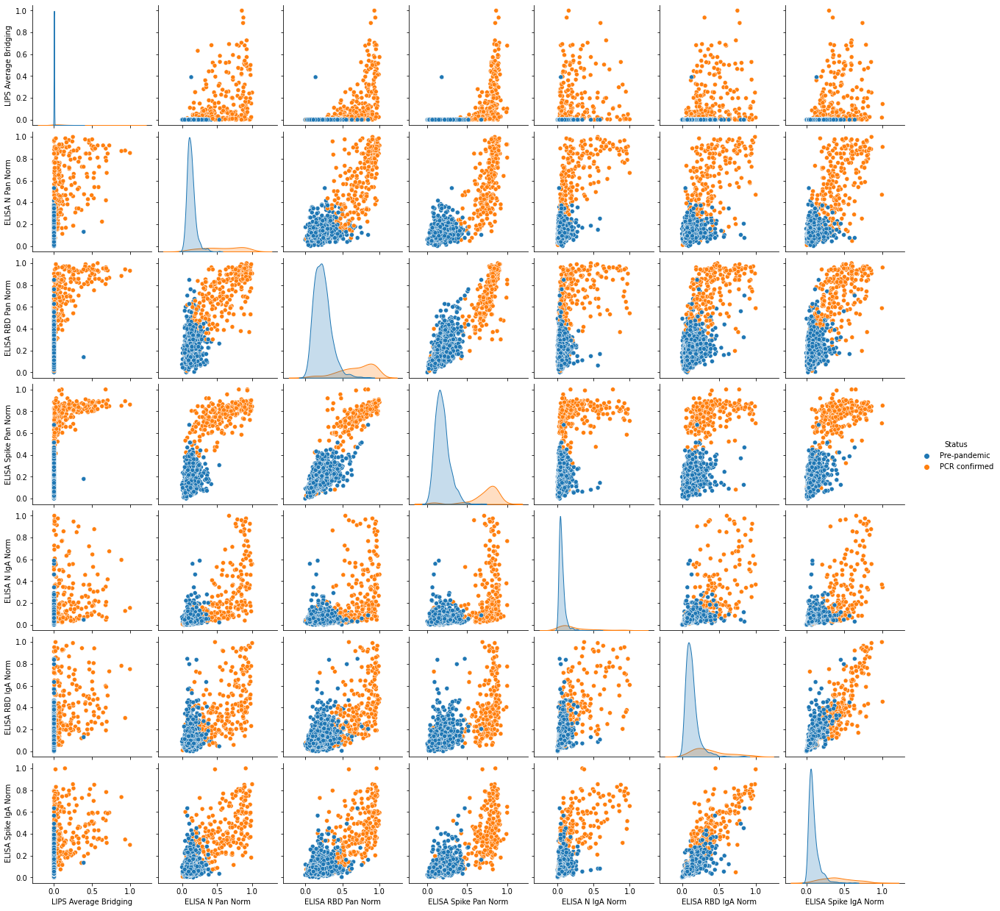

In [61]:
plt.clf()
sns.pairplot(scaled_comb_df.drop('Dataset ID', axis=1), hue='Status',
             hue_order={'Pre-pandemic': 'tab:blue', 'PCR confirmed': 'tab:orange'})
plt.show()

Encouragingly, results are pretty consistent across the three datasets (although can't compare IgM results in the threshold dataset to the validation set)! By eye, best separation is achieved with the PanIg assays, especially Spike PanIg. However, bear in mind that plots are on a linear scale => will be more difficult to distinguish differences between skewed data by eye (therefore is difficult to compare the LIPS data to the ELISA data in these plots).

In [62]:
def calc_kde_overlap(negative_df, positive_df, col, x_min, x_max):
    # Code below taken from https://stackoverflow.com/questions/20381672/calculate-overlap-area-of-two-functions
    x_pts = np.mgrid[x_min:x_max:1000j]
    neg_kernel = gaussian_kde(negative_df[col], bw_method='scott', weights=None)
    pos_kernel = gaussian_kde(positive_df[col], bw_method='scott', weights=None)
    neg_kde = np.reshape(neg_kernel(x_pts).T, x_pts.shape)
    pos_kde = np.reshape(pos_kernel(x_pts).T, x_pts.shape)
    overlap = 0

    for index, pt in np.ndenumerate(x_pts):
        index = index[0]
        if index != (x_pts.shape[0] - 1):
            y1_neg = neg_kde[index]
            y2_neg = neg_kde[index+1]
            y1_pos = pos_kde[index]
            y2_pos = pos_kde[index+1]
            height = x_pts[index+1] - x_pts[index]

            if y1_pos <= y1_neg and y2_pos <= y2_neg:
                area = ((y1_pos + y2_pos)*0.5*height)
            elif y1_pos >= y1_neg and y2_pos >= y2_neg:
                area = ((y1_neg + y2_neg)*0.5*height)
            else:
                area = 0
            overlap += area
            
    return overlap







Threshold
LIPS Average Bridging


<Figure size 432x288 with 0 Axes>

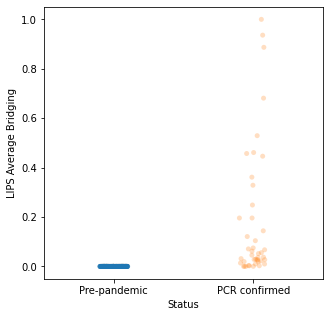

<Figure size 432x288 with 0 Axes>

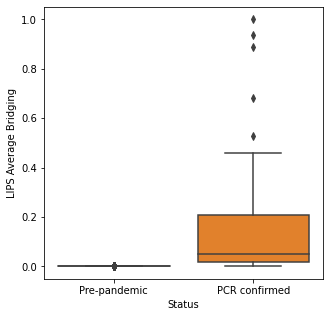

<Figure size 432x288 with 0 Axes>

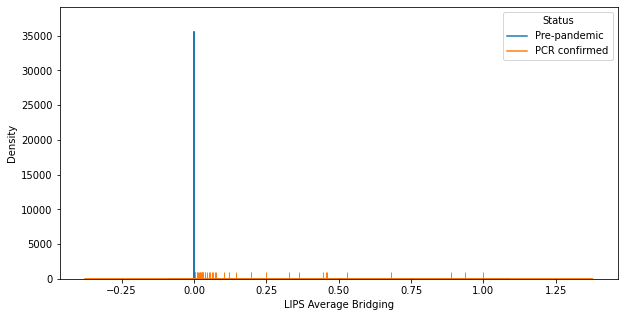

KDE Overlap: 2.0107949292526666e-245



ELISA N Pan Norm


<Figure size 432x288 with 0 Axes>

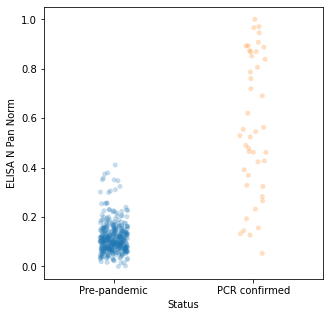

<Figure size 432x288 with 0 Axes>

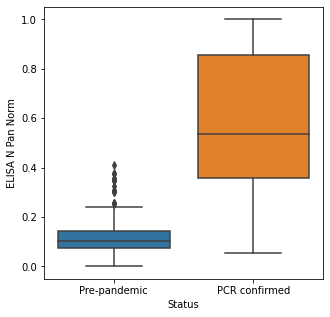

<Figure size 432x288 with 0 Axes>

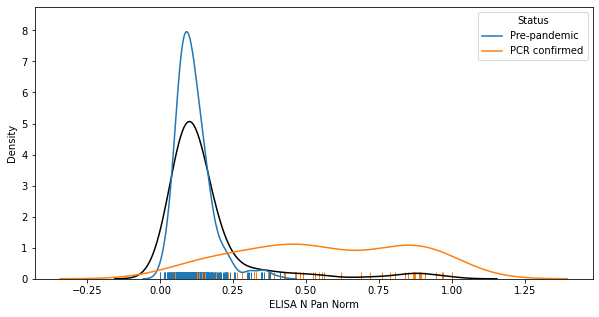

KDE Overlap: 0.188612081278725



ELISA RBD Pan Norm


<Figure size 432x288 with 0 Axes>

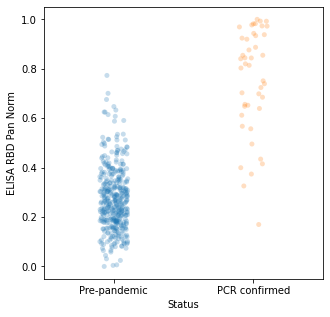

<Figure size 432x288 with 0 Axes>

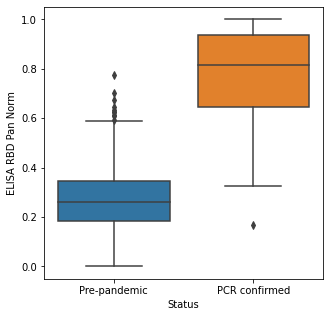

<Figure size 432x288 with 0 Axes>

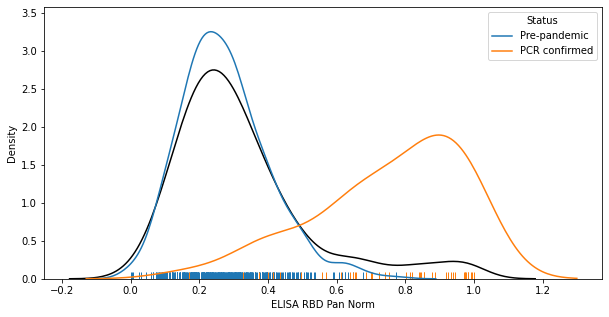

KDE Overlap: 0.2093544042348708



ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

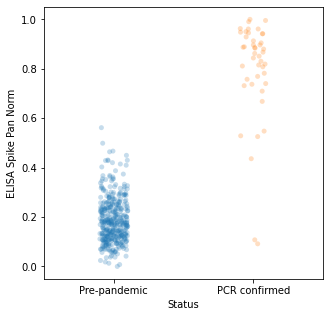

<Figure size 432x288 with 0 Axes>

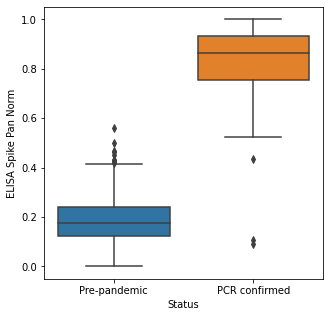

<Figure size 432x288 with 0 Axes>

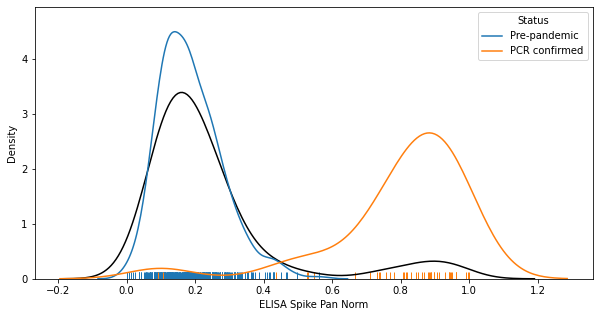

KDE Overlap: 0.08132168377353727



ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

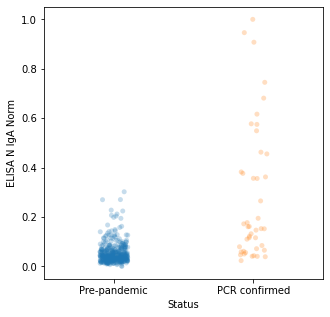

<Figure size 432x288 with 0 Axes>

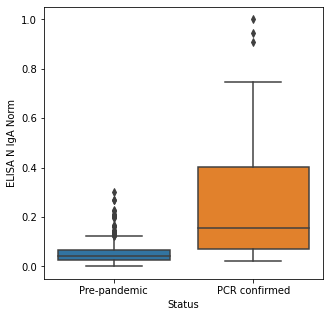

<Figure size 432x288 with 0 Axes>

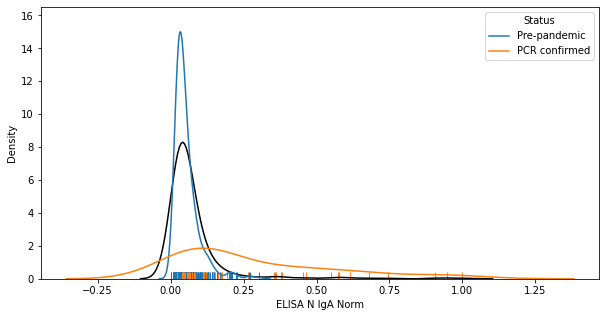

KDE Overlap: 0.2897253146339326



ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

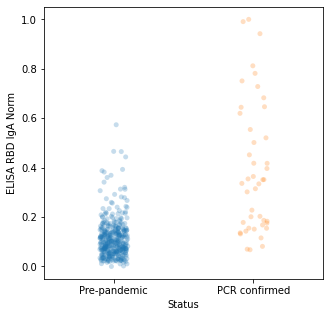

<Figure size 432x288 with 0 Axes>

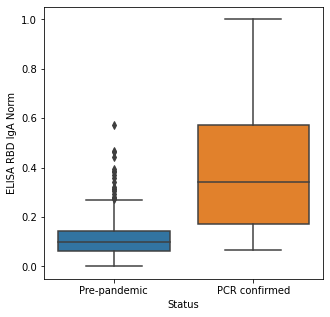

<Figure size 432x288 with 0 Axes>

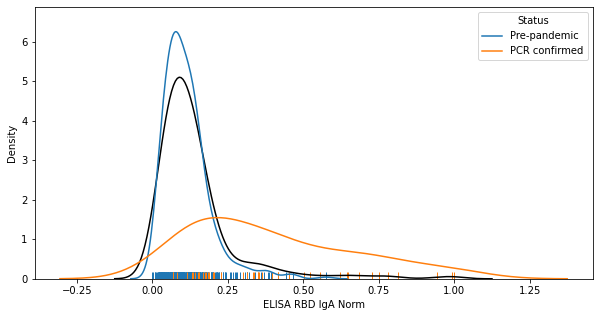

KDE Overlap: 0.3588769896193009



ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

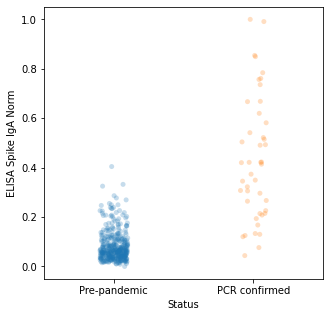

<Figure size 432x288 with 0 Axes>

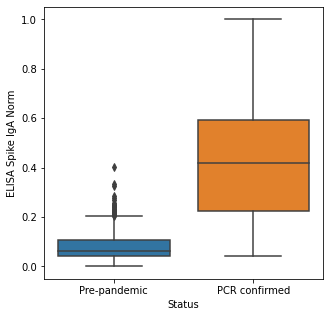

<Figure size 432x288 with 0 Axes>

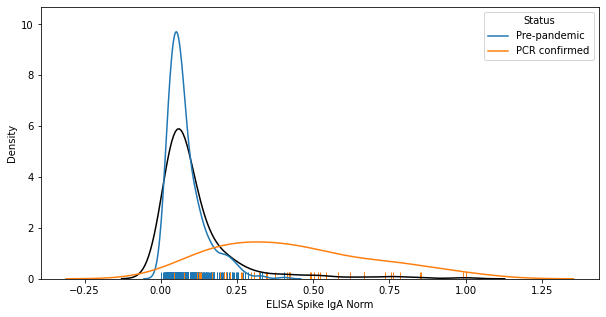

KDE Overlap: 0.24802589604426747



ELISA N IgM Norm


<Figure size 432x288 with 0 Axes>

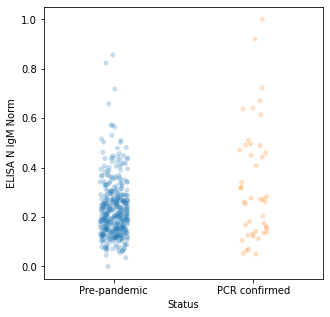

<Figure size 432x288 with 0 Axes>

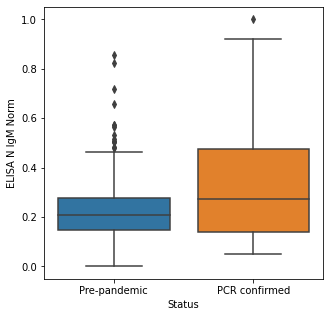

<Figure size 432x288 with 0 Axes>

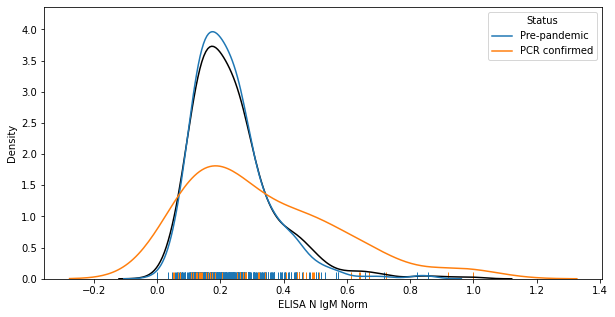

KDE Overlap: 0.6369604001601868



ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

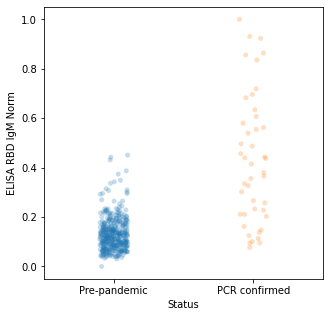

<Figure size 432x288 with 0 Axes>

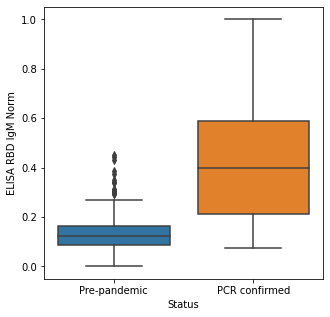

<Figure size 432x288 with 0 Axes>

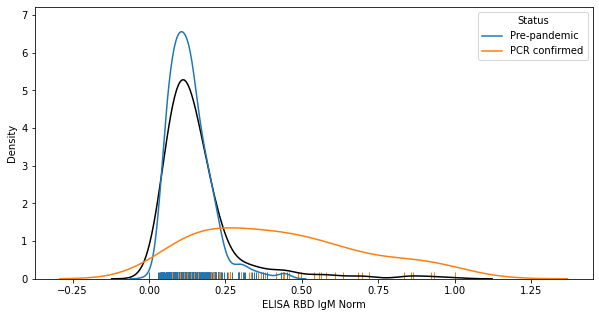

KDE Overlap: 0.30923407004756515



ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

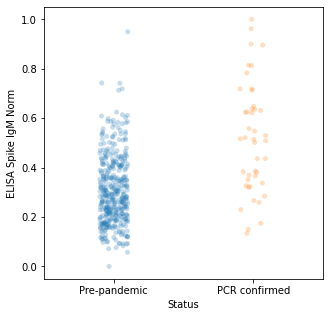

<Figure size 432x288 with 0 Axes>

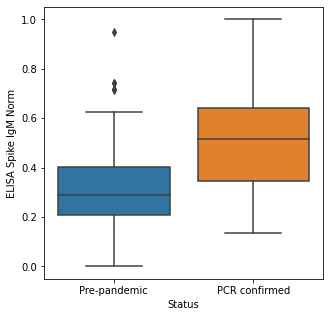

<Figure size 432x288 with 0 Axes>

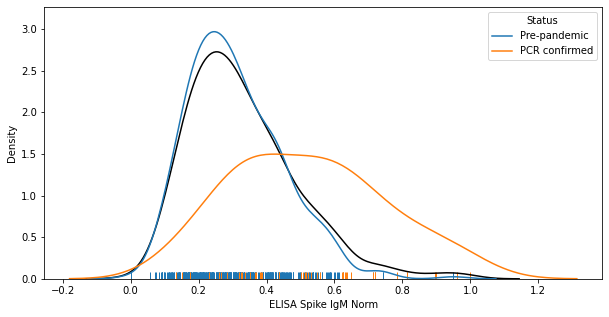

KDE Overlap: 0.5738460052507826









Validation
LIPS Average Bridging


<Figure size 432x288 with 0 Axes>

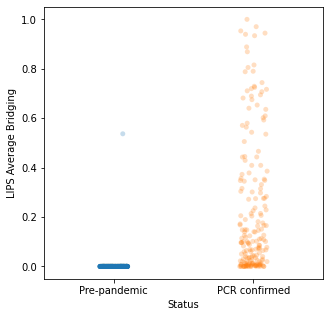

<Figure size 432x288 with 0 Axes>

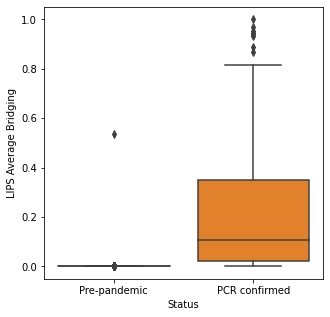

<Figure size 432x288 with 0 Axes>

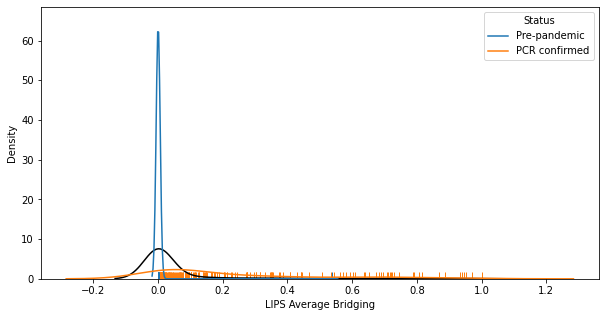

KDE Overlap: 0.07341021773582702



ELISA N Pan Norm


<Figure size 432x288 with 0 Axes>

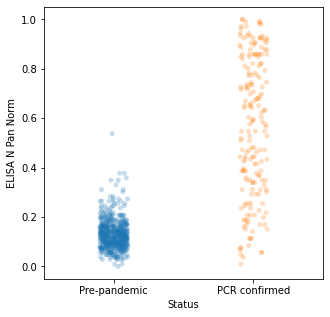

<Figure size 432x288 with 0 Axes>

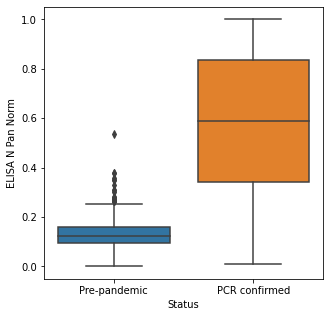

<Figure size 432x288 with 0 Axes>

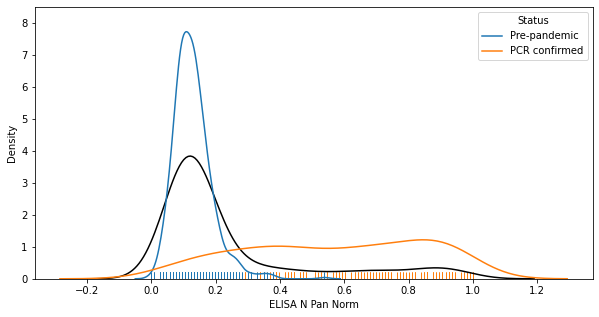

KDE Overlap: 0.19485747703553644



ELISA RBD Pan Norm


<Figure size 432x288 with 0 Axes>

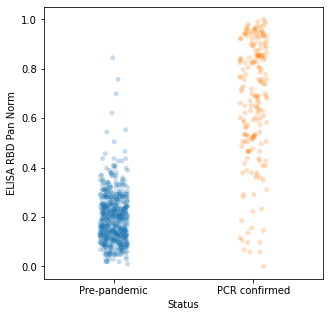

<Figure size 432x288 with 0 Axes>

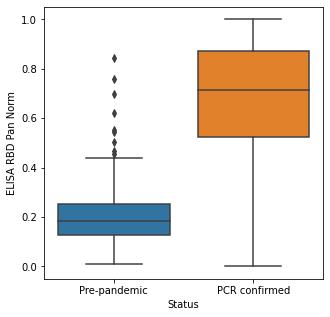

<Figure size 432x288 with 0 Axes>

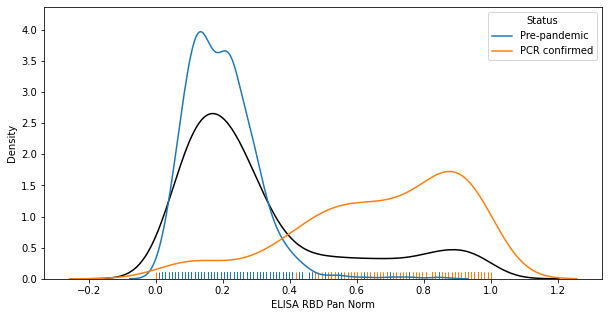

KDE Overlap: 0.17419631410333886



ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

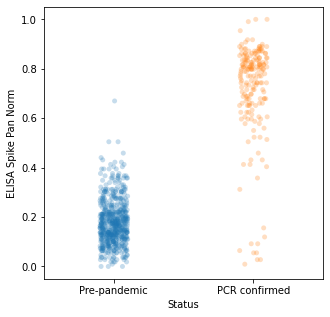

<Figure size 432x288 with 0 Axes>

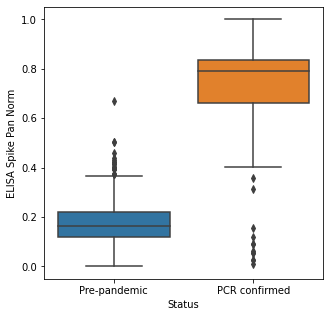

<Figure size 432x288 with 0 Axes>

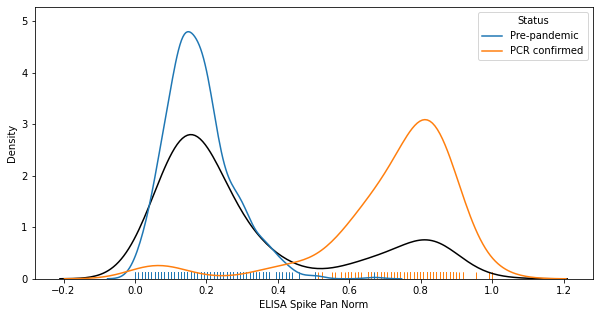

KDE Overlap: 0.08884648050417011



ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

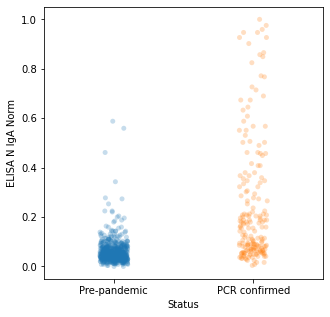

<Figure size 432x288 with 0 Axes>

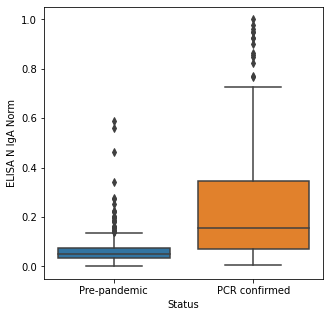

<Figure size 432x288 with 0 Axes>

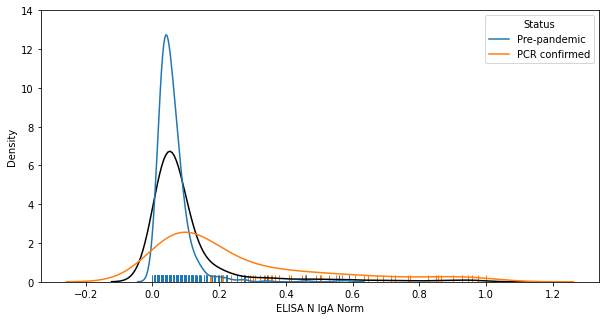

KDE Overlap: 0.36101963802496867



ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

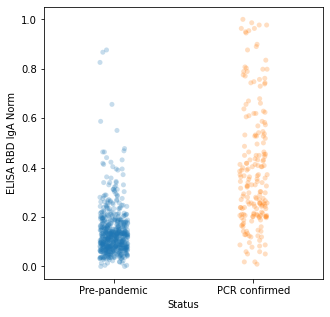

<Figure size 432x288 with 0 Axes>

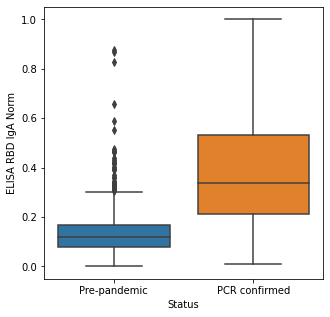

<Figure size 432x288 with 0 Axes>

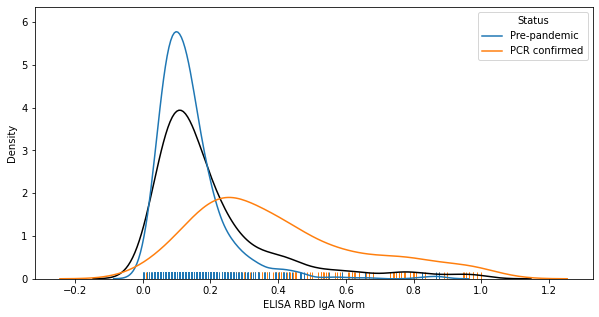

KDE Overlap: 0.40355375920522363



ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

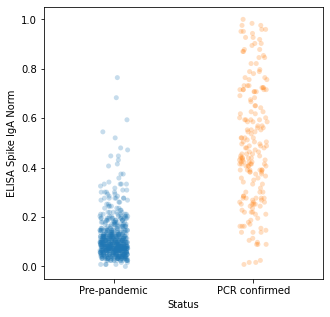

<Figure size 432x288 with 0 Axes>

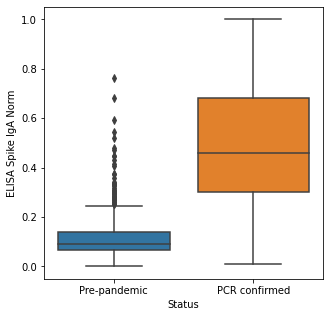

<Figure size 432x288 with 0 Axes>

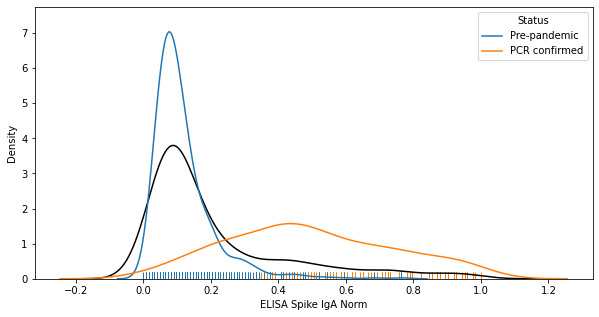

KDE Overlap: 0.2463717569004526









All data
LIPS Average Bridging


<Figure size 432x288 with 0 Axes>

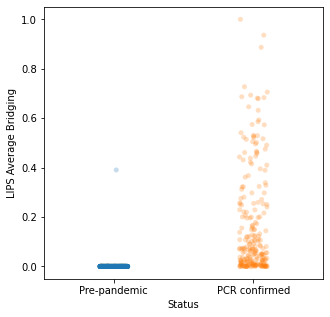

<Figure size 432x288 with 0 Axes>

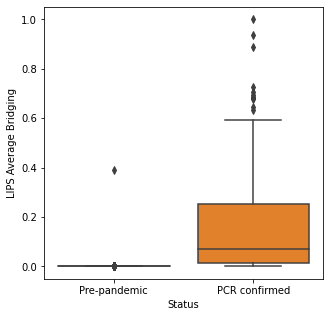

<Figure size 432x288 with 0 Axes>

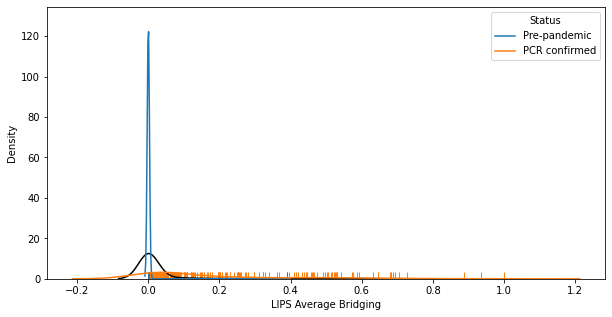

KDE Overlap: 0.05224136297826306



ELISA N Pan Norm


<Figure size 432x288 with 0 Axes>

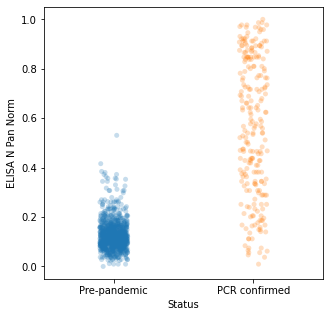

<Figure size 432x288 with 0 Axes>

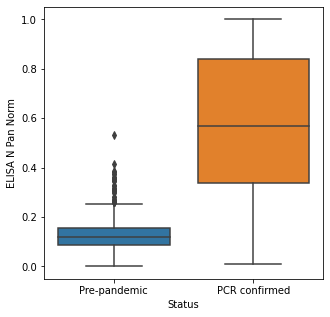

<Figure size 432x288 with 0 Axes>

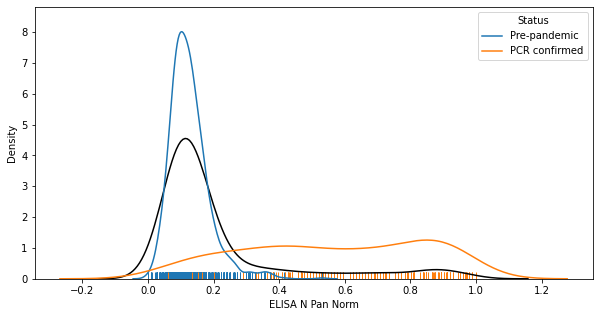

KDE Overlap: 0.19497152150573444



ELISA RBD Pan Norm


<Figure size 432x288 with 0 Axes>

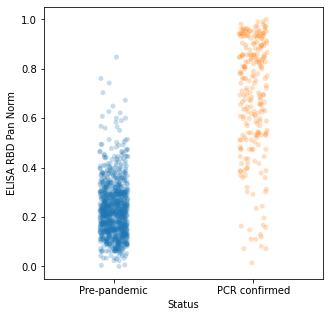

<Figure size 432x288 with 0 Axes>

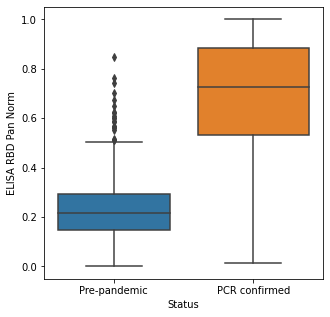

<Figure size 432x288 with 0 Axes>

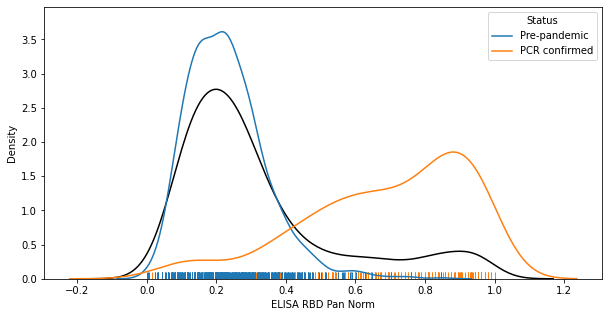

KDE Overlap: 0.20434019027930234



ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

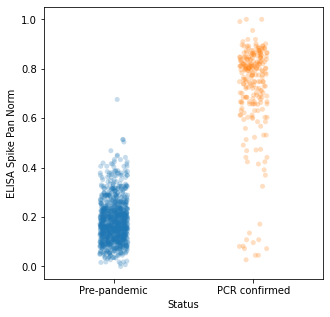

<Figure size 432x288 with 0 Axes>

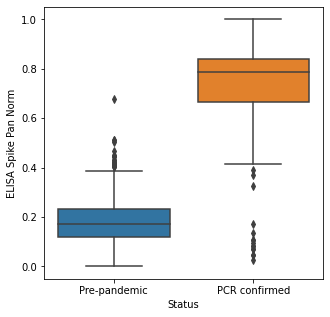

<Figure size 432x288 with 0 Axes>

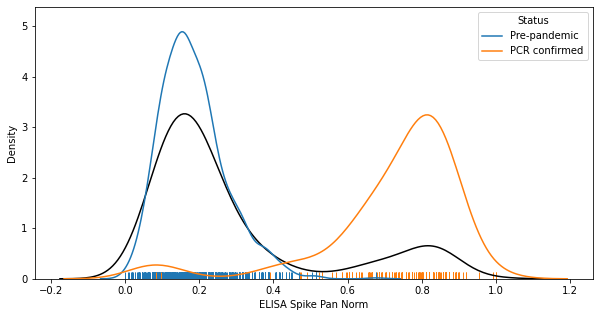

KDE Overlap: 0.08584701061519091



ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

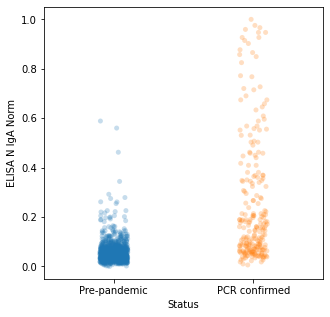

<Figure size 432x288 with 0 Axes>

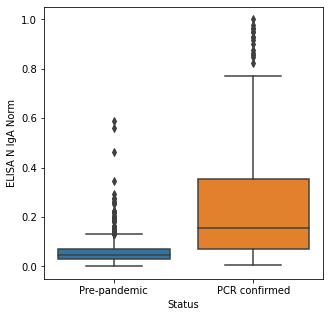

<Figure size 432x288 with 0 Axes>

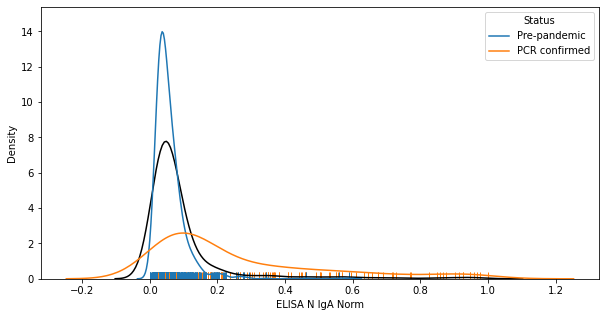

KDE Overlap: 0.3515043138861756



ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

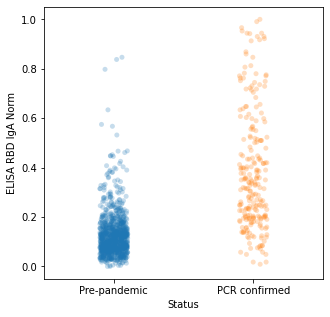

<Figure size 432x288 with 0 Axes>

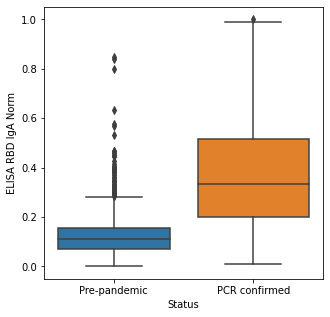

<Figure size 432x288 with 0 Axes>

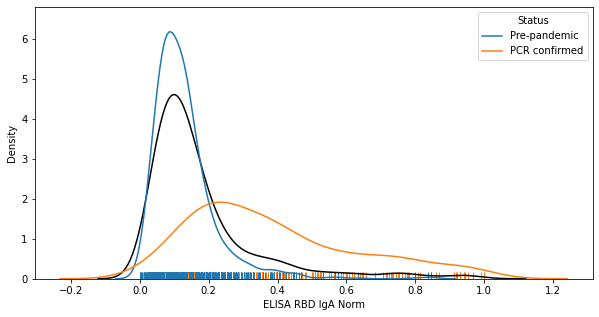

KDE Overlap: 0.38468563495934754



ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

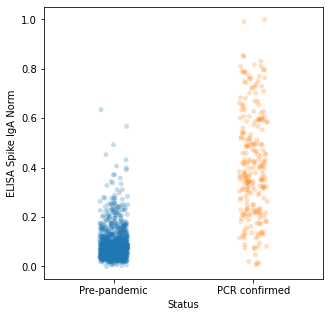

<Figure size 432x288 with 0 Axes>

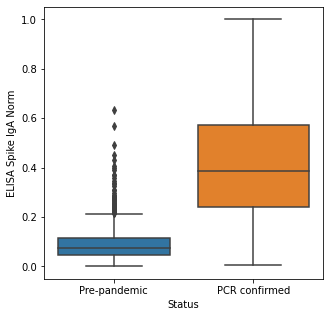

<Figure size 432x288 with 0 Axes>

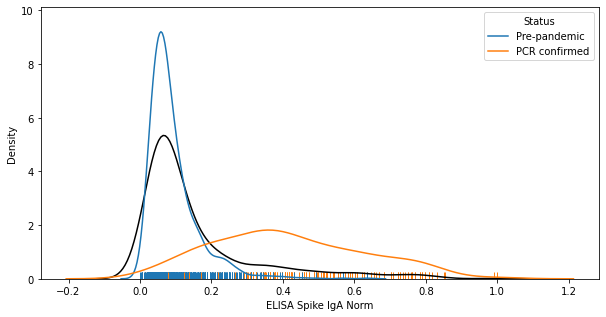

KDE Overlap: 0.2410538486727079





In [63]:
# Generate strip plots, box plots and kde plots for each assay to show separation between negative (blue)
# and positive (orange) samples
for label, df in {'Threshold': scaled_thresh_df, 'Validation': scaled_val_df, 'All data': scaled_comb_df}.items():
    if label == 'Threshold':
        cols = thresh_upd_cont_cols
    else:
        cols = val_upd_cont_cols

    print('\n\n\n\n\n\n{}'.format(label))
    for col in cols:
        print(col)

        # Strip plot
        plt.clf()
        plt.figure(figsize=(5, 5))
        sns.stripplot(
            data=df, x='Status', y=col, jitter=True, alpha=0.25, order=['Pre-pandemic', 'PCR confirmed']
        )
        plt.show()

        # Box plot
        plt.clf()
        plt.figure(figsize=(5, 5))
        sns.boxplot(data=df, x='Status', y=col, order=['Pre-pandemic', 'PCR confirmed'])
        plt.show()

        # Calculate overlap of KDE plots
        plt.clf()
        plt.figure(figsize=(10, 5))
        sns.kdeplot(data=df, x=col, color='k')
        sns.kdeplot(data=df[df['Status']=='Pre-pandemic'], x=col, color='tab:blue')
        sns.kdeplot(data=df[df['Status']=='PCR confirmed'], x=col, color='tab:orange')
        sns.rugplot(data=df, x=col, hue='Status',
                    hue_order={'Pre-pandemic': 'tab:blue', 'PCR confirmed': 'tab:orange'})
        plt.show()

        negative_df = df[df['Status'] == 'Pre-pandemic'].reset_index(drop=True)
        positive_df = df[df['Status'] == 'PCR confirmed'].reset_index(drop=True)
        add_sub = 0.1
        x_min = df[col].values.min() - add_sub
        x_max = df[col].values.max() + add_sub
        overlap = calc_kde_overlap(negative_df[[col]], positive_df[[col]], col, x_min, x_max)
        print('KDE Overlap: {}\n\n\n'.format(overlap))

Get best separation between LIPS and ELISA PanIg data (especially the Spike PanIg assay) - this is the same pattern observed in the pair plots, except that the separation of positive and negative samples by the LIPS assay is clearer on these plots. Results are consistent  across the threshold and validation datasets, i.e. the same assays perform best in both cases (again in agreement with the pair plots) - in fact the KDE area overlap values are remarkably similar given that there will be a fair amount of noise associated with this metric!

Will be interesting to see whether it is the same samples that are successfully separated by the different assays... (i.e. do the same assays provide the same information or not?)

#### Q2: How well do results between different assays correlate (i.e. are the same samples marked as "positive"/"negative" in each assay, or is there variation between assays)?

In [64]:
# Split scaled data into x and y
thresh_ml_x = scaled_thresh_df.drop(['Status', 'Dataset ID'], axis=1)
thresh_ml_y = scaled_thresh_df[['Status']]
pos_thresh_ml_x = pos_scaled_thresh_df.drop(['Status', 'Dataset ID'], axis=1)
pos_thresh_ml_y = pos_scaled_thresh_df[['Status']]

val_ml_x = scaled_val_df.drop(['Status', 'Dataset ID'], axis=1)
val_ml_y = scaled_val_df[['Status']]
pos_val_ml_x = pos_scaled_val_df.drop(['Status', 'Dataset ID'], axis=1)
pos_val_ml_y = pos_scaled_val_df[['Status']]

comb_ml_x = scaled_comb_df.drop(['Status', 'Dataset ID'], axis=1)
comb_ml_y = scaled_comb_df[['Status']]
pos_comb_ml_x = pos_scaled_comb_df.drop(['Status', 'Dataset ID'], axis=1)
pos_comb_ml_y = pos_scaled_comb_df[['Status']]

In [65]:
ml_x_dict = {'Threshold': thresh_ml_x,
             'Validation': val_ml_x,
             'All data': comb_ml_x}
pos_ml_x_dict = {'Threshold': pos_thresh_ml_x,
                 'Validation': pos_val_ml_x,
                 'All data': pos_comb_ml_x}
ml_y_dict = {'Threshold': thresh_ml_y,
             'Validation': val_ml_y,
             'All data': comb_ml_y}
pos_ml_y_dict = {'Threshold': pos_thresh_ml_y,
                 'Validation': pos_val_ml_y,
                 'All data': pos_comb_ml_y}

In [66]:
# Add non-assay metadata columns from no_blank_thresh_df and no_blank_val_df to the respective dataframes of x
# values
thresh_all_ml_x = pd.concat(
    [thresh_ml_x,
     no_blank_thresh_df[['Age group', 'Sex', 'Severity', 'Age', 'Time since symptom onset']]], axis=1
).reset_index(drop=True)
pos_no_blank_thresh_df = no_blank_thresh_df[no_blank_thresh_df['Status'] == 'PCR confirmed'].reset_index(drop=True)
pos_thresh_all_ml_x = pd.concat(
    [pos_thresh_ml_x,
     pos_no_blank_thresh_df[['Age group', 'Sex', 'Severity',  'Age', 'Time since symptom onset']]], axis=1
)

val_all_ml_x = pd.concat(
    [val_ml_x,
     no_blank_val_df[['Sex', 'Severity', 'Hospitalised', 'Time period',  'Age', 'Time since symptom onset']]],
    axis=1
).reset_index(drop=True)
pos_no_blank_val_df = no_blank_val_df[no_blank_val_df['Status'] == 'PCR confirmed'].reset_index(drop=True)
pos_val_all_ml_x = pd.concat(
    [pos_val_ml_x,
     pos_no_blank_val_df[['Sex', 'Severity', 'Hospitalised', 'Time period',  'Age', 'Time since symptom onset']]],
    axis=1
)

comb_extra_cols = pd.concat(
    [no_blank_thresh_df[['Sex', 'Severity',  'Age', 'Time since symptom onset']],
     no_blank_val_df[['Sex', 'Severity',  'Age', 'Time since symptom onset']]], axis=0
).reset_index(drop=True)
comb_all_ml_x = pd.concat([comb_ml_x, comb_extra_cols], axis=1).reset_index(drop=True)
pos_comb_extra_cols = pd.concat(
    [pos_no_blank_thresh_df[['Sex', 'Severity',  'Age', 'Time since symptom onset']],
     pos_no_blank_val_df[['Sex', 'Severity',  'Age', 'Time since symptom onset']]], axis=0
).reset_index(drop=True)
pos_comb_all_ml_x = pd.concat([pos_comb_ml_x, pos_comb_extra_cols], axis=1).reset_index(drop=True)

In [67]:
ml_x_all_dict = {'Threshold': thresh_all_ml_x,
                 'Validation': val_all_ml_x,
                 'All data': comb_all_ml_x}
pos_ml_x_all_dict = {'Threshold': pos_thresh_all_ml_x,
                     'Validation': pos_val_all_ml_x,
                     'All data': pos_comb_all_ml_x}




Threshold
All samples


<Figure size 432x288 with 0 Axes>

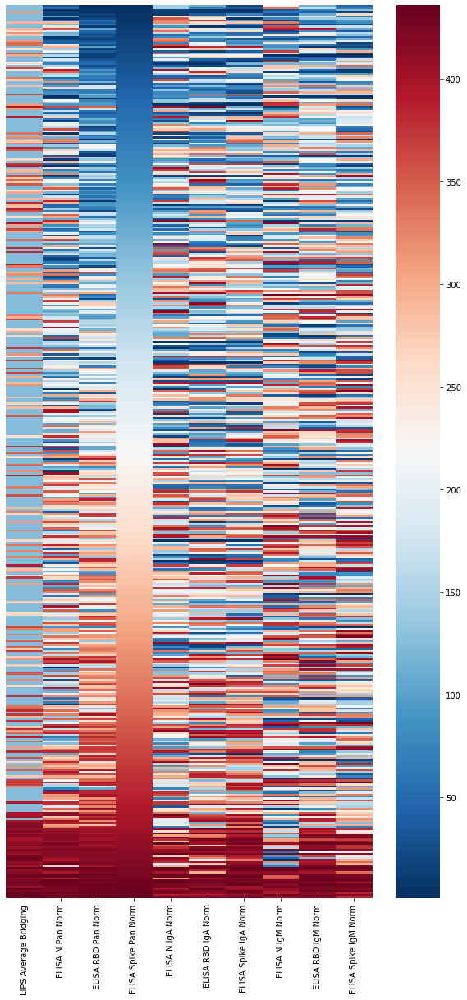

<Figure size 432x288 with 0 Axes>

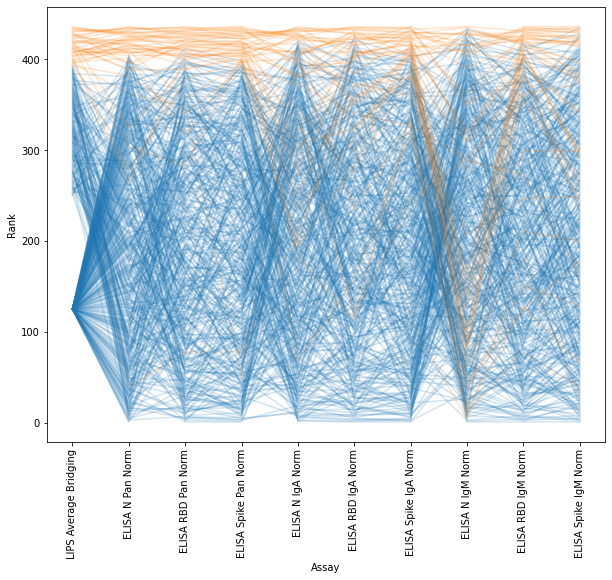

Positive samples


<Figure size 432x288 with 0 Axes>

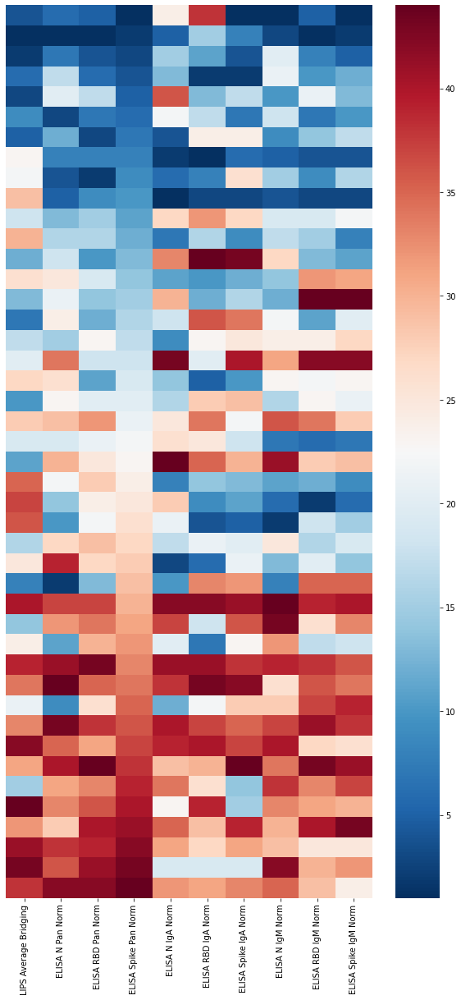


Rank_range:


<Figure size 432x288 with 0 Axes>

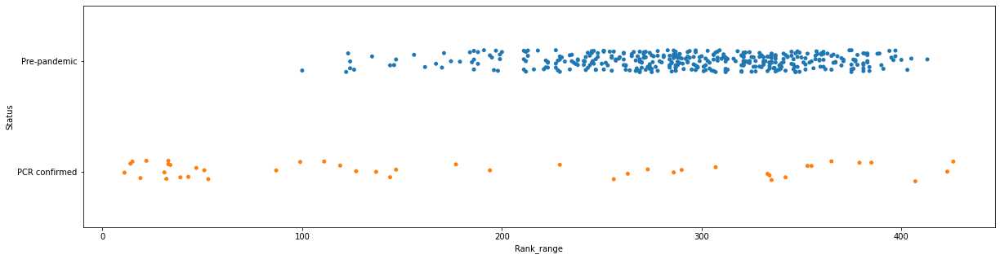

ANOVA p-value: 4.347189633622131e-19

Rank_IQR:


<Figure size 432x288 with 0 Axes>

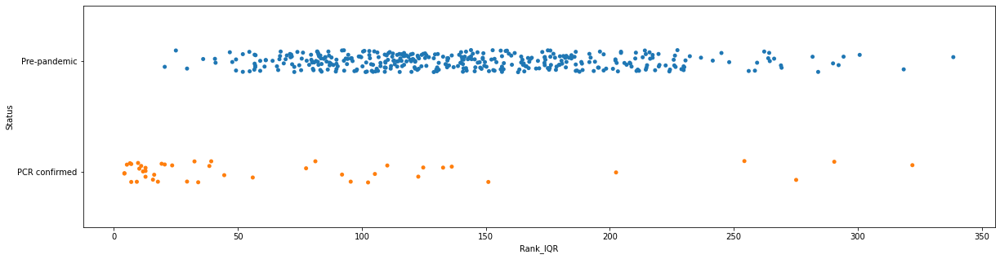

ANOVA p-value: 4.128441261551379e-12

Rank_standard_deviation:


<Figure size 432x288 with 0 Axes>

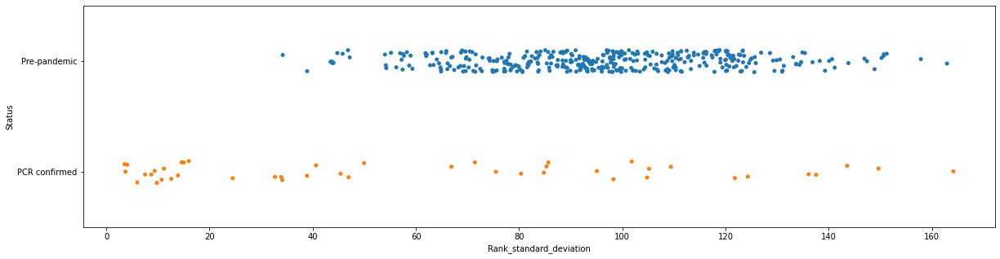

ANOVA p-value: 2.616785501168199e-16

Rank_range:


<Figure size 432x288 with 0 Axes>

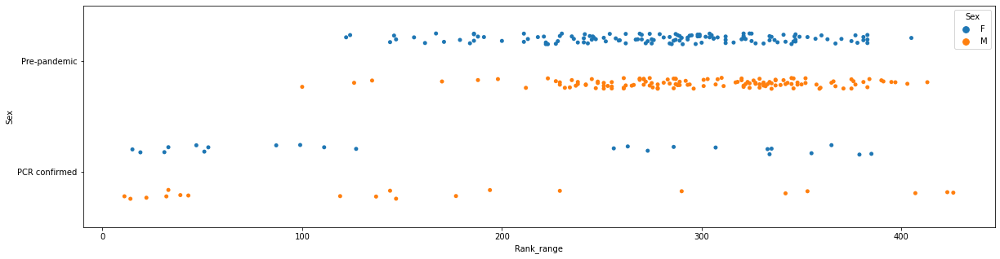

                        sum_sq     df          F        PR(>F)
C(Sex)            1.508012e+04    1.0   2.594577  1.082577e-01
C(Status)         3.707047e+05    1.0  63.780793  2.818092e-14
C(Sex):C(Status)  1.302079e+04    1.0   2.240264  1.354854e-01
Residual          1.784336e+06  307.0        NaN           NaN

Rank_IQR:


<Figure size 432x288 with 0 Axes>

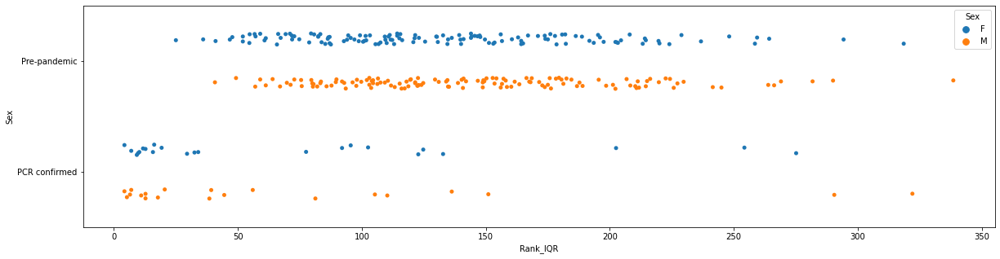

                        sum_sq     df          F        PR(>F)
C(Sex)            9.334264e+03    1.0   2.428483  1.201784e-01
C(Status)         1.587389e+05    1.0  41.298900  4.980005e-10
C(Sex):C(Status)  1.472771e+03    1.0   0.383169  5.363712e-01
Residual          1.180004e+06  307.0        NaN           NaN

Rank_standard_deviation:


<Figure size 432x288 with 0 Axes>

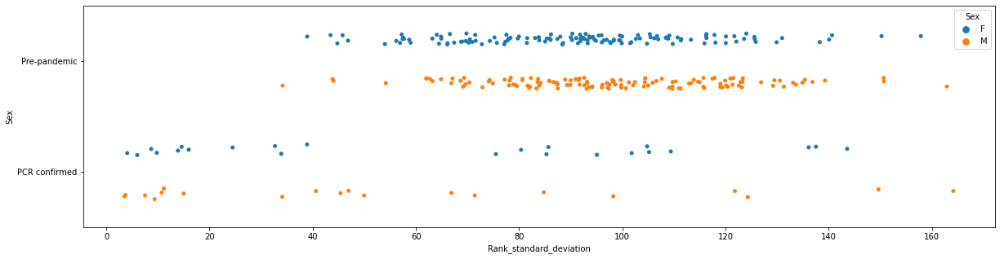

                         sum_sq     df          F        PR(>F)
C(Sex)              2170.031126    1.0   2.778287  9.657013e-02
C(Status)          41779.125515    1.0  53.489741  2.276579e-12
C(Sex):C(Status)    1485.959877    1.0   1.902472  1.688058e-01
Residual          239787.879961  307.0        NaN           NaN

Rank_range:


<Figure size 432x288 with 0 Axes>

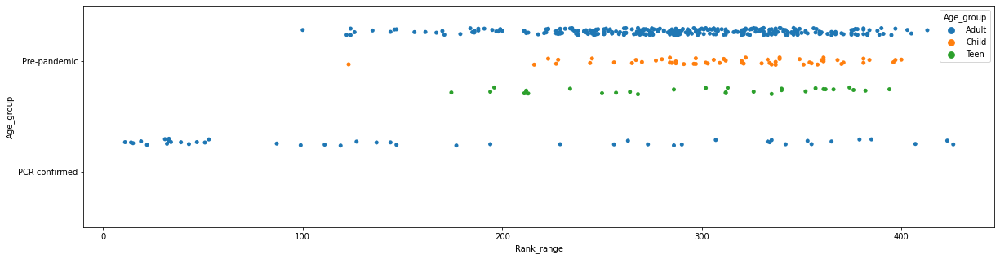


Rank_IQR:


<Figure size 432x288 with 0 Axes>

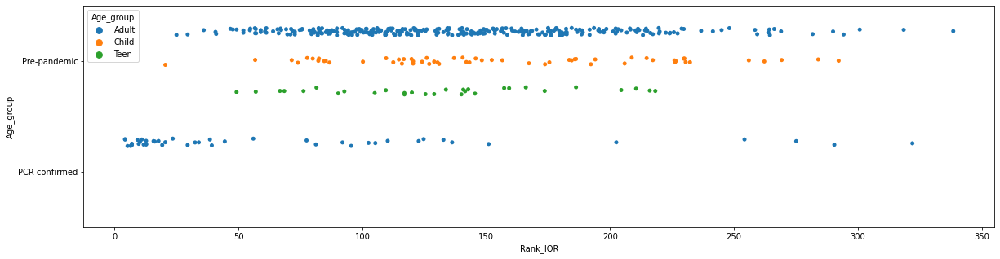


Rank_standard_deviation:


<Figure size 432x288 with 0 Axes>

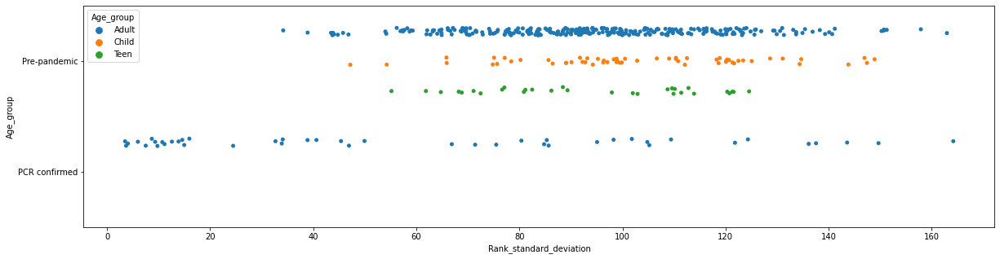


Rank_range:


<Figure size 432x288 with 0 Axes>

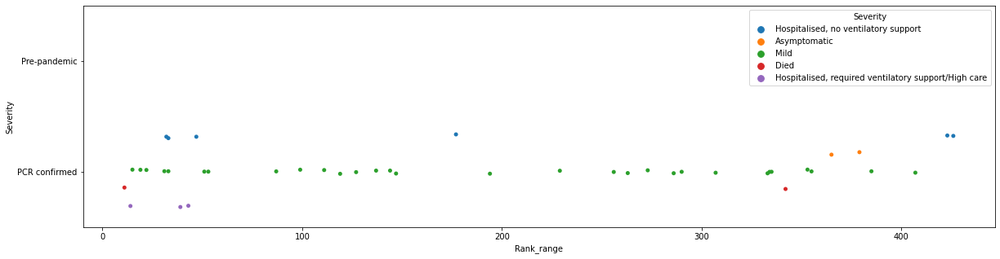

ANOVA p-value (PCR-confirmed samples only): 0.12839160733215127

Rank_IQR:


<Figure size 432x288 with 0 Axes>

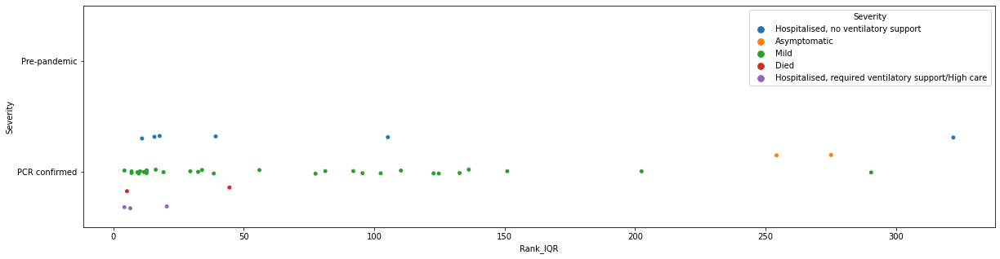

ANOVA p-value (PCR-confirmed samples only): 0.007509377868130327

Rank_standard_deviation:


<Figure size 432x288 with 0 Axes>

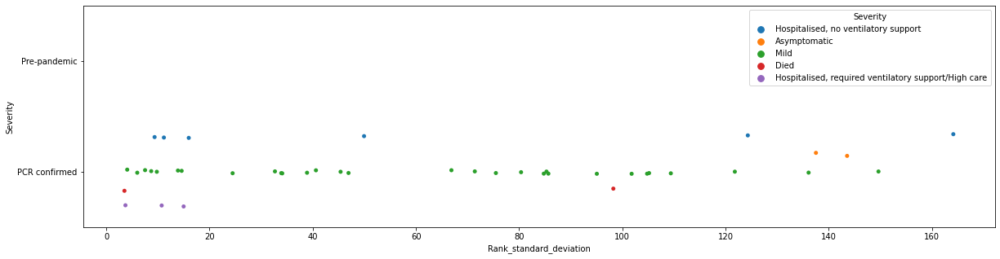

ANOVA p-value (PCR-confirmed samples only): 0.05916272212255421
Threshold dataset only considering the assays also considered in the validation dataset
All samples


<Figure size 432x288 with 0 Axes>

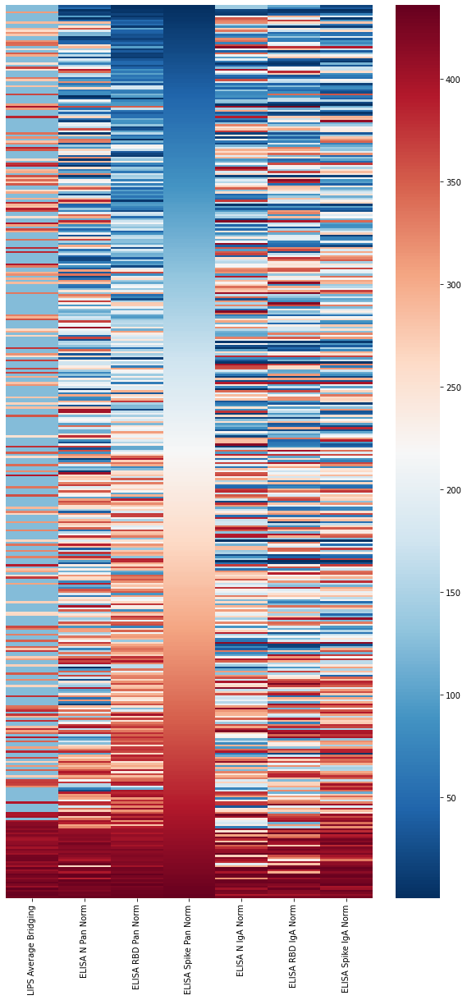

<Figure size 432x288 with 0 Axes>

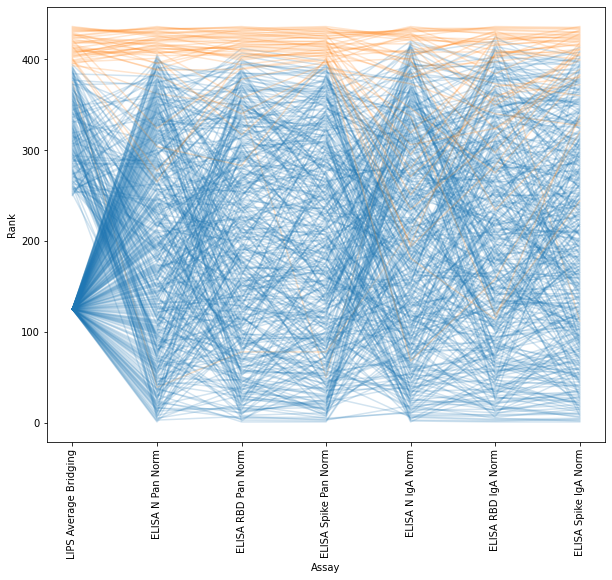

Positive samples


<Figure size 432x288 with 0 Axes>

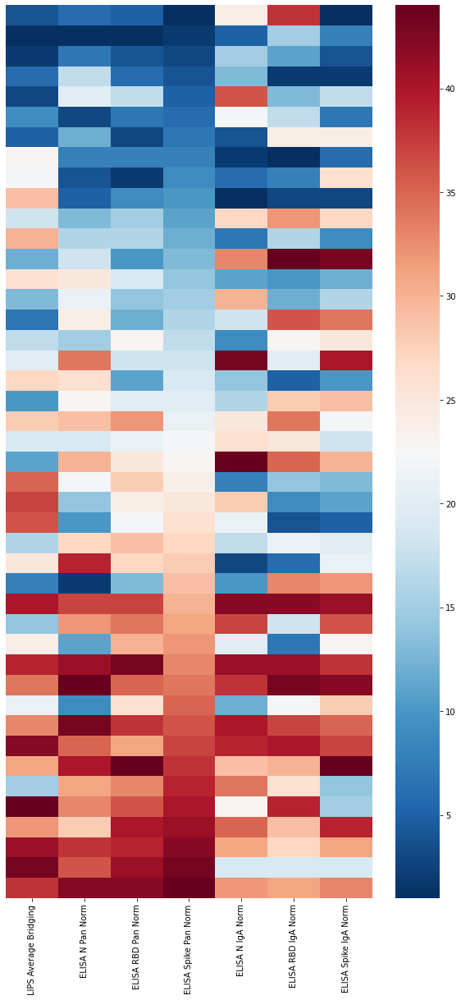


Rank_range:


<Figure size 432x288 with 0 Axes>

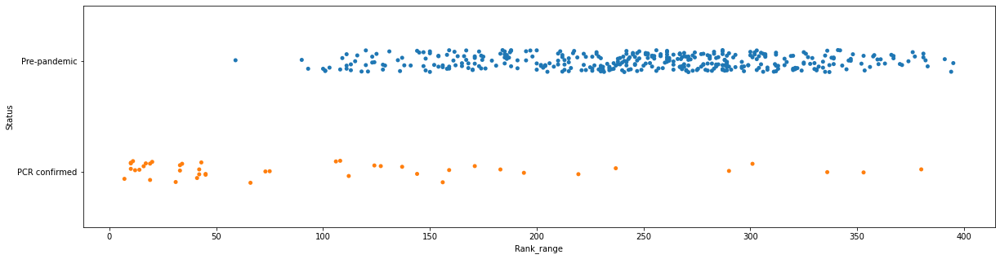

ANOVA p-value: 1.401043790451514e-29

Rank_IQR:


<Figure size 432x288 with 0 Axes>

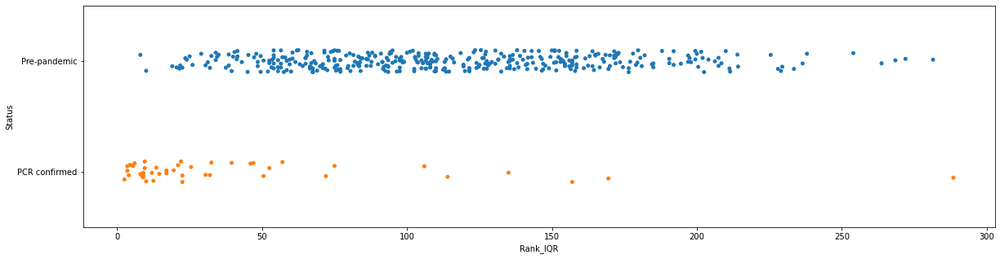

ANOVA p-value: 1.0306282171912199e-16

Rank_standard_deviation:


<Figure size 432x288 with 0 Axes>

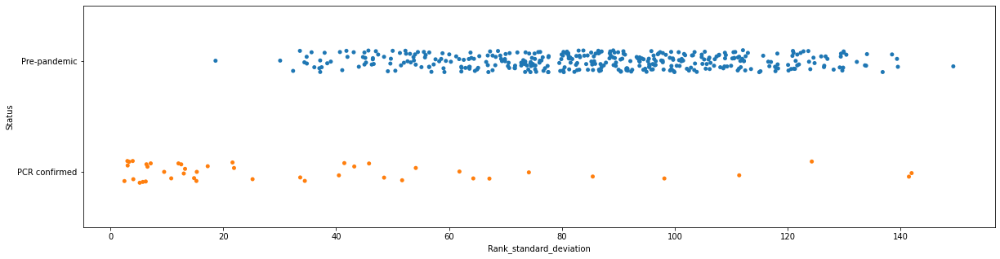

ANOVA p-value: 1.3633430716500477e-26

Rank_range:


<Figure size 432x288 with 0 Axes>

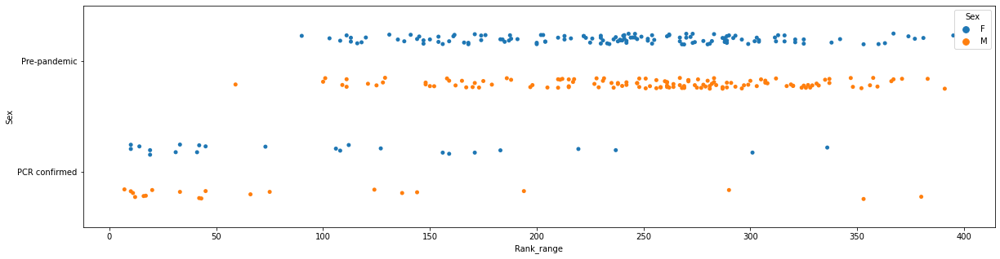

                        sum_sq     df           F        PR(>F)
C(Sex)            1.213800e+04    1.0    2.172448  1.415271e-01
C(Status)         7.097743e+05    1.0  127.034739  6.874111e-25
C(Sex):C(Status)  6.295757e+03    1.0    1.126809  2.892915e-01
Residual          1.715285e+06  307.0         NaN           NaN

Rank_IQR:


<Figure size 432x288 with 0 Axes>

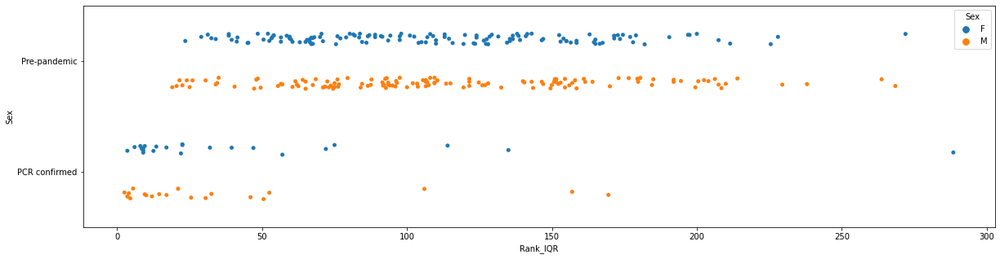

                         sum_sq     df          F        PR(>F)
C(Sex)               653.058581    1.0   0.225926  6.348991e-01
C(Status)         184781.625960    1.0  63.925359  2.652011e-14
C(Sex):C(Status)    1025.190639    1.0   0.354666  5.519226e-01
Residual          887409.310264  307.0        NaN           NaN

Rank_standard_deviation:


<Figure size 432x288 with 0 Axes>

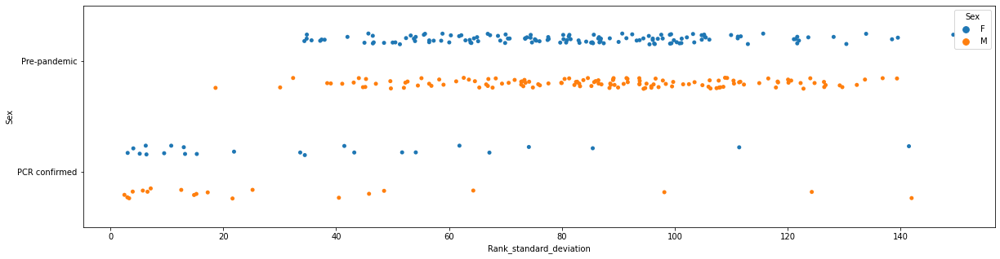

                         sum_sq     df           F        PR(>F)
C(Sex)              1019.342173    1.0    1.320601  2.513787e-01
C(Status)          80578.571738    1.0  104.392961  2.748421e-21
C(Sex):C(Status)     796.331068    1.0    1.031681  3.105641e-01
Residual          236966.374674  307.0         NaN           NaN

Rank_range:


<Figure size 432x288 with 0 Axes>

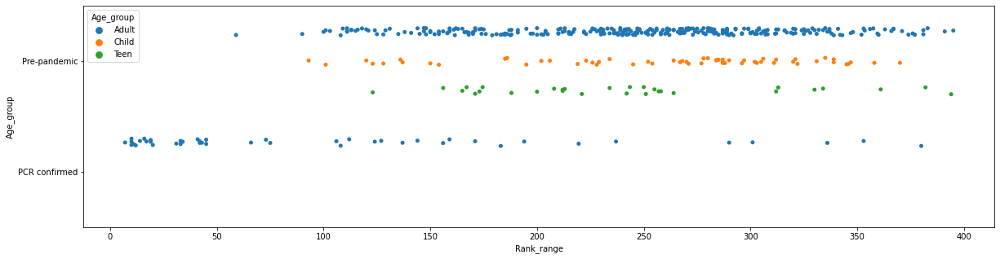


Rank_IQR:


<Figure size 432x288 with 0 Axes>

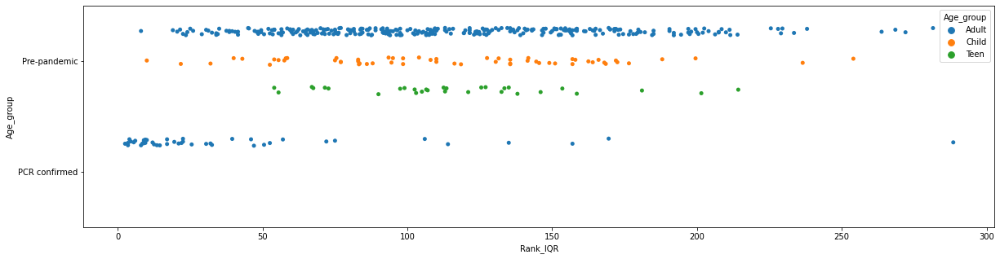


Rank_standard_deviation:


<Figure size 432x288 with 0 Axes>

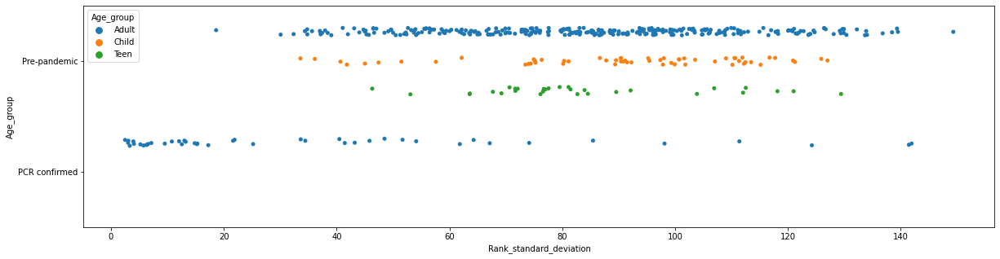


Rank_range:


<Figure size 432x288 with 0 Axes>

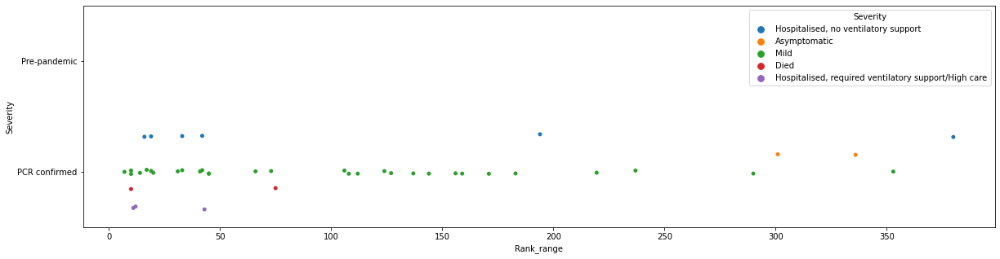

ANOVA p-value (PCR-confirmed samples only): 0.01979153611407122

Rank_IQR:


<Figure size 432x288 with 0 Axes>

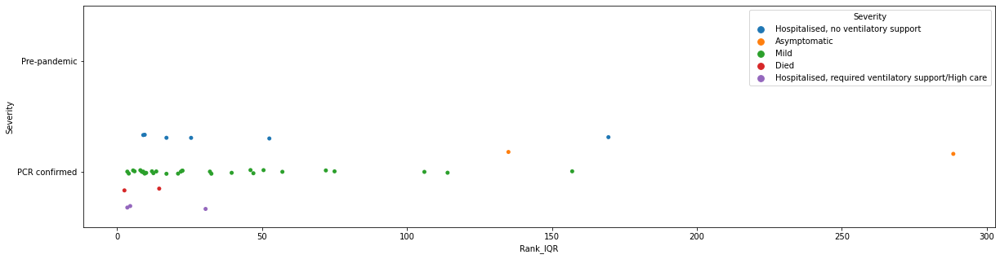

ANOVA p-value (PCR-confirmed samples only): 5.486357345295598e-05

Rank_standard_deviation:


<Figure size 432x288 with 0 Axes>

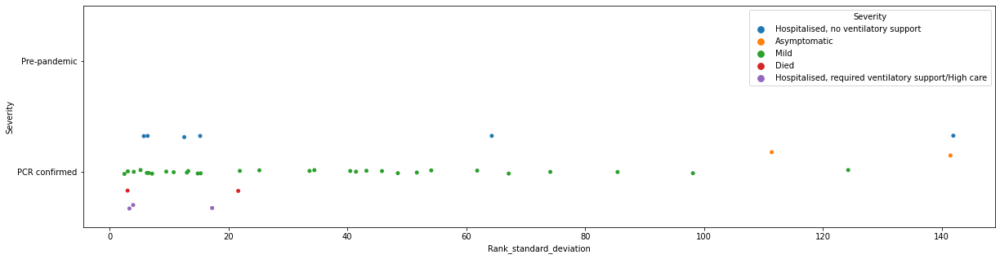

ANOVA p-value (PCR-confirmed samples only): 0.005707509062716203



Validation
All samples


<Figure size 432x288 with 0 Axes>

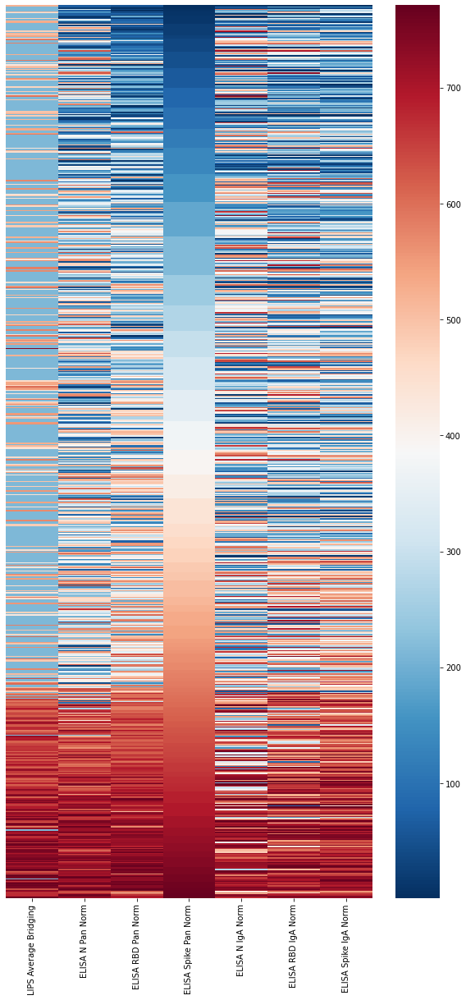

<Figure size 432x288 with 0 Axes>

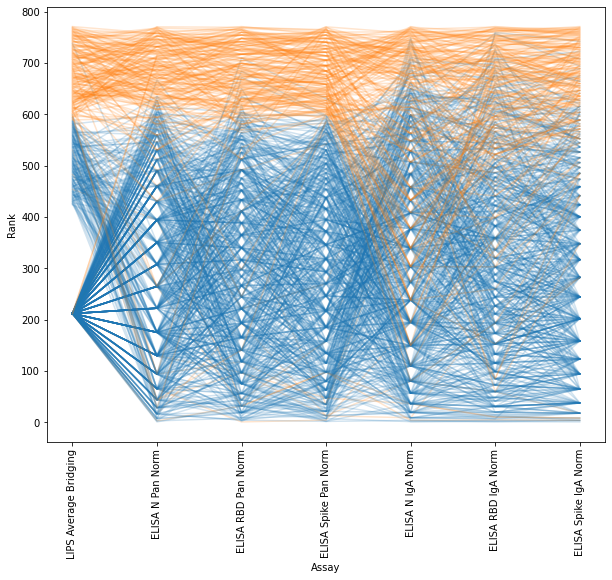

Positive samples


<Figure size 432x288 with 0 Axes>

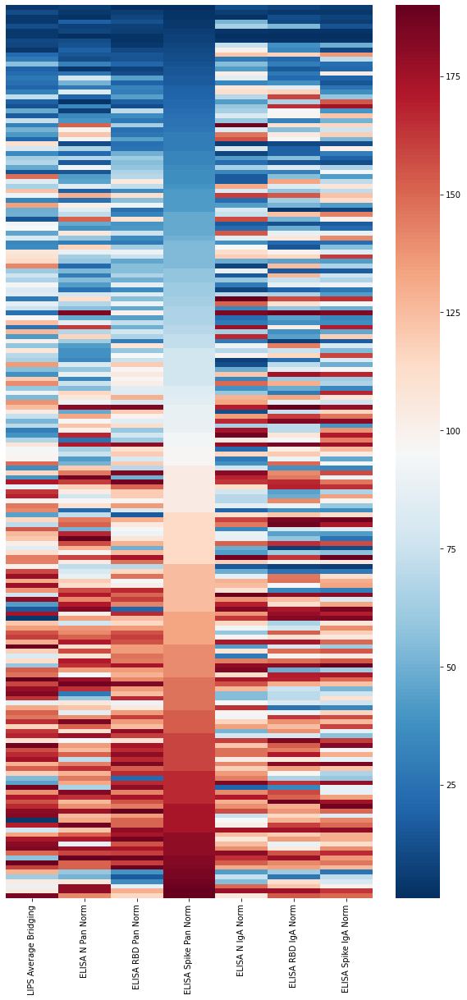


Rank_range:


<Figure size 432x288 with 0 Axes>

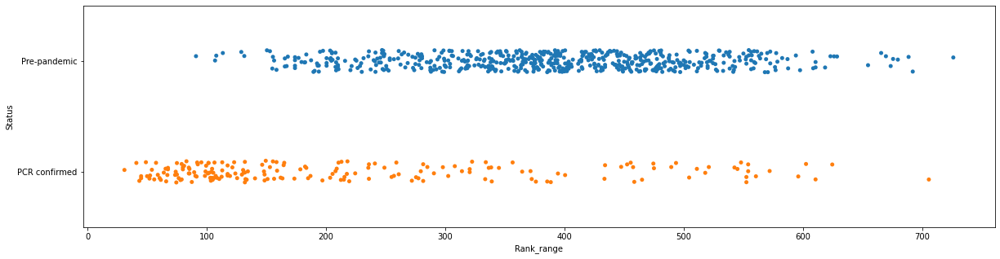

ANOVA p-value: 1.8930004031657223e-48

Rank_IQR:


<Figure size 432x288 with 0 Axes>

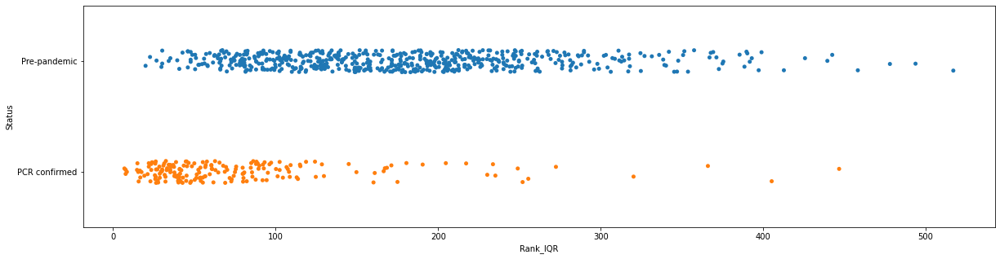

ANOVA p-value: 4.1905285710753795e-42

Rank_standard_deviation:


<Figure size 432x288 with 0 Axes>

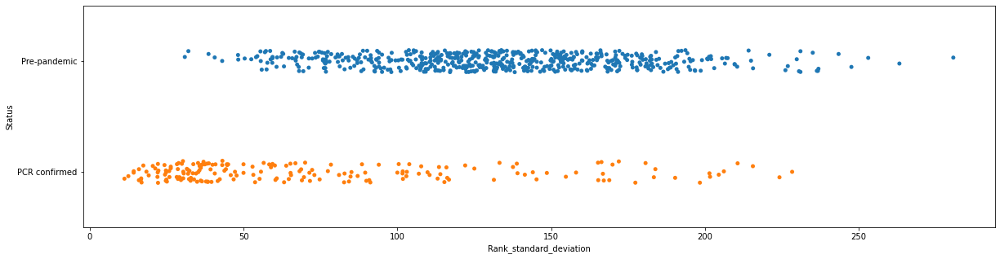

ANOVA p-value: 1.634449085515872e-48

Rank_range:


<Figure size 432x288 with 0 Axes>

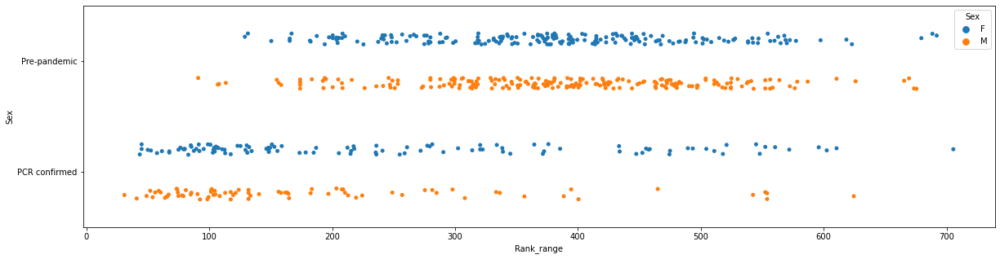

                        sum_sq     df           F        PR(>F)
C(Sex)            3.542450e+04    1.0    2.052493  1.524815e-01
C(Status)         3.429908e+06    1.0  198.728633  3.725010e-39
C(Sex):C(Status)  1.542020e+05    1.0    8.934454  2.913724e-03
Residual          1.028652e+07  596.0         NaN           NaN

Rank_IQR:


<Figure size 432x288 with 0 Axes>

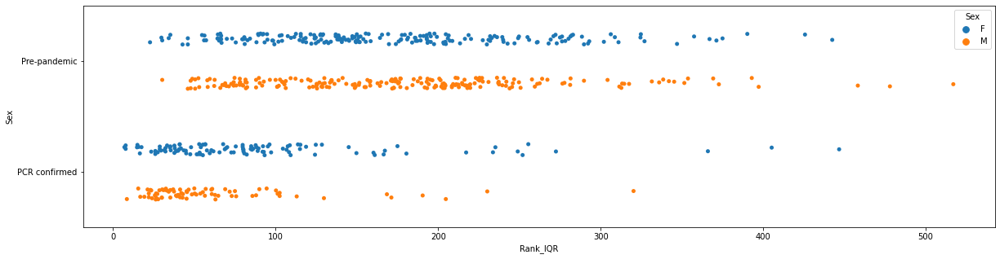

                        sum_sq     df           F        PR(>F)
C(Sex)            3.080132e+03    1.0    0.471364  4.926272e-01
C(Status)         1.215330e+06    1.0  185.986619  4.717198e-37
C(Sex):C(Status)  3.831466e+04    1.0    5.863438  1.575607e-02
Residual          3.894565e+06  596.0         NaN           NaN

Rank_standard_deviation:


<Figure size 432x288 with 0 Axes>

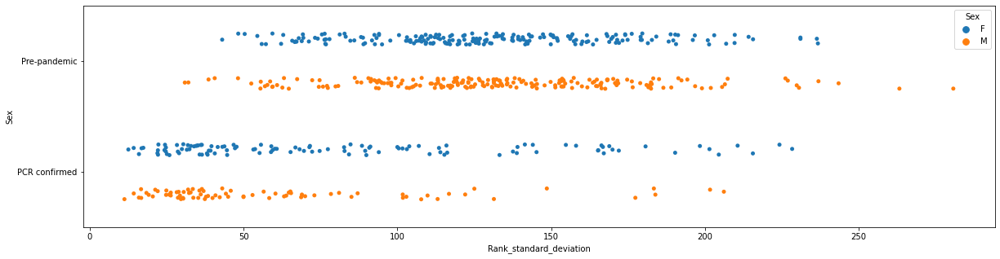

                        sum_sq     df           F        PR(>F)
C(Sex)            3.412536e+03    1.0    1.591550  2.075983e-01
C(Status)         4.283172e+05    1.0  199.760044  2.526051e-39
C(Sex):C(Status)  1.848122e+04    1.0    8.619333  3.454399e-03
Residual          1.277918e+06  596.0         NaN           NaN

Rank_range:


<Figure size 432x288 with 0 Axes>

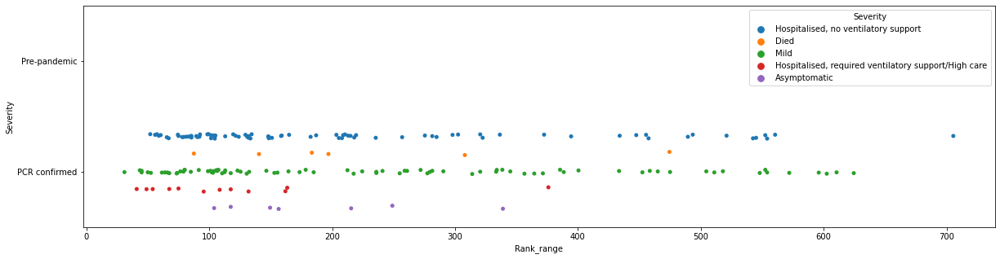

ANOVA p-value (PCR-confirmed samples only): 0.14087100012969003

Rank_IQR:


<Figure size 432x288 with 0 Axes>

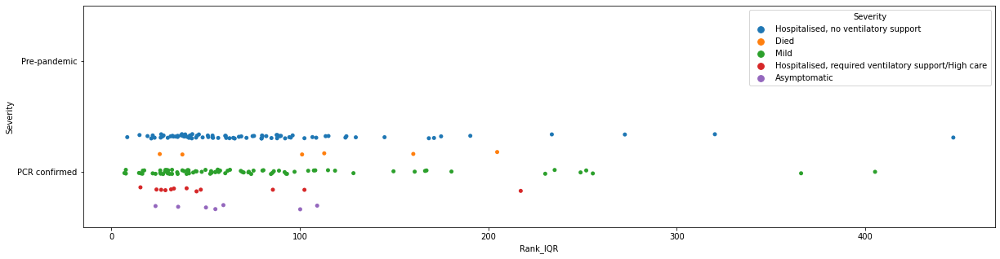

ANOVA p-value (PCR-confirmed samples only): 0.6572923729309956

Rank_standard_deviation:


<Figure size 432x288 with 0 Axes>

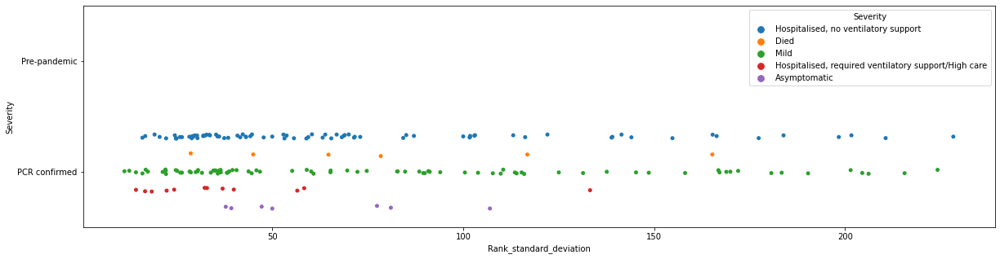

ANOVA p-value (PCR-confirmed samples only): 0.15876470419526498

Rank_range:


<Figure size 432x288 with 0 Axes>

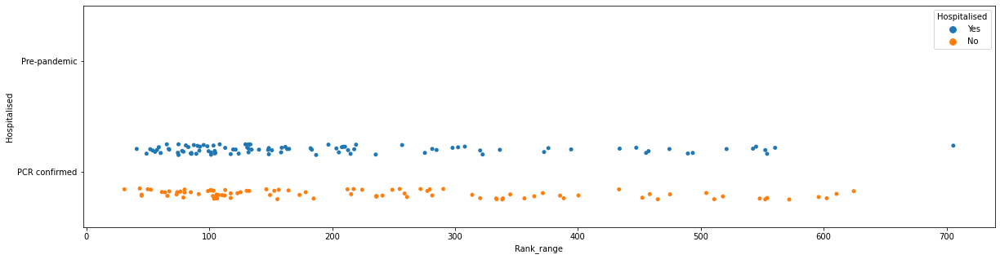

ANOVA p-value (PCR-confirmed samples only): 0.12655516544027898

Rank_IQR:


<Figure size 432x288 with 0 Axes>

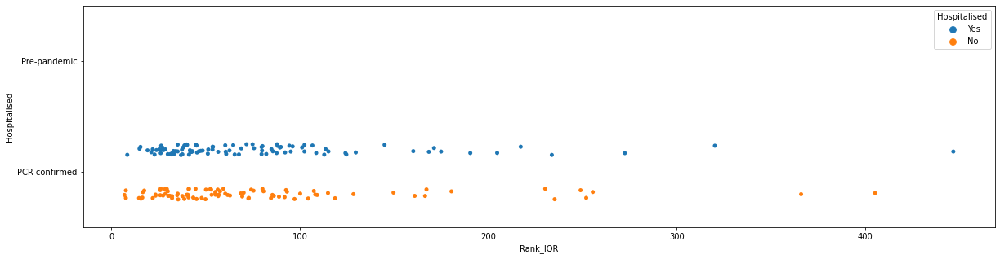

ANOVA p-value (PCR-confirmed samples only): 0.9364871731354113

Rank_standard_deviation:


<Figure size 432x288 with 0 Axes>

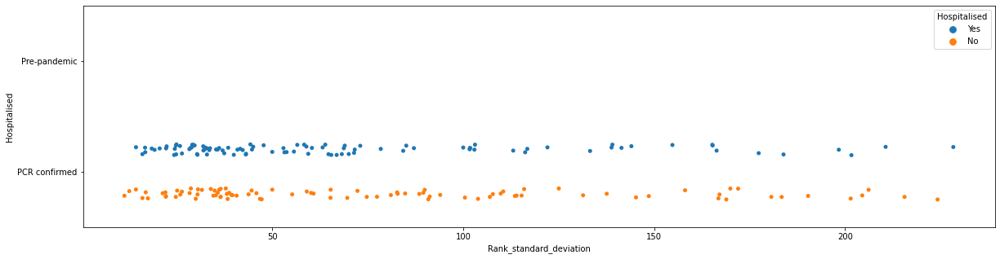

ANOVA p-value (PCR-confirmed samples only): 0.17189206150439115

Rank_range:


<Figure size 432x288 with 0 Axes>

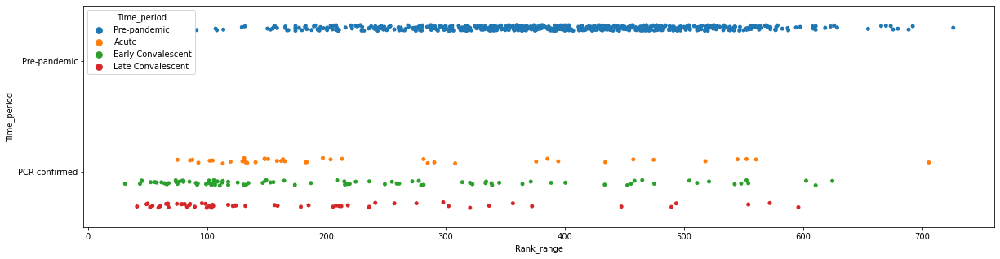

ANOVA p-value (PCR-confirmed samples only): 0.1769980085398148

Rank_IQR:


<Figure size 432x288 with 0 Axes>

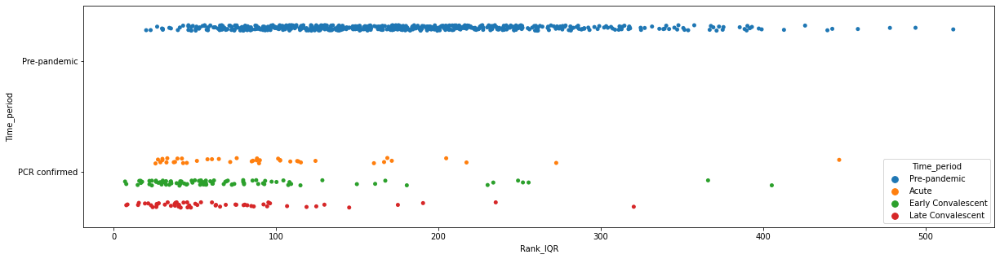

ANOVA p-value (PCR-confirmed samples only): 0.09903102585849849

Rank_standard_deviation:


<Figure size 432x288 with 0 Axes>

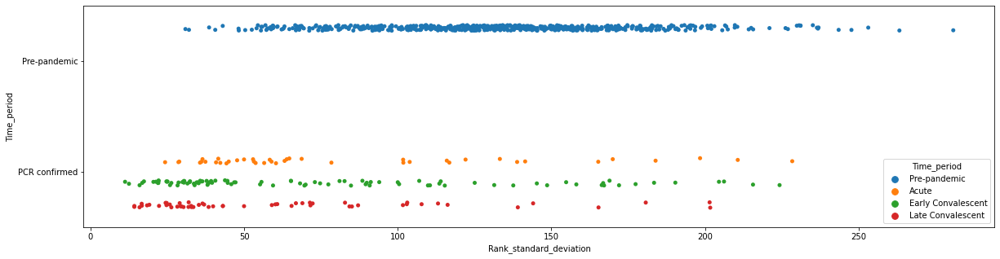

ANOVA p-value (PCR-confirmed samples only): 0.11088977934684315



All data
All samples


<Figure size 432x288 with 0 Axes>

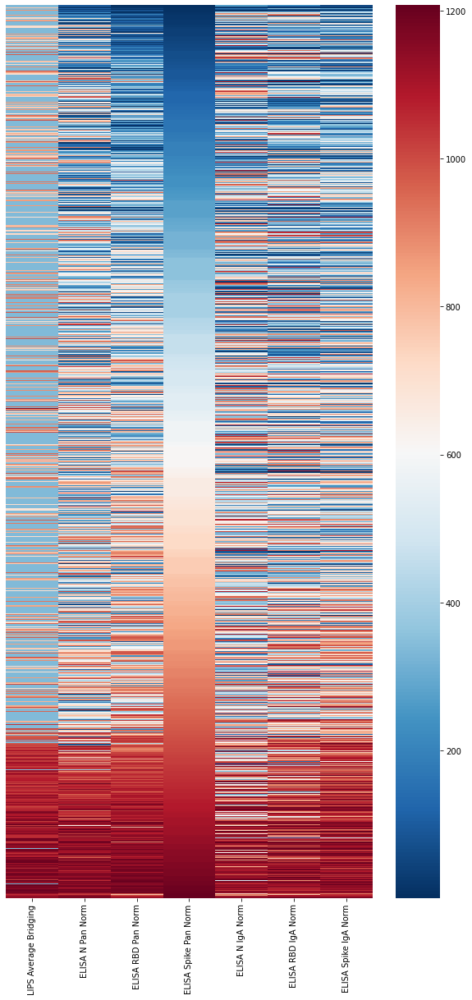

<Figure size 432x288 with 0 Axes>

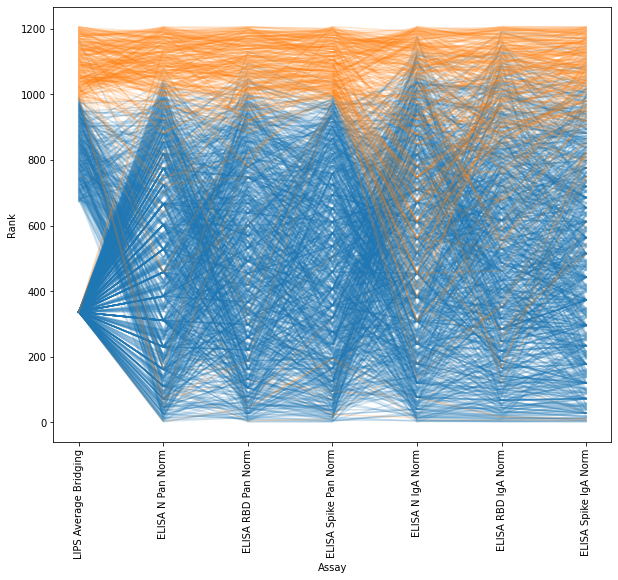

Positive samples


<Figure size 432x288 with 0 Axes>

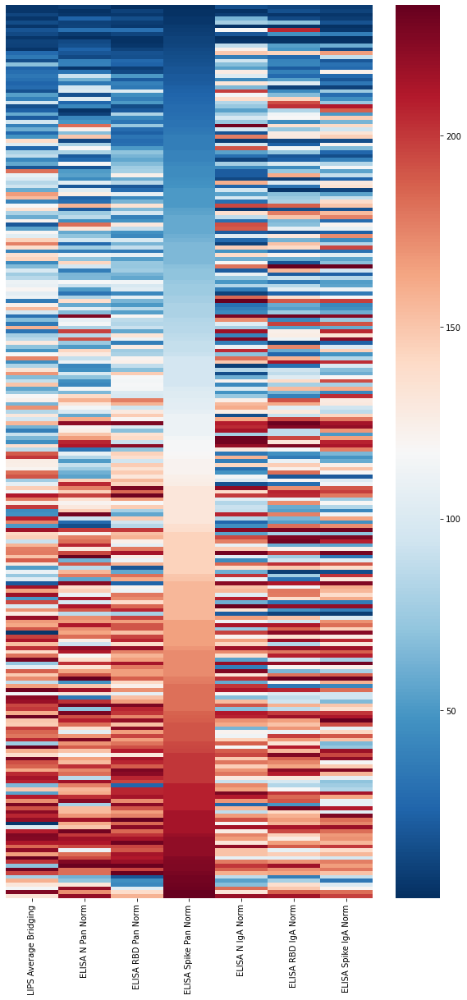


Rank_range:


<Figure size 432x288 with 0 Axes>

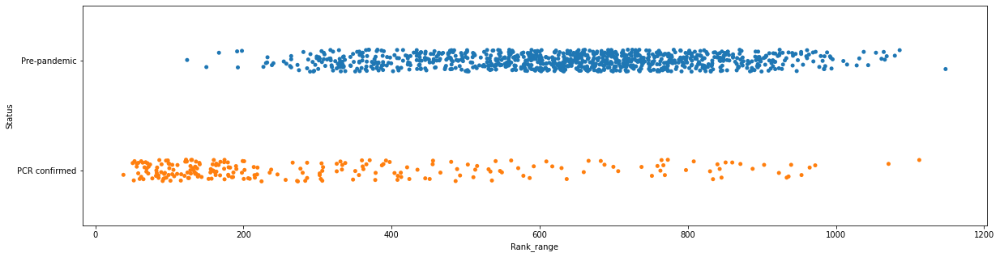

ANOVA p-value: 2.621564571988487e-88

Rank_IQR:


<Figure size 432x288 with 0 Axes>

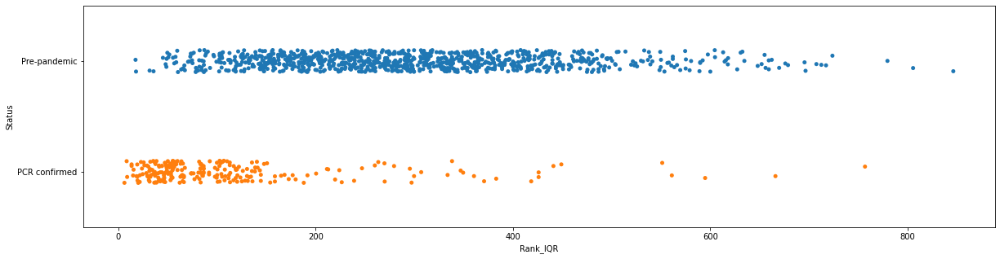

ANOVA p-value: 6.675296738742432e-67

Rank_standard_deviation:


<Figure size 432x288 with 0 Axes>

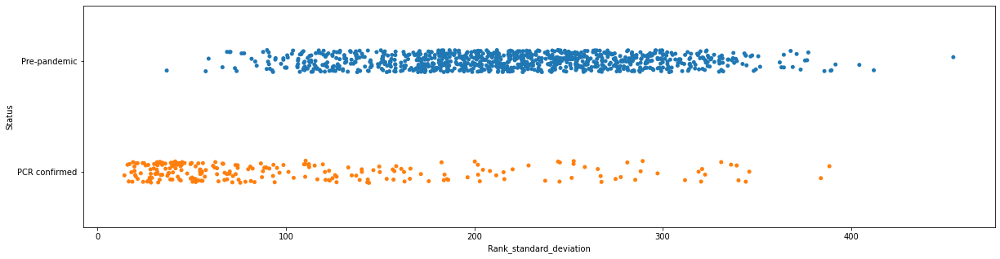

ANOVA p-value: 5.484750871379374e-85

Rank_range:


<Figure size 432x288 with 0 Axes>

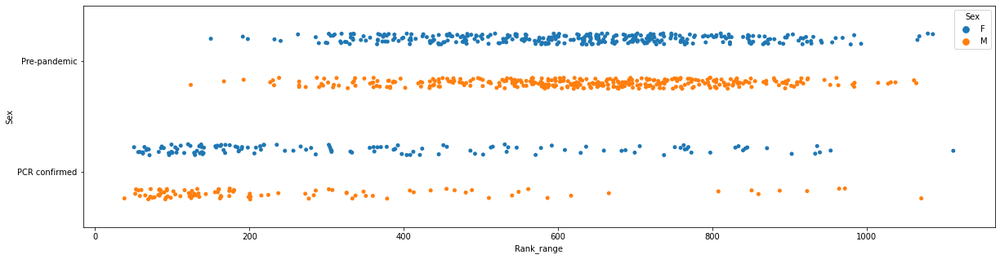

                        sum_sq     df           F        PR(>F)
C(Sex)            2.758397e+04    1.0    0.652340  4.194889e-01
C(Status)         1.601701e+07    1.0  378.790506  8.984170e-71
C(Sex):C(Status)  4.607135e+05    1.0   10.895534  1.001578e-03
Residual          3.835215e+07  907.0         NaN           NaN

Rank_IQR:


<Figure size 432x288 with 0 Axes>

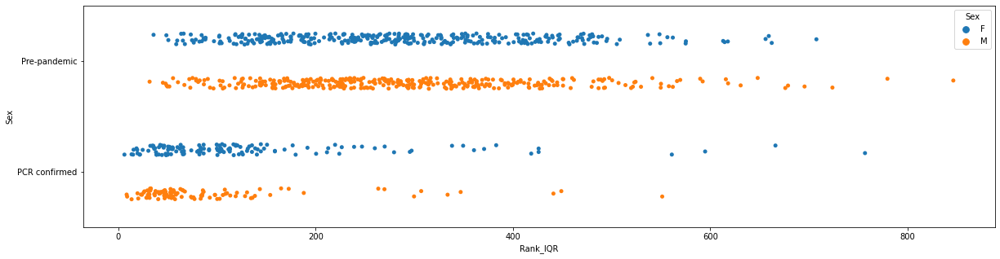

                        sum_sq     df           F        PR(>F)
C(Sex)            2.114288e+03    1.0    0.120672  7.283870e-01
C(Status)         5.248070e+06    1.0  299.531935  3.320311e-58
C(Sex):C(Status)  9.489418e+04    1.0    5.416055  2.017170e-02
Residual          1.589146e+07  907.0         NaN           NaN

Rank_standard_deviation:


<Figure size 432x288 with 0 Axes>

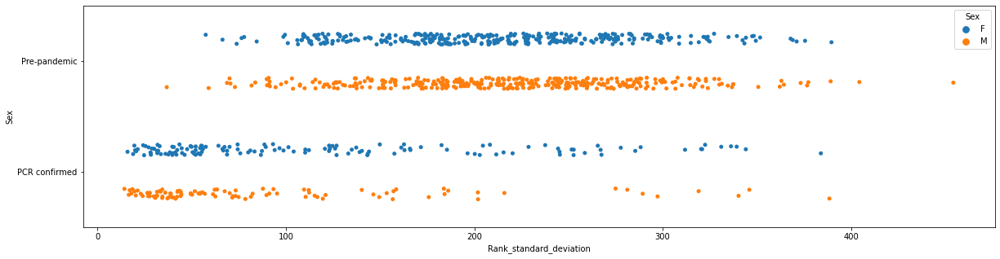

                        sum_sq     df           F        PR(>F)
C(Sex)            3.140186e+03    1.0    0.580784  4.462034e-01
C(Status)         1.949313e+06    1.0  360.529425  6.001510e-68
C(Sex):C(Status)  5.142020e+04    1.0    9.510271  2.105114e-03
Residual          4.903974e+06  907.0         NaN           NaN

Rank_range:


<Figure size 432x288 with 0 Axes>

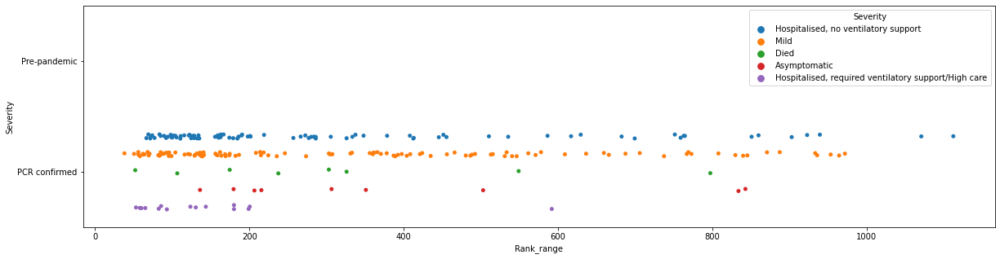

ANOVA p-value (PCR-confirmed samples only): 0.0680766381874717

Rank_IQR:


<Figure size 432x288 with 0 Axes>

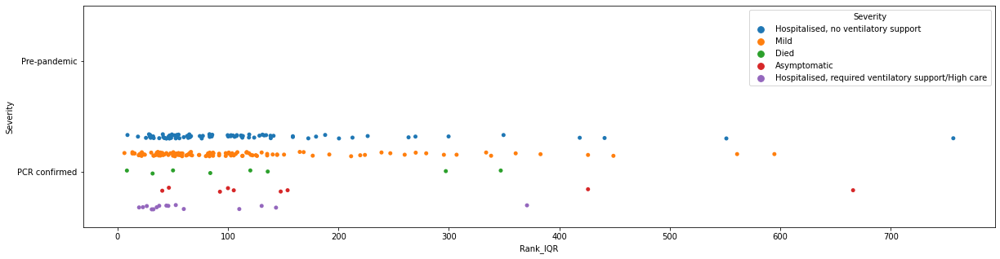

ANOVA p-value (PCR-confirmed samples only): 0.19503685148201685

Rank_standard_deviation:


<Figure size 432x288 with 0 Axes>

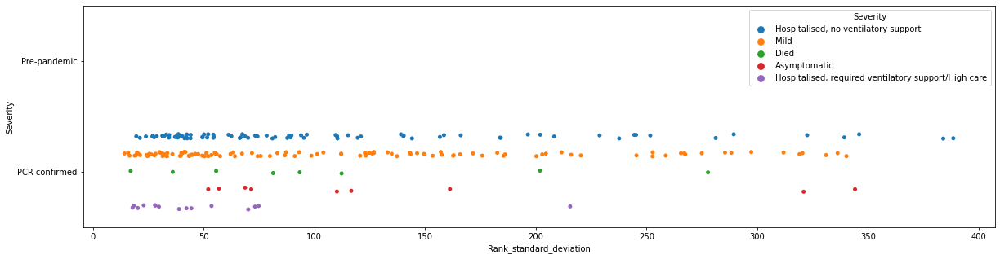

ANOVA p-value (PCR-confirmed samples only): 0.07707558733847782


In [68]:
# Do samples give equivalent readings across the 10 assays, or is there variability in which samples have high
# readings in different assays?

rank_dfs = {}
pos_rank_dfs = {}

for label, dfs in OrderedDict({
    'Threshold': [thresh_all_ml_x, pos_thresh_all_ml_x, thresh_ml_y, pos_thresh_ml_y],
    'Validation': [val_all_ml_x, pos_val_all_ml_x, val_ml_y, pos_val_ml_y],
    'All data': [comb_all_ml_x, pos_comb_all_ml_x, comb_ml_y, pos_comb_ml_y]
}).items():

    print('\n\n\n{}'.format(label))
    df = dfs[0]
    pos_df = dfs[1]
    y = dfs[2]
    pos_y = dfs[3]

    if label == 'Threshold':
        cols_list = [thresh_upd_cont_cols, val_upd_cont_cols]
    else:
        cols_list = [val_upd_cont_cols]
        
    for i, cols in enumerate(cols_list):
        if i == 1:
            print('Threshold dataset only considering the assays also considered in the validation dataset')

        # Plots heatmap of difference in rank value across all samples
        print('All samples')
        rank_df = pd.concat([copy.deepcopy(df), copy.deepcopy(y)], axis=1).reset_index(drop=True)
        for col in cols:
            rank_df[col] = rank_df[col].rank()
        # Sort by ELISA Spike Pan Norm
        rank_df = rank_df.sort_values(by='ELISA Spike Pan Norm')
        rank_df = rank_df.reset_index(drop=True)
        # ANOVA with statsmodels doesn't recognise column labels with spaces
        if 'Age group' in rank_df.columns:
            rank_df = rank_df.rename(columns={'Age group': 'Age_group'}, inplace=False)
        if 'Time period' in rank_df.columns:
            rank_df = rank_df.rename(columns={'Time period': 'Time_period'}, inplace=False)

        plt.clf()
        plt.figure(figsize=(10, 20))
        sns.heatmap(rank_df[cols], cmap='RdBu_r', yticklabels=False)
        plt.show()
        
        # Plots line graph showing how each sample's rank varies across assays
        plt.clf()
        plt.figure(figsize=(10, 8))
        for row in range(rank_df.shape[0]):
            if rank_df['Status'][row] == 'Pre-pandemic':
                colour='tab:blue'
            elif rank_df['Status'][row] == 'PCR confirmed':
                colour = 'tab:orange'
            sns.lineplot(x=cols, y=rank_df[cols].iloc[row,:], color=colour, ci=None, markers=True, alpha=0.2)
        plt.xticks(rotation=90)
        plt.xlabel('Assay')
        plt.ylabel('Rank')
        if label == 'All data':
            plt.savefig('All_data_pos_neg_rank_lineplot.svg')
        plt.show()

        if i == 0:
            rank_dfs[label] = rank_df

        # Plots heatmap of difference in rank value across positive samples
        print('Positive samples')
        pos_rank_df = pd.concat([copy.deepcopy(pos_df), copy.deepcopy(pos_y)], axis=1).reset_index(drop=True)
        for col in cols:
            pos_rank_df[col] = pos_rank_df[col].rank()
        # Sort by 'ELISA Spike Pan Norm' column
        pos_rank_df = pos_rank_df.sort_values(by='ELISA Spike Pan Norm')
        pos_rank_df = pos_rank_df.reset_index(drop=True)

        plt.clf()
        plt.figure(figsize=(10, 20))
        sns.heatmap(pos_rank_df[cols], cmap='RdBu_r', yticklabels=False)
        plt.show()

        if i == 0:
            pos_rank_dfs[label] = pos_rank_df

        # Makes scatter plots of rank differences split by Status, Sex and Age. Also calculates whether there
        # is a statistically significant difference between the rank differences of the different groups
        rank_range = []
        rank_iqr = []
        rank_std = []
        for i in range(rank_df.shape[0]):
            ranks = rank_df[cols].iloc[i,:]
            min_rank = np.min(ranks)
            max_rank = np.max(ranks)
            range_ = max_rank - min_rank
            iqr = np.percentile(ranks, 75) - np.percentile(ranks, 25)
            std = np.std(ranks, ddof=0)
            rank_range.append(range_)
            rank_iqr.append(iqr)
            rank_std.append(std)

        if label == 'Threshold':
            hues = {'None': None,
                    'Sex': rank_df['Sex'],
                    'Age_group': rank_df['Age_group'],
                    'Severity': rank_df['Severity']}
        elif label == 'Validation':
            hues = {'None': None,
                    'Sex': rank_df['Sex'],
                    'Severity': rank_df['Severity'],
                    'Hospitalised': rank_df['Hospitalised'],
                    'Time_period': rank_df['Time_period']}
        else:
            hues = {'None': None,
                    'Sex': rank_df['Sex'],
                    'Severity': rank_df['Severity']}

        for hue_label, hue in hues.items():
            for rank_label, rank_type in {'Rank_range': rank_range,
                                          'Rank_IQR': rank_iqr,
                                          'Rank_standard_deviation': rank_std}.items():
                # Makes scatter plot of range/IQR/std dev of rank values obtained for each data point
                print('\n{}:'.format(rank_label))
                plt.clf()
                plt.figure(figsize=(20, 5))
                sns.stripplot(
                    x=rank_type, y=rank_df['Status'], hue=hue, dodge=True, jitter=True, orient='h'
                )
                plt.xlabel(rank_label)
                if hue_label != 'None':
                    plt.ylabel(hue_label)
                else:
                    plt.ylabel('Status')
                plt.show()
            
                # Calculates whether there is a significant difference between the groups with different hues
                if hue is None:
                    group_1 = []
                    group_2 = []
                    for n in range(rank_df.shape[0]):
                        if rank_df['Status'][n] == 'Pre-pandemic':
                            group_1.append(rank_type[n])
                        elif rank_df['Status'][n] == 'PCR confirmed':
                            group_2.append(rank_type[n])
                    F, p = f_oneway(group_1, group_2)
                    print('ANOVA p-value: {}'.format(p))
                elif hue_label == 'Age_group':
                    continue  # Only different categories for pre-pandemic samples
                elif hue_label == 'Severity':
                    group_1 = []
                    group_2 = []
                    group_3 = []
                    group_4 = []
                    group_5 = []
                    for n in range(rank_df.shape[0]):
                        if rank_df['Severity'][n] == 'Asymptomatic':
                            group_1.append(rank_type[n])
                        elif rank_df['Severity'][n] == 'Mild':
                            group_2.append(rank_type[n])
                        elif rank_df['Severity'][n] == 'Hospitalised, no ventilatory support':
                            group_3.append(rank_type[n])
                        elif rank_df['Severity'][n] == 'Hospitalised, required ventilatory support/High care':
                            group_4.append(rank_type[n])
                        elif rank_df['Severity'][n] == 'Died':
                            group_5.append(rank_type[n])
                    F, p = f_oneway(group_1, group_2, group_3, group_4, group_5)
                    print('ANOVA p-value (PCR-confirmed samples only): {}'.format(p))
                elif hue_label == 'Hospitalised':
                    group_1 = []
                    group_2 = []
                    for n in range(rank_df.shape[0]):
                        if rank_df['Hospitalised'][n] == 'Yes':
                            group_1.append(rank_type[n])
                        elif rank_df['Hospitalised'][n] == 'No':
                            group_2.append(rank_type[n])
                    F, p = f_oneway(group_1, group_2)
                    print('ANOVA p-value (PCR-confirmed samples only): {}'.format(p))
                elif hue_label == 'Time_period':
                    group_1 = []
                    group_2 = []
                    group_3 = []
                    for n in range(rank_df.shape[0]):
                        if rank_df['Time_period'][n] == 'Acute':
                            group_1.append(rank_type[n])
                        elif rank_df['Time_period'][n] == 'Early Convalescent':
                            group_2.append(rank_type[n])
                        elif rank_df['Time_period'][n] == 'Late Convalescent':
                            group_3.append(rank_type[n])
                    F, p = f_oneway(group_1, group_2, group_3)
                    print('ANOVA p-value (PCR-confirmed samples only): {}'.format(p))
                else:
                    anova_df = pd.concat([
                        rank_df[[hue_label]], pd.DataFrame({rank_label: rank_type}), rank_df[['Status']]
                    ], axis=1).reset_index(drop=True)
                    model = ols('{} ~ C({}) + C(Status) + C({}):C(Status)'.format(
                        rank_label, hue_label, hue_label
                    ), data=anova_df).fit()
                    anova_results = sm.stats.anova_lm(model, typ=2)
                    print(anova_results)

In [69]:
test_df = pd.concat([val_all_ml_x, val_ml_y], axis=1)
test_df = test_df[test_df['Sex'].isin(['M', 'F'])].reset_index(drop=True)
neg_test_df = test_df[test_df['Status']=='Pre-pandemic'].reset_index(drop=True)
pos_test_df = test_df[test_df['Status']=='PCR confirmed'].reset_index(drop=True)
print(test_df['Sex'].tolist().count('M')/test_df.shape[0], test_df['Sex'].tolist().count('F')/test_df.shape[0])
print(neg_test_df['Sex'].tolist().count('M')/neg_test_df.shape[0],
      neg_test_df['Sex'].tolist().count('F')/neg_test_df.shape[0])
print(pos_test_df['Sex'].tolist().count('M')/pos_test_df.shape[0],
      pos_test_df['Sex'].tolist().count('F')/pos_test_df.shape[0])

0.48 0.52
0.5121951219512195 0.4878048780487805
0.4105263157894737 0.5894736842105263


Summary:
- Is a clear difference between the array of ranks of negative and positive samples (negative samples tend to have a wider array of assay rankings, which makes sense, especially given that there are more negative as compared to positive samples => indicates that the individual assays are good at distinguishing between positive and negative samples). This relationship is conserved in the threshold dataset both when I look at all of the assays performed and when look only at the subset of those assays that were also performed for the validation set (i.e. without the IgM assay data available for the threshold dataset).
- There is no clear difference between the array of ranks of males and females in either the negative or the positive individuals. However, in the validation set appears to be substantial interaction between sex and covid status, i.e. the relative numbers of males and females across the pre-pandemic and PCR confirmed samples is not the same (pre-pandemic: M = 0.51, F = 0.49; PCR confirmed: M = 0.41, F = 0.59).
- There is no clear difference between the array of ranks of child, teen and adult age groups in negative individuals. All of the PCR positive individuals are adults, therefore I can't tell if there is any difference with age group. It is of course the positive samples in which we are interested in seeing if there is any correlation with "positivity", so will have to hold off judgement about relationship with age until perform regression analysis with age values rather than category as assessed here.
- There is no clear difference between the array of ranks of the positive patients and their "severity" category. When considering the threshold dataset alone, appears that rank ranges (and IQRs etc.) might be smaller for patients with more severe disease, however this apparent relationship breaks down when look at the (larger number of) positive samples in the validation dataset. So, appears that is just as much variation in the readings given by the different assays for severely ill and asymptomatic patients. This is perhaps a little surprising (at least to me!). So, array of ranks is not a predictor of disease severity.
- There is no clear difference between the array of ranks of the positive patients in different phases of the disease ("time period"); possibly smaller range in early and late phase convalescent as compared to acute (would make sense - possible some acute patients haven't yet seroconverted), but difference is too small to tell if is real or not, could easily be noise artefact. ANOVA indicates no obvious difference.
- There is no clear difference between the array of ranks of hospitalised and non-hospitalised positive patients (i.e. same result as observed for "severity" category).
- There is fairly good agreement between ranks of positive samples across all datasets (thus indicating that each of the individual assays works pretty well to distinguish between positive and negative samples). As would be expected, there is more disagreement when just consider the ranks of positive samples (but remember that the scales on the "all samples" and "positive samples" heatmaps are very different!). There appears to be greatest correlation between samples collected with the same secondary antibody.

In [70]:
# What are the differences in ranking between different assays? (All samples)

rank_diff_dfs = {}

for label in ['Threshold', 'Validation', 'All data']:
    if label == 'Threshold':
        col_pairs = [col for col in combinations(thresh_upd_cont_cols, 2)]
    else:
        col_pairs = [col for col in combinations(val_upd_cont_cols, 2)]
    rank_sum = []
    rank_df = rank_dfs[label]

    for pair in col_pairs:
        col_1 = pair[0]
        col_2 = pair[1]
    
        rank_diffs = []
        for n in range(rank_df.shape[0]):
            rank_1 = rank_df[col_1][n]
            rank_2 = rank_df[col_2][n]
            rank_diffs.append(np.abs(rank_1-rank_2))
        rank_sum.append(np.sum(rank_diffs))

    rank_diff_df = pd.DataFrame({'Assay combination': col_pairs,
                                 'Rank difference sum': rank_sum})
    rank_diff_df = rank_diff_df.sort_values(by='Rank difference sum').reset_index(drop=True)
    rank_diff_dfs[label] = rank_diff_df
    print('\n\n\n{}'.format(label))
    print(rank_diff_df)




Threshold
                                Assay combination  Rank difference sum
0      (ELISA RBD Pan Norm, ELISA Spike Pan Norm)              21893.0
1      (ELISA RBD IgA Norm, ELISA Spike IgA Norm)              26837.0
2      (ELISA RBD IgM Norm, ELISA Spike IgM Norm)              30551.0
3          (ELISA N IgM Norm, ELISA RBD IgM Norm)              35756.0
4          (ELISA N IgA Norm, ELISA RBD IgA Norm)              36855.0
5        (ELISA N IgA Norm, ELISA Spike IgA Norm)              37594.0
6        (ELISA N IgM Norm, ELISA Spike IgM Norm)              38528.0
7    (ELISA Spike Pan Norm, ELISA Spike IgA Norm)              39346.0
8        (ELISA N Pan Norm, ELISA Spike Pan Norm)              41371.0
9          (ELISA N Pan Norm, ELISA RBD Pan Norm)              41436.0
10     (ELISA RBD Pan Norm, ELISA Spike IgA Norm)              41524.0
11           (ELISA N Pan Norm, ELISA N IgA Norm)              42864.0
12       (ELISA N Pan Norm, ELISA Spike IgA Norm)              4




Threshold
Most similar                                                               Most different


<Figure size 432x288 with 0 Axes>

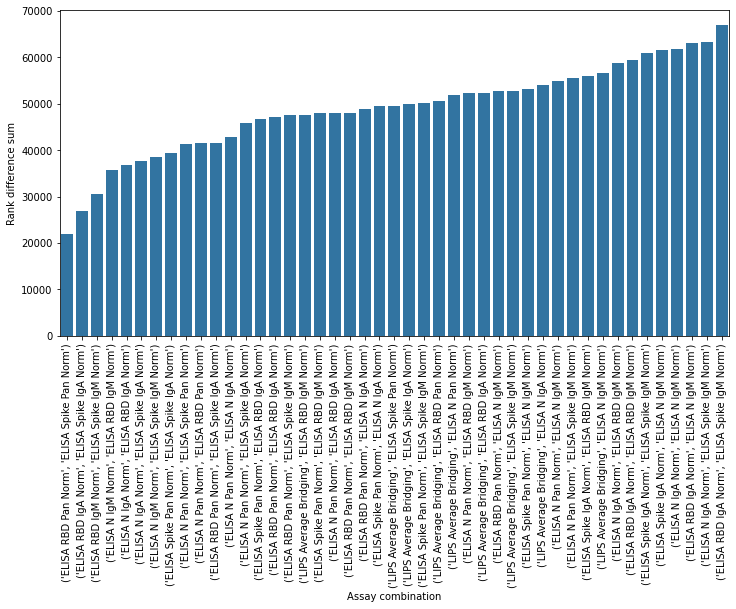




Validation
Most similar                                                               Most different


<Figure size 432x288 with 0 Axes>

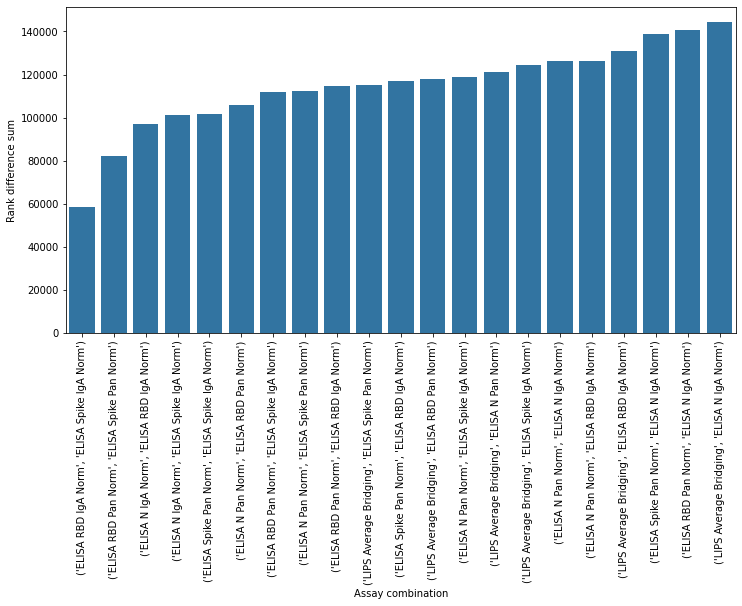




All data
Most similar                                                               Most different


<Figure size 432x288 with 0 Axes>

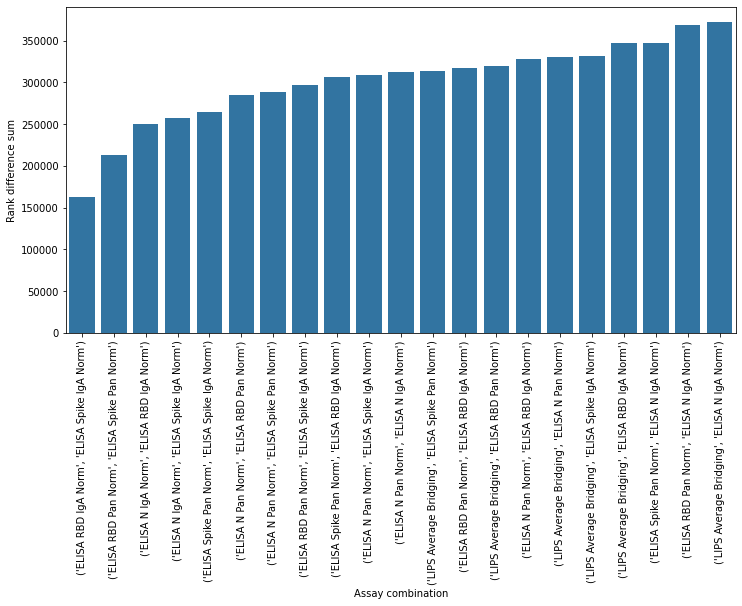

In [71]:
for label in ['Threshold', 'Validation', 'All data']:
    rank_diff_df = rank_diff_dfs[label]
    print('\n\n\n{}'.format(label))
    print('Most similar                                                               Most different')
    plt.clf()
    plt.figure(figsize=(12, 6))
    sns.barplot(data=rank_diff_df, x='Assay combination', y='Rank difference sum', color='tab:blue')
    plt.xticks(rotation=90)
    plt.show()

Assay similarity relationships are fairly consistent across the threshold and validation datasets (yay!):
- Greatest similarity between RBD and Spike (same secondary antibody)
- Then between N and RBD/Spike (same secondary antibody)
- Then between different secondary antibodies (same antigen)
- LIPS assay tends to be more different from the ELISA assays (as compared to differences between ELISA assays), but remember multiple 0 values => equal ranks of most negative samples, unlike the other assays. Will be interesting to see if this relationship holds when positive samples only are compared
- In the case of the threshold dataset, PanIg and IgA assays are most similar, then PanIg and IgM assays, whilst IgM and IgA assays are the most different (not surprising that PanIg assays are more similar to the other two than they are to each other). (Can't compare this to the validation dataset as no IgM data.)
- RBD and Spike assays are more similar to each other than to N (not surprising given that RBD is a subdomain of Spike).

So, results are in general more similar between assays using the same secondary antibody (and different antigens), as compared to using the same antigen (and different secondary antibodies). This may be due to greater similarity between negative samples when using the same secondary antibody => will be interesting to see if this pattern holds when examining the positive samples only.




Threshold
Most similar


ELISA RBD Pan Norm, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

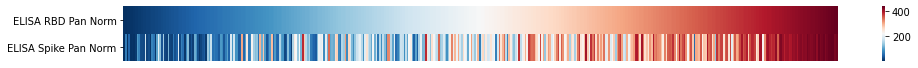



ELISA RBD IgA Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

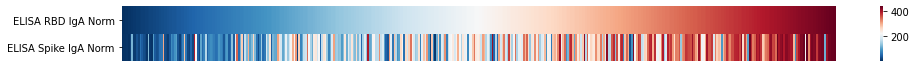



ELISA RBD IgM Norm, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

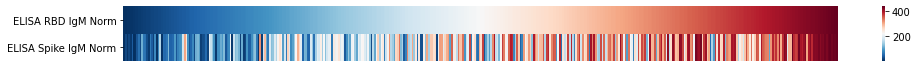



ELISA N IgM Norm, ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

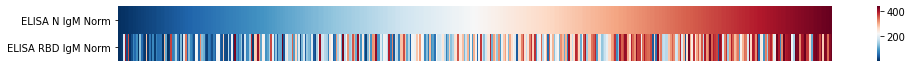



ELISA N IgA Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

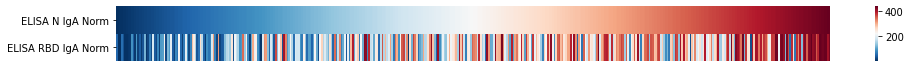



ELISA N IgA Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

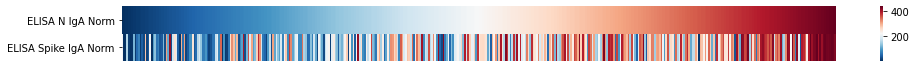



ELISA N IgM Norm, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

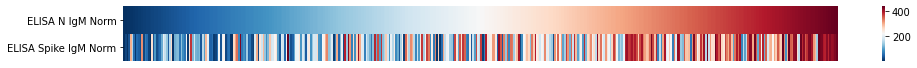



ELISA Spike Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

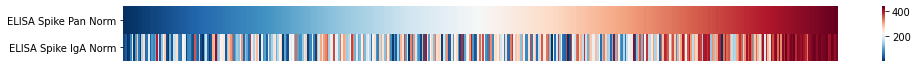



ELISA N Pan Norm, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

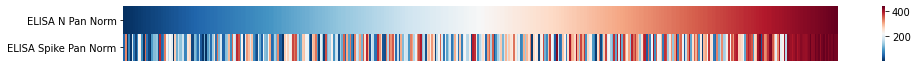



ELISA N Pan Norm, ELISA RBD Pan Norm


<Figure size 432x288 with 0 Axes>

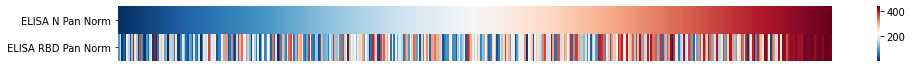



ELISA RBD Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

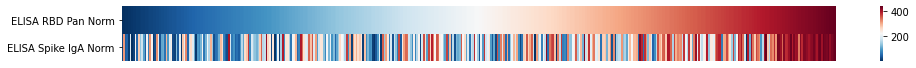



ELISA N Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

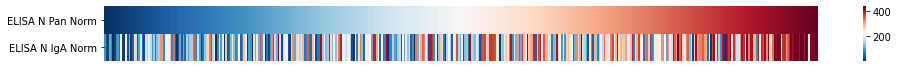



ELISA N Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

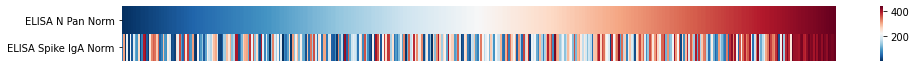



ELISA Spike Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

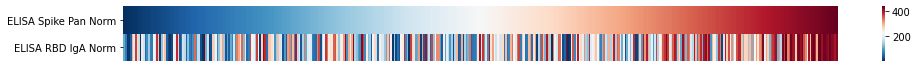



ELISA RBD Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

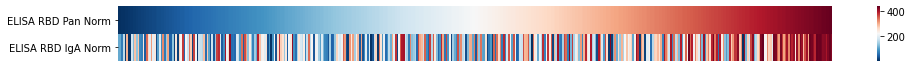



ELISA RBD Pan Norm, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

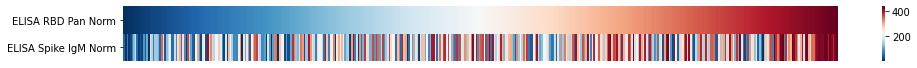



LIPS Average Bridging, ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

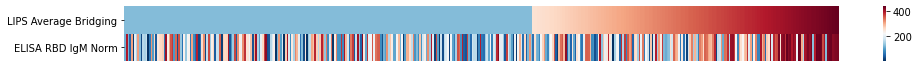



ELISA Spike Pan Norm, ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

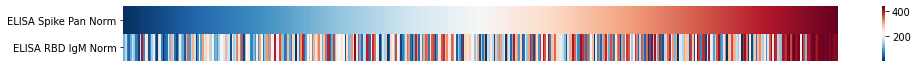



ELISA N Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

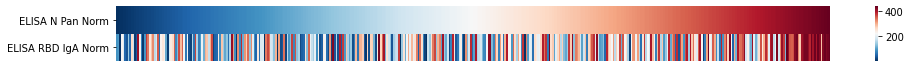



ELISA RBD Pan Norm, ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

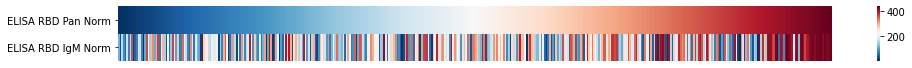



ELISA RBD Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

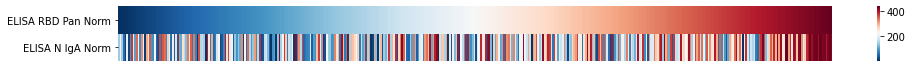



ELISA Spike Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

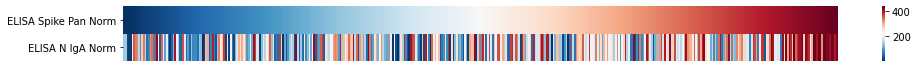



LIPS Average Bridging, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

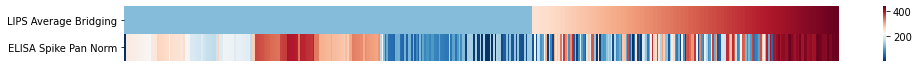



LIPS Average Bridging, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

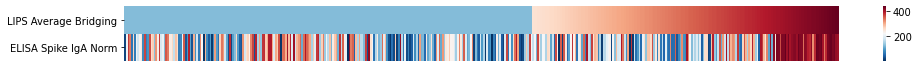



ELISA Spike Pan Norm, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

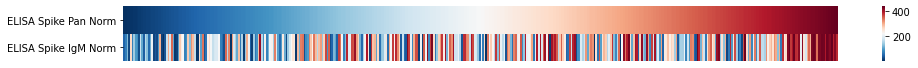



LIPS Average Bridging, ELISA RBD Pan Norm


<Figure size 432x288 with 0 Axes>

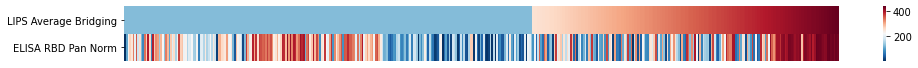



LIPS Average Bridging, ELISA N Pan Norm


<Figure size 432x288 with 0 Axes>

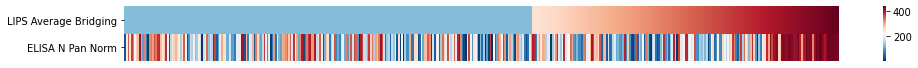



ELISA N Pan Norm, ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

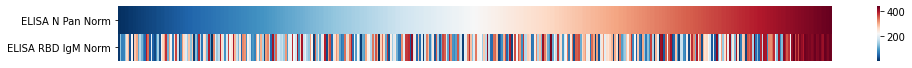



LIPS Average Bridging, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

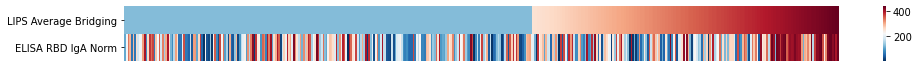



ELISA RBD Pan Norm, ELISA N IgM Norm


<Figure size 432x288 with 0 Axes>

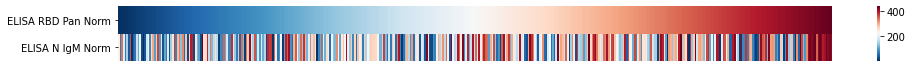



LIPS Average Bridging, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

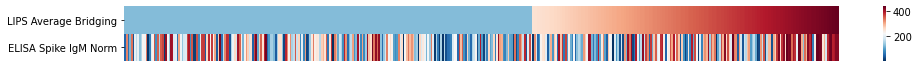



ELISA Spike Pan Norm, ELISA N IgM Norm


<Figure size 432x288 with 0 Axes>

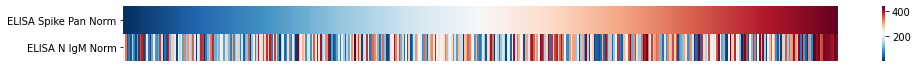



LIPS Average Bridging, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

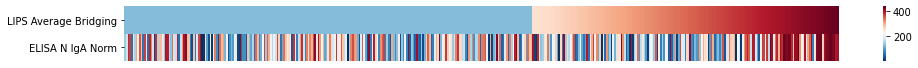



ELISA N Pan Norm, ELISA N IgM Norm


<Figure size 432x288 with 0 Axes>

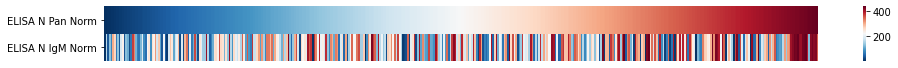



ELISA N Pan Norm, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

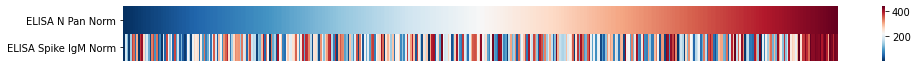



ELISA Spike IgA Norm, ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

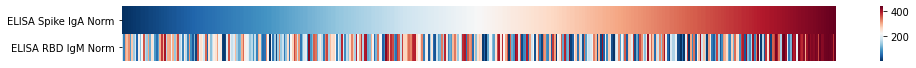



LIPS Average Bridging, ELISA N IgM Norm


<Figure size 432x288 with 0 Axes>

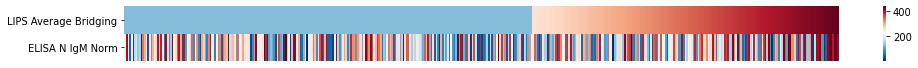



ELISA N IgA Norm, ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

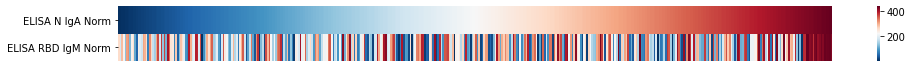



ELISA RBD IgA Norm, ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

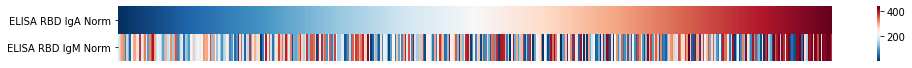



ELISA Spike IgA Norm, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

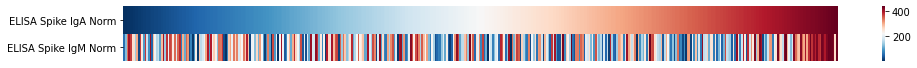



ELISA Spike IgA Norm, ELISA N IgM Norm


<Figure size 432x288 with 0 Axes>

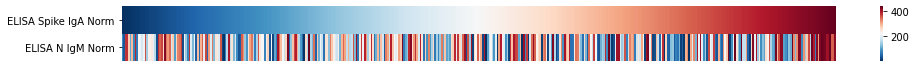



ELISA N IgA Norm, ELISA N IgM Norm


<Figure size 432x288 with 0 Axes>

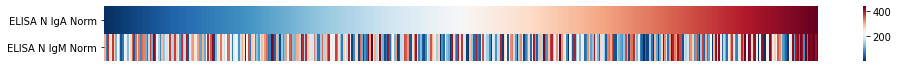



ELISA RBD IgA Norm, ELISA N IgM Norm


<Figure size 432x288 with 0 Axes>

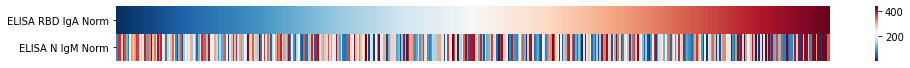



ELISA N IgA Norm, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

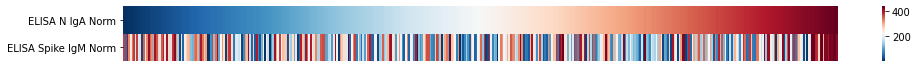



ELISA RBD IgA Norm, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

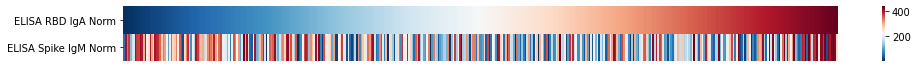

Most different



Validation
Most similar


ELISA RBD IgA Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

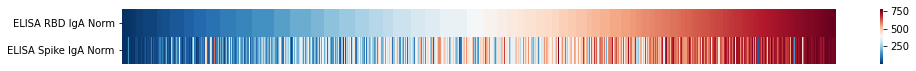



ELISA RBD Pan Norm, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

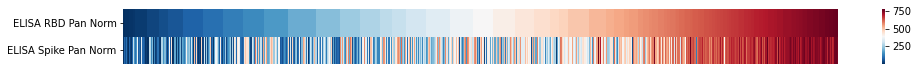



ELISA N IgA Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

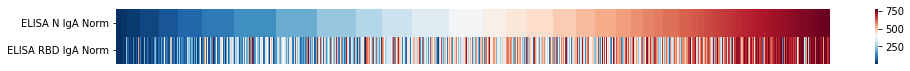



ELISA N IgA Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

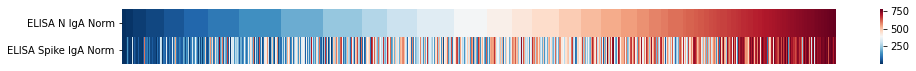



ELISA Spike Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

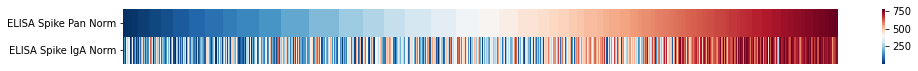



ELISA N Pan Norm, ELISA RBD Pan Norm


<Figure size 432x288 with 0 Axes>

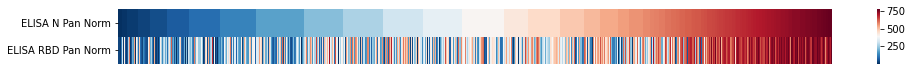



ELISA RBD Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

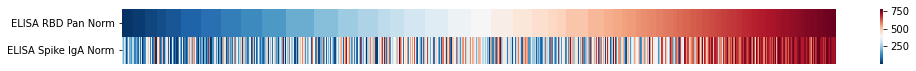



ELISA N Pan Norm, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

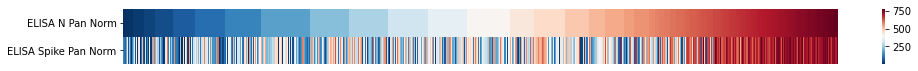



ELISA RBD Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

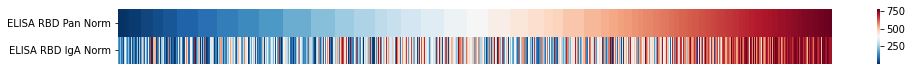



LIPS Average Bridging, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

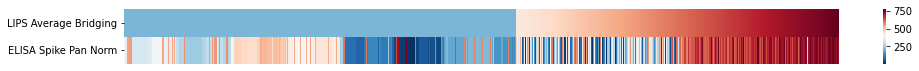



ELISA Spike Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

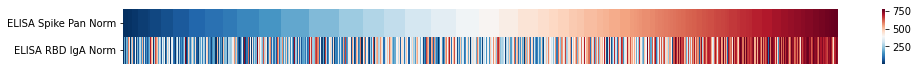



LIPS Average Bridging, ELISA RBD Pan Norm


<Figure size 432x288 with 0 Axes>

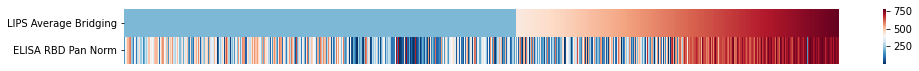



ELISA N Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

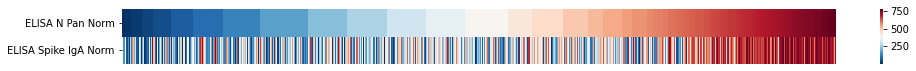



LIPS Average Bridging, ELISA N Pan Norm


<Figure size 432x288 with 0 Axes>

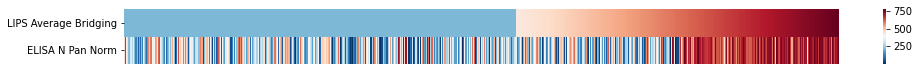



LIPS Average Bridging, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

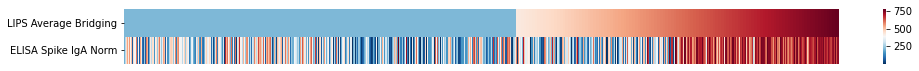



ELISA N Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

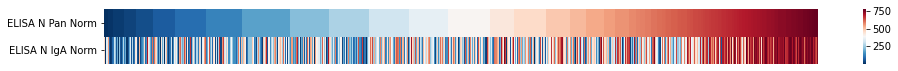



ELISA N Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

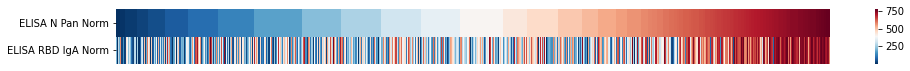



LIPS Average Bridging, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

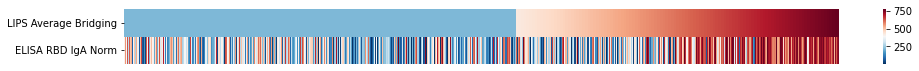



ELISA Spike Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

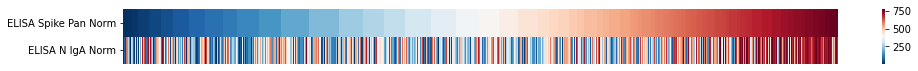



ELISA RBD Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

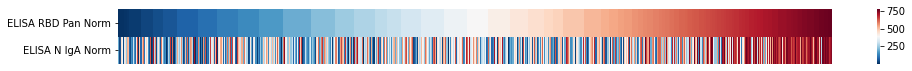



LIPS Average Bridging, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

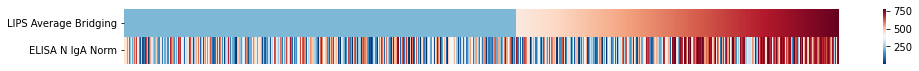

Most different



All data
Most similar


ELISA RBD IgA Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

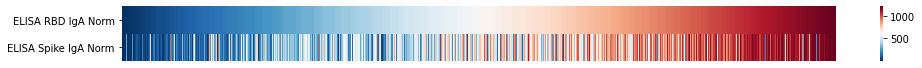



ELISA RBD Pan Norm, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

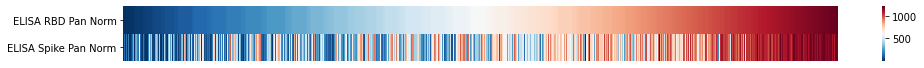



ELISA N IgA Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

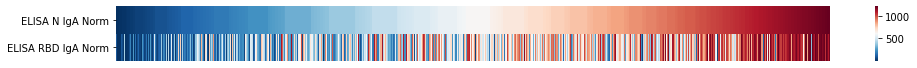



ELISA N IgA Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

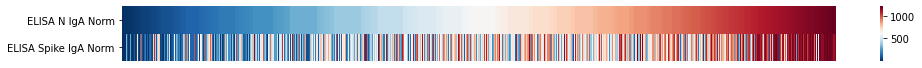



ELISA Spike Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

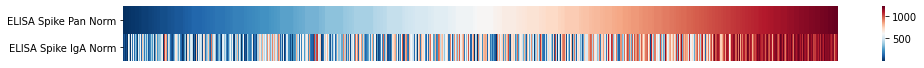



ELISA N Pan Norm, ELISA RBD Pan Norm


<Figure size 432x288 with 0 Axes>

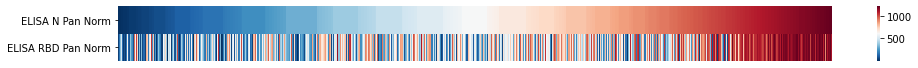



ELISA N Pan Norm, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

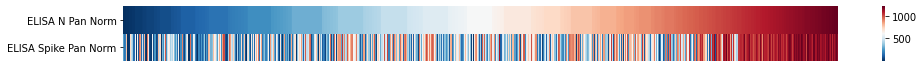



ELISA RBD Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

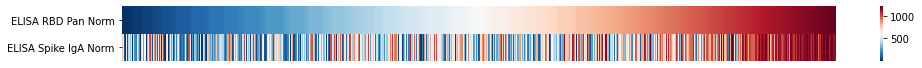



ELISA Spike Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

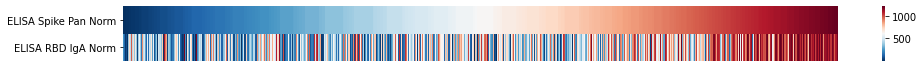



ELISA N Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

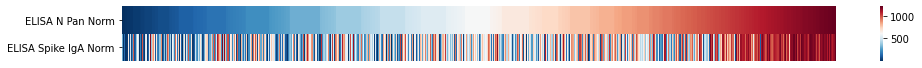



ELISA N Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

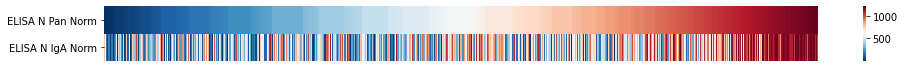



LIPS Average Bridging, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

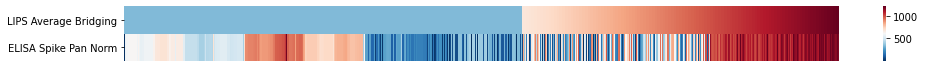



ELISA RBD Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

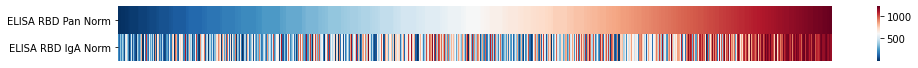



LIPS Average Bridging, ELISA RBD Pan Norm


<Figure size 432x288 with 0 Axes>

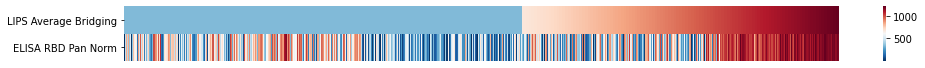



ELISA N Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

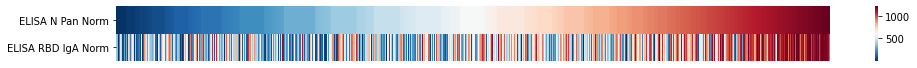



LIPS Average Bridging, ELISA N Pan Norm


<Figure size 432x288 with 0 Axes>

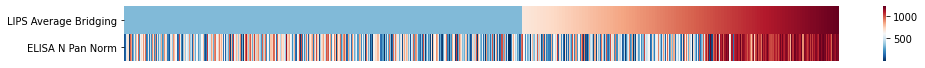



LIPS Average Bridging, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

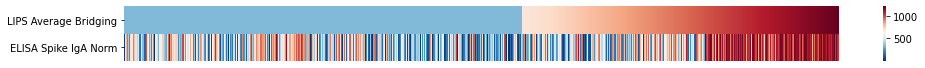



LIPS Average Bridging, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

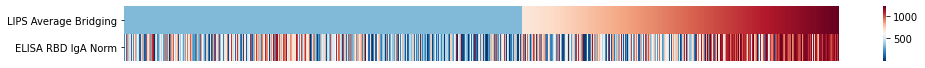



ELISA Spike Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

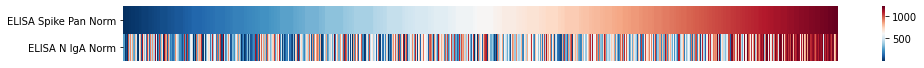



ELISA RBD Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

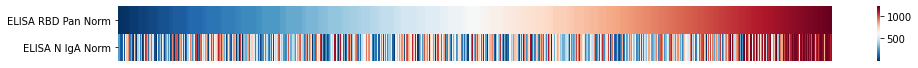



LIPS Average Bridging, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

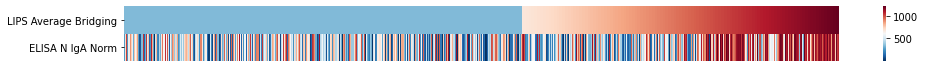

Most different


In [72]:
for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    print('Most similar')
    
    rank_df = rank_dfs[label]
    rank_diff_df = rank_diff_dfs[label]
    for col_pair in rank_diff_df['Assay combination']:
        col_1 = col_pair[0]
        col_2 = col_pair[1]

        sub_df = copy.deepcopy(rank_df)[[col_1, col_2]].sort_values(by=col_1).transpose()
        print('\n\n{}, {}'.format(col_1, col_2))
        plt.clf()
        plt.figure(figsize=(16, 1))
        sns.heatmap(sub_df, cmap='RdBu_r', xticklabels=False)
        plt.show()
    print('Most different')

In [73]:
# Which assays show the greatest similarity / difference to all others?

col_scores = {}

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    if label == 'Threshold':
        cols = thresh_upd_cont_cols
    else:
        cols = val_upd_cont_cols
    rank_diff_df = rank_diff_dfs[label]

    sub_col_scores = [0]*len(cols)
    for i, col in enumerate(cols):
        for n in range(rank_diff_df.shape[0]):
            if col in rank_diff_df['Assay combination'][n]:
                sub_col_scores[i] += n
    sub_col_scores = pd.DataFrame({'Assay': cols,
                                   'Score': sub_col_scores})
    sub_col_scores = sub_col_scores.sort_values(by='Score').reset_index(drop=True)
    col_scores[label] = sub_col_scores
    print(sub_col_scores)




Threshold
                   Assay  Score
0     ELISA RBD Pan Norm    141
1   ELISA Spike Pan Norm    143
2   ELISA Spike IgA Norm    172
3       ELISA N Pan Norm    178
4     ELISA RBD IgM Norm    194
5     ELISA RBD IgA Norm    202
6       ELISA N IgA Norm    214
7   ELISA Spike IgM Norm    237
8  LIPS Average Bridging    238
9       ELISA N IgM Norm    261



Validation
                   Assay  Score
0   ELISA Spike IgA Norm     39
1   ELISA Spike Pan Norm     49
2     ELISA RBD Pan Norm     50
3     ELISA RBD IgA Norm     53
4       ELISA N Pan Norm     68
5       ELISA N IgA Norm     77
6  LIPS Average Bridging     84



All data
                   Assay  Score
0   ELISA Spike IgA Norm     39
1   ELISA Spike Pan Norm     48
2     ELISA RBD IgA Norm     53
3     ELISA RBD Pan Norm     57
4       ELISA N Pan Norm     59
5       ELISA N IgA Norm     72
6  LIPS Average Bridging     92


So, in agreement with the analysis above, the LIPS assay is one of the assays that is most different from the others. IgM ELISA assays tend to differ more (although can't see if the pattern observed for the threshold dataset is replicable in the validation dataset), whereas PanIg assays tend to be the most similar (not surprising given that PanIg is a combination of secondary antibody types). Moreover, N assays tend to differ more as compared to RBD and Spike (which again is not surprising, given that RBD is a subdomain of Spike). Most similar assays are Spike PanIg and Spike IgA, two of the assays  which give the best separation between positive and negative samples (probably not surprising as would expect these assays to be similar due to Spike (RBD is a subdomain of Spike) and PanIg (which is a combination of secondary antibody types) as described above).

In [74]:
# What are the differences in ranking between different assays? (Positive samples)

pos_rank_diff_dfs = {}

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    if label == 'Threshold':
        col_pairs = [col for col in combinations(thresh_upd_cont_cols, 2)]
    else:
        col_pairs = [col for col in combinations(val_upd_cont_cols, 2)]
    pos_rank_sum = []
    pos_rank_df = pos_rank_dfs[label]

    for pair in col_pairs:
        col_1 = pair[0]
        col_2 = pair[1]

        rank_diffs = []
        for n in range(pos_rank_df.shape[0]):
            rank_1 = pos_rank_df[col_1][n]
            rank_2 = pos_rank_df[col_2][n]
            rank_diffs.append(np.abs(rank_1-rank_2))
        pos_rank_sum.append(np.sum(rank_diffs))

    pos_rank_diff_df = pd.DataFrame({'Assay combination': col_pairs,
                                     'Rank difference sum': pos_rank_sum})
    pos_rank_diff_df = pos_rank_diff_df.sort_values(by='Rank difference sum').reset_index(drop=True)
    pos_rank_diff_dfs[label] = pos_rank_diff_df
    print(pos_rank_diff_df)




Threshold
                                Assay combination  Rank difference sum
0      (ELISA RBD IgM Norm, ELISA Spike IgM Norm)                122.0
1      (ELISA RBD Pan Norm, ELISA Spike Pan Norm)                174.0
2          (ELISA N Pan Norm, ELISA RBD Pan Norm)                262.0
3      (ELISA RBD IgA Norm, ELISA Spike IgA Norm)                298.0
4        (ELISA RBD Pan Norm, ELISA RBD IgM Norm)                326.0
5     (LIPS Average Bridging, ELISA RBD Pan Norm)                326.0
6        (ELISA N IgM Norm, ELISA Spike IgM Norm)                328.0
7          (ELISA N Pan Norm, ELISA RBD IgM Norm)                330.0
8        (ELISA N Pan Norm, ELISA Spike Pan Norm)                330.0
9    (ELISA Spike IgA Norm, ELISA Spike IgM Norm)                332.0
10  (LIPS Average Bridging, ELISA Spike Pan Norm)                334.0
11           (ELISA N Pan Norm, ELISA N IgM Norm)                344.0
12         (ELISA RBD Pan Norm, ELISA N IgM Norm)               




Threshold
Most similar                                                               Most different


<Figure size 432x288 with 0 Axes>

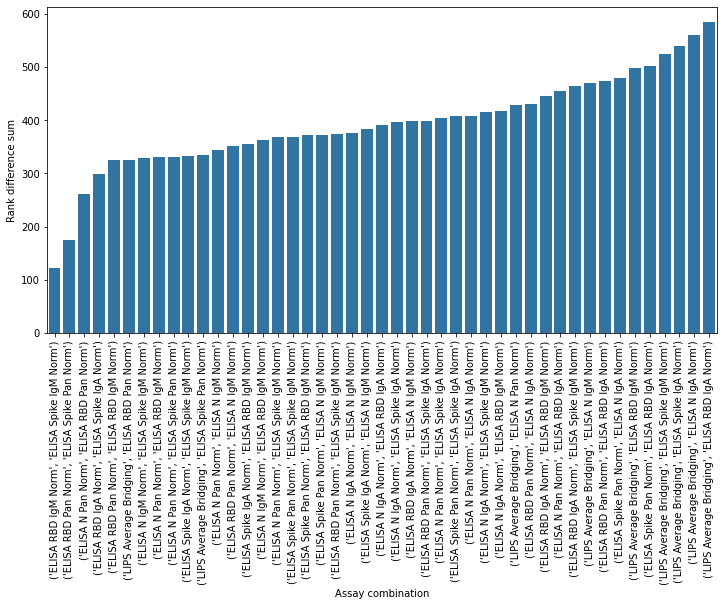




Validation
Most similar                                                               Most different


<Figure size 432x288 with 0 Axes>

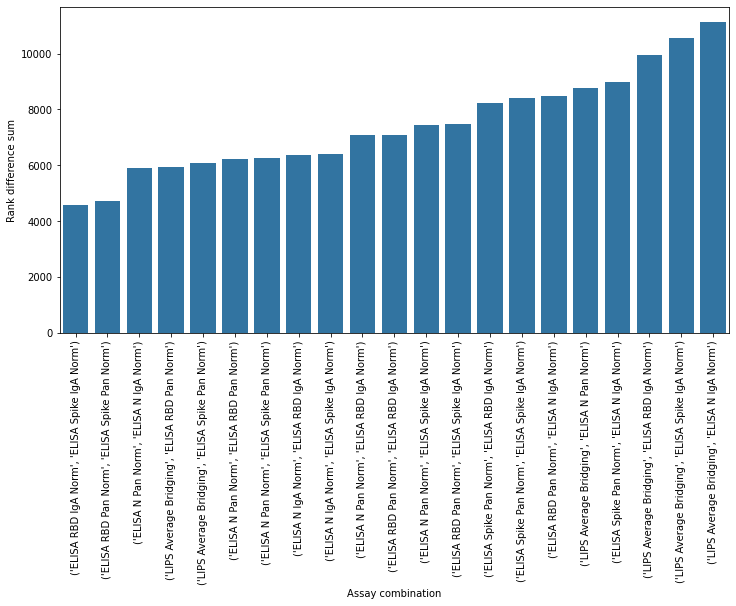




All data
Most similar                                                               Most different


<Figure size 432x288 with 0 Axes>

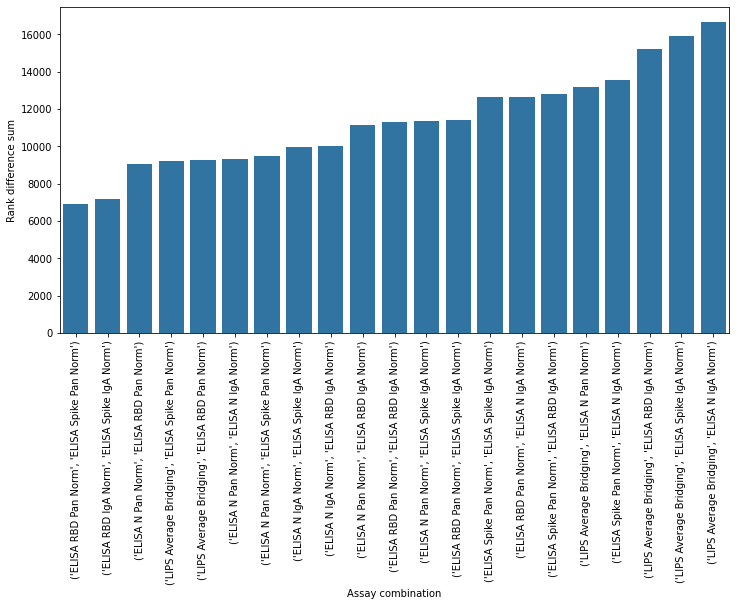

In [75]:
for label in ['Threshold', 'Validation', 'All data']:
    pos_rank_diff_df = pos_rank_diff_dfs[label]

    print('\n\n\n{}'.format(label))
    print('Most similar                                                               Most different')
    plt.clf()
    plt.figure(figsize=(12, 6))
    sns.barplot(data=pos_rank_diff_df, x='Assay combination', y='Rank difference sum', color='tab:blue')
    plt.xticks(rotation=90)
    plt.show()

Again, encouragingly assay similarity relationships are pretty well conserved across the threshold and validation datasets:

- Greatest similarity between RBD and Spike (same secondary antibody)
- Next highest similarity is between assays with the same secondary antibody (different antigen, N + RBD/Spike). (In particular for the threshold dataset, difference between similarity of assays with the same secondary antibody (different antigen), and with the same antigen (different secondary antibody), is less distinct here for just the positive samples than when comparing the assays across all samples. This would suggest that ordering of negative samples (whose scores are similar and noise would be expected to confound their rank order to a greater extent than positive samples) is partly, but not wholly responsible, for this difference. Rest (majority) of difference maybe explained by the fact that expect most similarity between the best-performing assays, and can see from previous plots that secondary antibody is a bigger predictor of how well an assay will distinguish between positive and negative individuals as compared to antigen.)
- Then assays with the same antigen (different secondary antibody).
- Whilst LIPS assays remain some of the most dissimilar assays, is actually one of the most similar assays to RBD/Spike with PanIg (so, likely equal ranking of most negative samples in the LIPS assay was partly responsible for the dissimilarity of the LIPS assay to the ELISA assays when considering all samples).




Threshold
Most similar


ELISA RBD IgM Norm, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

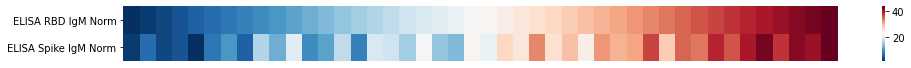



ELISA RBD Pan Norm, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

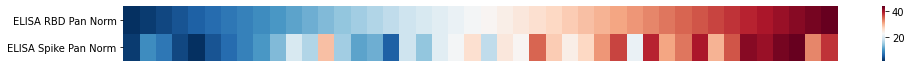



ELISA N Pan Norm, ELISA RBD Pan Norm


<Figure size 432x288 with 0 Axes>

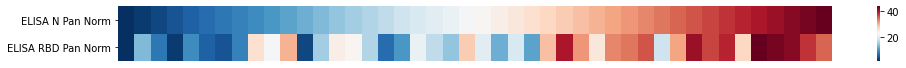



ELISA RBD IgA Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

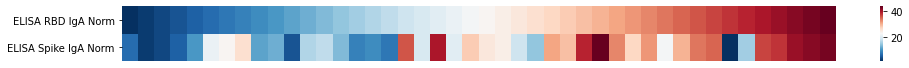



ELISA RBD Pan Norm, ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

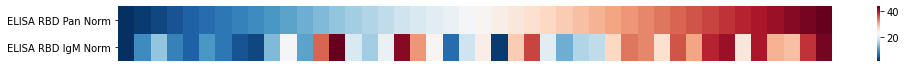



LIPS Average Bridging, ELISA RBD Pan Norm


<Figure size 432x288 with 0 Axes>

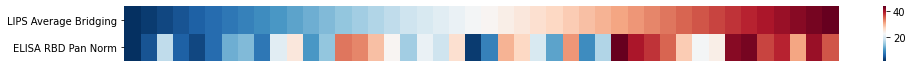



ELISA N IgM Norm, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

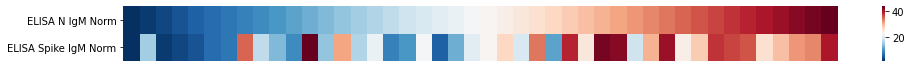



ELISA N Pan Norm, ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

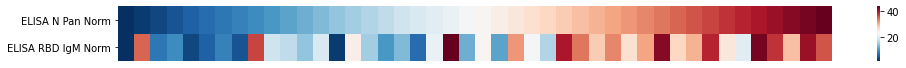



ELISA N Pan Norm, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

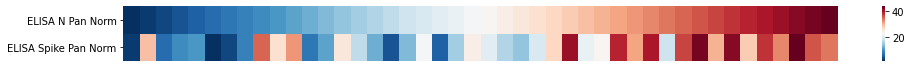



ELISA Spike IgA Norm, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

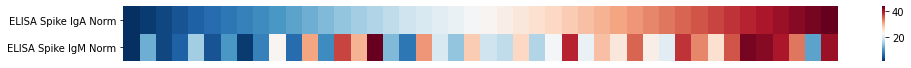



LIPS Average Bridging, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

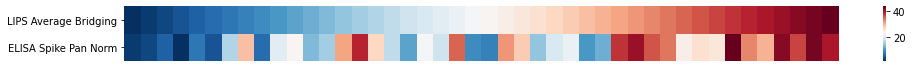



ELISA N Pan Norm, ELISA N IgM Norm


<Figure size 432x288 with 0 Axes>

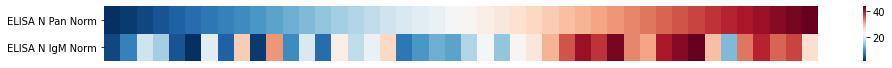



ELISA RBD Pan Norm, ELISA N IgM Norm


<Figure size 432x288 with 0 Axes>

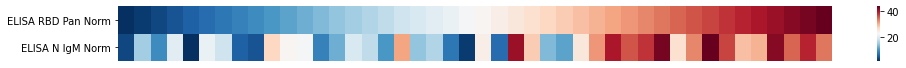



ELISA Spike IgA Norm, ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

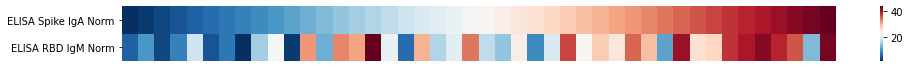



ELISA N IgM Norm, ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

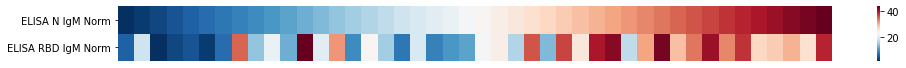



ELISA N Pan Norm, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

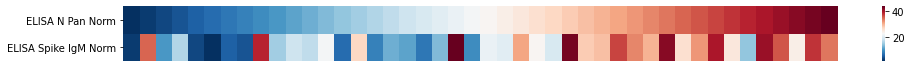



ELISA Spike Pan Norm, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

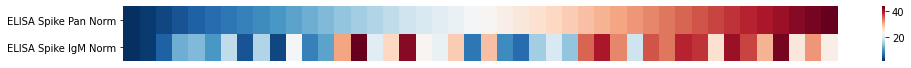



ELISA Spike Pan Norm, ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

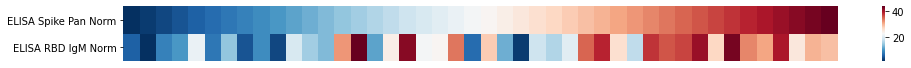



ELISA Spike Pan Norm, ELISA N IgM Norm


<Figure size 432x288 with 0 Axes>

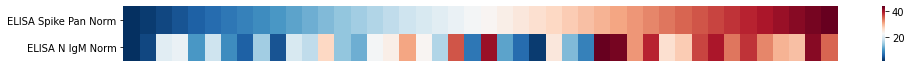



ELISA RBD Pan Norm, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

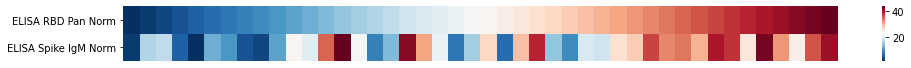



ELISA N IgA Norm, ELISA N IgM Norm


<Figure size 432x288 with 0 Axes>

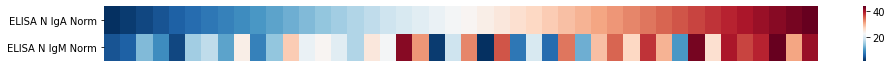



ELISA Spike IgA Norm, ELISA N IgM Norm


<Figure size 432x288 with 0 Axes>

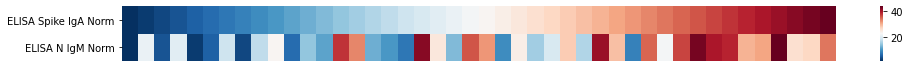



ELISA N IgA Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

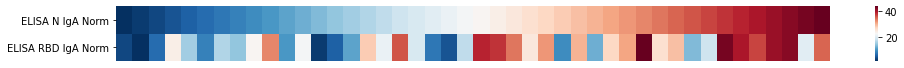



ELISA N IgA Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

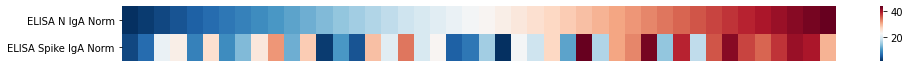



ELISA RBD IgA Norm, ELISA N IgM Norm


<Figure size 432x288 with 0 Axes>

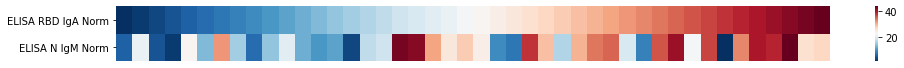



ELISA RBD Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

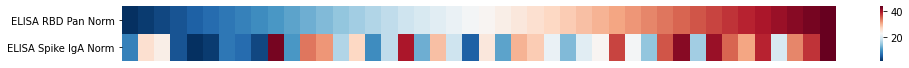



ELISA N Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

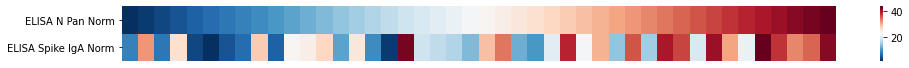



ELISA Spike Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

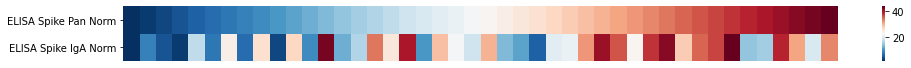



ELISA N Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

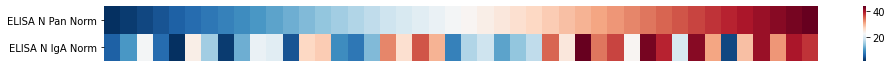



ELISA N IgA Norm, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

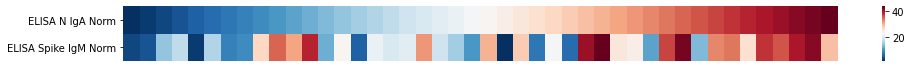



ELISA N IgA Norm, ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

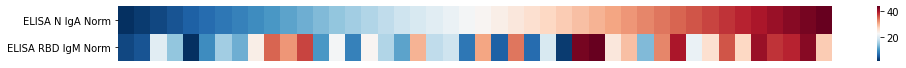



LIPS Average Bridging, ELISA N Pan Norm


<Figure size 432x288 with 0 Axes>

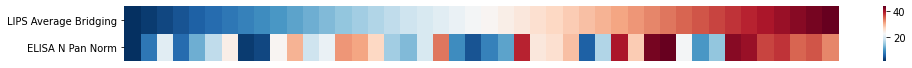



ELISA RBD Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

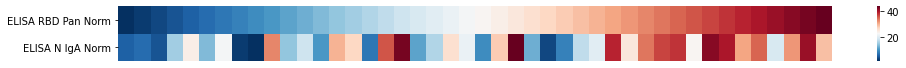



ELISA RBD IgA Norm, ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

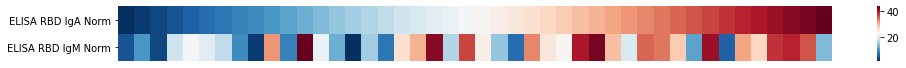



ELISA N Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

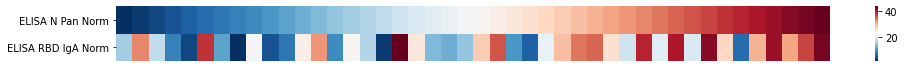



ELISA RBD IgA Norm, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

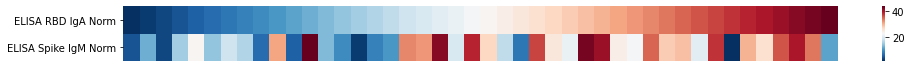



LIPS Average Bridging, ELISA N IgM Norm


<Figure size 432x288 with 0 Axes>

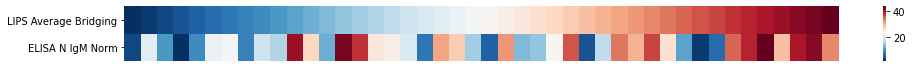



ELISA RBD Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

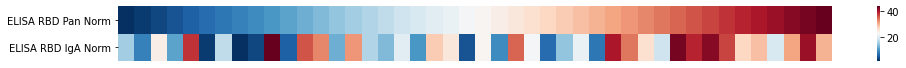



ELISA Spike Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

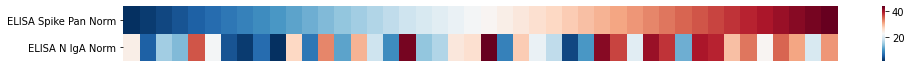



LIPS Average Bridging, ELISA RBD IgM Norm


<Figure size 432x288 with 0 Axes>

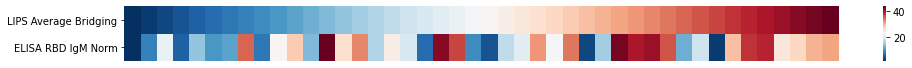



ELISA Spike Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

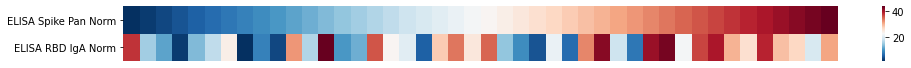



LIPS Average Bridging, ELISA Spike IgM Norm


<Figure size 432x288 with 0 Axes>

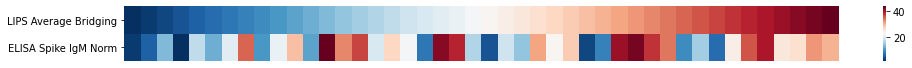



LIPS Average Bridging, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

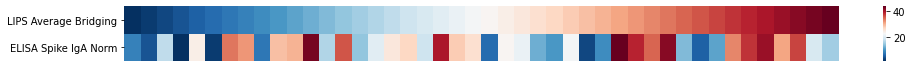



LIPS Average Bridging, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

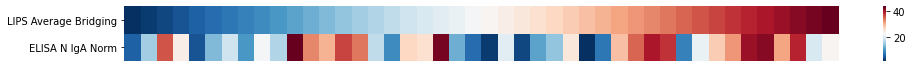



LIPS Average Bridging, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

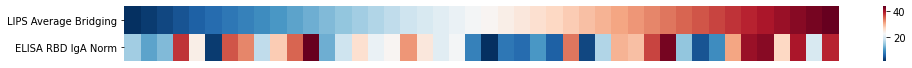

Most different



Validation
Most similar


ELISA RBD IgA Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

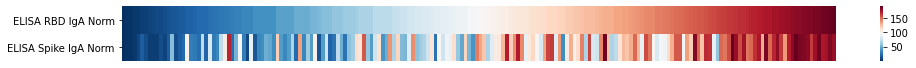



ELISA RBD Pan Norm, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

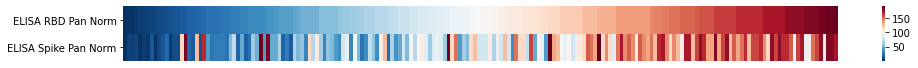



ELISA N Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

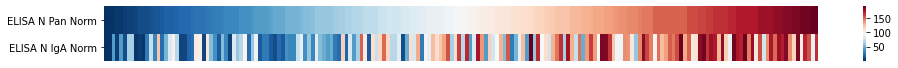



LIPS Average Bridging, ELISA RBD Pan Norm


<Figure size 432x288 with 0 Axes>

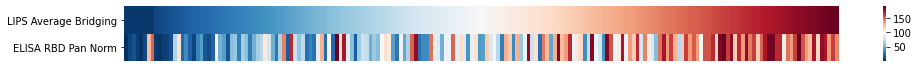



LIPS Average Bridging, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

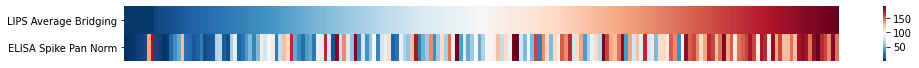



ELISA N Pan Norm, ELISA RBD Pan Norm


<Figure size 432x288 with 0 Axes>

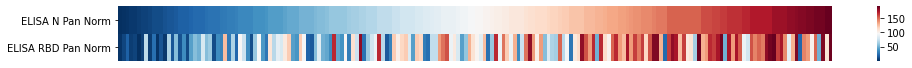



ELISA N Pan Norm, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

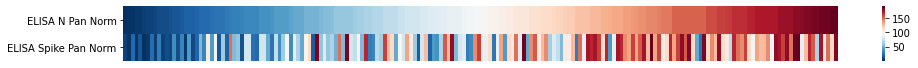



ELISA N IgA Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

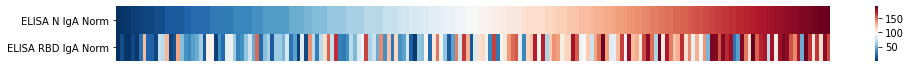



ELISA N IgA Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

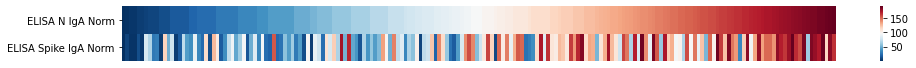



ELISA N Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

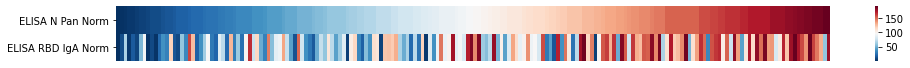



ELISA RBD Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

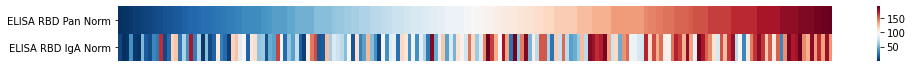



ELISA N Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

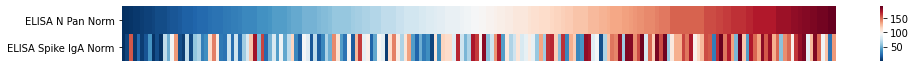



ELISA RBD Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

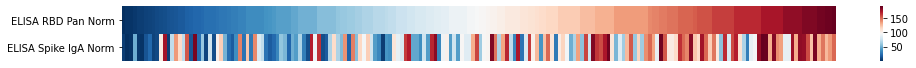



ELISA Spike Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

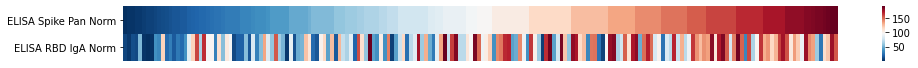



ELISA Spike Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

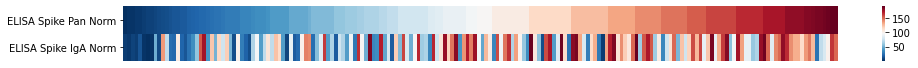



ELISA RBD Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

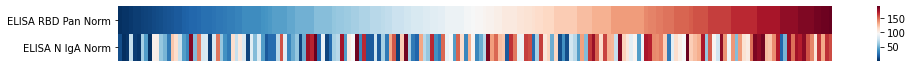



LIPS Average Bridging, ELISA N Pan Norm


<Figure size 432x288 with 0 Axes>

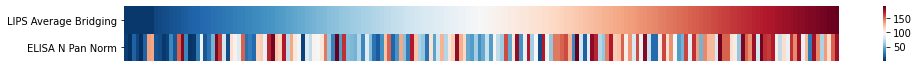



ELISA Spike Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

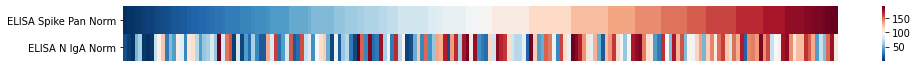



LIPS Average Bridging, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

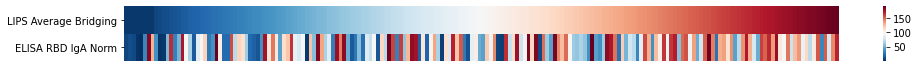



LIPS Average Bridging, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

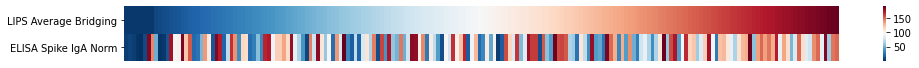



LIPS Average Bridging, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

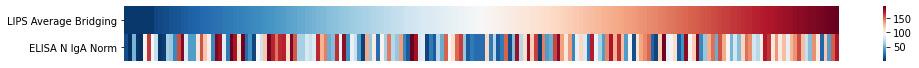

Most different



All data
Most similar


ELISA RBD Pan Norm, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

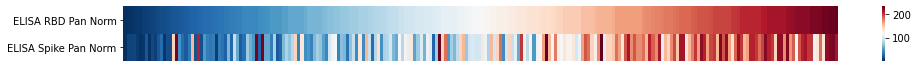



ELISA RBD IgA Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

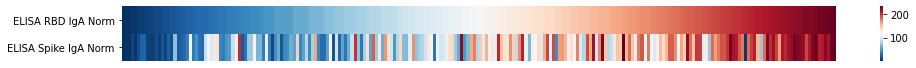



ELISA N Pan Norm, ELISA RBD Pan Norm


<Figure size 432x288 with 0 Axes>

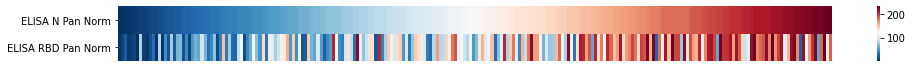



LIPS Average Bridging, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

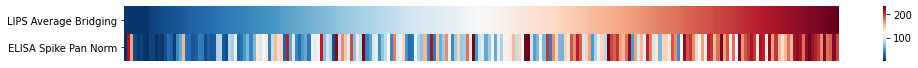



LIPS Average Bridging, ELISA RBD Pan Norm


<Figure size 432x288 with 0 Axes>

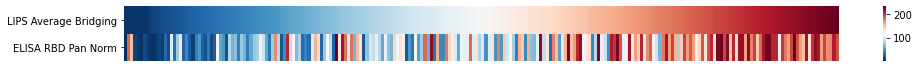



ELISA N Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

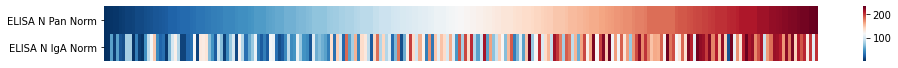



ELISA N Pan Norm, ELISA Spike Pan Norm


<Figure size 432x288 with 0 Axes>

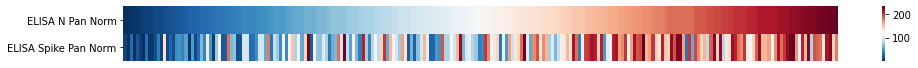



ELISA N IgA Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

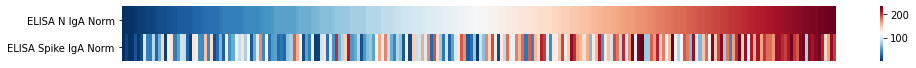



ELISA N IgA Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

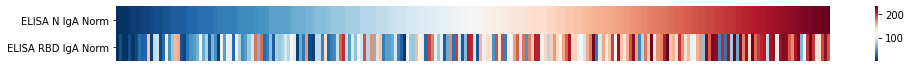



ELISA N Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

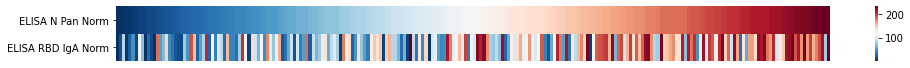



ELISA RBD Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

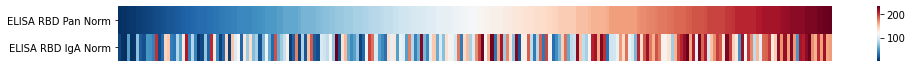



ELISA N Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

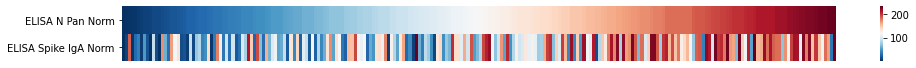



ELISA RBD Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

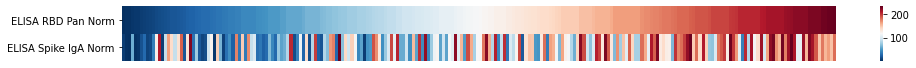



ELISA Spike Pan Norm, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

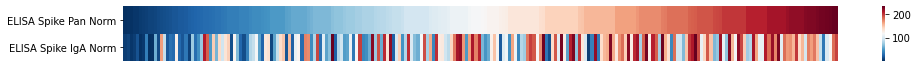



ELISA RBD Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

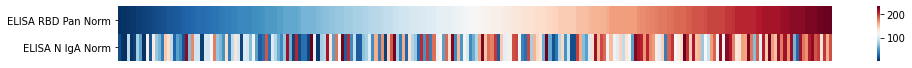



ELISA Spike Pan Norm, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

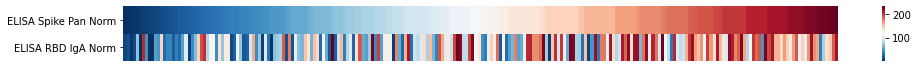



LIPS Average Bridging, ELISA N Pan Norm


<Figure size 432x288 with 0 Axes>

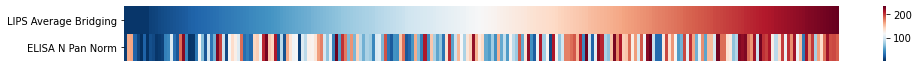



ELISA Spike Pan Norm, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

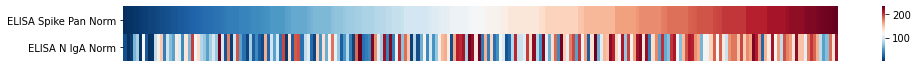



LIPS Average Bridging, ELISA RBD IgA Norm


<Figure size 432x288 with 0 Axes>

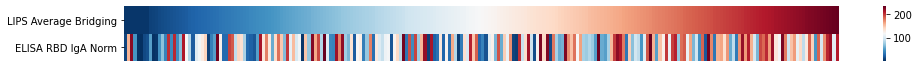



LIPS Average Bridging, ELISA Spike IgA Norm


<Figure size 432x288 with 0 Axes>

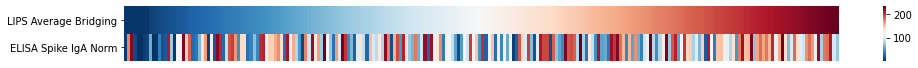



LIPS Average Bridging, ELISA N IgA Norm


<Figure size 432x288 with 0 Axes>

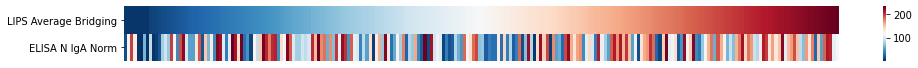

Most different


In [76]:
for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    pos_rank_df = pos_rank_dfs[label]
    pos_rank_diff_df = pos_rank_diff_dfs[label]

    print('Most similar')
    for col_pair in pos_rank_diff_df['Assay combination']:
        col_1 = col_pair[0]
        col_2 = col_pair[1]

        sub_df = copy.deepcopy(pos_rank_df)[[col_1, col_2]].sort_values(by=col_1).transpose()
        print('\n\n{}, {}'.format(col_1, col_2))
        plt.clf()
        plt.figure(figsize=(16, 1))
        sns.heatmap(sub_df, cmap='RdBu_r', xticklabels=False)
        plt.show()
    print('Most different')

In [77]:
# Which assays show the greatest similarity / difference to all others?

pos_col_scores = {}

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    if label == 'Threshold':
        cols = thresh_upd_cont_cols
    else:
        cols = val_upd_cont_cols
    pos_rank_diff_df = pos_rank_diff_dfs[label]

    sub_pos_col_scores = [0]*len(cols)
    for i, col in enumerate(cols):
        for n in range(pos_rank_diff_df.shape[0]):
            if col in pos_rank_diff_df['Assay combination'][n]:
                sub_pos_col_scores[i] += n
    sub_pos_col_scores = pd.DataFrame({'Assay': cols,
                                       'Score': sub_pos_col_scores})
    sub_pos_col_scores = sub_pos_col_scores.sort_values(by='Score').reset_index(drop=True)
    pos_col_scores[label] = sub_pos_col_scores
    print(sub_pos_col_scores)




Threshold
                   Assay  Score
0     ELISA RBD Pan Norm    137
1     ELISA RBD IgM Norm    157
2       ELISA N Pan Norm    162
3       ELISA N IgM Norm    162
4   ELISA Spike IgM Norm    170
5   ELISA Spike Pan Norm    175
6   ELISA Spike IgA Norm    189
7       ELISA N IgA Norm    265
8     ELISA RBD IgA Norm    272
9  LIPS Average Bridging    291



Validation
                   Assay  Score
0     ELISA RBD Pan Norm     46
1       ELISA N Pan Norm     49
2   ELISA Spike Pan Norm     55
3     ELISA RBD IgA Norm     57
4   ELISA Spike IgA Norm     64
5       ELISA N IgA Norm     69
6  LIPS Average Bridging     80



All data
                   Assay  Score
0     ELISA RBD Pan Norm     42
1       ELISA N Pan Norm     49
2   ELISA Spike Pan Norm     54
3     ELISA RBD IgA Norm     61
4   ELISA Spike IgA Norm     63
5       ELISA N IgA Norm     71
6  LIPS Average Bridging     80


In spite of greater similarity to RBD/Spike PanIg assays when consider positive samples only, the LIPS assay remains one of the assays that is most different from the others. I find this surprising given that it is one of the assays that provides the best discrimination between positive and negative individuals, and would expect best performing assays to show the greatest correlation - perhaps the relative order differs between the LIPS and ELISA assays?

In the threshold dataset, in contrast to the analysis of all samples, in the positive samples IgA assays tend to be the most different (IgM is the most different when comparing assays for all samples), whereas IgM and PanIg assays tend to be more similar. In the validation dataset, PanIg assays are more similar than IgA. RBD assays tend to be the most similar (interestingly more so than Spike, even though RBD is a subdomain of Spike). Unlike when comparing assay similarity across all samples, in the case of just the positive samples the N assays aren't more different than the Spike assays.

In [78]:
# Compare assay combination similarities between all and positive-only samples
rank_orders_dfs = {}

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    rank_diff_df = rank_diff_dfs[label]
    pos_rank_diff_df = pos_rank_diff_dfs[label]

    rank_orders = []
    for assay_comb in rank_diff_df['Assay combination']:
        index = pos_rank_diff_df['Assay combination'].tolist().index(assay_comb)
        rank_orders.append(index)
    rank_orders_df = pd.DataFrame({'Assay combination': rank_diff_df['Assay combination'],
                                   'All samples': list(range(rank_diff_df.shape[0])),
                                   'Positive samples': rank_orders})
    rank_orders_dfs[label] = rank_orders_df
    print(rank_orders_df)




Threshold
                                Assay combination  All samples  \
0      (ELISA RBD Pan Norm, ELISA Spike Pan Norm)            0   
1      (ELISA RBD IgA Norm, ELISA Spike IgA Norm)            1   
2      (ELISA RBD IgM Norm, ELISA Spike IgM Norm)            2   
3          (ELISA N IgM Norm, ELISA RBD IgM Norm)            3   
4          (ELISA N IgA Norm, ELISA RBD IgA Norm)            4   
5        (ELISA N IgA Norm, ELISA Spike IgA Norm)            5   
6        (ELISA N IgM Norm, ELISA Spike IgM Norm)            6   
7    (ELISA Spike Pan Norm, ELISA Spike IgA Norm)            7   
8        (ELISA N Pan Norm, ELISA Spike Pan Norm)            8   
9          (ELISA N Pan Norm, ELISA RBD Pan Norm)            9   
10     (ELISA RBD Pan Norm, ELISA Spike IgA Norm)           10   
11           (ELISA N Pan Norm, ELISA N IgA Norm)           11   
12       (ELISA N Pan Norm, ELISA Spike IgA Norm)           12   
13     (ELISA Spike Pan Norm, ELISA RBD IgA Norm)           13 




Threshold


<Figure size 432x288 with 0 Axes>

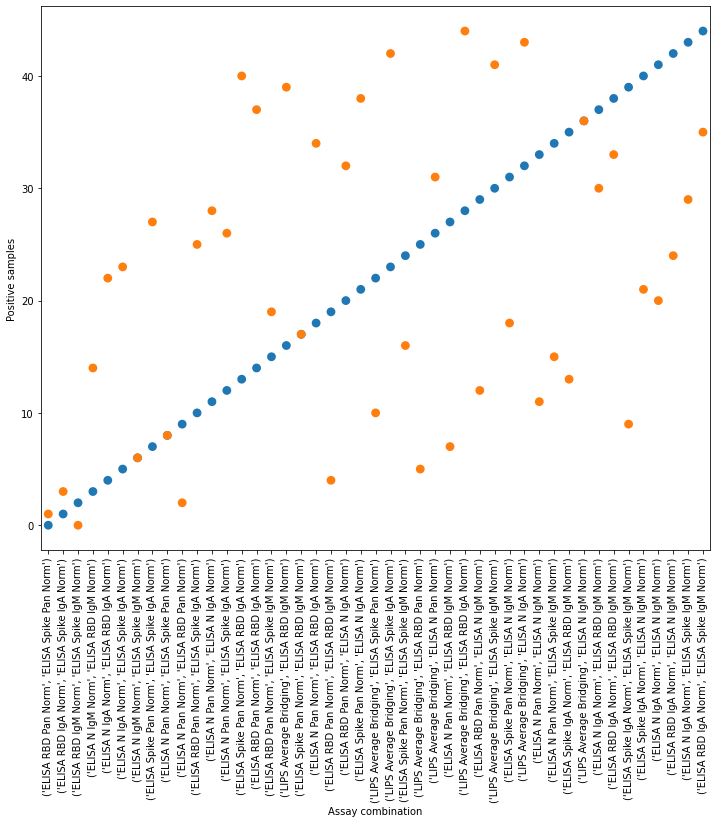




Validation


<Figure size 432x288 with 0 Axes>

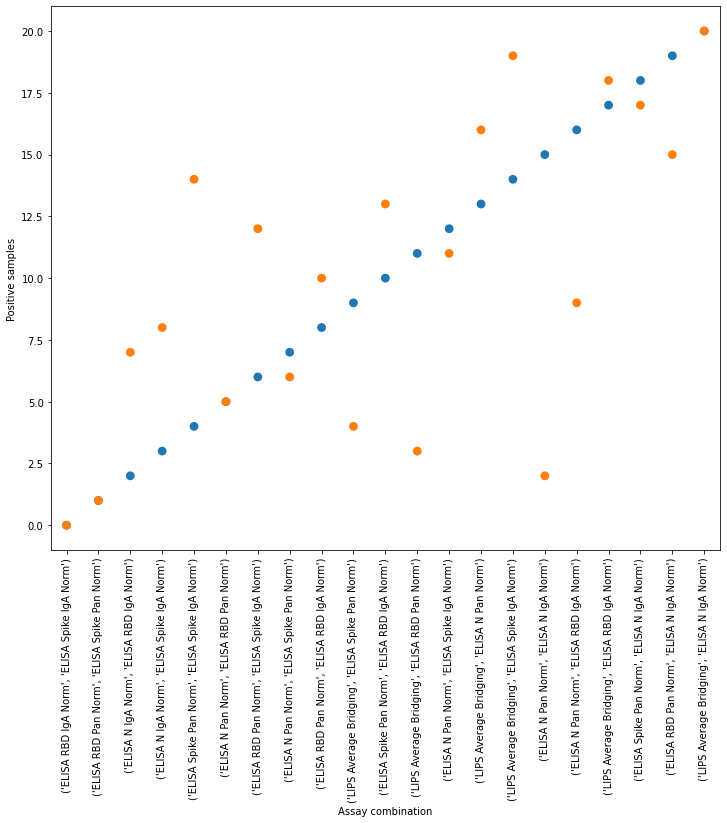




All data


<Figure size 432x288 with 0 Axes>

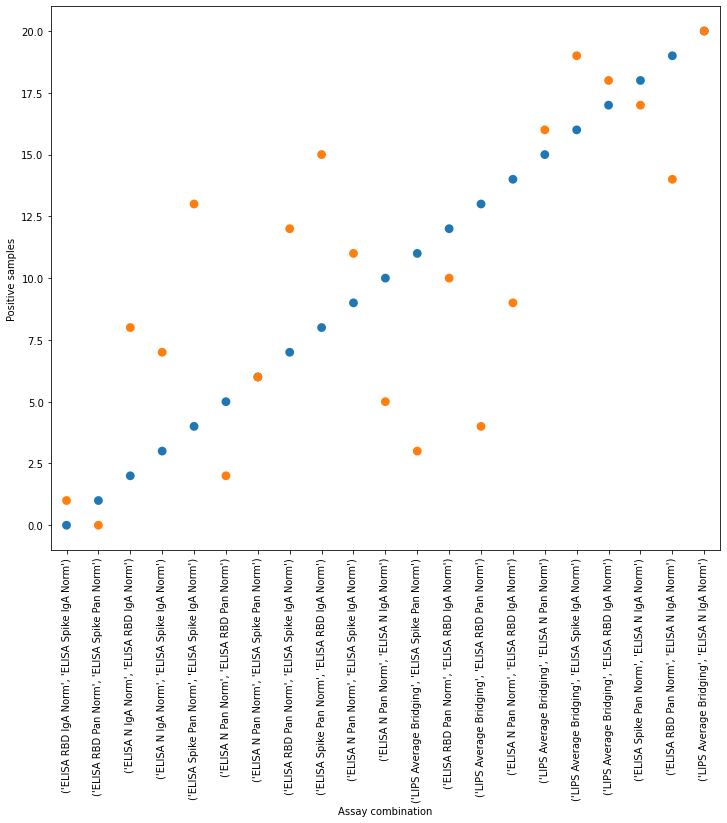

In [79]:
for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    rank_orders_df = rank_orders_dfs[label]
    plt.clf()
    plt.figure(figsize=(12, 10))
    sns.pointplot(
        x=rank_orders_df['Assay combination'], y=rank_orders_df['All samples'], join=False, color='tab:blue'
    )
    sns.pointplot(
        x=rank_orders_df['Assay combination'], y=rank_orders_df['Positive samples'], join=False, color='tab:orange'
    )
    plt.xticks(rotation=90)
    plt.show()

Blue = all samples; Orange = positive samples

In [80]:
indv_assay_rank_orders_dfs = {}

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    sub_col_scores = col_scores[label]
    sub_pos_col_scores = pos_col_scores[label]

    indv_assay_rank_orders = []
    for assay in sub_col_scores['Assay']:
        index = sub_pos_col_scores['Assay'].tolist().index(assay)
        indv_assay_rank_orders.append(index)
    indv_assay_rank_orders_df = pd.DataFrame({'Assay': sub_col_scores['Assay'],
                                              'All samples': list(range(sub_col_scores.shape[0])),
                                              'Positive samples': indv_assay_rank_orders})
    indv_assay_rank_orders_dfs[label] = indv_assay_rank_orders_df
    print(indv_assay_rank_orders_df)




Threshold
                   Assay  All samples  Positive samples
0     ELISA RBD Pan Norm            0                 0
1   ELISA Spike Pan Norm            1                 5
2   ELISA Spike IgA Norm            2                 6
3       ELISA N Pan Norm            3                 2
4     ELISA RBD IgM Norm            4                 1
5     ELISA RBD IgA Norm            5                 8
6       ELISA N IgA Norm            6                 7
7   ELISA Spike IgM Norm            7                 4
8  LIPS Average Bridging            8                 9
9       ELISA N IgM Norm            9                 3



Validation
                   Assay  All samples  Positive samples
0   ELISA Spike IgA Norm            0                 4
1   ELISA Spike Pan Norm            1                 2
2     ELISA RBD Pan Norm            2                 0
3     ELISA RBD IgA Norm            3                 3
4       ELISA N Pan Norm            4                 1
5       ELISA N IgA N




Threshold


<Figure size 432x288 with 0 Axes>

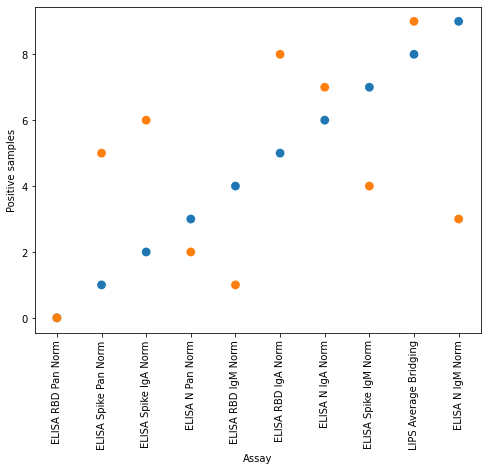




Validation


<Figure size 432x288 with 0 Axes>

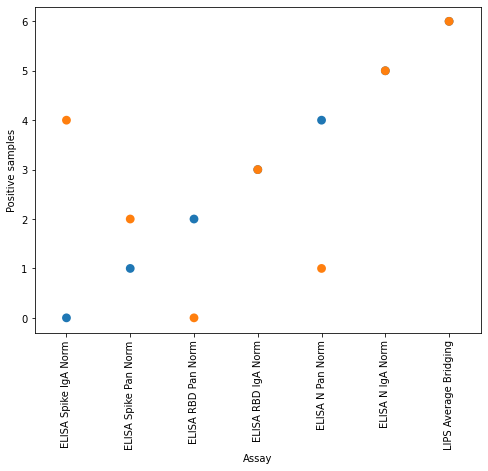




All data


<Figure size 432x288 with 0 Axes>

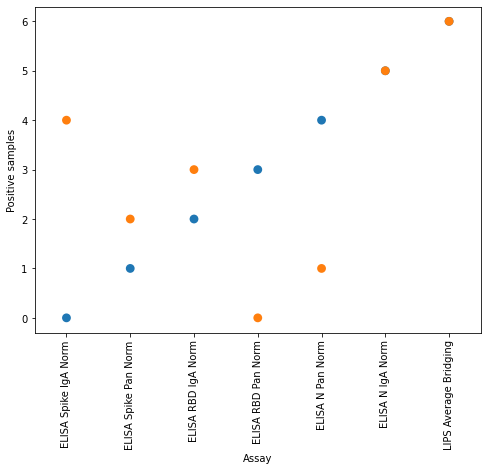

In [81]:
for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    indv_assay_rank_orders_df = indv_assay_rank_orders_dfs[label]

    plt.clf()
    plt.figure(figsize=(8, 6))
    sns.pointplot(
        x=indv_assay_rank_orders_df['Assay'], y=indv_assay_rank_orders_df['All samples'], join=False,
        color='tab:blue'
    )
    sns.pointplot(
        x=indv_assay_rank_orders_df['Assay'], y=indv_assay_rank_orders_df['Positive samples'], join=False,
        color='tab:orange'
    )
    plt.xticks(rotation=90)
    plt.show()

Blue = all samples; Orange = positive samples

So, is fair amount of variation between the most similar assay pairs/individual assays in all samples as compared to positive only samples. However, is some consistency in the most similar assay pairs, and in the most similar individual assay, plus the relative order of assay similarity is similar across the threshold and validation sets - ELISA PanIg assays (especially RBD and Spike) tend to be the most similar, LIPS Average Binding assays tend to be the most dissimilar. Would therefore expect ELISA RBD/Spike PanIg assays to have the highest correlation coefficients with other assays, and LIPS assay the lowest, in the following analysis... 

As described above, would expect best performing assays to be the most similar (since disagreement => noise, agreement => signal - remember though that even the "worst" assays here perform well, and are a long way from being just noise), so am surprised that LIPS assay is ranked as the most dissimilar. Since am comparing ranks, difference in data scale shouldn't have any effect. Can understand that equal ranking of negative samples might confound the analysis, but this wouldn't be carried through when just looking at the positive samples. As LIPS also performs well, is clearly separating positives from negatives, but the relative orders of the positive and negative individuals are not the same => LIPS assay and ELISA assays providing different information from each other?




Threshold
Pearson's rank correlation coefficient


<Figure size 432x288 with 0 Axes>

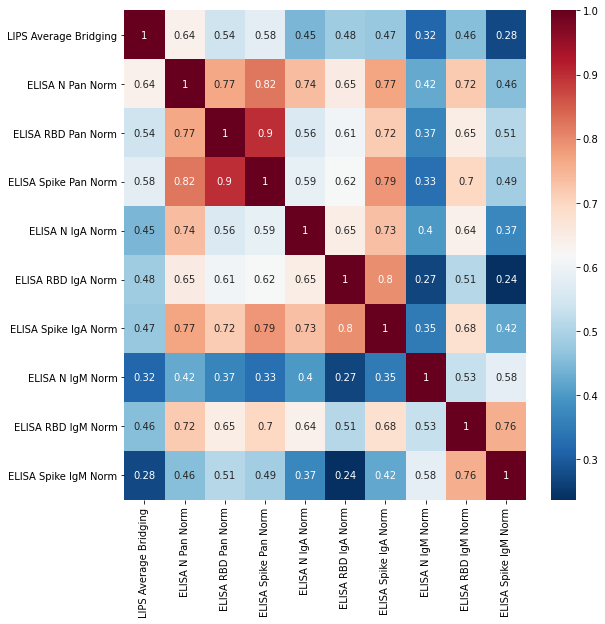

Spearman's rank correlation coefficient


<Figure size 432x288 with 0 Axes>

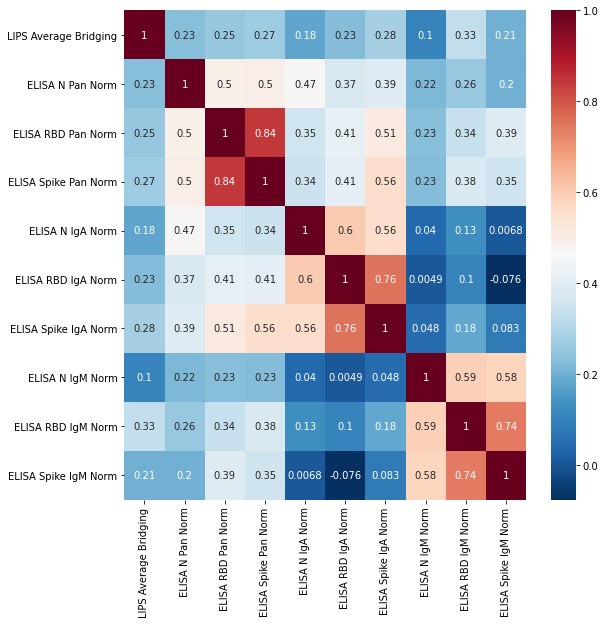

Kendall's tau correlation coefficient


<Figure size 432x288 with 0 Axes>

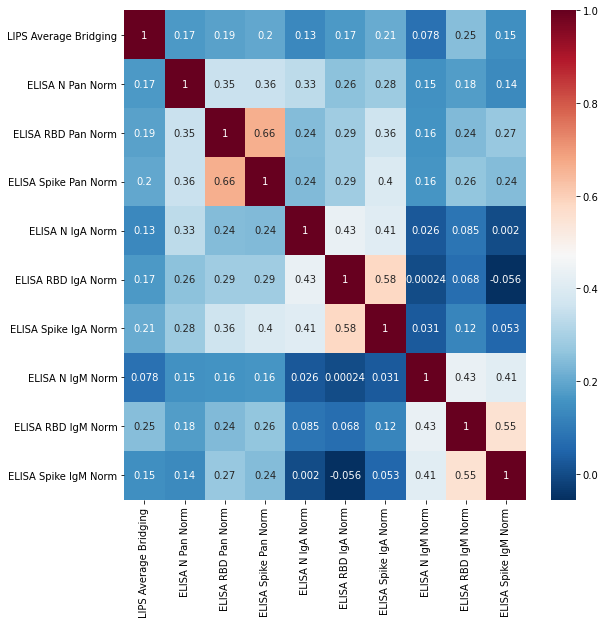




Validation
Pearson's rank correlation coefficient


<Figure size 432x288 with 0 Axes>

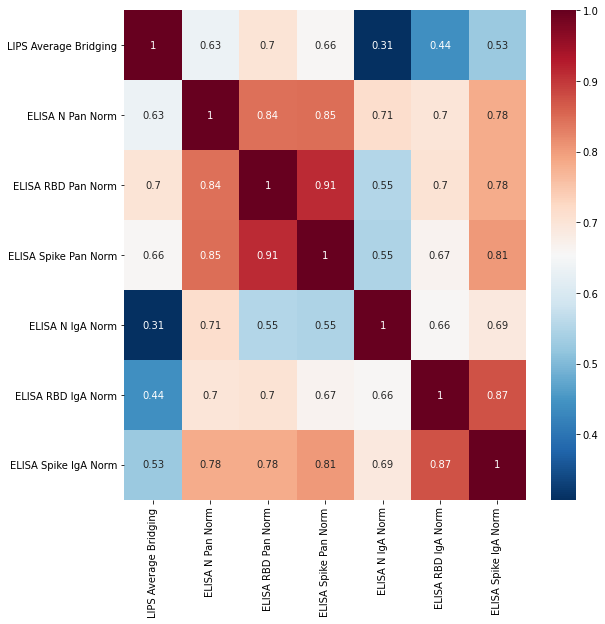

Spearman's rank correlation coefficient


<Figure size 432x288 with 0 Axes>

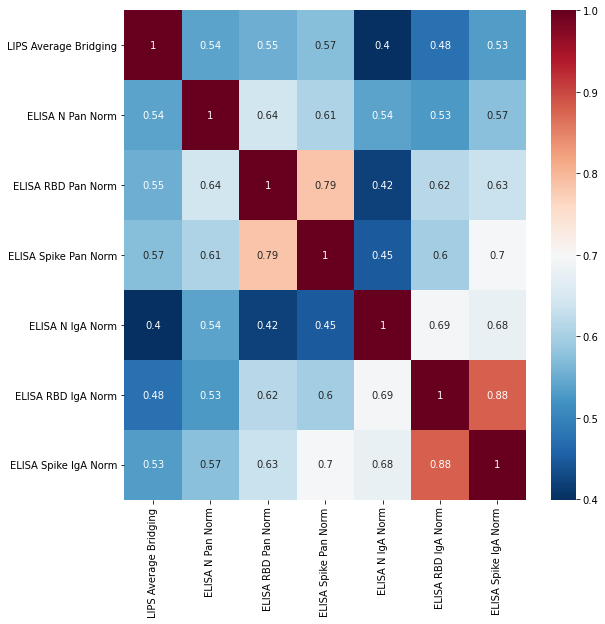

Kendall's tau correlation coefficient


<Figure size 432x288 with 0 Axes>

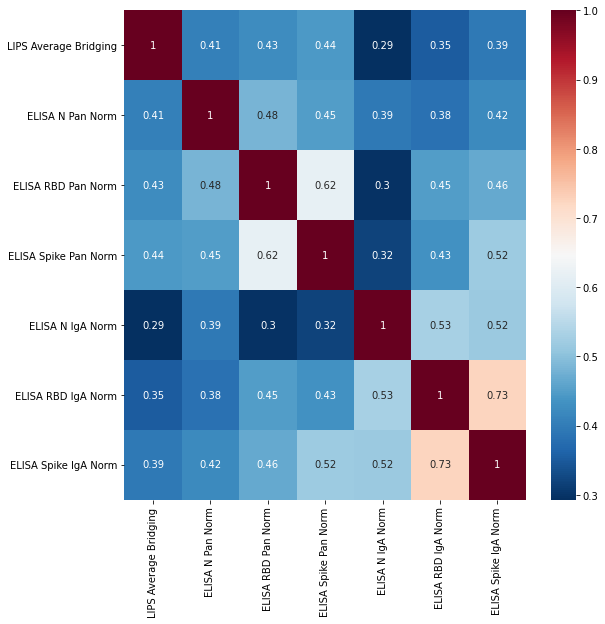




All data
Pearson's rank correlation coefficient


<Figure size 432x288 with 0 Axes>

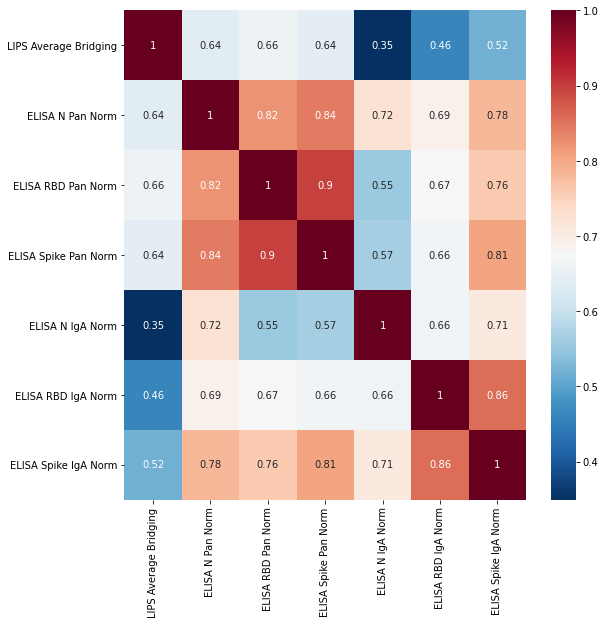

Spearman's rank correlation coefficient


<Figure size 432x288 with 0 Axes>

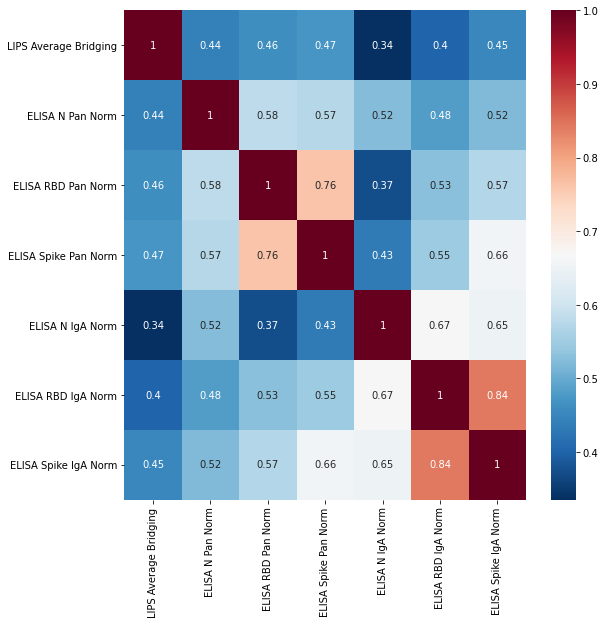

Kendall's tau correlation coefficient


<Figure size 432x288 with 0 Axes>

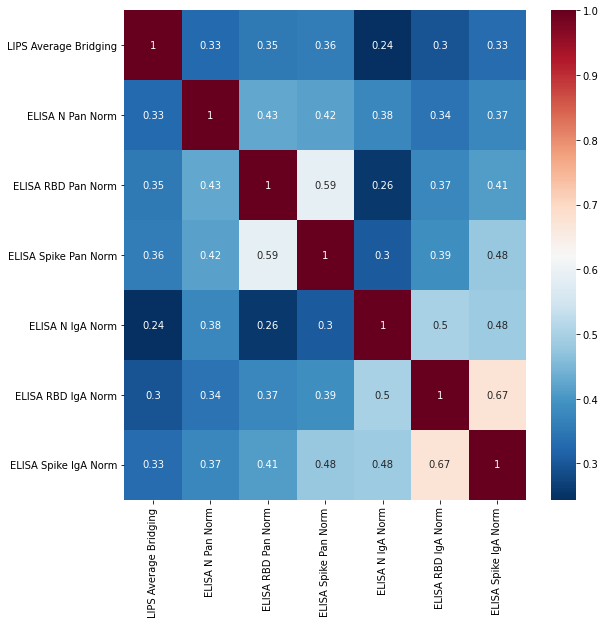

In [82]:
# Correlation coefficients for all samples
# Scaling won't affect correlation coefficient values

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    ml_x = copy.deepcopy(ml_x_dict[label])

    # Pearson correlation coefficient - assumes linearity (not a good assumption for this data => only included
    # for completeness, focus on the rank correlation coefficients instead)
    correlation_matrix_pearson = ml_x.corr(method='pearson')
    print('Pearson\'s rank correlation coefficient')
    plt.clf()
    plt.figure(figsize=(9,9))
    heatmap = sns.heatmap(
        data=correlation_matrix_pearson, cmap='RdBu_r', annot=True, xticklabels=True, yticklabels=True
    )
    plt.xticks(rotation='vertical')
    plt.yticks(rotation='horizontal')
    plt.show()

    # Spearman's rank correlation coefficient - does not assume linearity (because compares ranks rather than
    # values)
    correlation_matrix_spearman = ml_x.corr(method='spearman')
    print('Spearman\'s rank correlation coefficient')
    plt.clf()
    plt.figure(figsize=(9,9))
    heatmap = sns.heatmap(
        data=correlation_matrix_spearman, cmap='RdBu_r', annot=True, xticklabels=True, yticklabels=True
    )
    plt.xticks(rotation='vertical')
    plt.yticks(rotation='horizontal')
    plt.show()

    # Kendall's tau correlation coefficient - also compares ranks, but rather than measuring the covariance like
    # Spearman's rank, instead compares number of concordant and discordant pairs (concordant pairs occur when the
    # values of variable 1 and 2 are either both higher or both lower for sample a as compared to sample b;
    # discordant pairs occur when one value is higher and the other is lower). Less sensitive to outliers than
    # Spearman's rank, plus in general returns more accurate values for smaller datasets.
    print('Kendall\'s tau correlation coefficient')
    correlation_matrix_kendall = ml_x.corr(method='kendall')
    plt.clf()
    plt.figure(figsize=(9,9))
    heatmap = sns.heatmap(
        data=correlation_matrix_kendall, cmap='RdBu_r', annot=True, xticklabels=True, yticklabels=True
    )
    plt.xticks(rotation='vertical')
    plt.yticks(rotation='horizontal')
    if label == 'All data':
        plt.savefig('All_data_all_samples_Kendall_tau_correlation_coefficient.svg')
    plt.show()

In both threshold and validation datasets:
- Greatest correlation between RBD and Spike (same secondary antibody)
- Greater correlation between assays with different antigens and the same secondary antibody than vice versa
- LIPS assay is similarly correlated to the ELISA assays as the ELISA assays collected with different secondary antibodies are to each other. LIPS assay is more similar to the PanIg assays than the IgA assays (/IgM assays in the threshold dataset).

In threshold dataset:
- IgM and IgA assays are more similar to PanIg assays than to each other. LIPS assay is also more similar to the other assays than IgA and IgM are to each other. Greater similarity between IgA and PanIg than between IgM and PanIg.

(In agreement with rank comparison analysis above.)




Threshold
Pearson's rank correlation coefficient


<Figure size 432x288 with 0 Axes>

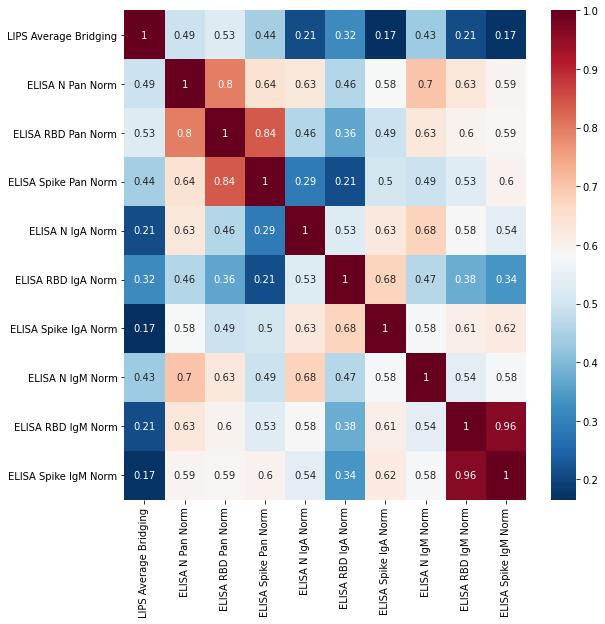

Spearman's rank correlation coefficient


<Figure size 432x288 with 0 Axes>

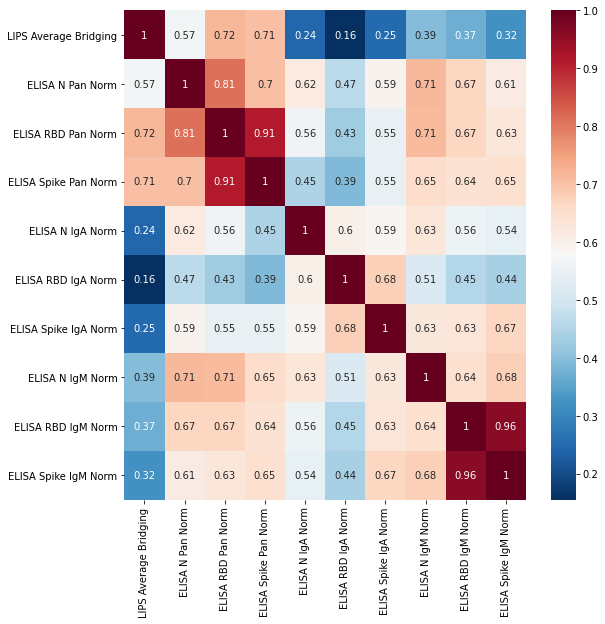

Kendall's tau correlation coefficient


<Figure size 432x288 with 0 Axes>

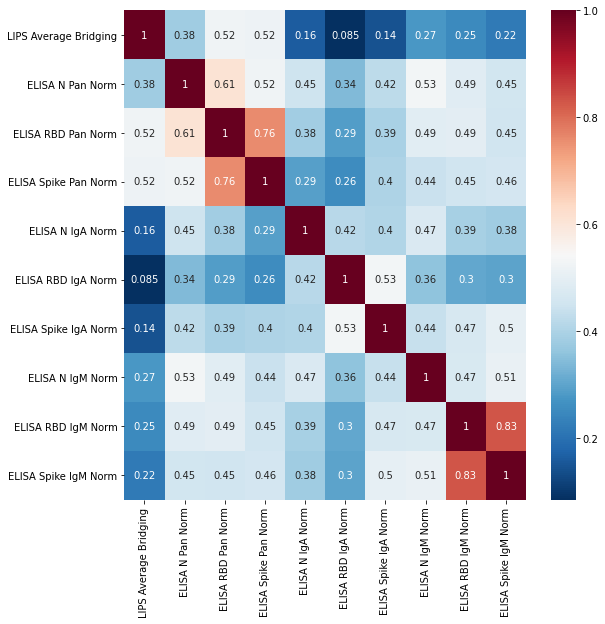




Validation
Pearson's rank correlation coefficient


<Figure size 432x288 with 0 Axes>

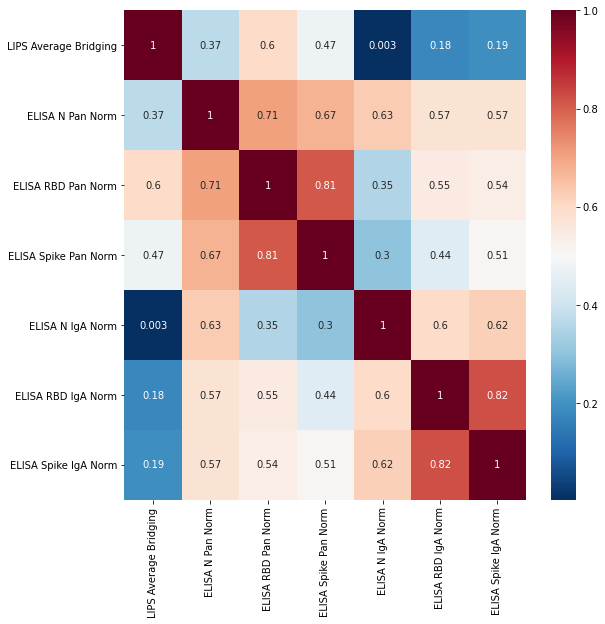

Spearman's rank correlation coefficient


<Figure size 432x288 with 0 Axes>

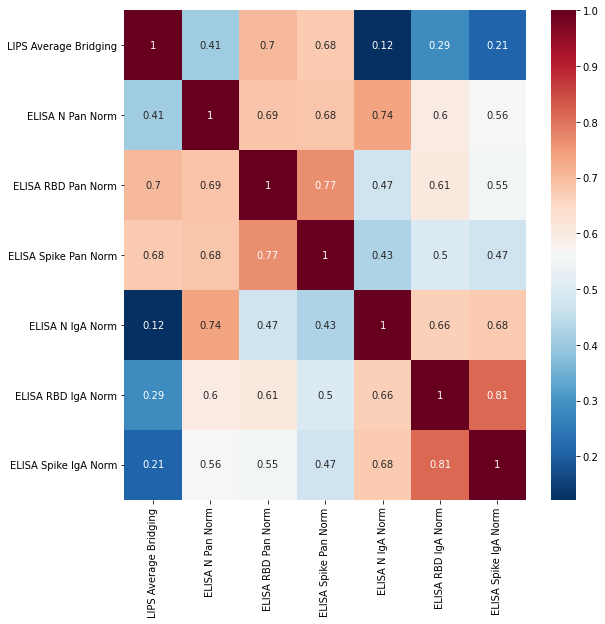

Kendall's tau correlation coefficient


<Figure size 432x288 with 0 Axes>

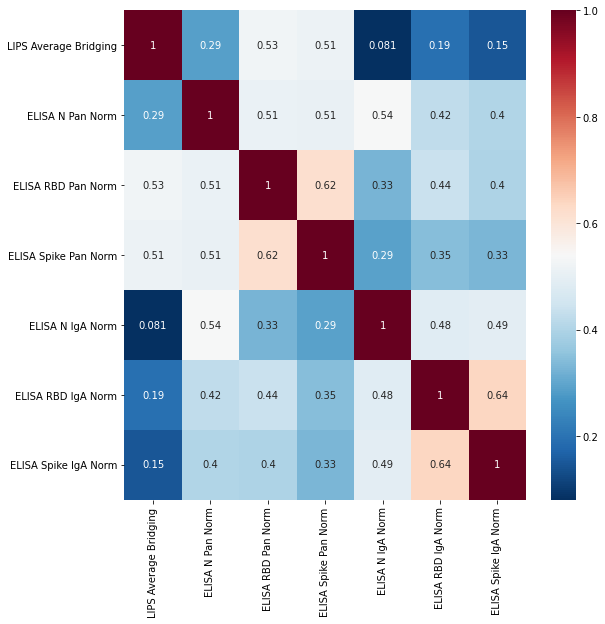




All data
Pearson's rank correlation coefficient


<Figure size 432x288 with 0 Axes>

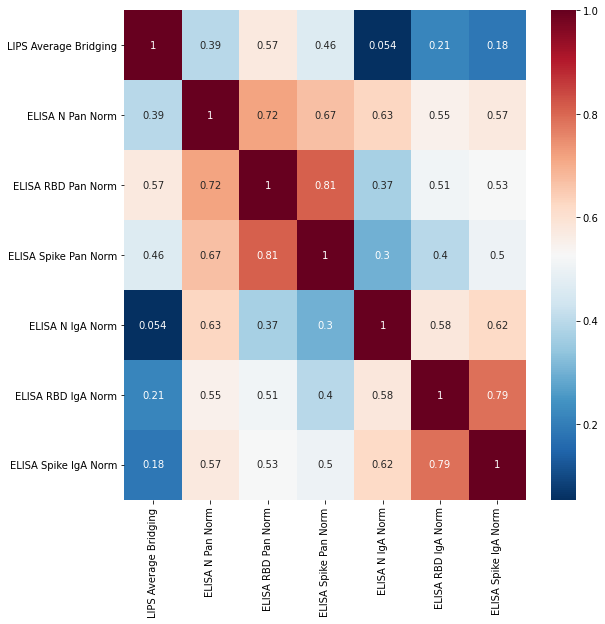

Spearman's rank correlation coefficient


<Figure size 432x288 with 0 Axes>

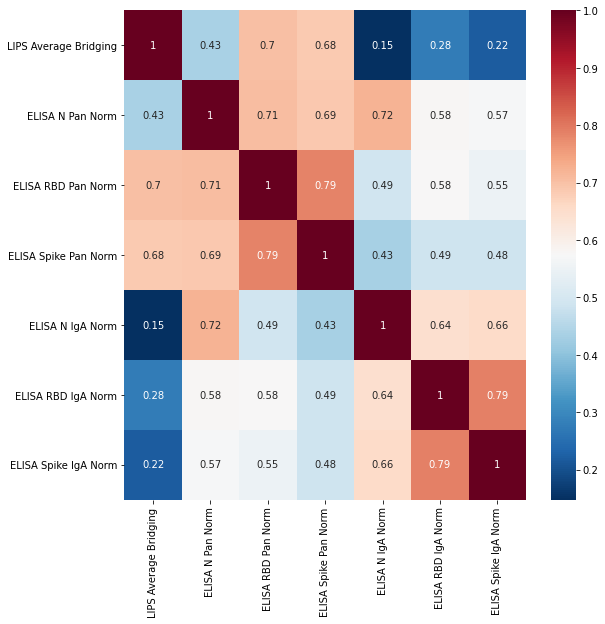

Kendall's tau correlation coefficient


<Figure size 432x288 with 0 Axes>

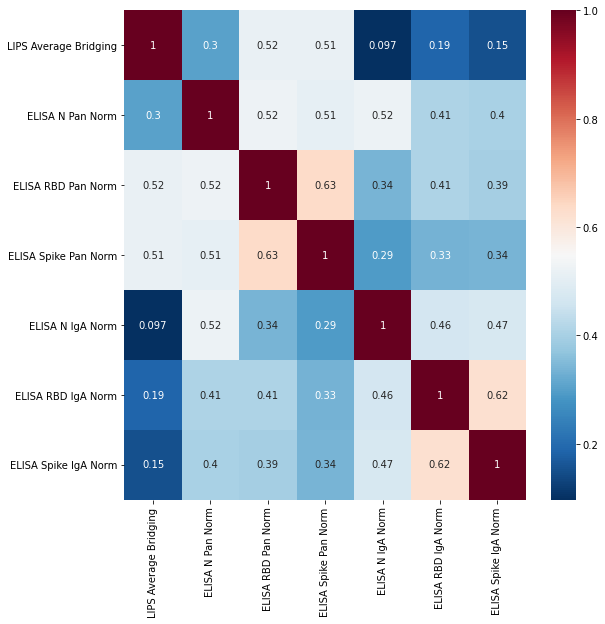

In [83]:
# Correlation coefficients for positive samples
# Scaling won't affect correlation coefficient values

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    pos_ml_x = copy.deepcopy(pos_ml_x_dict[label])

    # Pearson correlation coefficient - assumes linearity (not a good assumption for this data => only
    # included for completeness, focus on the rank correlation coefficients instead)
    pos_correlation_matrix_pearson = pos_ml_x.corr(method='pearson')
    print('Pearson\'s rank correlation coefficient')
    plt.clf()
    plt.figure(figsize=(9,9))
    heatmap = sns.heatmap(
        data=pos_correlation_matrix_pearson, cmap='RdBu_r', annot=True, xticklabels=True, yticklabels=True
    )
    plt.xticks(rotation='vertical')
    plt.yticks(rotation='horizontal')
    plt.show()

    # Spearman's rank correlation coefficient - does not assume linearity (because compares ranks rather than
    # values)
    pos_correlation_matrix_spearman = pos_ml_x.corr(method='spearman')
    print('Spearman\'s rank correlation coefficient')
    plt.clf()
    plt.figure(figsize=(9,9))
    heatmap = sns.heatmap(
        data=pos_correlation_matrix_spearman, cmap='RdBu_r', annot=True, xticklabels=True, yticklabels=True
    )
    plt.xticks(rotation='vertical')
    plt.yticks(rotation='horizontal')
    plt.show()

    # Kendall's tau correlation coefficient - also compares ranks, but rather than measuring the covariance like
    # Spearman's rank, instead compares number of concordant and discordant pairs (concordant pairs occur when the
    # values of variable 1 and 2 are either both higher or both lower for sample a as compared to sample b;
    # discordant pairs occur when one value is higher and the other is lower). Less sensitive to outliers than
    # Spearman's rank, plus in general returns more accurate values for smaller datasets.
    print('Kendall\'s tau correlation coefficient')
    pos_correlation_matrix_kendall = pos_ml_x.corr(method='kendall')
    plt.clf()
    plt.figure(figsize=(9,9))
    heatmap = sns.heatmap(
        data=pos_correlation_matrix_kendall, cmap='RdBu_r', annot=True, xticklabels=True, yticklabels=True
    )
    plt.xticks(rotation='vertical')
    plt.yticks(rotation='horizontal')
    if label == 'All data':
        plt.savefig('All_data_positive_samples_Kendall_tau_correlation_coefficient.svg')
    plt.show()

In threshold and validation datasets:
- Greatest similarity between RBD and Spike (same secondary antibody)
- Greater correlation between assays with different antigens and the same secondary antibody than between assays with the same antigen and different secondary antibodies.
- LIPS assay is ~ as similarly correlated with the ELISA PanIg assays as the N, RBD and Spike PanIg assays are to each other (although correlation with N PanIg assay is slightly lower than with RBD/Spike). However, the correlation with IgA/IgM assays is much lower than any of the correlations between the ELISA assays with different secondary antibodies.

In threshold dataset:
- IgM and IgA assays are more similar to PanIg assays than to each other. IgM assays are more similar to PanIg than  IgA.

So, overall observe basically the same relationships between the assays across the positive samples as across all samples in the dataset, except that: a) LIPS assays look more similar to the ELISA PanIg assays; b) LIPS assays look more different from IgA and IgM ELISA assays; c) when comparing the ELISA assays, the IgM assays show a greater correlation with the PanIg assays than the IgA assays (relationship is the other way round when all samples are considered).

(In good agreement with rank comparison analysis of positive samples above)

#### Q3: Do combinations of assays achieve greater discrimination between positive and negative patients than individual assays?




Threshold
PCA: 1 dimension


<Figure size 432x288 with 0 Axes>

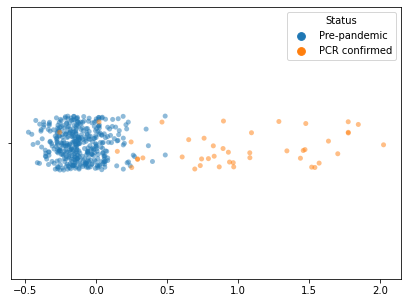

PCA: 2 dimensions


<Figure size 432x288 with 0 Axes>

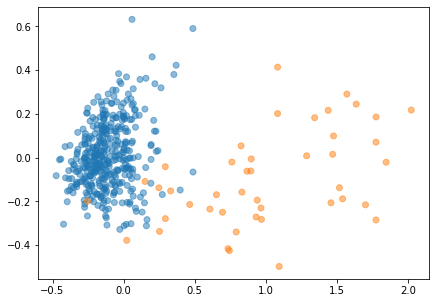

PCA: 3 dimensions


<Figure size 432x288 with 0 Axes>

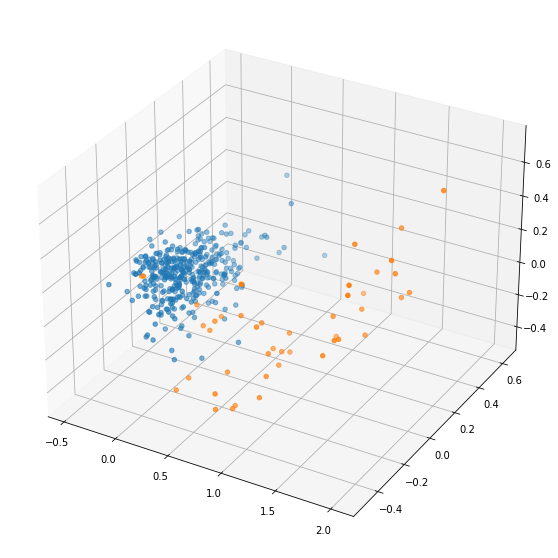




Validation
PCA: 1 dimension


<Figure size 432x288 with 0 Axes>

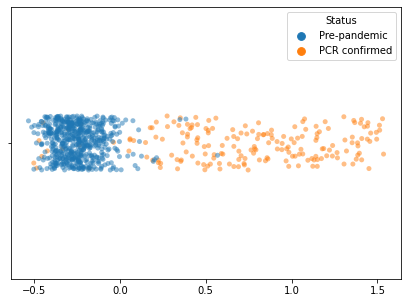

PCA: 2 dimensions


<Figure size 432x288 with 0 Axes>

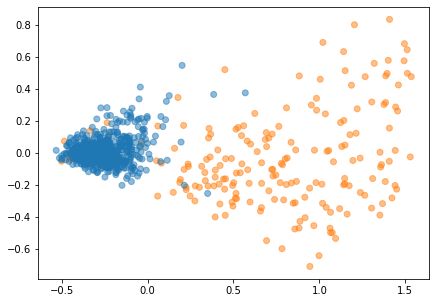

PCA: 3 dimensions


<Figure size 432x288 with 0 Axes>

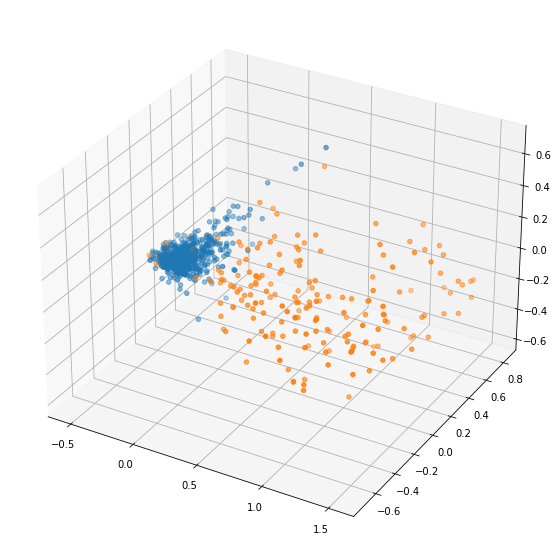




All data
PCA: 1 dimension


<Figure size 432x288 with 0 Axes>

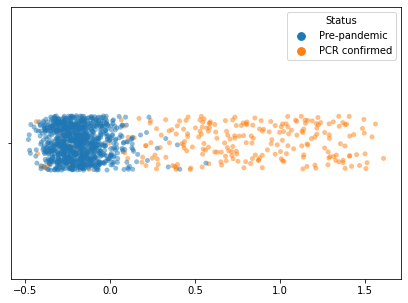

PCA: 2 dimensions


<Figure size 432x288 with 0 Axes>

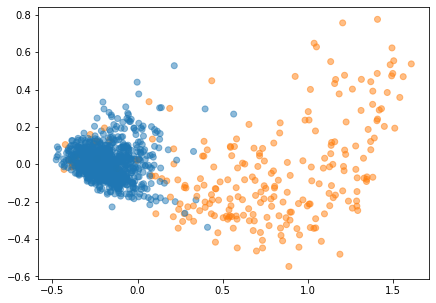

PCA: 3 dimensions


<Figure size 432x288 with 0 Axes>

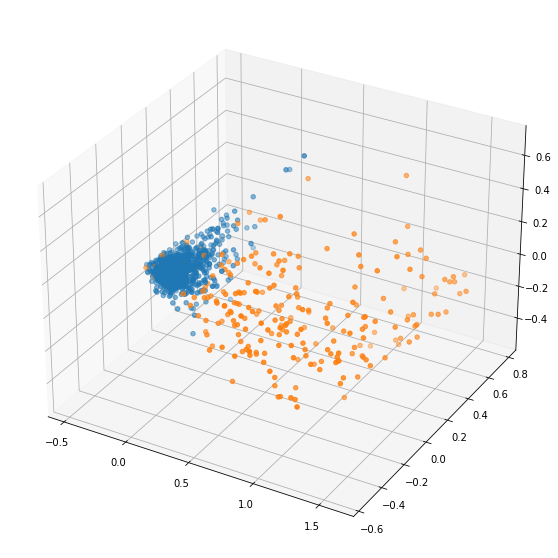

In [84]:
# Run PCA (looks for dimensions of maximum variance on a linear scale)

pca_dict = {}

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    ml_x = copy.deepcopy(ml_x_dict[label])
    ml_y = copy.deepcopy(ml_y_dict[label])

    pca = PCA()
    pca_fitted = pca.fit(X=ml_x)
    pca_x = pca_fitted.transform(X=ml_x)
    
    pca_dict[label] = [pca_x, pca_fitted]

    # Plots transformed data on 1, 2 and 3D scatter plots
    plot_colours = []
    for y in ml_y['Status']:
        if y == 'Pre-pandemic':
            plot_colours.append('tab:blue')
        elif y == 'PCR confirmed':
            plot_colours.append('tab:orange')
    print('PCA: 1 dimension')
    plt.clf()
    plt.figure(figsize=(7,5))
    sns.stripplot(x=pca_x[:,0], y=['']*pca_x.shape[0], hue=ml_y['Status'],
                  hue_order={'Pre-pandemic': 'tab:blue', 'PCR confirmed': 'tab:orange'}, jitter=True, alpha=0.5)
    plt.show()
    print('PCA: 2 dimensions')
    plt.clf()
    plt.figure(figsize=(7,5))
    plt.scatter(pca_x[:,0], pca_x[:,1], c=plot_colours, alpha=0.5)
    plt.show()
    print('PCA: 3 dimensions')
    plt.clf()
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(projection='3d')
    ax.scatter(pca_x[:,0], pca_x[:,1], pca_x[:,2], c=plot_colours)
    plt.show()




Threshold


<Figure size 432x288 with 0 Axes>

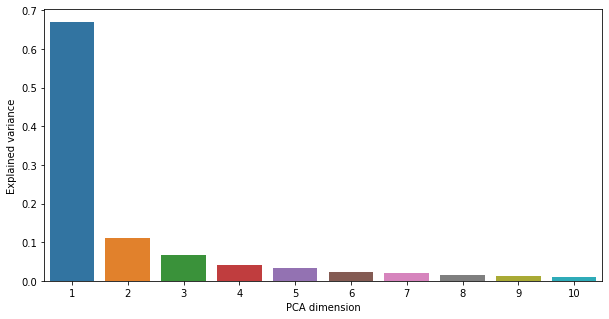




Validation


<Figure size 432x288 with 0 Axes>

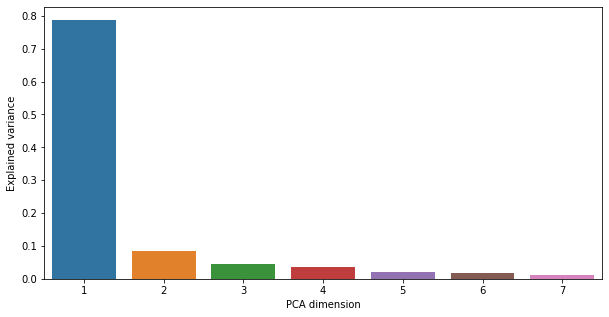




All data


<Figure size 432x288 with 0 Axes>

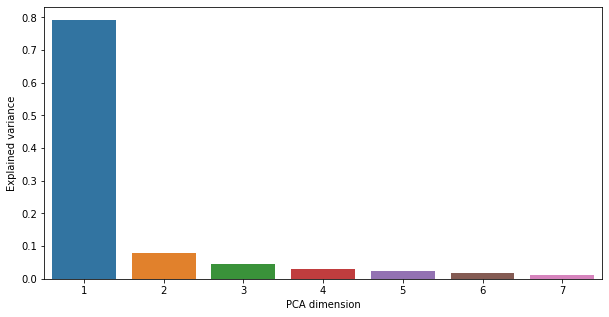

In [85]:
# Bar chart showing the percentage variance explained by the different components

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    pca_x = pca_dict[label][0]
    pca_fitted = pca_dict[label][1]

    plt.clf()
    plt.figure(figsize=(10,5))
    sns.barplot(x=list(range(1, pca_x.shape[1]+1)), y=pca_fitted.explained_variance_ratio_)
    plt.xlabel('PCA dimension')
    plt.ylabel('Explained variance')
    plt.show()

Plots above demonstrate that the majority of the variance in the data can be captured by just one PCA dimension (slightly more pronounced for the validation set than the threshold set, but difference is probably due to random chance). Which assay(s) make(s) the greatest contribution to this dimension?

There is good separation between positive and negative samples. Note though that there is a subset of positive samples with low scores (especially clear in the validation dataset), which likely correspond to patients who although positive have not yet sero-converted (will be interesting to see if these samples correlate with time period = "acute"). (Don't expect perfect correlation between "PCR confirmed/Pre-pandemic" status and "positive"/"negative" label therefore.)




Threshold


<Figure size 432x288 with 0 Axes>

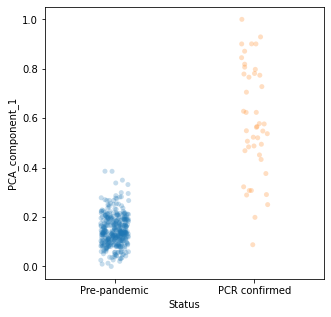

<Figure size 432x288 with 0 Axes>

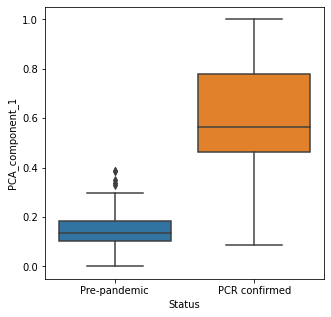

<Figure size 432x288 with 0 Axes>

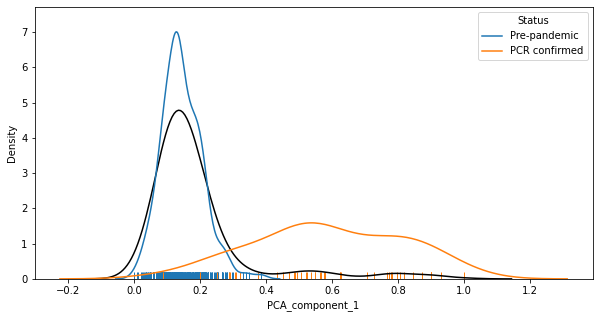

KDE Overlap: 0.13579815130235154






Validation


<Figure size 432x288 with 0 Axes>

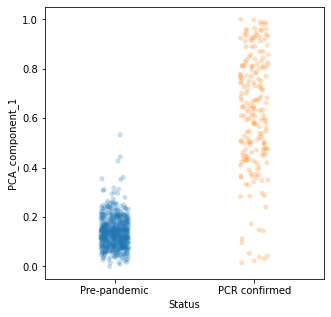

<Figure size 432x288 with 0 Axes>

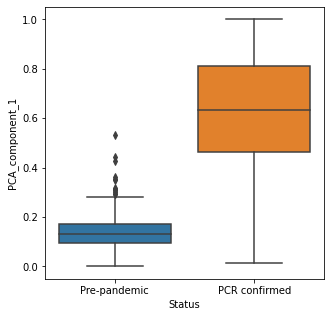

<Figure size 432x288 with 0 Axes>

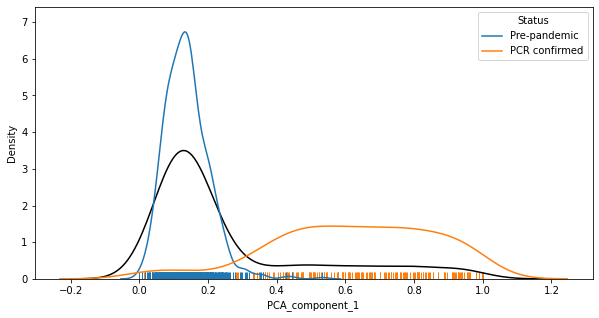

KDE Overlap: 0.09994705395846519






All data


<Figure size 432x288 with 0 Axes>

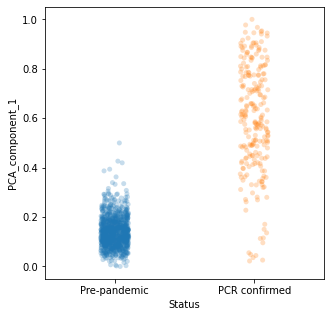

<Figure size 432x288 with 0 Axes>

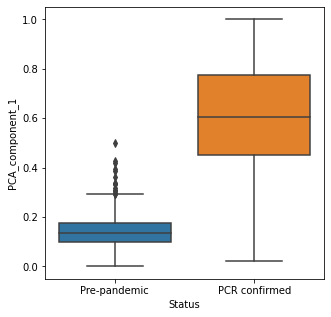

<Figure size 432x288 with 0 Axes>

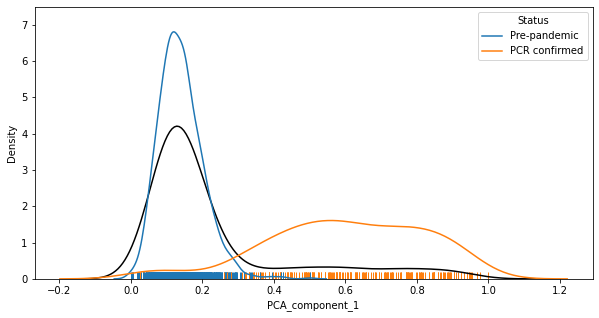

KDE Overlap: 0.10215544172271517





In [86]:
# Makes strip, box and KDE plots of first PCA dimension for comparison with individual assays

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    pca_x = pca_dict[label][0]
    ml_y = ml_y_dict[label]

    min_max_transform = MinMaxScaler().fit(pca_x)
    scaled_pca_x = min_max_transform.transform(pca_x)
    pca_df = pd.DataFrame({'PCA_component_1': scaled_pca_x[:,0], 'Status': ml_y['Status']})

    # Strip plot
    plt.clf()
    plt.figure(figsize=(5, 5))
    sns.stripplot(data=pca_df, x='Status', y='PCA_component_1', jitter=True, alpha=0.25,
                  order=['Pre-pandemic', 'PCR confirmed'])
    plt.show()

    # Box plot
    plt.clf()
    plt.figure(figsize=(5, 5))
    sns.boxplot(data=pca_df, x='Status', y='PCA_component_1', order=['Pre-pandemic', 'PCR confirmed'])
    plt.show()

    # Calculate overlap of KDE plots
    plt.clf()
    plt.figure(figsize=(10, 5))
    sns.kdeplot(data=pca_df, x='PCA_component_1', color='k')
    sns.kdeplot(data=pca_df[pca_df['Status'] == 'Pre-pandemic'], x='PCA_component_1', color='tab:blue')
    sns.kdeplot(data=pca_df[pca_df['Status'] == 'PCR confirmed'], x='PCA_component_1', color='tab:orange')
    sns.rugplot(data=pca_df, x='PCA_component_1', hue='Status', hue_order=['Pre-pandemic', 'PCR confirmed'])
    plt.show()

    negative_df = pca_df[pca_df['Status'] == 'Pre-pandemic'].reset_index(drop=True)
    positive_df = pca_df[pca_df['Status'] == 'PCR confirmed'].reset_index(drop=True)
    x_min = pca_df['PCA_component_1'].values.min() - 0.1
    x_max = pca_df['PCA_component_1'].values.max() + 0.1
    overlap = calc_kde_overlap(negative_df[['PCA_component_1']], positive_df[['PCA_component_1']],
                               'PCA_component_1', x_min, x_max)
    print('KDE Overlap: {}\n\n\n'.format(overlap))

The separation between positive and negative samples achieved by the first PCA dimension is similar to that achieved by the individual assay that achieves greatest separation between the samples (Spike PanIg). Degree of separation is approx. same for threshold and validation datasets (encouragingly!).




Threshold
PCA components


<Figure size 432x288 with 0 Axes>

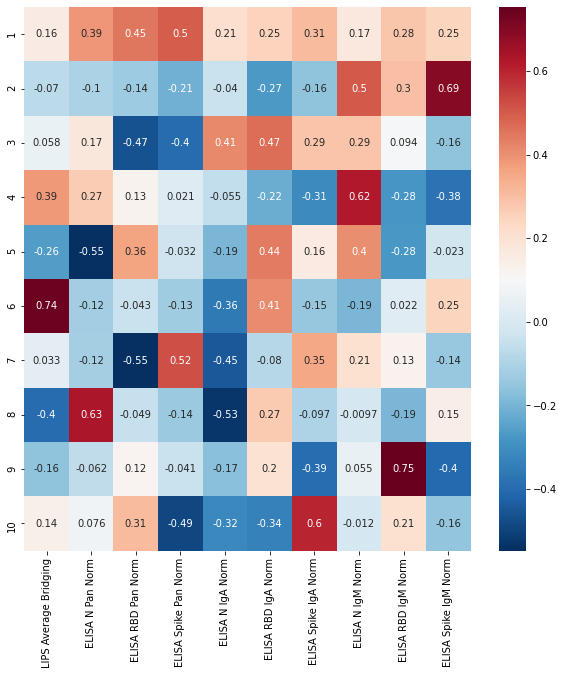

Absolute PCA components


<Figure size 432x288 with 0 Axes>

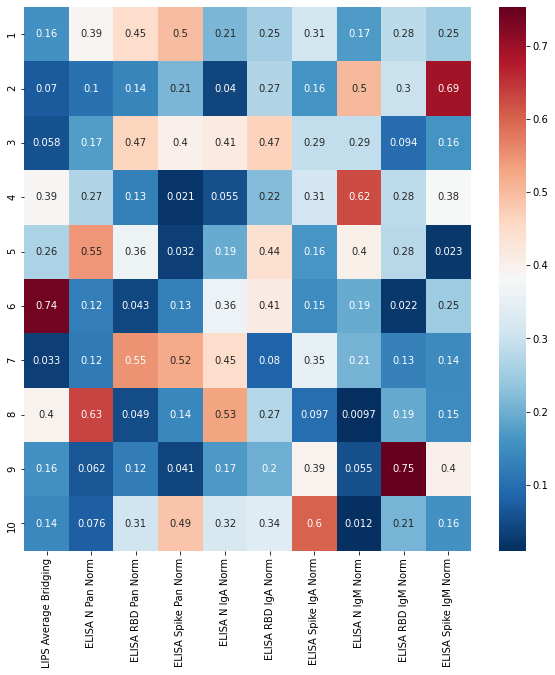

Relative contributions of different features to each component


<Figure size 432x288 with 0 Axes>

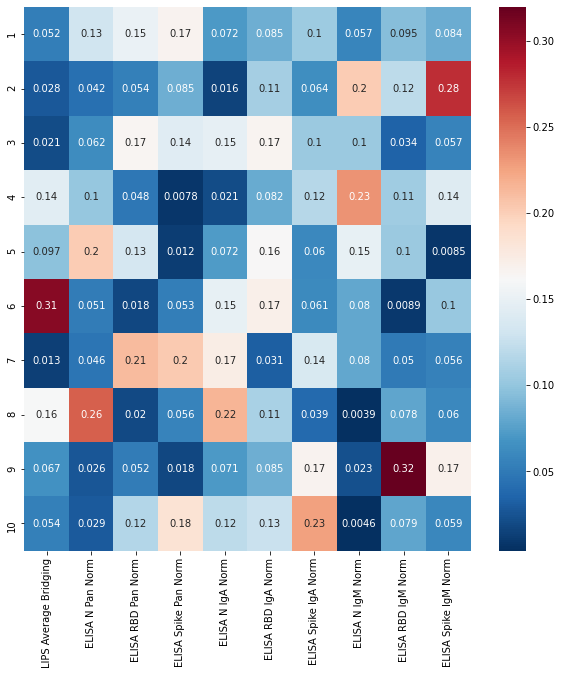

Relative contributions each feature makes to different components


<Figure size 432x288 with 0 Axes>

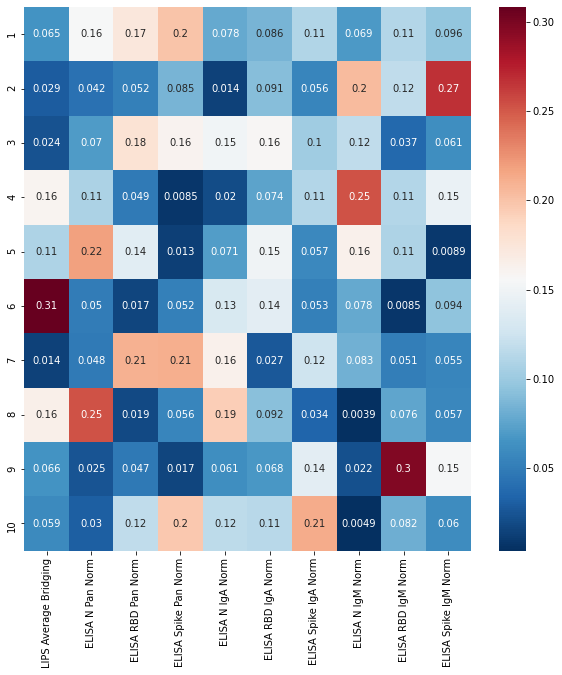




Validation
PCA components


<Figure size 432x288 with 0 Axes>

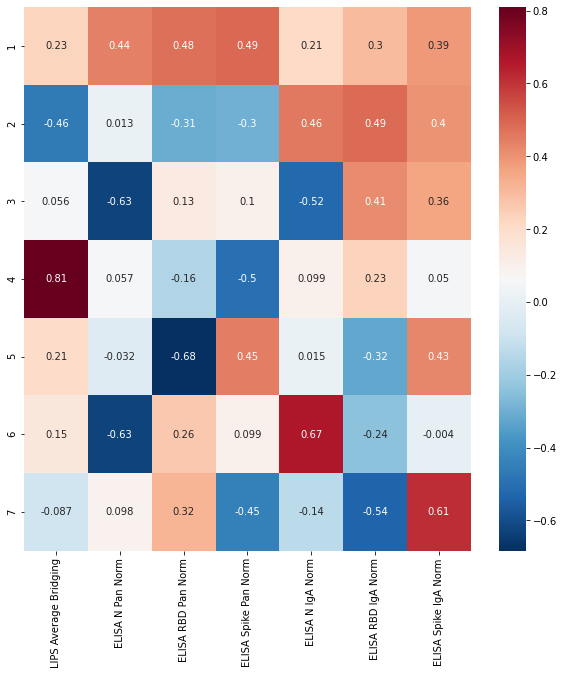

Absolute PCA components


<Figure size 432x288 with 0 Axes>

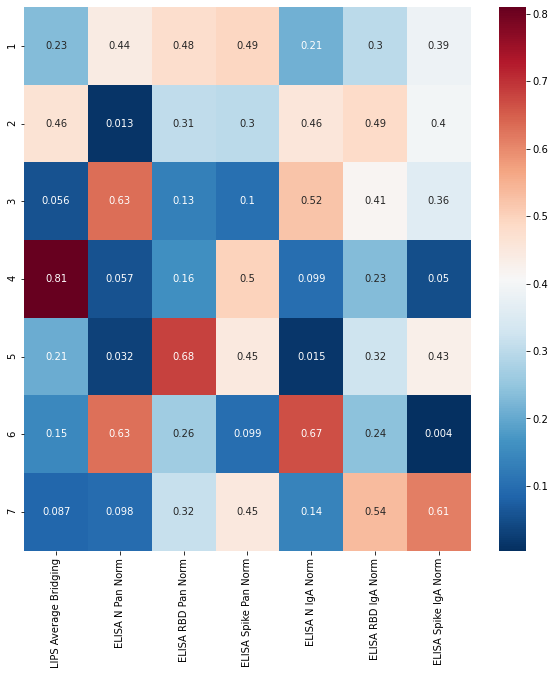

Relative contributions of different features to each component


<Figure size 432x288 with 0 Axes>

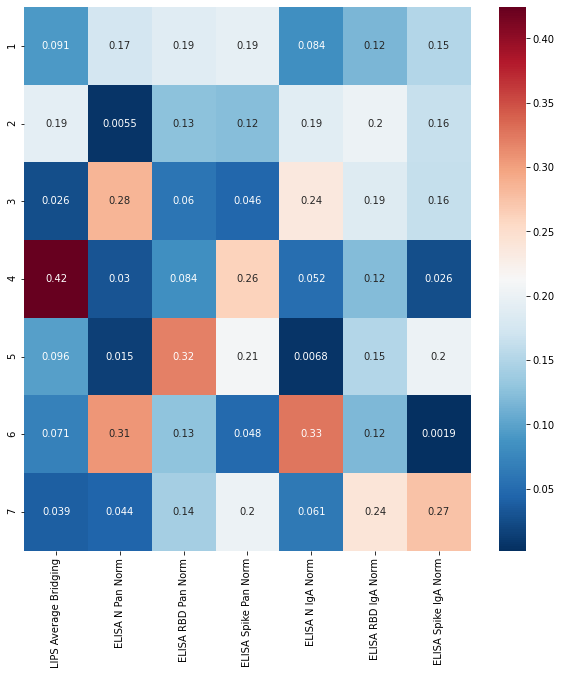

Relative contributions each feature makes to different components


<Figure size 432x288 with 0 Axes>

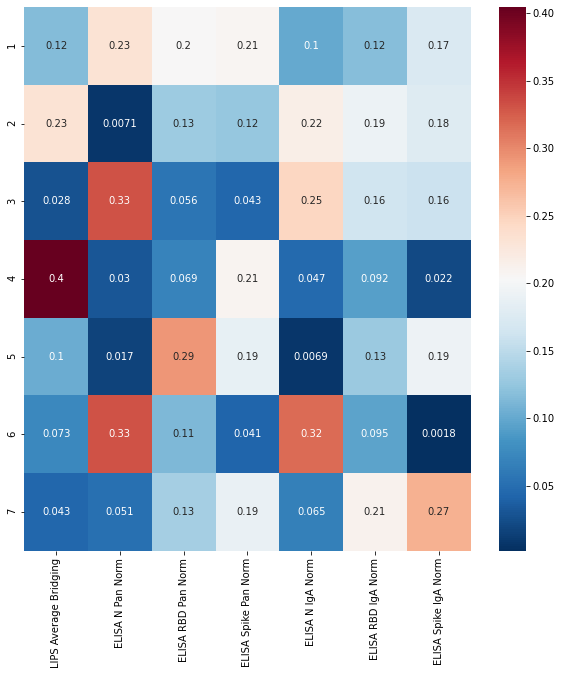




All data
PCA components


<Figure size 432x288 with 0 Axes>

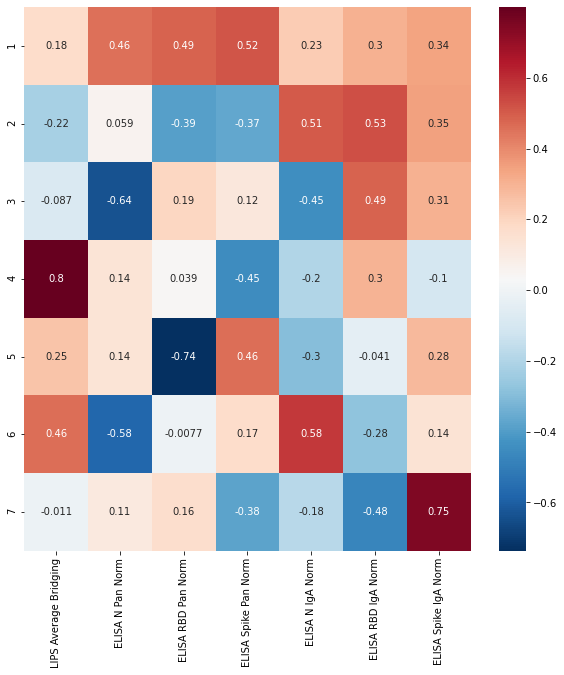

Absolute PCA components


<Figure size 432x288 with 0 Axes>

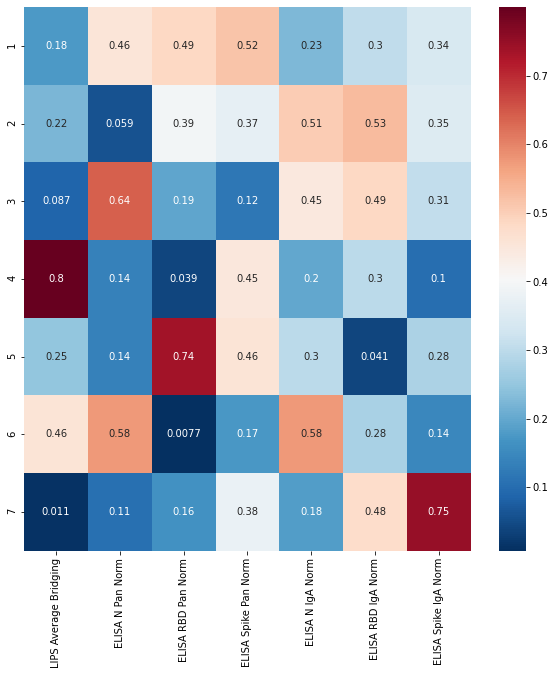

Relative contributions of different features to each component


<Figure size 432x288 with 0 Axes>

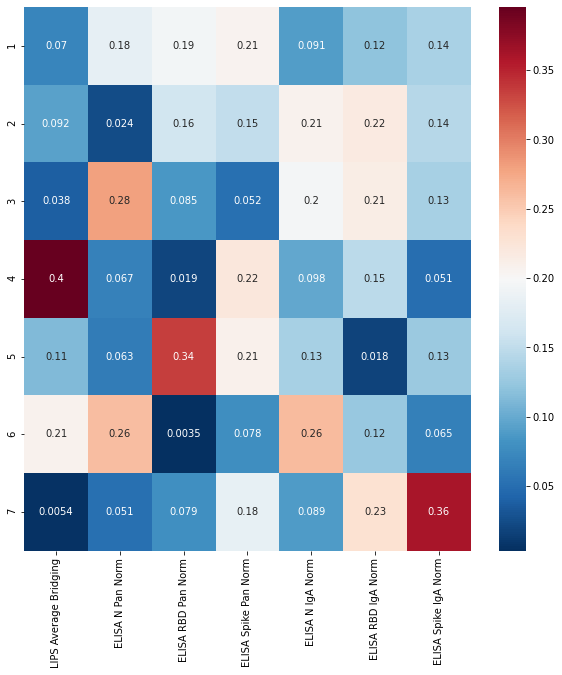

Relative contributions each feature makes to different components


<Figure size 432x288 with 0 Axes>

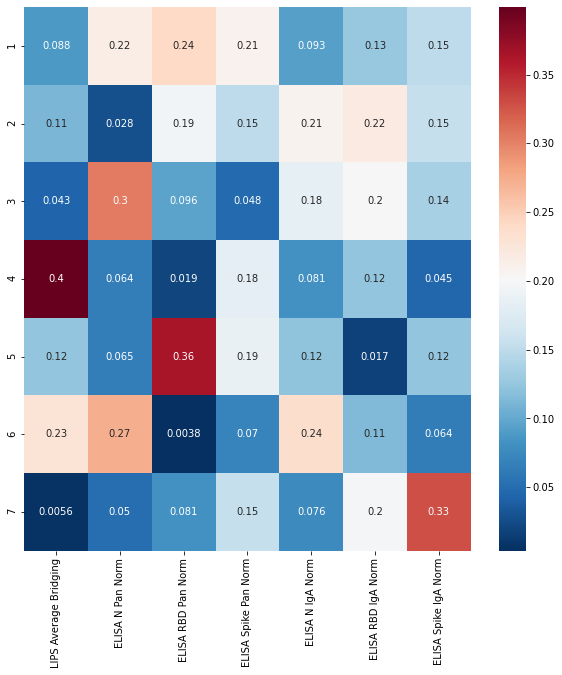

In [87]:
for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    pca_x = pca_dict[label][0]
    pca_fitted = pca_dict[label][1]
    ml_x = copy.deepcopy(ml_x_dict[label])

    pca_components = pca_fitted.components_
    pca_components = pd.DataFrame(pca_fitted.components_, index=list(range(1, pca_x.shape[1]+1)),
                                  columns=ml_x.columns)

    print('PCA components')
    plt.clf()
    plt.figure(figsize=(10,10))
    sns.heatmap(data=pca_components, cmap='RdBu_r', annot=True, xticklabels=True, yticklabels=True)
    plt.show()

    print('Absolute PCA components')
    abs_pca_components = copy.deepcopy(pca_components).abs()
    plt.clf()
    plt.figure(figsize=(10,10))
    sns.heatmap(data=abs_pca_components, cmap='RdBu_r', annot=True, xticklabels=True, yticklabels=True)
    plt.show()

    print('Relative contributions of different features to each component')
    row_sums = copy.deepcopy(pca_components).abs().sum(axis=1)
    relative_pca_components = copy.deepcopy(pca_components).abs().div(row_sums, axis=0)
    plt.clf()
    plt.figure(figsize=(10,10))
    sns.heatmap(data=relative_pca_components, cmap='RdBu_r', annot=True, xticklabels=True, yticklabels=True)
    plt.show()

    print('Relative contributions each feature makes to different components')
    col_sums = copy.deepcopy(pca_components).abs().sum(axis=0)
    relative_pca_components = copy.deepcopy(pca_components).abs().div(col_sums, axis=1)
    plt.clf()
    plt.figure(figsize=(10,10))
    sns.heatmap(data=relative_pca_components, cmap='RdBu_r', annot=True, xticklabels=True, yticklabels=True)
    plt.show()

Contributions to the PCA components calculated (separately) for the threshold and validation datasets are similar (encouragingly!). Greatest contribution to PCA dimension 1 = all 3 of the PanIg assays (not surprising as earlier analysis above confirms these assays show the greatest correlation with all of the other assays, but given their high correlation with each other perhaps is surprising that all three make a large contribution). However, in fact all of the assays make substantial contributions to PCA dimension 1 (whilst there are differences in degree of contribution, all are in the range of 0.16 - 0.5 (threshold dataset) / 0.21 - 0.49 (validation dataset)). Interestingly lowest contribution is from LIPS assay, in spite of the fact that individually it is one of the best performing assays. Is this because of its high skewness as compared to the other assays, making it difficult to combine with the others? After all, PCA assumes linear relationship between variables, since calculation makes use of Pearson's correlation coefficients - this assumption is most strongly broken for LIPS assay. BUT, remember observe low correlation even when look at ranks of positive samples only => another factor must also be having an effect.

Can try manifold learning to get around linearity assumption made in PCA, but annoyingly in scikit learn can't get contributions of the individual features to each component, so ability to compare between PCA and manifold learning results is limited...




Threshold


<Figure size 432x288 with 0 Axes>

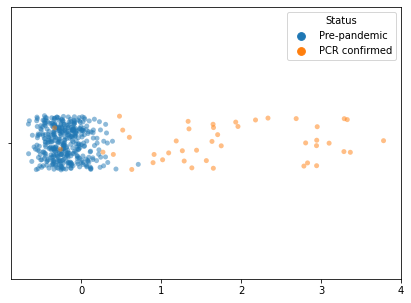

<Figure size 432x288 with 0 Axes>

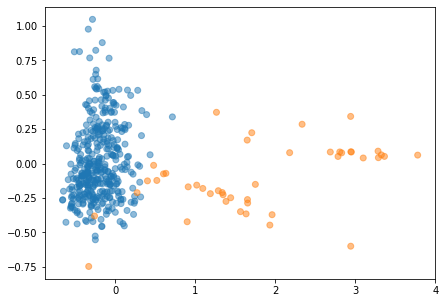

<Figure size 432x288 with 0 Axes>

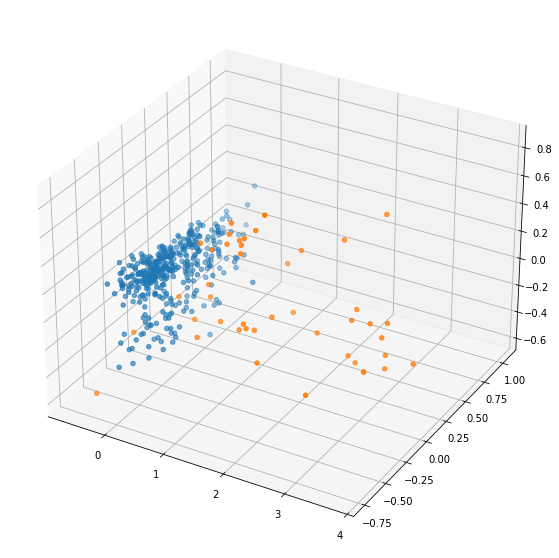




Validation


<Figure size 432x288 with 0 Axes>

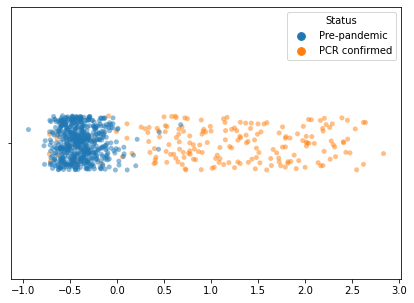

<Figure size 432x288 with 0 Axes>

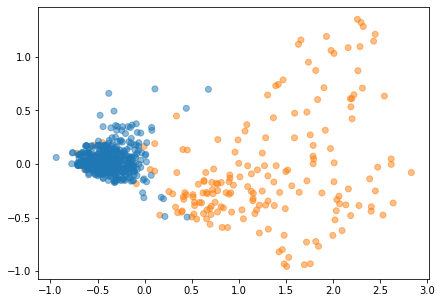

<Figure size 432x288 with 0 Axes>

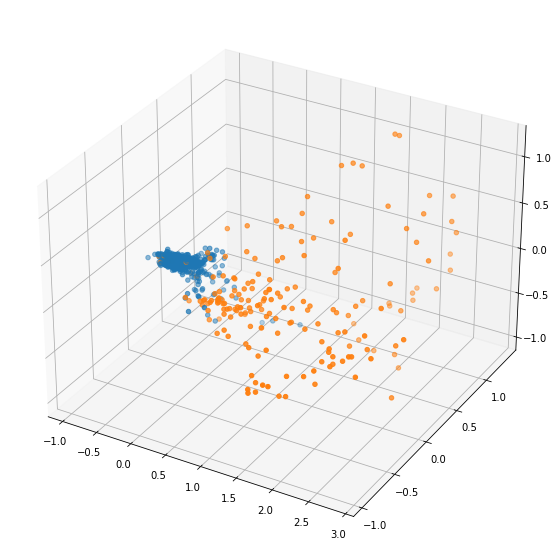




All data


<Figure size 432x288 with 0 Axes>

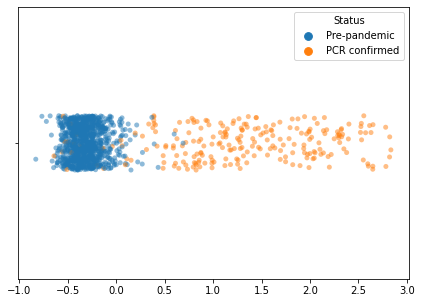

<Figure size 432x288 with 0 Axes>

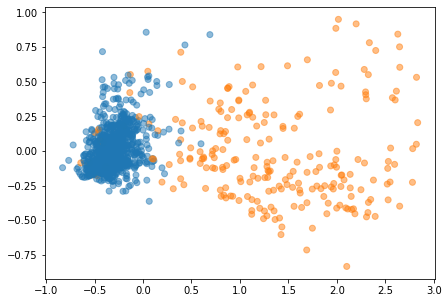

<Figure size 432x288 with 0 Axes>

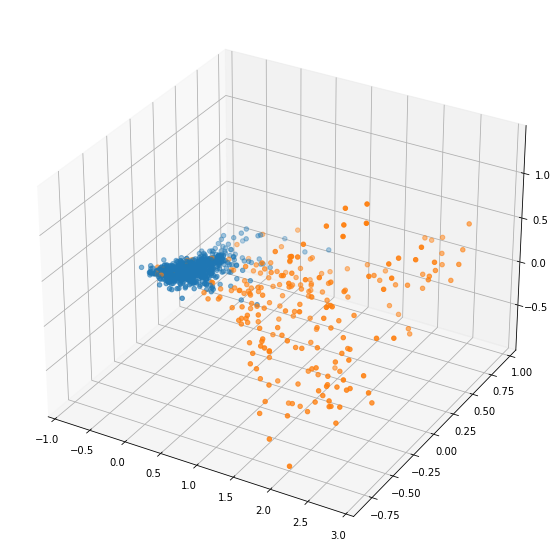

In [88]:
# Run manifold learning (looks for dimensions of maximum variance on a non-linear scale => might help to
# deconvolute effects described above)

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    ml_x = copy.deepcopy(ml_x_dict[label])
    ml_y = copy.deepcopy(ml_y_dict[label])

    # Manifold learning via isometric mapping
    iso = Isomap(n_components=3, eigen_solver='auto', n_jobs=-1)
    iso_fitted = iso.fit(X=ml_x)
    iso_x = iso_fitted.transform(X=ml_x)

    # Plots transformed data on 1, 2 and 3D scatter plots
    plot_colours = []
    for y in ml_y['Status']:
        if y == 'Pre-pandemic':
            plot_colours.append('tab:blue')
        elif y == 'PCR confirmed':
            plot_colours.append('tab:orange')
    plt.clf()
    plt.figure(figsize=(7,5))
    sns.stripplot(x=iso_x[:,0], y=['']*iso_x.shape[0], hue=ml_y['Status'], jitter=True, alpha=0.5,
                  hue_order=['Pre-pandemic', 'PCR confirmed'])
    plt.show()
    plt.clf()
    plt.figure(figsize=(7,5))
    plt.scatter(iso_x[:,0], iso_x[:,1], c=plot_colours, alpha=0.5)
    plt.show()
    plt.clf()
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(projection='3d')
    ax.scatter(iso_x[:,0], iso_x[:,1], iso_x[:,2], c=plot_colours)
    plt.show()




Threshold


<Figure size 432x288 with 0 Axes>

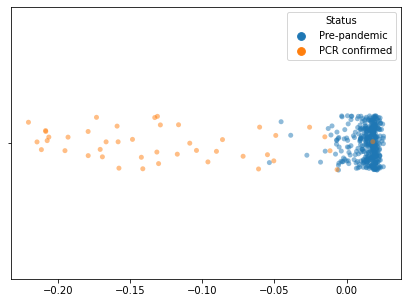

<Figure size 432x288 with 0 Axes>

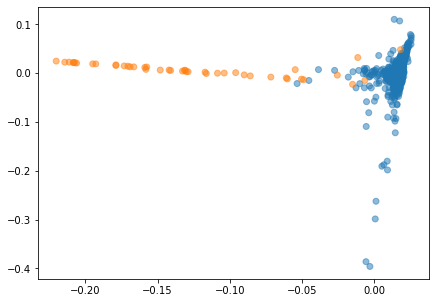

<Figure size 432x288 with 0 Axes>

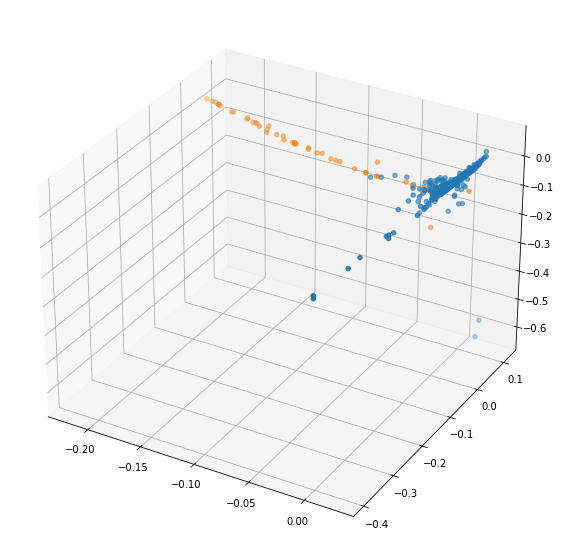




Validation


<Figure size 432x288 with 0 Axes>

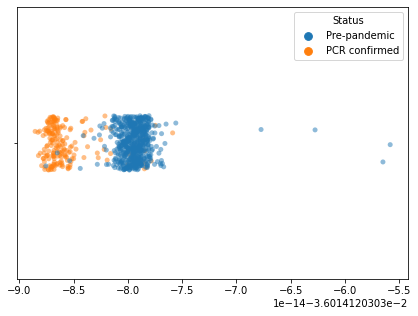

<Figure size 432x288 with 0 Axes>

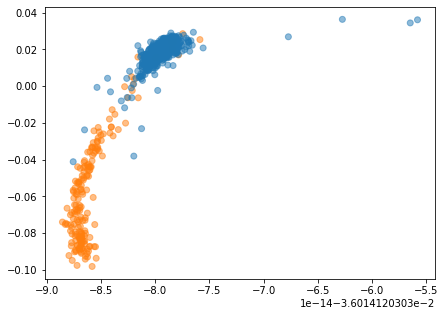

<Figure size 432x288 with 0 Axes>

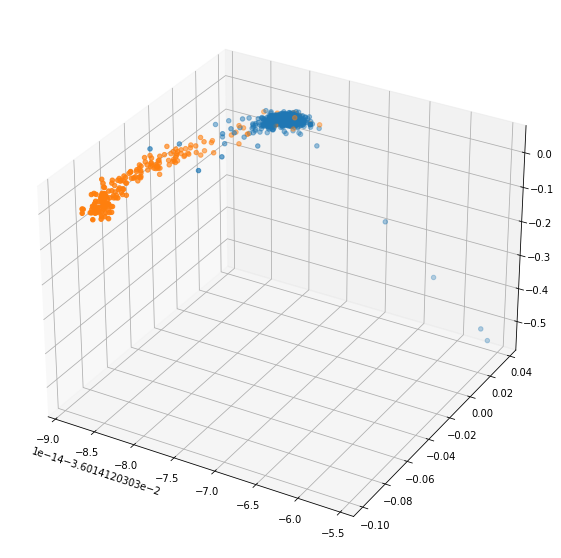




All data


<Figure size 432x288 with 0 Axes>

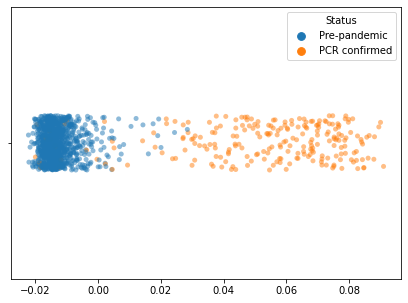

<Figure size 432x288 with 0 Axes>

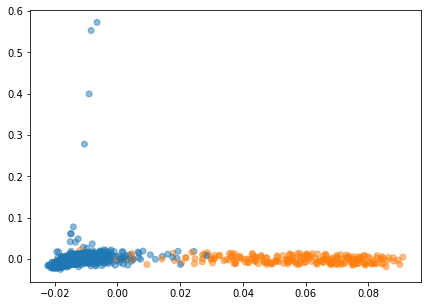

<Figure size 432x288 with 0 Axes>

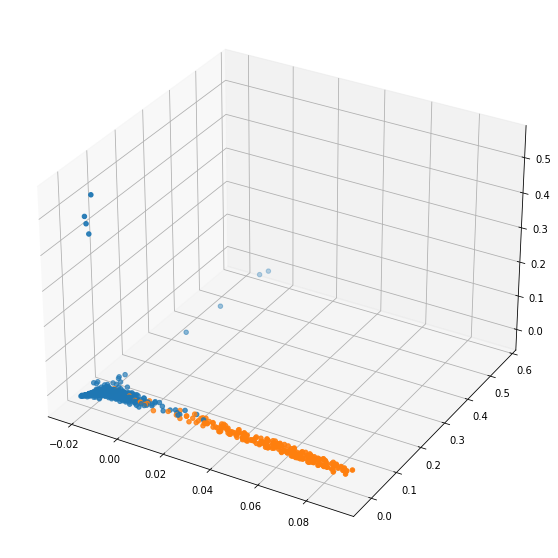

In [89]:
# Run manifold learning (looks for dimensions of maximum variance on a non-linear scale => might help to
# deconvolute effects described above)

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    ml_x = copy.deepcopy(ml_x_dict[label])
    ml_y = copy.deepcopy(ml_y_dict[label])

    # Manifold learning via modified local linear embedding
    mlle = LocallyLinearEmbedding(n_components=3, n_neighbors=6, method='modified', eigen_solver='auto', n_jobs=-1)
    mlle_fitted = mlle.fit(X=ml_x)
    mlle_x = mlle_fitted.transform(X=ml_x)

    # Plots transformed data on 1, 2 and 3D scatter plots
    plot_colours = []
    for y in ml_y['Status']:
        if y == 'Pre-pandemic':
            plot_colours.append('tab:blue')
        elif y == 'PCR confirmed':
            plot_colours.append('tab:orange')
    plt.clf()
    plt.figure(figsize=(7,5))
    sns.stripplot(x=mlle_x[:,0], y=['']*mlle_x.shape[0], hue=ml_y['Status'], jitter=True, alpha=0.5,
                  hue_order=['Pre-pandemic', 'PCR confirmed'])
    plt.show()
    plt.clf()
    plt.figure(figsize=(7,5))
    plt.scatter(mlle_x[:,0], mlle_x[:,1], c=plot_colours, alpha=0.5)
    plt.show()
    plt.clf()
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(projection='3d')
    ax.scatter(mlle_x[:,0], mlle_x[:,1], mlle_x[:,2], c=plot_colours)
    plt.show()

So, manifold methods show similar ability to separate the data as PCA (isometric mapping does a better job than modified local linear embedding - former works as well as PCA, latter appears to be less effective). Unfortunately I can't calculate the contributions of the different features to the components for the manifold learning methods to see how they compare to PCA (as described above, think results could be quite different given the high skew of some of the data and the assumption of linear relationships between features made by PCA).

#### What do feature importance scores suggest about the different assays?

There are several different methods of measuring feature importance in ML analysis. These include univariate analysis (in which the "agreement" (i.e. some selected metric, e.g. mutual information) between each individual "independent" variable and the dependent variable is considered, hence correlations between the "independent" variables are not considered. However, it is definitely not the case here that the assays are independent of one another (see the correlation coefficient calculations above)!). Methods to measure feature importance also include sequential feature selection (in which features are either included or excluded sequentially - consequently features are included/excluded based upon the extra information they bring to/remove from the selection of features already there => this method does take into account feature correlation) and permutation (where the performance of a model trained with and without a particular feature is compared, hence feature correlation is taken into account). For completeness, have included univariate analysis (since gives additional evidence about which individual assays are best at separating positive and negative individuals), but when selecting combinations of assays to see if together they perform better than the individual assays, have used permutation results. (*Update - have not performed sequential feature selection as was extremely slow to run. Use permutation results alone instead - like sequential feature selection, this method also takes into account the correlation between features.*)

Since as described above the data from many of the assays is highly skewed, and cannot be readily transformed to a normal distribution, have selected ML algorithms that do not assume the data for each feature is normally distributed. Specifically, have selected two tree-based methods (AdaBoost and Random Forest) and SVM (with a linear kernel - **not** an rbf kernel).

Univariate feature analysis




Threshold
                 Feature     Score
0  LIPS Average Bridging  0.146526
1   ELISA Spike Pan Norm  0.143884
2       ELISA N Pan Norm  0.118143
3     ELISA RBD Pan Norm  0.116184
4   ELISA Spike IgA Norm  0.110695
5     ELISA RBD IgM Norm  0.087089
6       ELISA N IgA Norm  0.083336
7     ELISA RBD IgA Norm  0.081985
8   ELISA Spike IgM Norm  0.067372
9       ELISA N IgM Norm  0.046441


<Figure size 432x288 with 0 Axes>

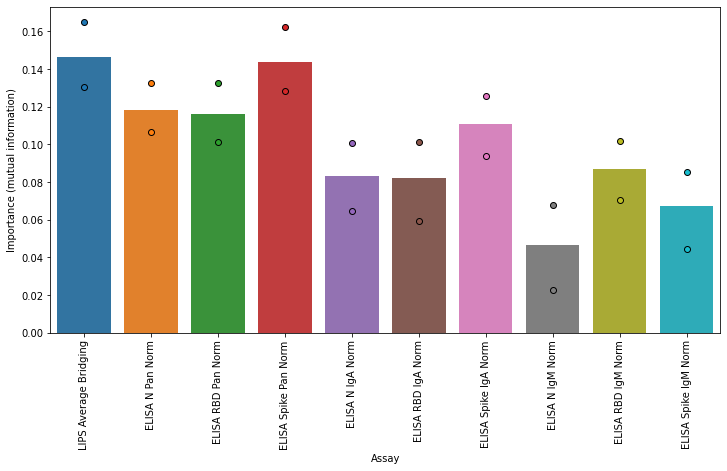

<Figure size 432x288 with 0 Axes>

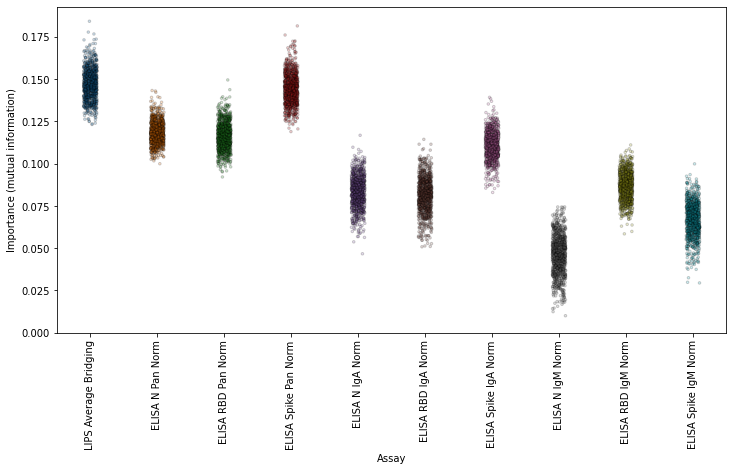

<Figure size 432x288 with 0 Axes>

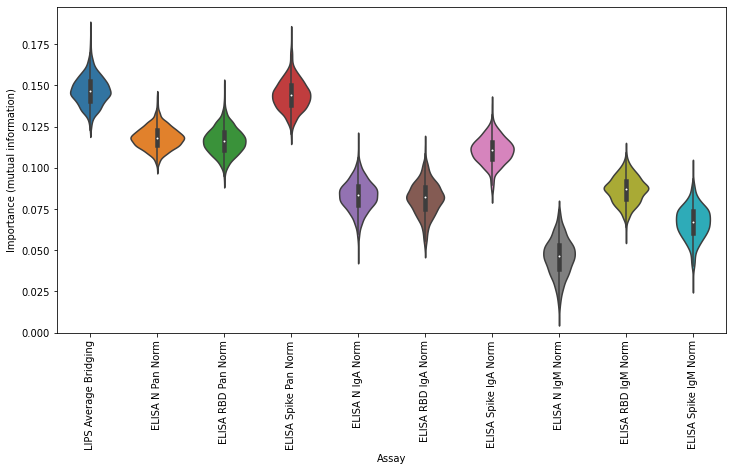




Validation
                 Feature     Score
0   ELISA Spike Pan Norm  0.190022
1  LIPS Average Bridging  0.186628
2     ELISA RBD Pan Norm  0.158327
3       ELISA N Pan Norm  0.153784
4   ELISA Spike IgA Norm  0.137750
5     ELISA RBD IgA Norm  0.097628
6       ELISA N IgA Norm  0.075551


<Figure size 432x288 with 0 Axes>

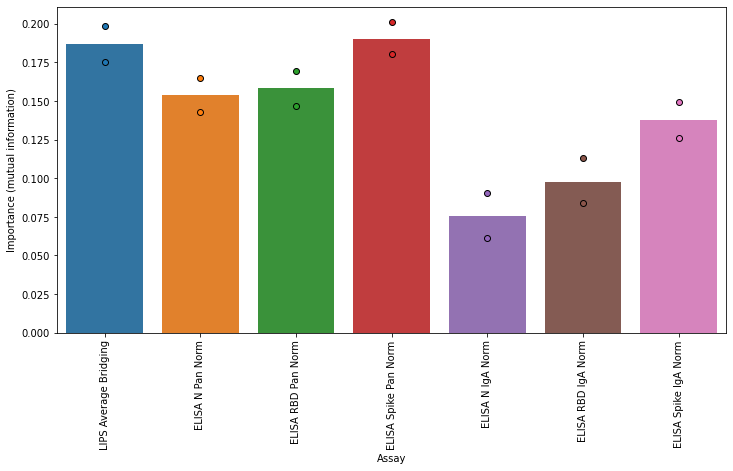

<Figure size 432x288 with 0 Axes>

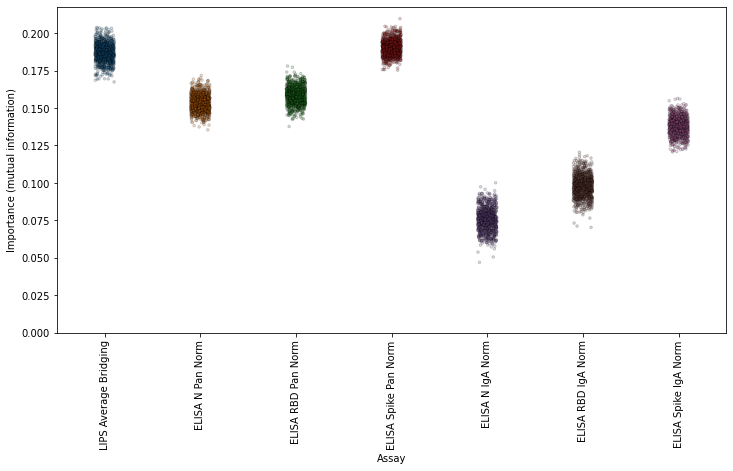

<Figure size 432x288 with 0 Axes>

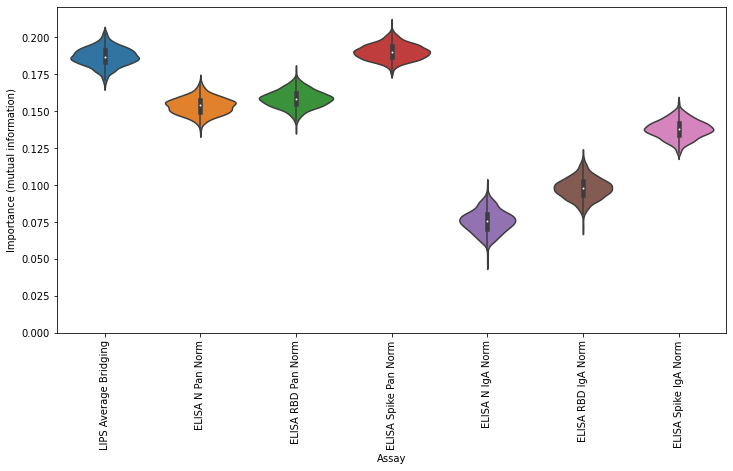




All data
                 Feature     Score
0   ELISA Spike Pan Norm  0.187183
1  LIPS Average Bridging  0.186091
2       ELISA N Pan Norm  0.151458
3     ELISA RBD Pan Norm  0.150438
4   ELISA Spike IgA Norm  0.138503
5     ELISA RBD IgA Norm  0.101191
6       ELISA N IgA Norm  0.085148


<Figure size 432x288 with 0 Axes>

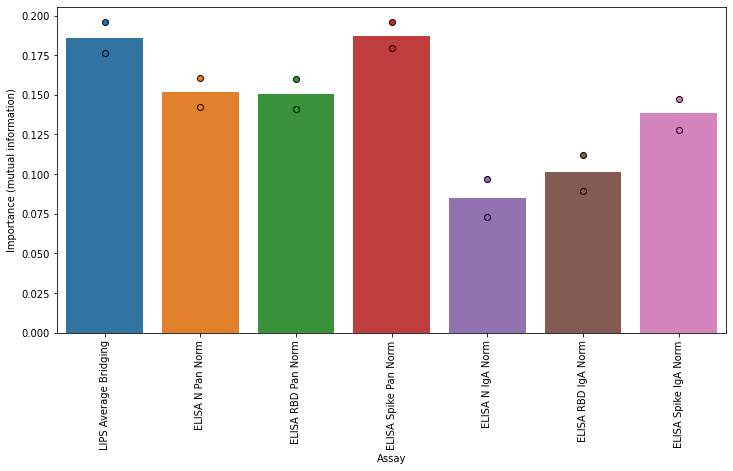

<Figure size 432x288 with 0 Axes>

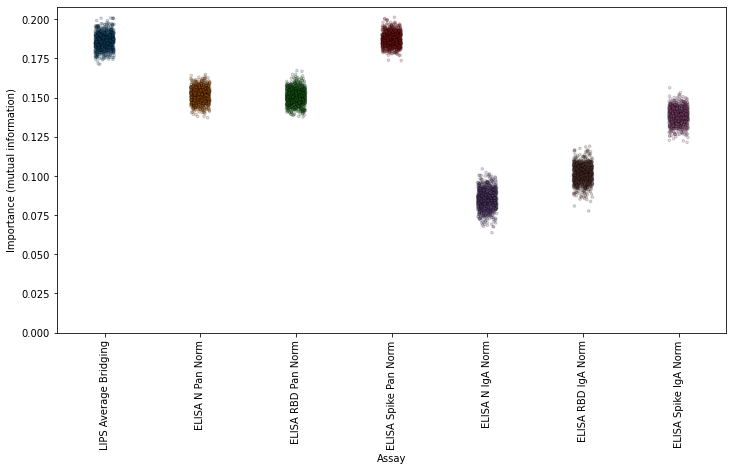

<Figure size 432x288 with 0 Axes>

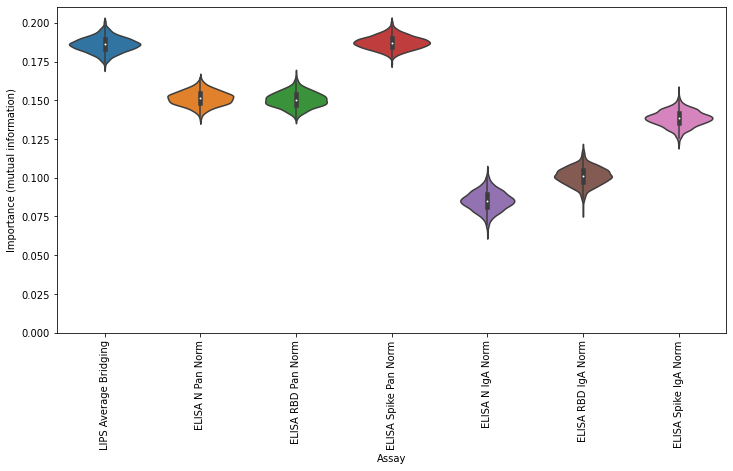

In [90]:
# Calculate assay "importances" using KBest method, with bootstrapped 95% confidence limits.
# Note such univariate methods assume that the assay results are independent (which is definitely not the case!),
# and thus could pick 2 or more assays as highly important when in fact they all give the same information (and
# so will not work better in combination than individually)
# mutual_info_classif => no assumption of linearity
# FYI can't perform SMOTE oversampling of the positive class before this analysis, since violates the assumption
# that features are independent. Since metric selected is determinate (i.e. will give the same answer every time),
# to get 95% conf limit estimates have performed boostrapping of datasets

kbest_score_dfs = {}

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    if label == 'Threshold':
        cols = thresh_upd_cont_cols
    else:
        cols = val_upd_cont_cols
    ml_x = copy.deepcopy(ml_x_dict[label])
    ml_y = copy.deepcopy(ml_y_dict[label])

    y_scores = np.empty([1000, len(cols)])
    x_swarm_list = []
    y_swarm_list = []
    for i in range(1000):
        random_rows = []
        for n in range(ml_x.shape[0]):
            random_rows.append(random.randint(0, ml_x.shape[0]-1))
        bootstrap_ml_x = copy.deepcopy(ml_x).iloc[random_rows].reset_index(drop=True)
        bootstrap_ml_y = copy.deepcopy(ml_y).iloc[random_rows].reset_index(drop=True)

        model = SelectKBest(score_func=mutual_info_classif, k='all')
        model.fit(X=bootstrap_ml_x.values, y=bootstrap_ml_y['Status'])

        total_y = np.sum(model.scores_)
        norm_y = model.scores_ / total_y

        for j, y in np.ndenumerate(norm_y):
            y_scores[i][j] = y
            x_swarm_list.append(ml_x.columns[j])
            y_swarm_list.append(y)

    mut_info_median = np.median(y_scores, axis=0)
    mut_info_lower_conf_limit = np.percentile(y_scores, 2.5, axis=0)
    mut_info_upper_conf_limit = np.percentile(y_scores, 97.5, axis=0)
    
    kbest_score_df = pd.DataFrame({'Feature': ml_x.columns, 'Score': mut_info_median})
    kbest_score_df = kbest_score_df.sort_values(by=['Score'], axis=0, ascending=False).reset_index(drop=True)
    kbest_score_dfs[label] = kbest_score_df

    print(kbest_score_df)

    plt.clf()
    plt.figure(figsize=(12,6))
    sns.barplot(x=ml_x.columns, y=mut_info_median)
    sns.stripplot(x=ml_x.columns, y=mut_info_lower_conf_limit, edgecolor='k', linewidth=1, s=6, jitter=False)
    sns.stripplot(x=ml_x.columns, y=mut_info_upper_conf_limit, edgecolor='k', linewidth=1, s=6, jitter=False)
    plt.xticks(np.arange(len(ml_x.columns)), ml_x.columns, rotation='vertical')
    plt.ylim(ymin=0)
    plt.xlabel('Assay')
    plt.ylabel('Importance (mutual information)')
    plt.show()

    plt.clf()
    plt.figure(figsize=(12,6))
    sns.stripplot(x=x_swarm_list, y=y_swarm_list, edgecolor='k', linewidth=1, size=2.5, alpha=0.2)
    plt.xticks(np.arange(len(ml_x.columns)), ml_x.columns, rotation='vertical')
    plt.ylim(ymin=0)
    plt.xlabel('Assay')
    plt.ylabel('Importance (mutual information)')
    plt.show()
    
    plt.clf()
    plt.figure(figsize=(12,6))
    sns.violinplot(x=x_swarm_list, y=y_swarm_list)
    plt.xticks(np.arange(len(ml_x.columns)), ml_x.columns, rotation='vertical')
    plt.ylim(ymin=0)
    plt.xlabel('Assay')
    plt.ylabel('Importance (mutual information)')
    plt.show()

So, results provide further evidence that the LIPS assay and the ELISA PanIg assays (in particular ELISA PanIg Spike) are the best assays at individually  discriminating between positive and negative samples. However, it doesn't provide evidence of which assays work best in combination.

Tree-based feature importance analysis




Threshold
Unbalanced
                 Feature     Score
0   ELISA Spike Pan Norm  0.307084
1       ELISA N Pan Norm  0.150210
2  LIPS Average Bridging  0.135644
3     ELISA RBD Pan Norm  0.129142
4   ELISA Spike IgA Norm  0.098692
5     ELISA RBD IgM Norm  0.052515
6     ELISA RBD IgA Norm  0.046422
7       ELISA N IgA Norm  0.036726
8   ELISA Spike IgM Norm  0.017351
9       ELISA N IgM Norm  0.013784


<Figure size 432x288 with 0 Axes>

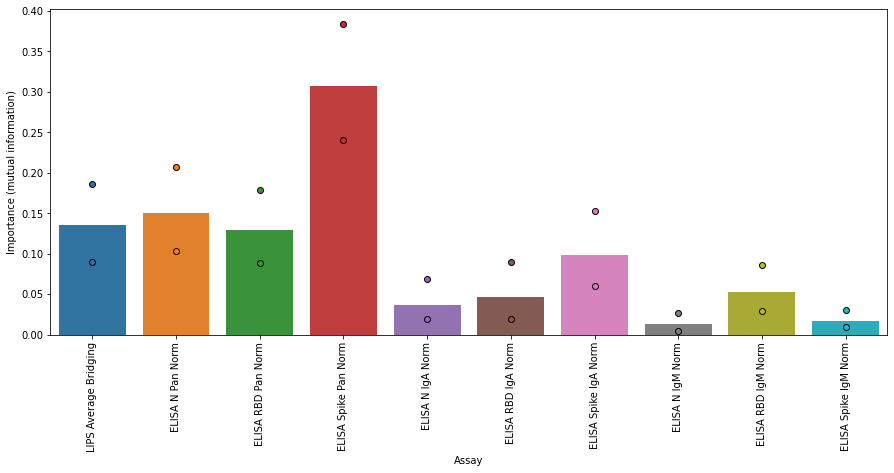

<Figure size 432x288 with 0 Axes>

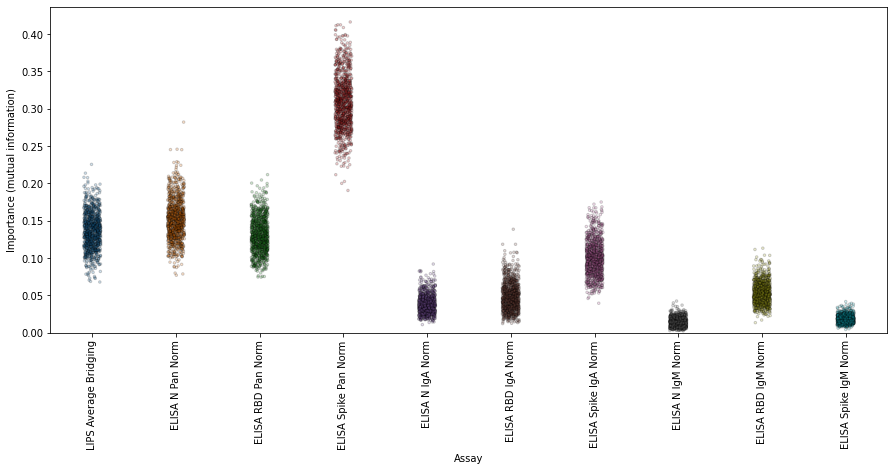

<Figure size 432x288 with 0 Axes>

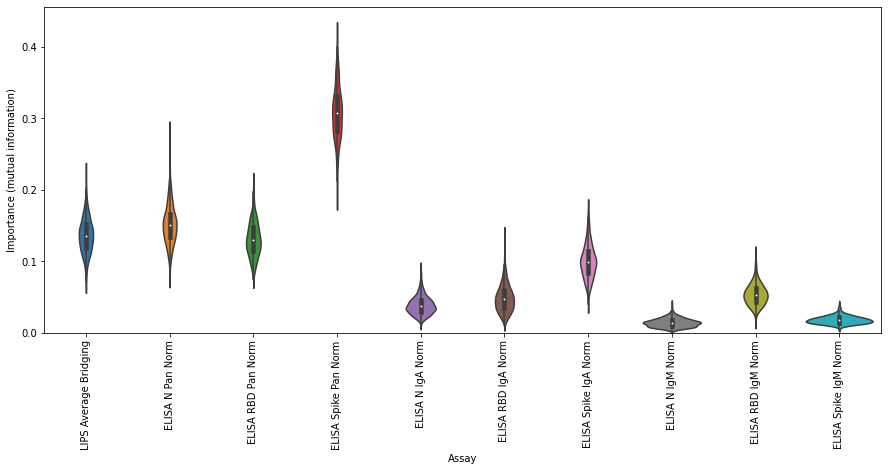

Balanced
                 Feature     Score
0   ELISA Spike Pan Norm  0.329125
1       ELISA N Pan Norm  0.143485
2     ELISA RBD Pan Norm  0.142297
3  LIPS Average Bridging  0.113575
4   ELISA Spike IgA Norm  0.096748
5     ELISA RBD IgA Norm  0.051694
6     ELISA RBD IgM Norm  0.047325
7       ELISA N IgA Norm  0.033794
8   ELISA Spike IgM Norm  0.019965
9       ELISA N IgM Norm  0.016715


<Figure size 432x288 with 0 Axes>

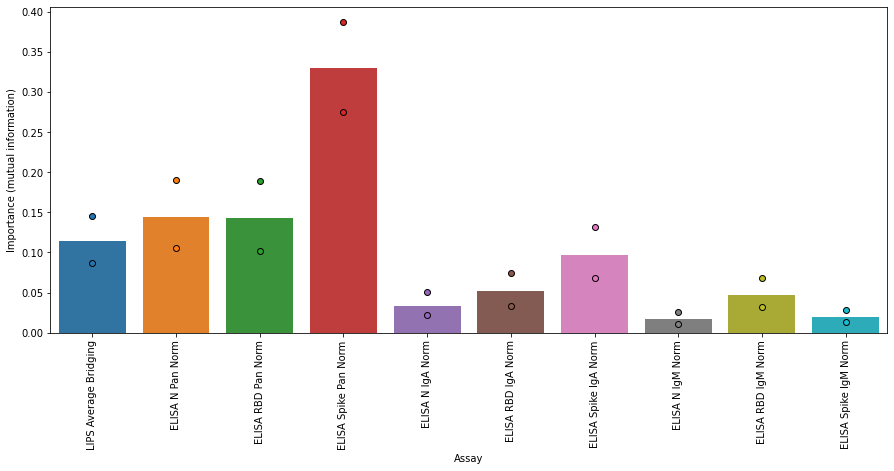

<Figure size 432x288 with 0 Axes>

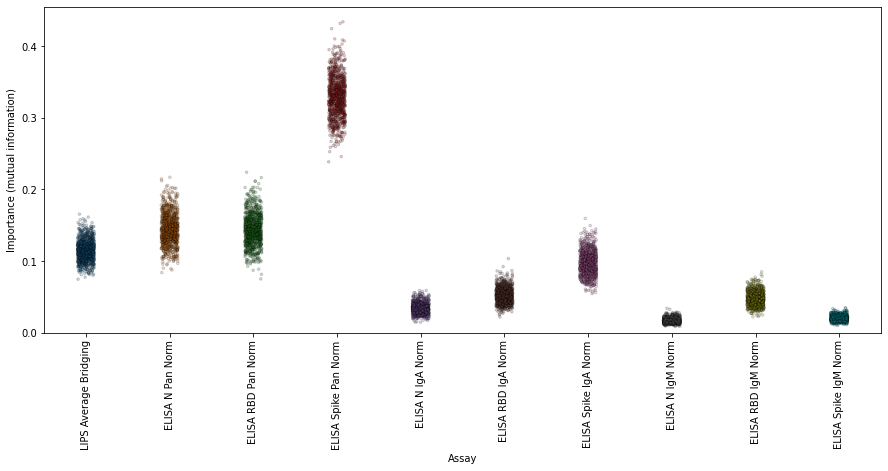

<Figure size 432x288 with 0 Axes>

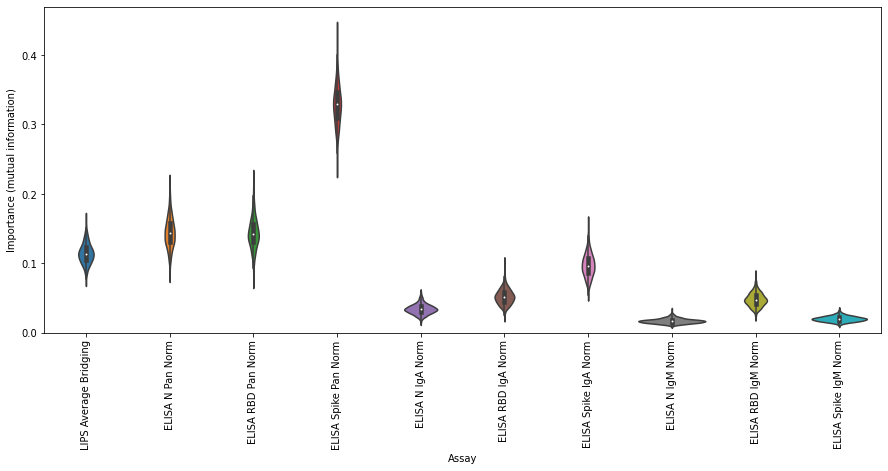




Validation
Unbalanced
                 Feature     Score
0   ELISA Spike Pan Norm  0.303925
1     ELISA RBD Pan Norm  0.182715
2       ELISA N Pan Norm  0.166800
3  LIPS Average Bridging  0.126472
4   ELISA Spike IgA Norm  0.122704
5     ELISA RBD IgA Norm  0.049905
6       ELISA N IgA Norm  0.042710


<Figure size 432x288 with 0 Axes>

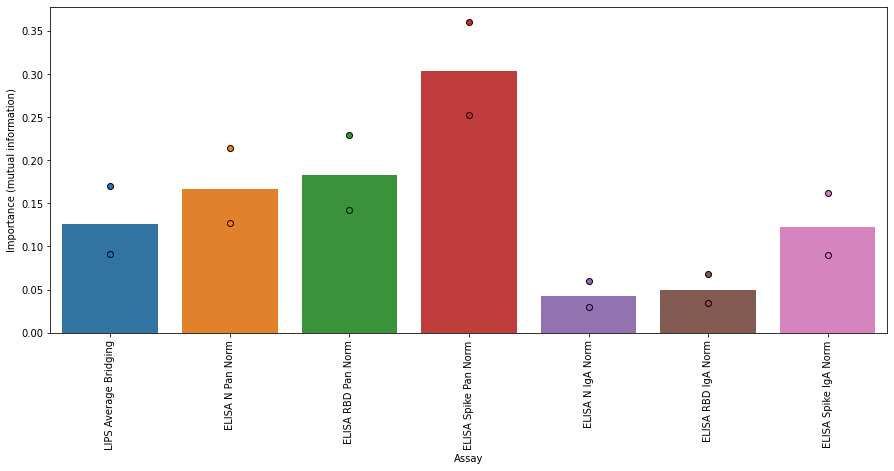

<Figure size 432x288 with 0 Axes>

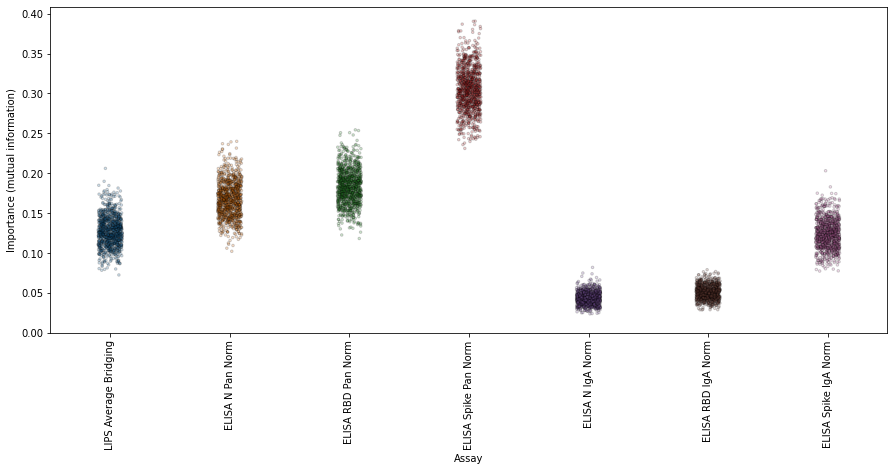

<Figure size 432x288 with 0 Axes>

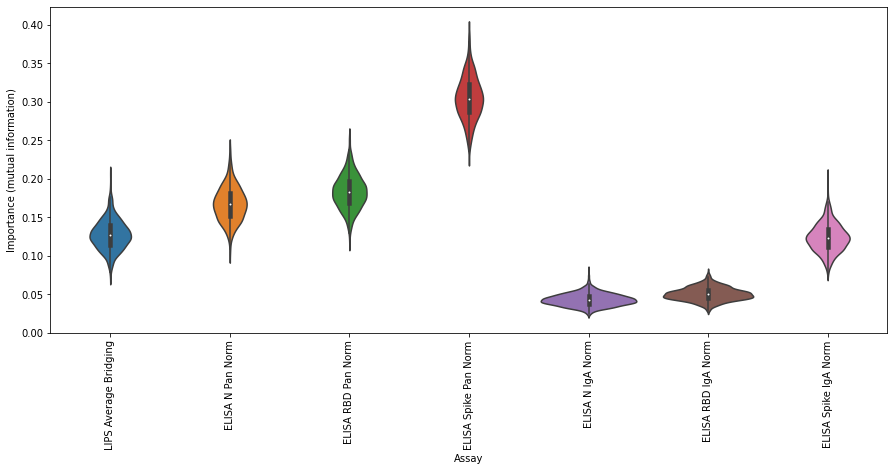

Balanced
                 Feature     Score
0   ELISA Spike Pan Norm  0.311063
1     ELISA RBD Pan Norm  0.183587
2       ELISA N Pan Norm  0.155408
3   ELISA Spike IgA Norm  0.128089
4  LIPS Average Bridging  0.119710
5     ELISA RBD IgA Norm  0.054411
6       ELISA N IgA Norm  0.044247


<Figure size 432x288 with 0 Axes>

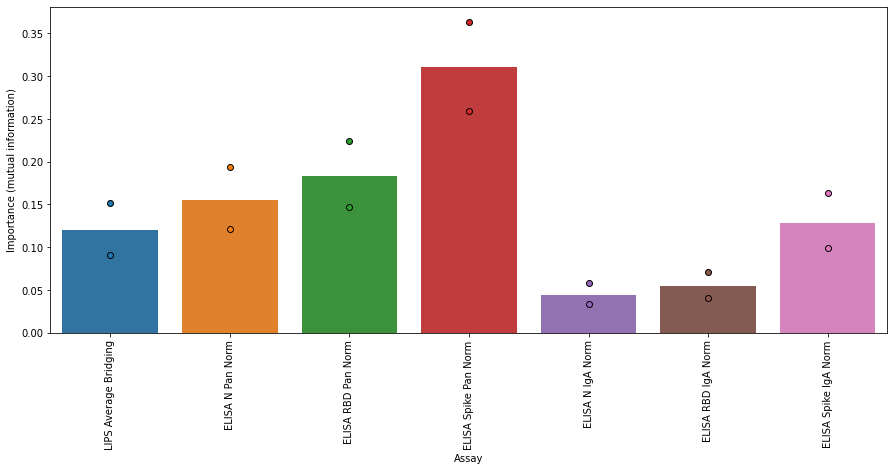

<Figure size 432x288 with 0 Axes>

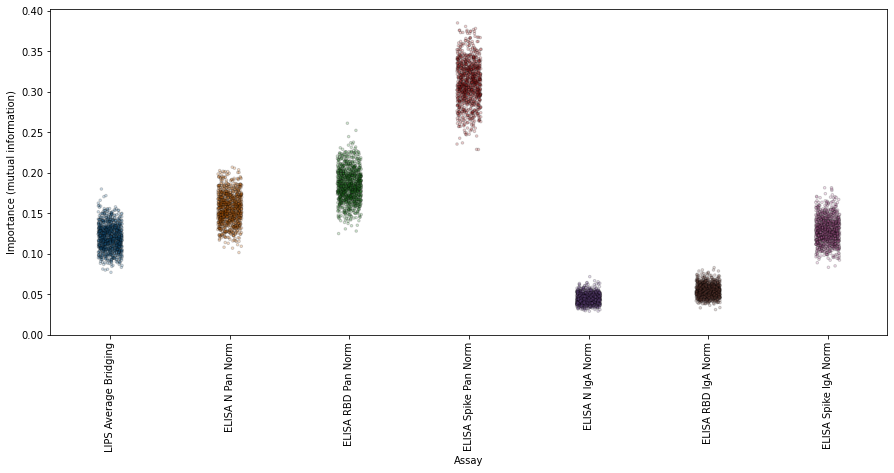

<Figure size 432x288 with 0 Axes>

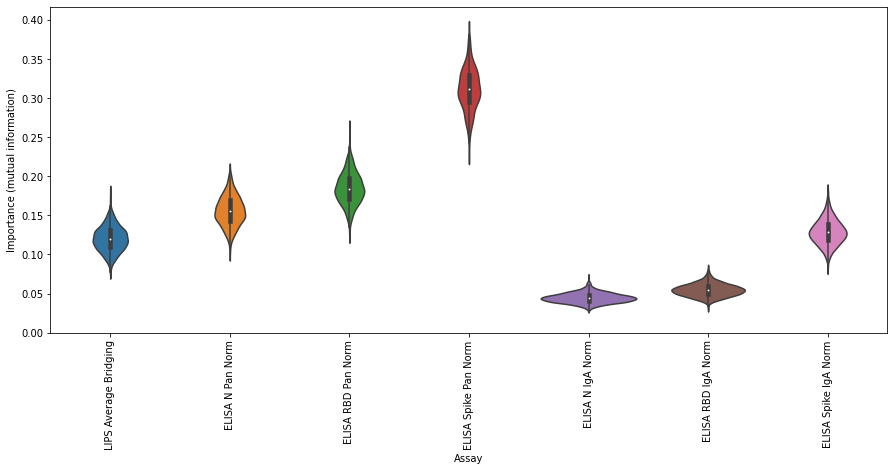




All data
Unbalanced
                 Feature     Score
0   ELISA Spike Pan Norm  0.319418
1       ELISA N Pan Norm  0.174246
2     ELISA RBD Pan Norm  0.161436
3  LIPS Average Bridging  0.124626
4   ELISA Spike IgA Norm  0.117906
5     ELISA RBD IgA Norm  0.053750
6       ELISA N IgA Norm  0.045262


<Figure size 432x288 with 0 Axes>

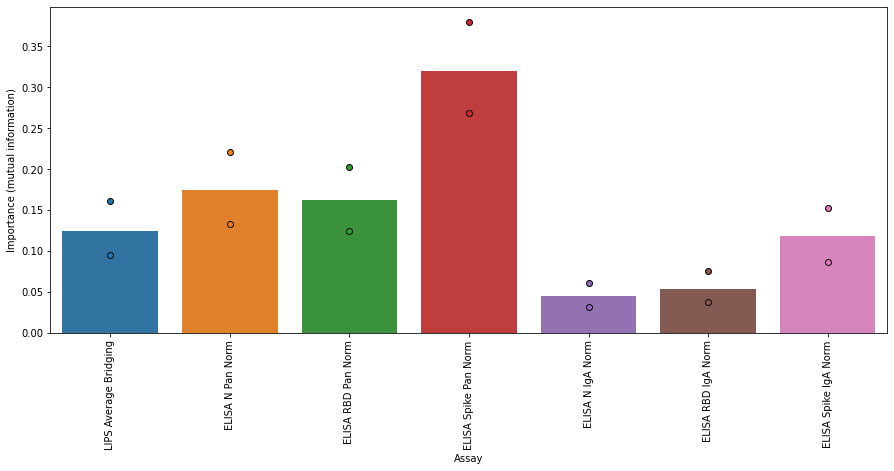

<Figure size 432x288 with 0 Axes>

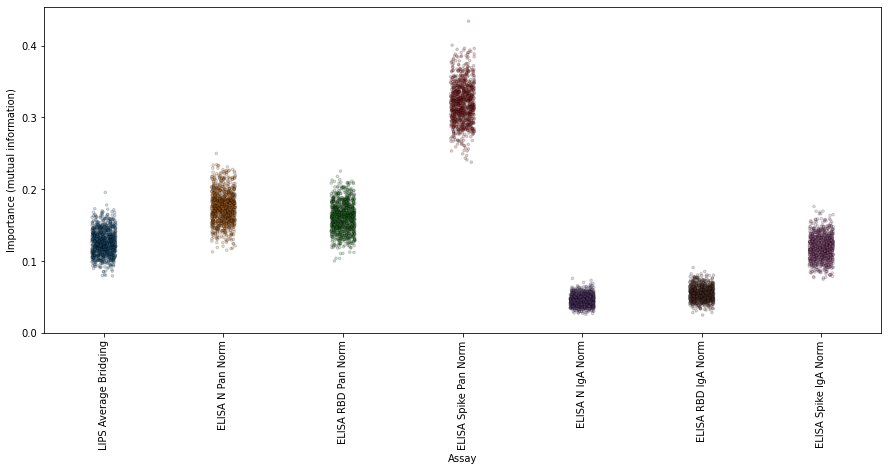

<Figure size 432x288 with 0 Axes>

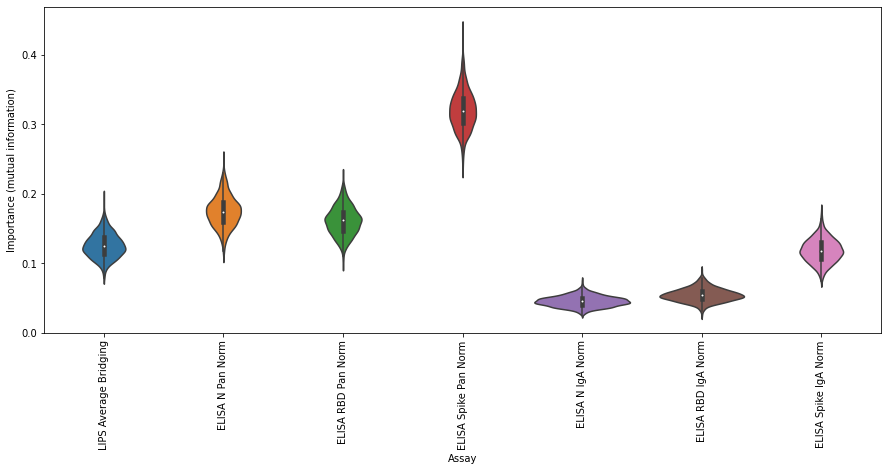

Balanced
                 Feature     Score
0   ELISA Spike Pan Norm  0.327023
1     ELISA RBD Pan Norm  0.170615
2       ELISA N Pan Norm  0.160393
3   ELISA Spike IgA Norm  0.121959
4  LIPS Average Bridging  0.112753
5     ELISA RBD IgA Norm  0.058985
6       ELISA N IgA Norm  0.045614


<Figure size 432x288 with 0 Axes>

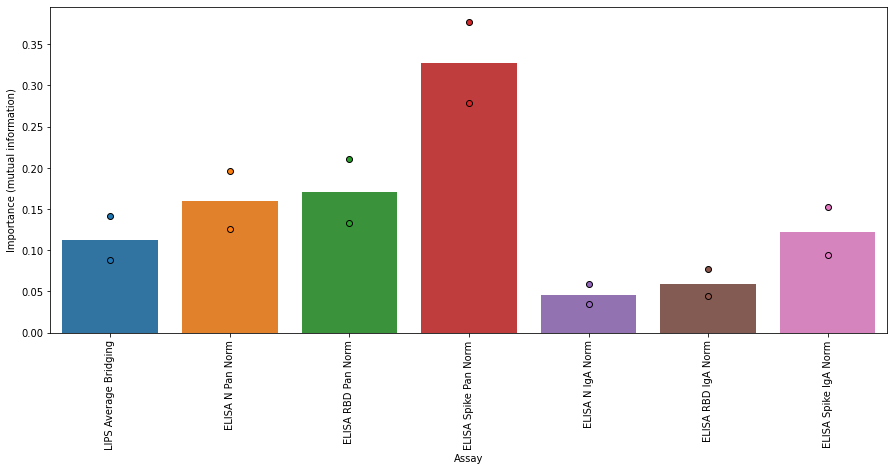

<Figure size 432x288 with 0 Axes>

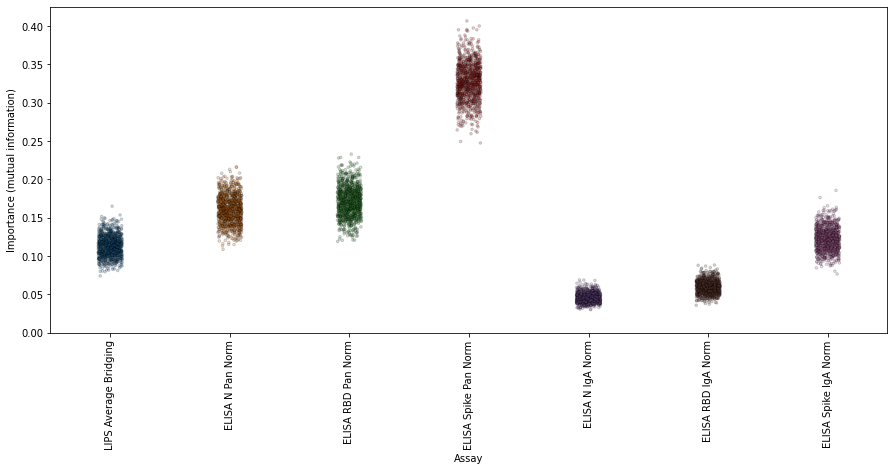

<Figure size 432x288 with 0 Axes>

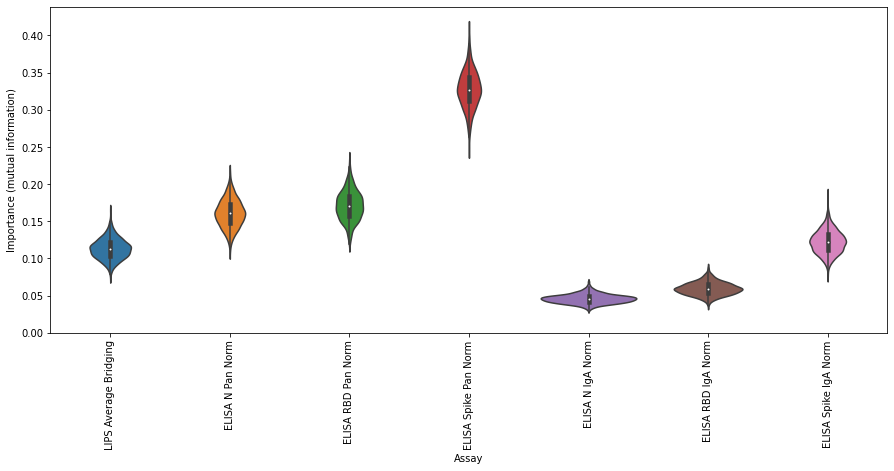

In [91]:
# Calculate assay "importances" using tree-based method (doesn't take into account feature correlations)

tree_score_dfs = {}

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    if label == 'Threshold':
        cols = thresh_upd_cont_cols
    else:
        cols = val_upd_cont_cols
    
    for balance_method in ['unbalanced', 'balanced']:
        print(balance_method.capitalize())

        y_scores = np.empty([1000, len(cols)])
        x_swarm_list = []
        y_swarm_list = []
        for i in range(1000):
            ml_x = copy.deepcopy(ml_x_dict[label])
            ml_y = copy.deepcopy(ml_y_dict[label])[['Status']]
            if balance_method == 'balanced':
                over = SMOTE(sampling_strategy=0.5)
                under = RandomUnderSampler(sampling_strategy=1)
                steps = [('o', over), ('u', under)]
                pipeline = Pipeline(steps=steps)
                ml_x, ml_y = pipeline.fit_resample(ml_x, ml_y['Status'].tolist())
            else:
                random_rows = []
                for n in range(ml_x.shape[0]):
                    random_rows.append(random.randint(0, ml_x.shape[0]-1))
                ml_x = ml_x.iloc[random_rows].reset_index(drop=True)
                ml_y = ml_y.iloc[random_rows].reset_index(drop=True)['Status'].tolist()
                
            model = ExtraTreesClassifier(criterion='entropy')
            model.fit(X=ml_x.values, y=ml_y)

            for j, y in np.ndenumerate(model.feature_importances_):
                y_scores[i][j] = y
                x_swarm_list.append(ml_x.columns[j])
                y_swarm_list.append(y)

        tree_clf_median = np.median(y_scores, axis=0)
        tree_clf_lower_conf_limit = np.percentile(y_scores, 2.5, axis=0)
        tree_clf_upper_conf_limit = np.percentile(y_scores, 97.5, axis=0)

        tree_score_df = pd.DataFrame({'Feature': ml_x.columns, 'Score': tree_clf_median})
        tree_score_df = tree_score_df.sort_values(by=['Score'], axis=0, ascending=False).reset_index(drop=True)
        tree_score_dfs[label] = tree_score_df

        print(tree_score_df)
        
        plt.clf()
        plt.figure(figsize=(15,6))
        sns.barplot(x=ml_x.columns, y=tree_clf_median)
        sns.stripplot(x=ml_x.columns, y=tree_clf_lower_conf_limit, edgecolor='k', linewidth=1, s=6, jitter=False)
        sns.stripplot(x=ml_x.columns, y=tree_clf_upper_conf_limit, edgecolor='k', linewidth=1, s=6, jitter=False)
        plt.xticks(np.arange(len(ml_x.columns)), ml_x.columns, rotation='vertical')
        plt.ylim(ymin=0)
        plt.xlabel('Assay')
        plt.ylabel('Importance (mutual information)')
        plt.show()

        plt.clf()
        plt.figure(figsize=(15,6))
        sns.stripplot(x=x_swarm_list, y=y_swarm_list, edgecolor='k', linewidth=1, size=2.5, alpha=0.2)
        plt.xticks(np.arange(len(ml_x.columns)), ml_x.columns, rotation='vertical')
        plt.ylim(ymin=0)
        plt.xlabel('Assay')
        plt.ylabel('Importance (mutual information)')
        plt.show()

        plt.clf()
        plt.figure(figsize=(15,6))
        sns.violinplot(x=x_swarm_list, y=y_swarm_list)
        plt.xticks(np.arange(len(ml_x.columns)), ml_x.columns, rotation='vertical')
        plt.ylim(ymin=0)
        plt.xlabel('Assay')
        plt.ylabel('Importance (mutual information)')
        plt.show()

So, the feature importance scores calculated using ExtraTreesClassifier differ slightly from those calculated via univariate feature analysis. The same pattern that ELISA PanIg > ELISA IgA > ELISA IgM is observed in both analyses, however in the tree-based feature importance analysis the importance of the ELISA Spike PanIg assay is increased relative to all of the other assays, and the importance of the LIPS assay is decreased to be ~same as (in fact slightly lower than) the other two ELISA PanIg assays. 

(Note that tree-based methods also do not take much account of correlations between features. In this method, decision trees are trained with random subsets of features on random fractions of the input data. Importance is measured as the average loss in data entropy (i.e. the information gain) obtained when the data is split using a particular feature - hence the more trees that are included, the lesser the extent to which these scores will take into account feature correlation. In this analysis, the large number of trees plus the bootstrapping of the input dataset means that feature correlations will not have much of an effect upon the importance scores.)

There is high similarity in feature importances across equivalent balanced and unbalanced datasets, plus across the validation and threshold unbalanced datasets (threshold = ~10% positive, validation = ~25% positive) => differences in dataset balancing are not having too much of an effect, and results across threshold and validation datasets are consistent (encouraging!).

Permution feature importance




Threshold
[0.98264182 0.98363897 0.98329096 0.98329096 0.98424033]
{'n_estimators': 1000}
Unbalanced


<Figure size 432x288 with 0 Axes>

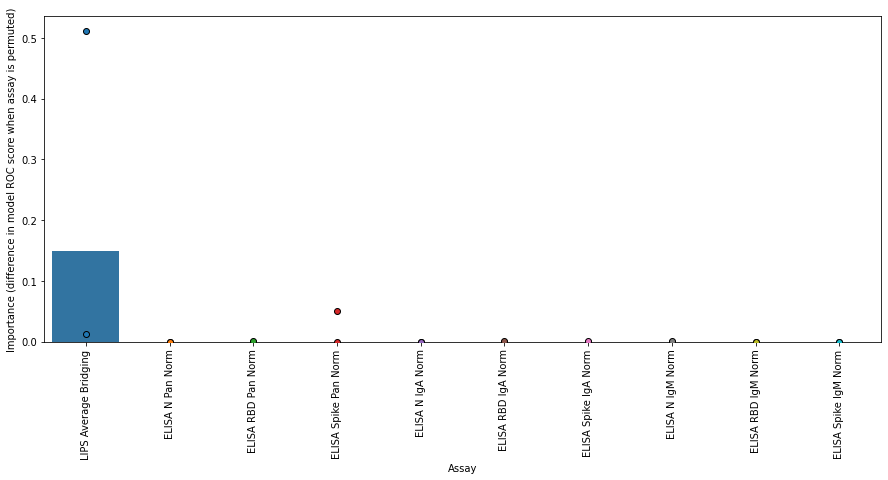

<Figure size 432x288 with 0 Axes>

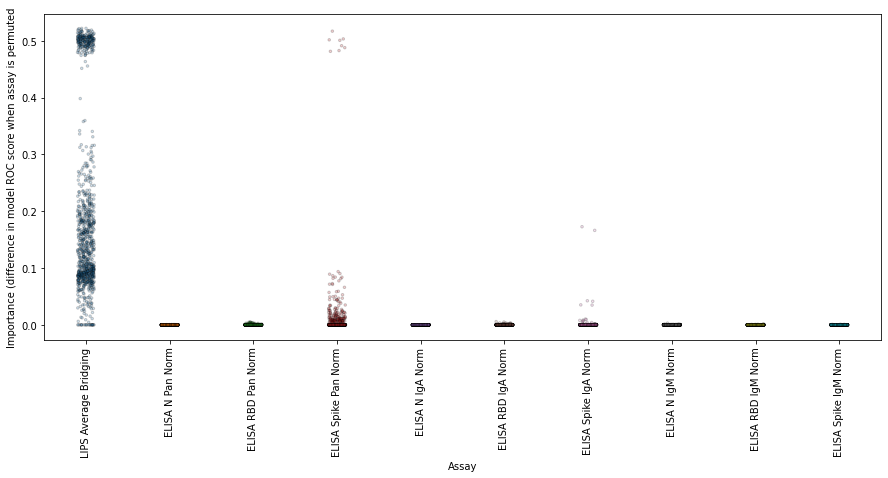

<Figure size 432x288 with 0 Axes>

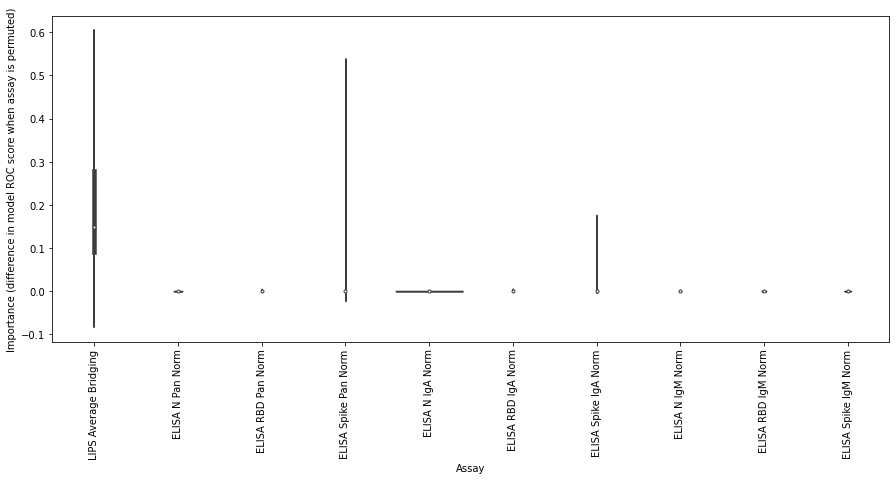

Balanced


<Figure size 432x288 with 0 Axes>

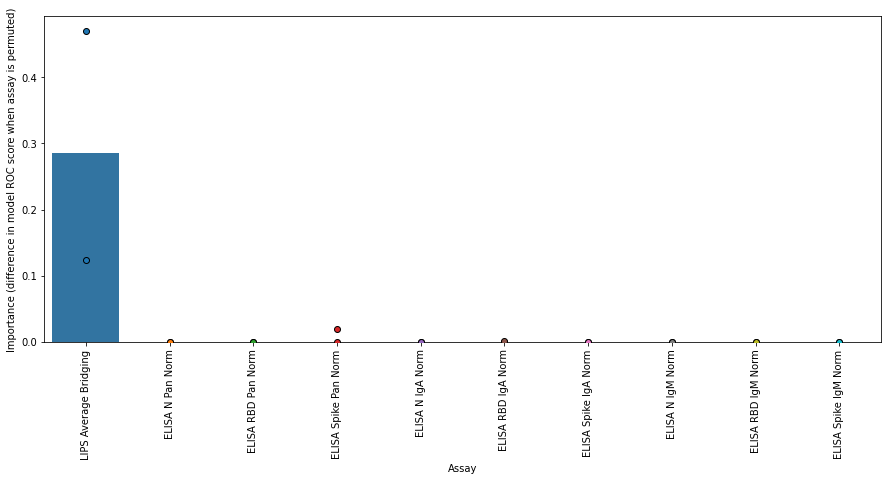

<Figure size 432x288 with 0 Axes>

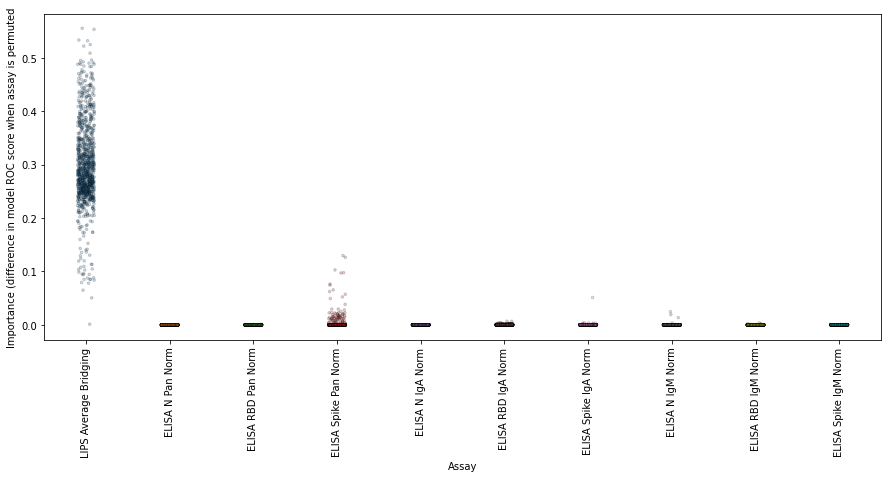

<Figure size 432x288 with 0 Axes>

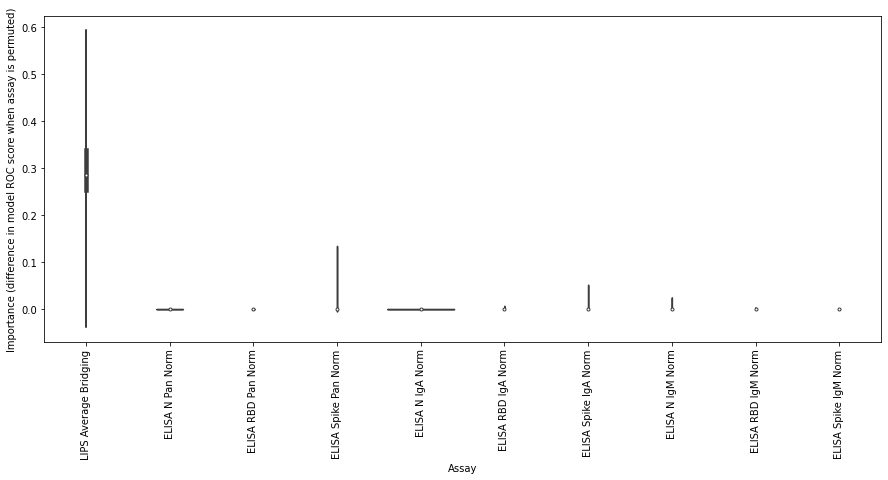




Validation
[0.9801317  0.97064176 0.96069578 0.9707996  0.97554543]
{'n_estimators': 10}
Unbalanced


<Figure size 432x288 with 0 Axes>

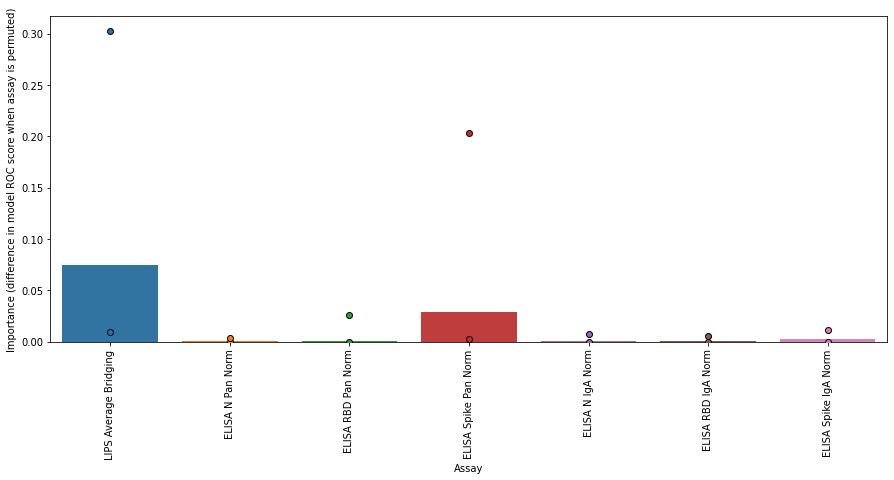

<Figure size 432x288 with 0 Axes>

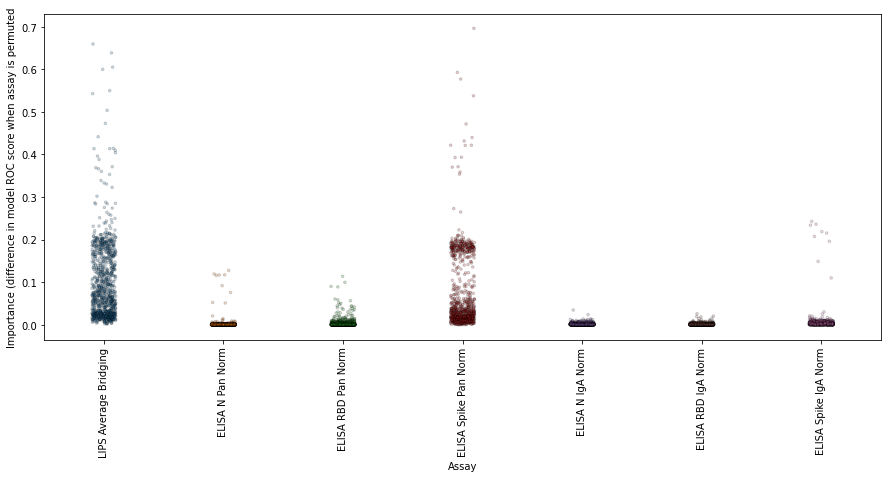

<Figure size 432x288 with 0 Axes>

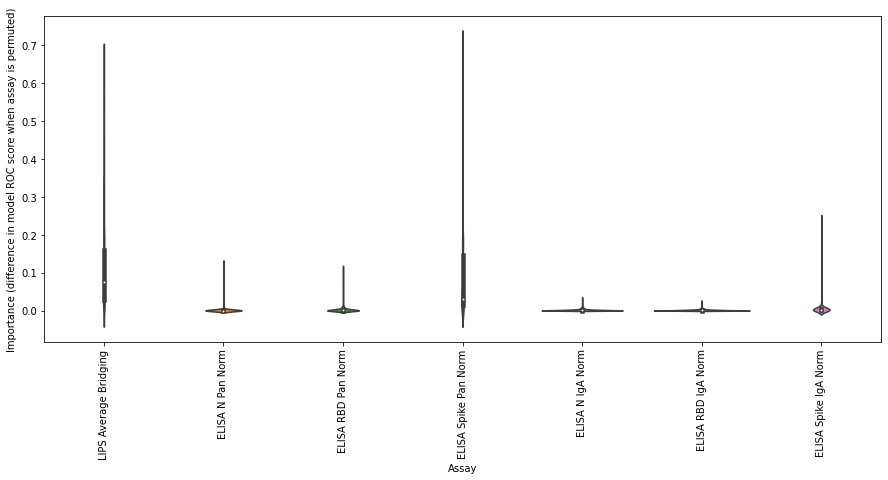

Balanced


<Figure size 432x288 with 0 Axes>

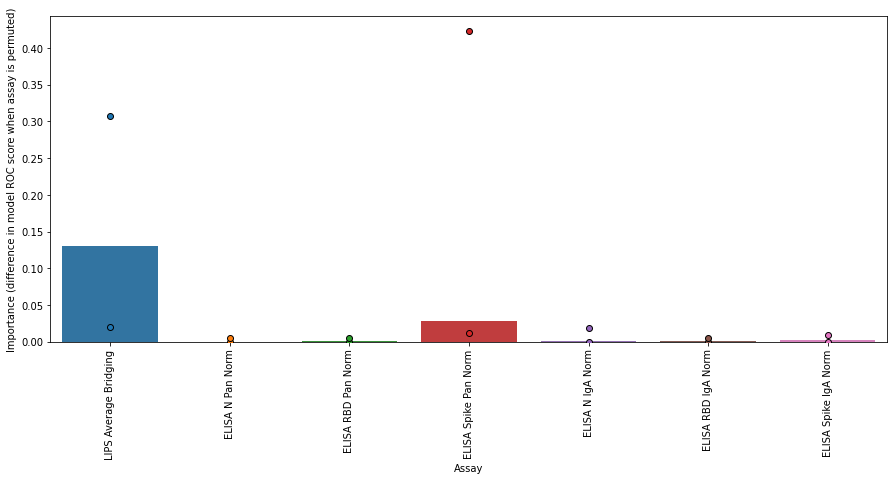

<Figure size 432x288 with 0 Axes>

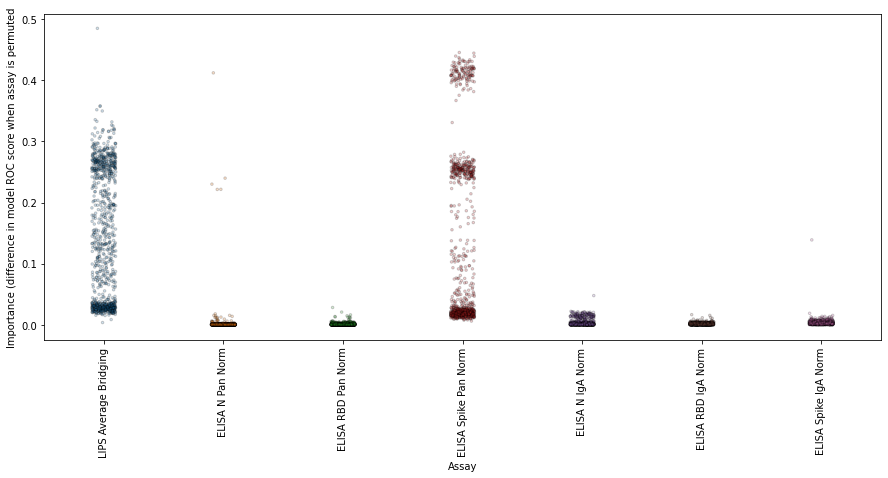

<Figure size 432x288 with 0 Axes>

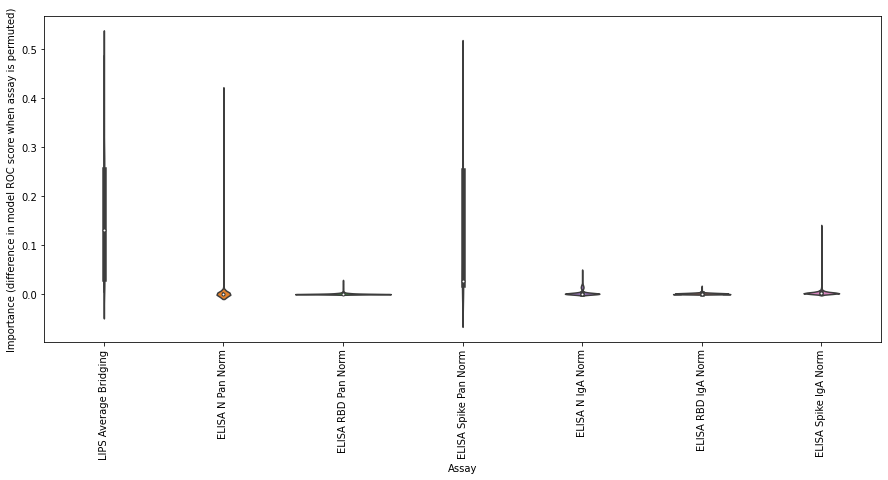




All data
[0.98029714 0.97814258 0.97366778 0.97819851 0.97620714]
{'n_estimators': 10}
Unbalanced


<Figure size 432x288 with 0 Axes>

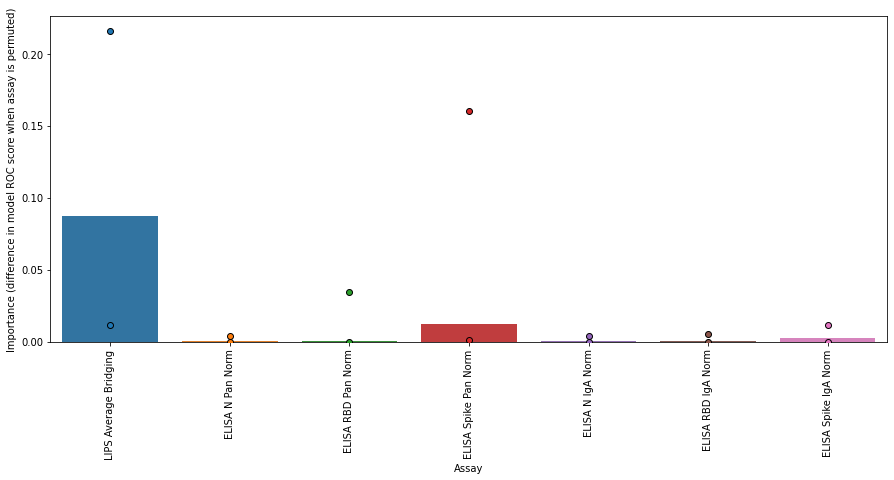

<Figure size 432x288 with 0 Axes>

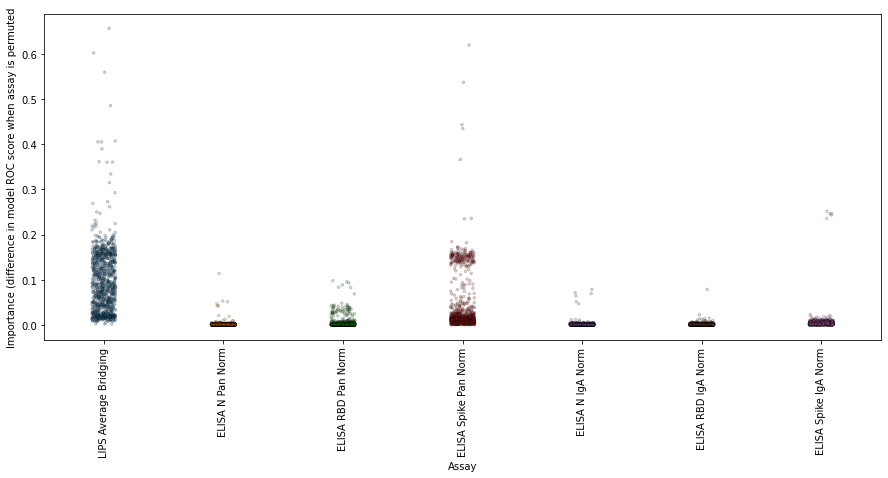

<Figure size 432x288 with 0 Axes>

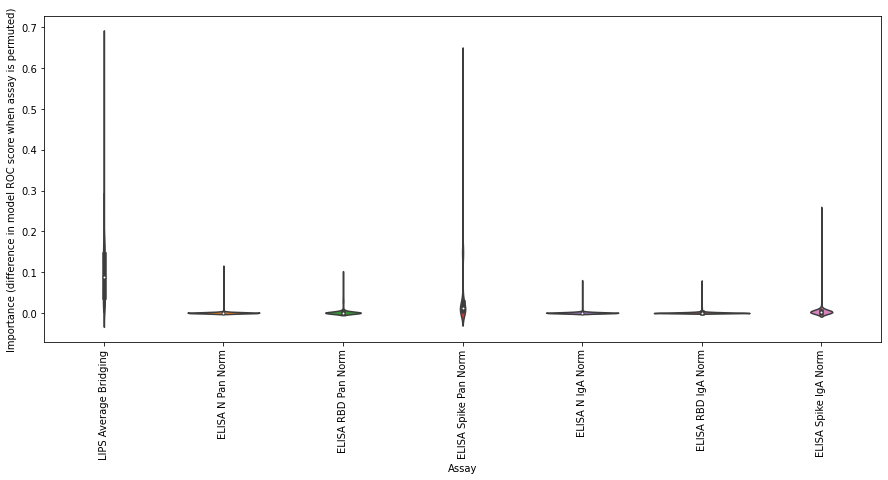

Balanced


<Figure size 432x288 with 0 Axes>

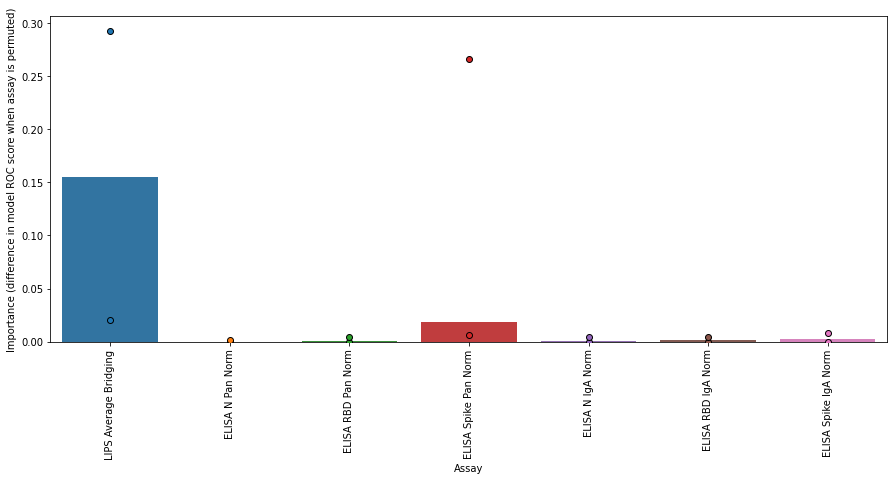

<Figure size 432x288 with 0 Axes>

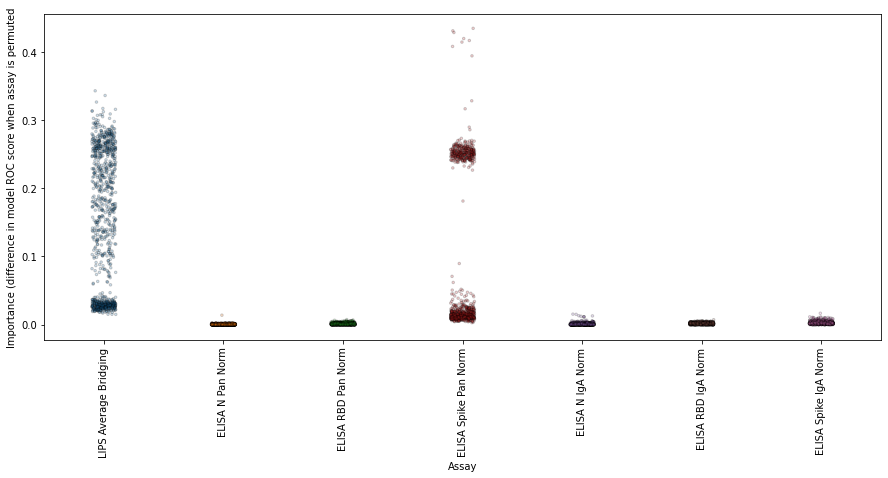

<Figure size 432x288 with 0 Axes>

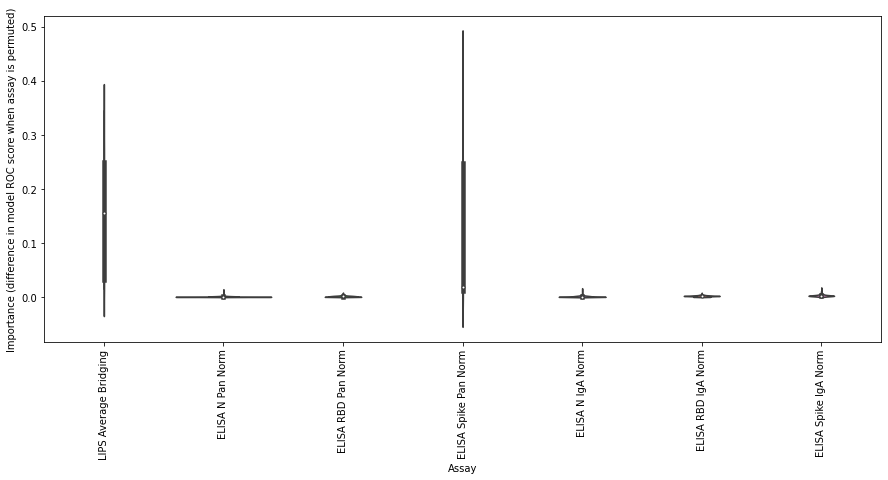

In [92]:
# In permutation feature importance, compare performance of trained model with all features and with one feature
# randomly scrambled => difference in performance = importance score for that feature
# Check that rebalancing the dataset doesn't affect the feature importance scores (since data imbalance will
# affect model training)

# AdaBoostClassifier

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    if label == 'Threshold':
        cols = thresh_upd_cont_cols
    else:
        cols = val_upd_cont_cols
        
    # Use grid search to determine optimal parameters to train model. To ensure the code runs in a reasonable
    # period of time, run gridsearch once for each dataset, rather than for each individual resampled and/or
    # rebalanced dataset - approx. optimal parameters for entire dataset should also work well for the resampled
    # and/or balanced datasets
    ml_x = copy.deepcopy(ml_x_dict[label])
    ml_y = copy.deepcopy(ml_y_dict[label])[['Status']]
    ml_y = [0 if ml_y['Status'][n] == 'Pre-pandemic' else 1 for n in range(ml_y.shape[0])]

    ada_boost = AdaBoostClassifier()
    parameters = {'n_estimators': [10, 30, 100, 300, 1000]}
    grid_search = GridSearchCV(
        estimator=ada_boost, param_grid=parameters, error_score=np.nan, scoring='roc_auc'
    )
    grid_search.fit(X=ml_x, y=ml_y)
    print(grid_search.cv_results_['mean_test_score'])
    print(grid_search.best_params_)

    for balance_method in ['unbalanced', 'balanced']:
        print(balance_method.capitalize())

        permutation_feature_importances = {}
        for col in cols:
            permutation_feature_importances[col] = ['']*1000

        for n in range(1000):
            ml_x = copy.deepcopy(ml_x_dict[label])
            ml_y = copy.deepcopy(ml_y_dict[label])[['Status']]
            ml_y['Status'] = [0 if ml_y['Status'][n] == 'Pre-pandemic' else 1 for n in range(ml_y.shape[0])]

            if balance_method == 'balanced':
                over = SMOTE(sampling_strategy=0.5)
                under = RandomUnderSampler(sampling_strategy=1)
                steps = [('o', over), ('u', under)]
                pipeline = Pipeline(steps=steps)
                ml_x, ml_y = pipeline.fit_resample(ml_x, ml_y['Status'].tolist())
            else:
                random_rows = []
                for m in range(ml_x.shape[0]):
                    random_rows.append(random.randint(0, ml_x.shape[0]-1))
                ml_x = ml_x.iloc[random_rows].reset_index(drop=True)
                ml_y = ml_y.iloc[random_rows].reset_index(drop=True)['Status'].tolist()

            # Train model (on all data) with optimal parameters, determine which features are making the
            # greatest contribution to model performance
            ada_boost = AdaBoostClassifier(**grid_search.best_params_)
            ada_boost.fit(ml_x, ml_y)
            results = permutation_importance(ada_boost, ml_x, ml_y, scoring='roc_auc', n_jobs=-1)  # Selected
            # roc_auc because dataset is imbalanced
            importances = results.importances_mean
            for col, importance in enumerate(importances):
                col = ml_x.columns[col]
                permutation_feature_importances[col][n] = importance

        cols_all = []
        permutation_all = []
        permutation_median = []
        permutation_lower_conf_limit = []
        permutation_upper_conf_limit = []
        for col, importances in permutation_feature_importances.items():
            permutation_median.append(np.median(importances))
            permutation_lower_conf_limit.append(np.percentile(importances, 2.5))
            permutation_upper_conf_limit.append(np.percentile(importances, 97.5))
            for importance in importances:
                cols_all.append(col)
                permutation_all.append(importance)
        
        plt.clf()
        plt.figure(figsize=(15,6))
        sns.barplot(x=cols, y=permutation_median)
        sns.stripplot(x=cols, y=permutation_lower_conf_limit, edgecolor='k', linewidth=1, s=6, jitter=False)
        sns.stripplot(x=cols, y=permutation_upper_conf_limit, edgecolor='k', linewidth=1, s=6, jitter=False)
        plt.xticks(np.arange(len(cols)), cols, rotation='vertical')
        plt.xlabel('Assay')
        plt.ylabel('Importance (difference in model ROC score when assay is permuted)')
        if label == 'All data':
            plt.savefig('All_data_AdaBoost_{}_permutation_importance_barplot.svg'.format(balance_method))
        plt.show()

        plt.clf()
        plt.figure(figsize=(15,6))
        sns.stripplot(x=cols_all, y=permutation_all, edgecolor='k', linewidth=1, size=2.5, alpha=0.2)
        plt.xticks(np.arange(len(cols)), cols, rotation='vertical')
        plt.xlabel('Assay')
        plt.ylabel('Importance (difference in model ROC score when assay is permuted')
        if label == 'All data':
            plt.savefig('All_data_AdaBoost_{}_permutation_importance_stripplot.svg'.format(balance_method))
        plt.show()

        plt.clf()
        plt.figure(figsize=(15,6))
        sns.violinplot(x=cols_all, y=permutation_all)
        plt.xticks(np.arange(len(cols)), cols, rotation='vertical')
        plt.xlabel('Assay')
        plt.ylabel('Importance (difference in model ROC score when assay is permuted)')
        plt.show()

- Threshold dataset

In the case of the threshold dataset, randomly permuting the LIPS scores leads to a large change in ROC_AUC score, whereas randomly permuting any of the other features typically has a negligible effect. This effect is observed in both the unbalanced and balanced datasets.

- Validation dataset

In the case of the validation dataset, the LIPS dataset remains the assay whose permutation has the largest effect upon model performance. However, permutation of the ELISA Spike PanIg assay in this case also has a substantial effect upon model performance. Balancing the dataset doesn't have much of an effect upon the importance scores.

- Summary

Consequently, this analysis suggests that of the assays, the LIPS and Spike PanIg are the two assays that provide the most information that is not captured by the other assays.

(Is the (small) difference in assay importances between threshold and validation datasets because validation dataset is larger => more examples of tricky cases where the LIPS assay can't distinguish the category but the ELISA Spike PanIg assay does a better job?)




Threshold
[0.9861075  0.99443002 0.9965821  0.99506293 0.99522116 0.98354385
 0.9962972  0.99563273 0.98506302 0.99443002 0.99563273 0.99499982
 0.9824047  0.9957274  0.99594919 0.99563273 0.9805213  0.99348065
 0.99534783 0.99439846 0.99636076 0.99471492 0.99591763 0.99503138
 0.98281628 0.98911338 0.99499982 0.99468336 0.99637564 0.99503138
 0.99278463 0.99471492 0.99664521 0.99449313 0.99310109 0.993734
 0.99243617 0.99623409 0.99534783 0.99313264 0.99246817 0.99620253
 0.99525316 0.99525316 0.99370244 0.9971519  0.99588608 0.99588608
 0.99243617 0.99556962 0.99525316 0.99588608 0.99462025 0.9943038
 0.99462025 0.99588608 0.9951053  0.9943038  0.99493671 0.99588608
 0.99082188 0.99313895 0.99495023 0.99557954 0.98830647 0.99212918
 0.99500974 0.99583288 0.99029265 0.99551282 0.99552364 0.99526308
 0.99428847 0.99730968 0.99586444 0.99529824 0.99433265 0.99666414
 0.99361409 0.99614573]
{'min_samples_leaf': 50, 'min_samples_split': 50, 'n_estimators': 30, 'n_jobs': -1}
Unbalanced


<Figure size 432x288 with 0 Axes>

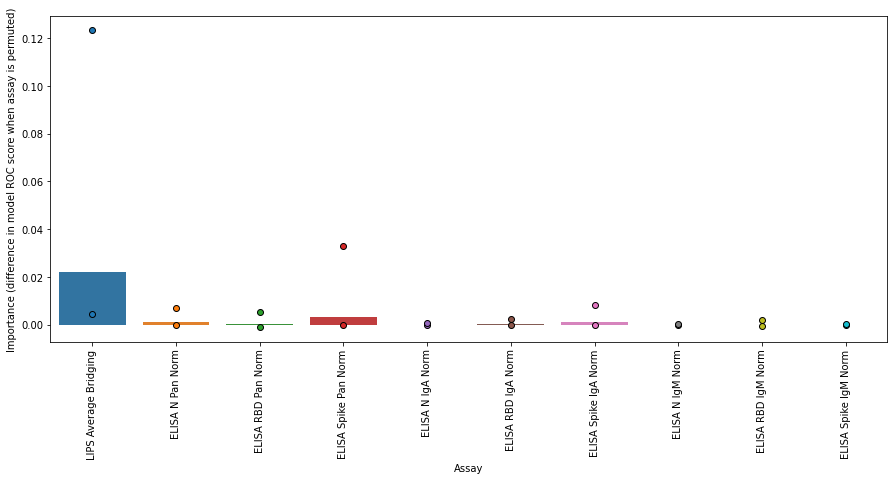

<Figure size 432x288 with 0 Axes>

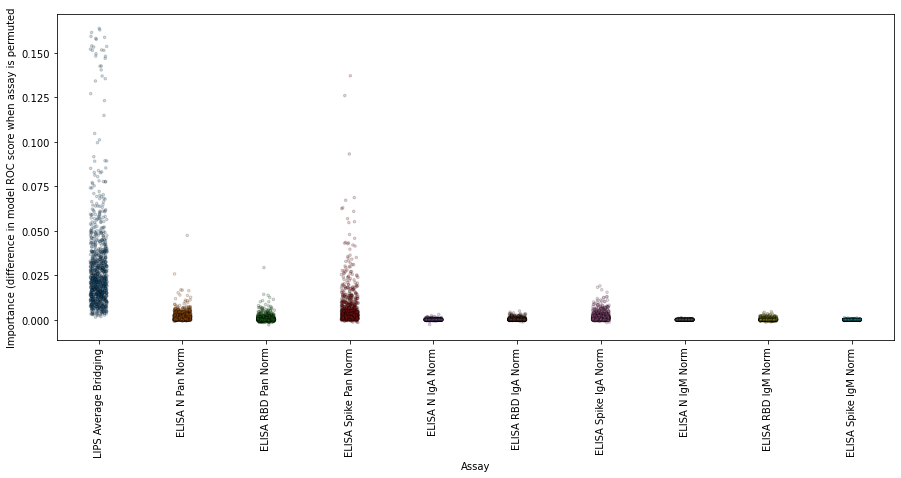

<Figure size 432x288 with 0 Axes>

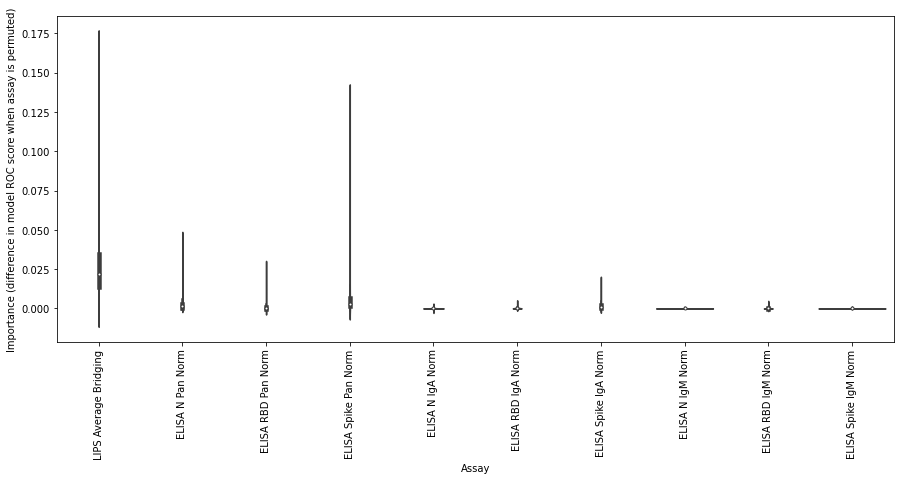

Balanced


<Figure size 432x288 with 0 Axes>

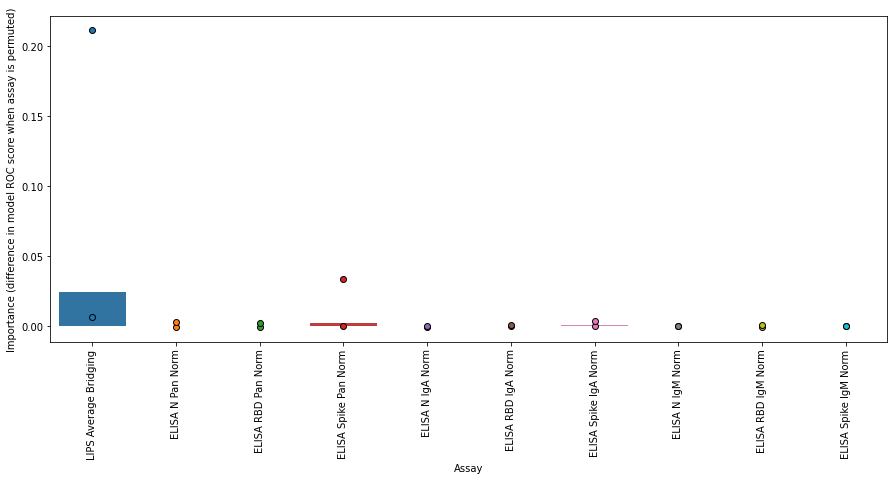

<Figure size 432x288 with 0 Axes>

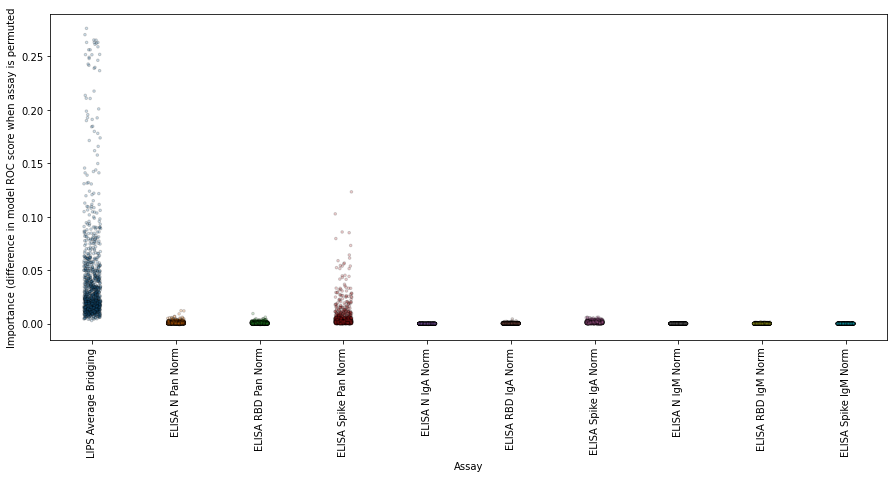

<Figure size 432x288 with 0 Axes>

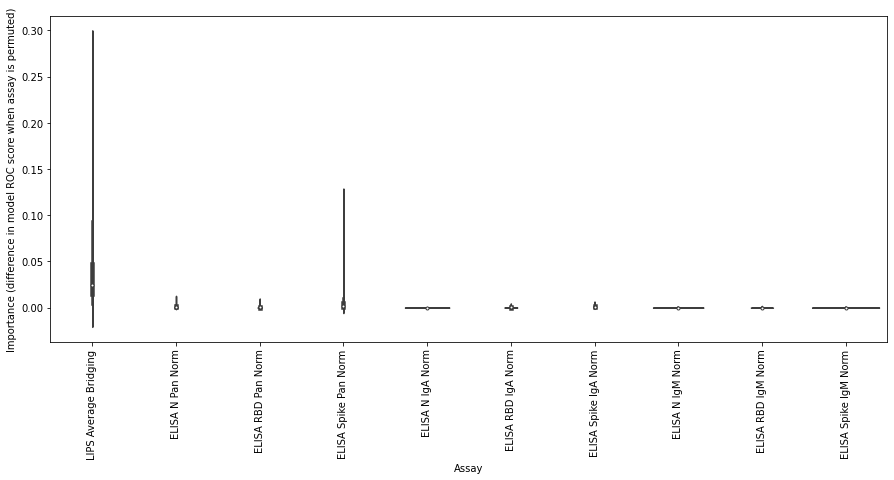




Validation
[0.98289474 0.991402   0.99060799 0.99165154 0.98700091 0.98788566
 0.98965517 0.99242287 0.99033575 0.98988203 0.99260436 0.9923775
 0.98970054 0.98942831 0.989451   0.99137931 0.98571983 0.98491379
 0.98845281 0.98843013 0.98824864 0.9899274  0.99119782 0.9904265
 0.98836207 0.98924682 0.99010889 0.99024501 0.98736388 0.99083485
 0.98997278 0.9907441  0.98926951 0.98532214 0.9899274  0.98947368
 0.98264519 0.98904265 0.98802178 0.98856624 0.98566398 0.97990018
 0.98298548 0.98470962 0.98364338 0.98135209 0.98316697 0.98489111
 0.98464156 0.98470962 0.98407441 0.98511797 0.98271635 0.98241833
 0.9834392  0.98511797 0.98049079 0.98080801 0.98371143 0.98466425
 0.97303    0.97366152 0.97824449 0.97704174 0.97860708 0.97540835
 0.97754083 0.97849365 0.97246673 0.97686064 0.976951   0.97799456
 0.97751815 0.97602087 0.97770002 0.97708711 0.97384359 0.97788151
 0.97561252 0.97640653]
{'min_samples_leaf': 5, 'min_samples_split': 25, 'n_estimators': 100, 'n_jobs': -1}
Unbalance

<Figure size 432x288 with 0 Axes>

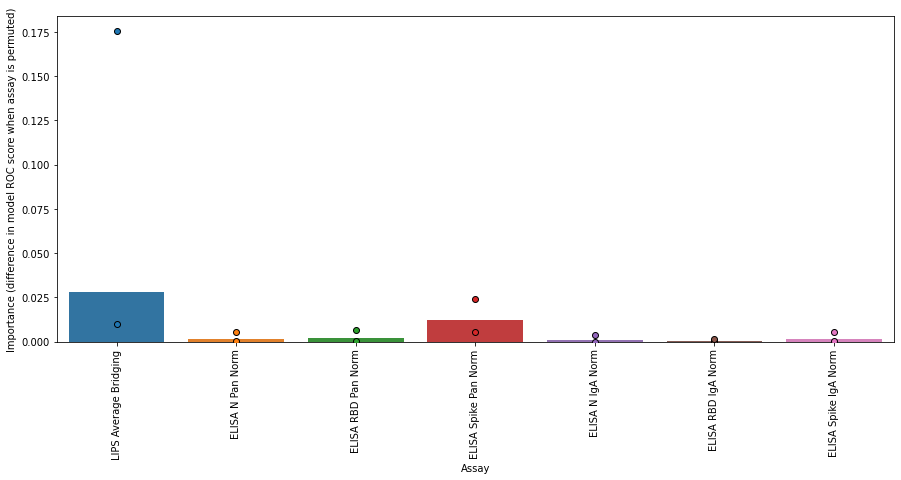

<Figure size 432x288 with 0 Axes>

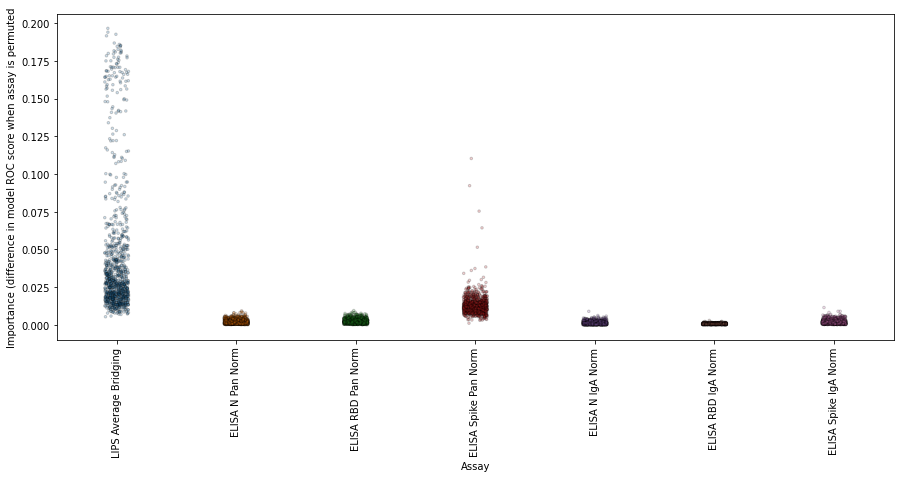

<Figure size 432x288 with 0 Axes>

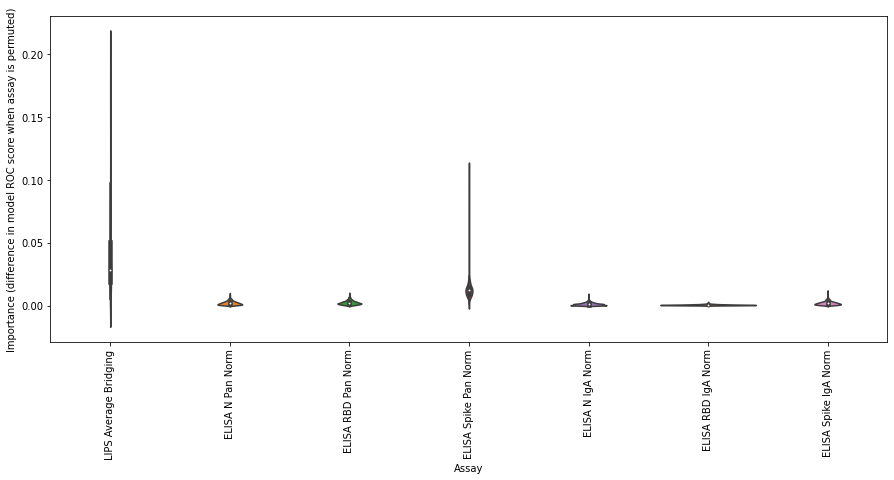

Balanced


<Figure size 432x288 with 0 Axes>

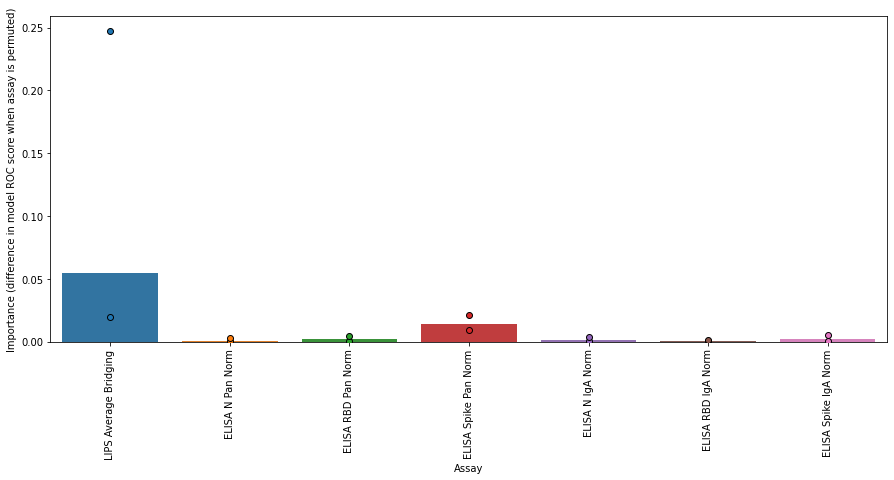

<Figure size 432x288 with 0 Axes>

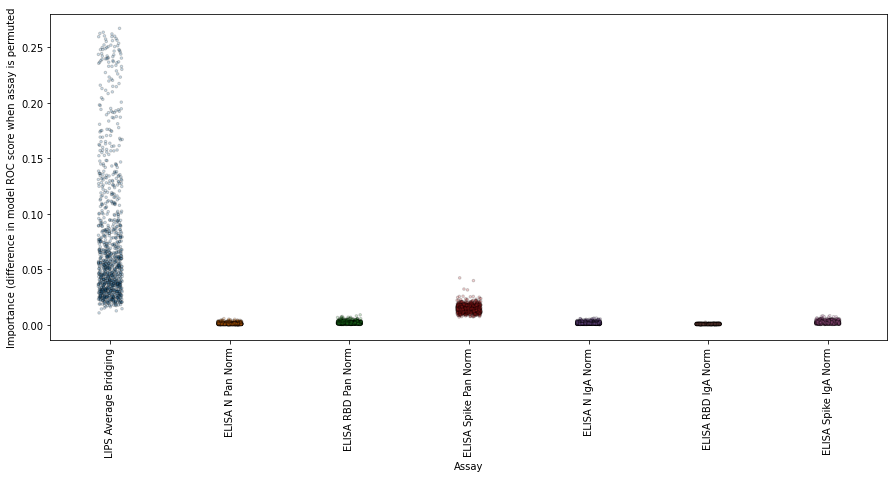

<Figure size 432x288 with 0 Axes>

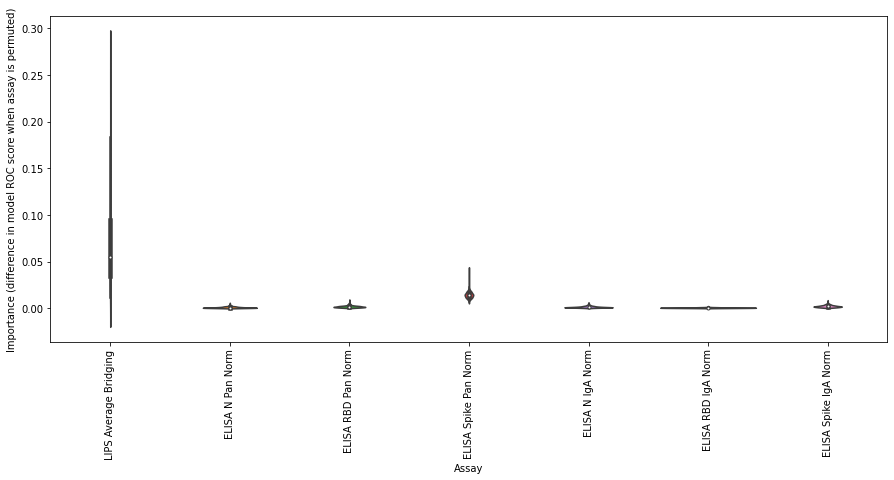




All data
[0.98736443 0.98214293 0.98639038 0.98803456 0.98151837 0.98716582
 0.98933781 0.98819497 0.97700359 0.98354688 0.98529037 0.98835149
 0.98737968 0.98826061 0.98679473 0.98738089 0.98423141 0.98272894
 0.98491487 0.98604699 0.98652616 0.98491407 0.98712397 0.9875764
 0.98471359 0.98597864 0.98507095 0.98810499 0.98550765 0.98417046
 0.98868951 0.98763683 0.98533405 0.98773458 0.98722559 0.98744193
 0.98522368 0.98588099 0.98701761 0.98645301 0.9805948  0.98345275
 0.9839043  0.98352121 0.98186484 0.9846516  0.98402813 0.98325917
 0.98249469 0.98428904 0.98359214 0.98335193 0.9812458  0.98276114
 0.98280346 0.983445   0.98241572 0.98036687 0.98262028 0.98387716
 0.97807248 0.98318966 0.97926574 0.9791302  0.98085196 0.97760936
 0.9784102  0.97899865 0.98156971 0.98051271 0.97886807 0.97937462
 0.98433788 0.97849598 0.9797202  0.9790404  0.98312792 0.98101048
 0.98088442 0.97807656]
{'min_samples_leaf': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1}
Unbalanced

<Figure size 432x288 with 0 Axes>

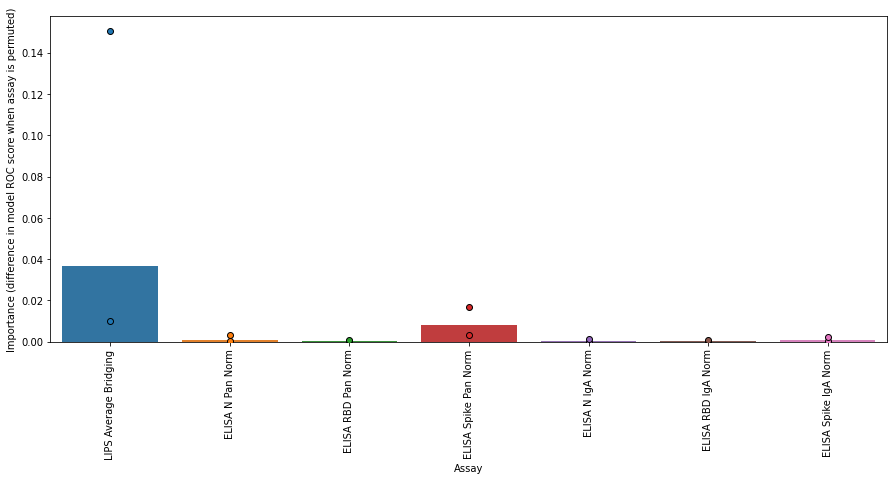

<Figure size 432x288 with 0 Axes>

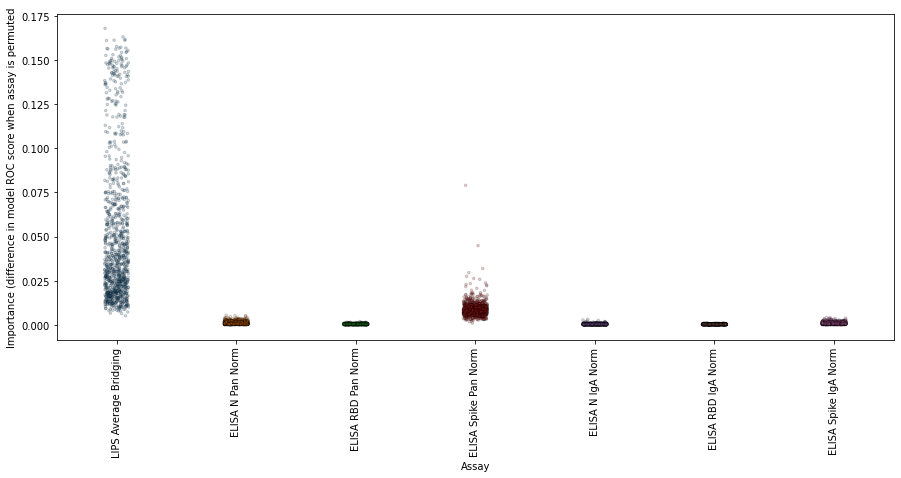

<Figure size 432x288 with 0 Axes>

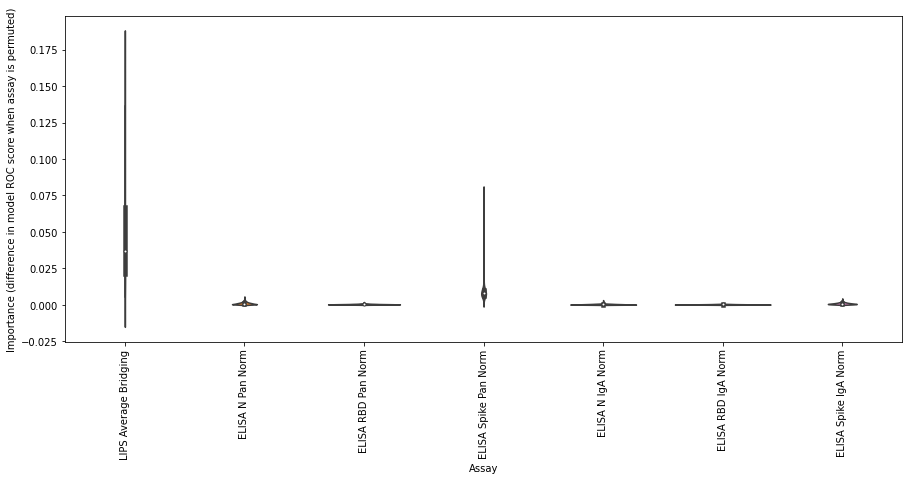

Balanced


<Figure size 432x288 with 0 Axes>

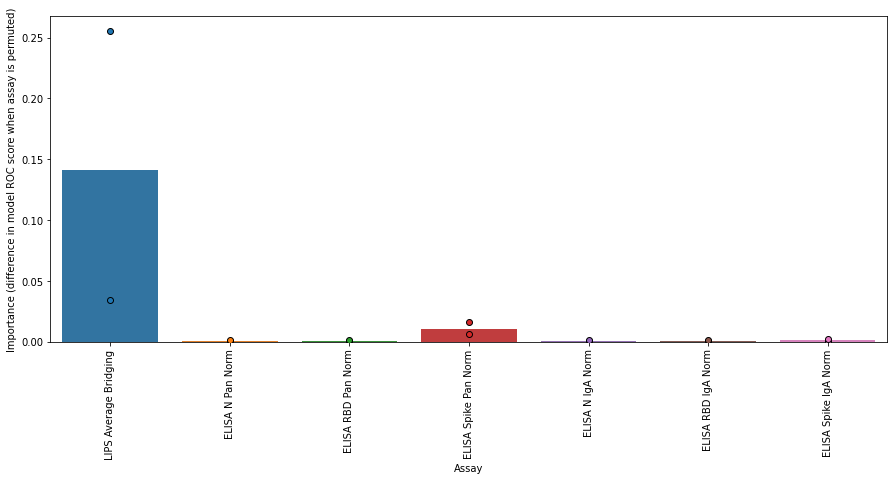

<Figure size 432x288 with 0 Axes>

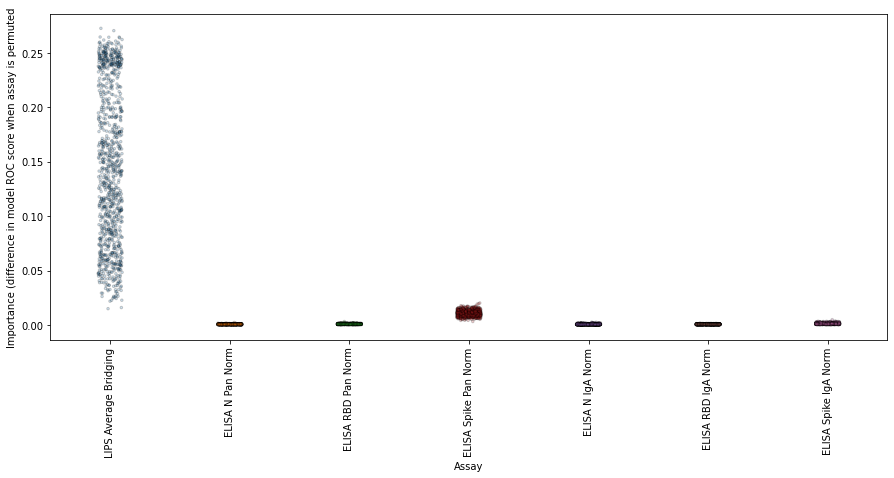

<Figure size 432x288 with 0 Axes>

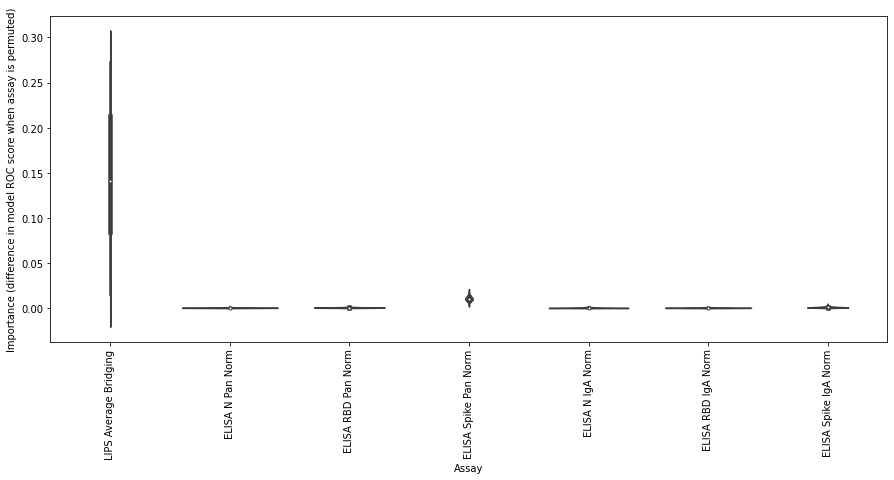

In [93]:
# In permutation feature importance, compare performance of trained model with all features and with one feature
# randomly scrambled => difference in performance = importance score for that feature
# Check that rebalancing the dataset doesn't affect the feature importance scores (since data imbalance will
# affect model training)

# RandomForestClassifier

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    if label == 'Threshold':
        cols = thresh_upd_cont_cols
    else:
        cols = val_upd_cont_cols
        
    # Use grid search to determine optimal parameters to train model. To ensure the code runs in a reasonable
    # period of time, run gridsearch once for each dataset, rather than for each individual resampled and/or
    # rebalanced dataset - approx. optimal parameters for entire dataset should also work well for the resampled
    # and/or balanced datasets
    ml_x = copy.deepcopy(ml_x_dict[label])
    ml_y = copy.deepcopy(ml_y_dict[label])[['Status']]
    ml_y = [0 if ml_y['Status'][n] == 'Pre-pandemic' else 1 for n in range(ml_y.shape[0])]

    random_forest = RandomForestClassifier(n_jobs=-1)
    parameters = {'n_estimators': [10, 30, 100, 300],
                  'min_samples_split': [5, 10, 25, 50, 100],
                  'min_samples_leaf': [5, 10, 25, 50],
                  'n_jobs': [-1]}
    grid_search = GridSearchCV(
        estimator=random_forest, param_grid=parameters, error_score=np.nan, scoring='roc_auc'
    )
    grid_search.fit(X=ml_x, y=ml_y)
    print(grid_search.cv_results_['mean_test_score'])
    print(grid_search.best_params_)

    for balance_method in ['unbalanced', 'balanced']:
        print(balance_method.capitalize())

        permutation_feature_importances = {}
        for col in cols:
            permutation_feature_importances[col] = ['']*1000

        for n in range(1000):
            ml_x = copy.deepcopy(ml_x_dict[label])
            ml_y = copy.deepcopy(ml_y_dict[label])[['Status']]
            ml_y['Status'] = [0 if ml_y['Status'][n] == 'Pre-pandemic' else 1 for n in range(ml_y.shape[0])]

            if balance_method == 'balanced':
                over = SMOTE(sampling_strategy=0.5)
                under = RandomUnderSampler(sampling_strategy=1)
                steps = [('o', over), ('u', under)]
                pipeline = Pipeline(steps=steps)
                ml_x, ml_y = pipeline.fit_resample(ml_x, ml_y['Status'].tolist())
            else:
                random_rows = []
                for m in range(ml_x.shape[0]):
                    random_rows.append(random.randint(0, ml_x.shape[0]-1))
                ml_x = ml_x.iloc[random_rows].reset_index(drop=True)
                ml_y = ml_y.iloc[random_rows].reset_index(drop=True)['Status'].tolist()

            # Train model (on all data) with optimal parameters, determine which features are making the
            # greatest contribution to model performance
            random_forest = RandomForestClassifier(**grid_search.best_params_)
            random_forest.fit(ml_x, ml_y)
            results = permutation_importance(random_forest, ml_x, ml_y, scoring='roc_auc', n_jobs=-1)  # Selected
            # roc_auc because dataset is imbalanced
            importances = results.importances_mean
            for col, importance in enumerate(importances):
                col = ml_x.columns[col]
                permutation_feature_importances[col][n] = importance

        cols_all = []
        permutation_all = []
        permutation_median = []
        permutation_lower_conf_limit = []
        permutation_upper_conf_limit = []
        for col, importances in permutation_feature_importances.items():
            permutation_median.append(np.median(importances))
            permutation_lower_conf_limit.append(np.percentile(importances, 2.5))
            permutation_upper_conf_limit.append(np.percentile(importances, 97.5))
            for importance in importances:
                cols_all.append(col)
                permutation_all.append(importance)
        
        plt.clf()
        plt.figure(figsize=(15,6))
        sns.barplot(x=cols, y=permutation_median)
        sns.stripplot(x=cols, y=permutation_lower_conf_limit, edgecolor='k', linewidth=1, s=6, jitter=False)
        sns.stripplot(x=cols, y=permutation_upper_conf_limit, edgecolor='k', linewidth=1, s=6, jitter=False)
        plt.xticks(np.arange(len(cols)), cols, rotation='vertical')
        plt.xlabel('Assay')
        plt.ylabel('Importance (difference in model ROC score when assay is permuted)')
        if label == 'All data':
            plt.savefig('All_data_RandomForest_{}_permutation_importance_barplot.svg'.format(balance_method))
        plt.show()

        plt.clf()
        plt.figure(figsize=(15,6))
        sns.stripplot(x=cols_all, y=permutation_all, edgecolor='k', linewidth=1, size=2.5, alpha=0.2)
        plt.xticks(np.arange(len(cols)), cols, rotation='vertical')
        plt.xlabel('Assay')
        plt.ylabel('Importance (difference in model ROC score when assay is permuted')
        if label == 'All data':
            plt.savefig('All_data_RandomForest_{}_permutation_importance_stripplot.svg'.format(balance_method))
        plt.show()

        plt.clf()
        plt.figure(figsize=(15,6))
        sns.violinplot(x=cols_all, y=permutation_all)
        plt.xticks(np.arange(len(cols)), cols, rotation='vertical')
        plt.xlabel('Assay')
        plt.ylabel('Importance (difference in model ROC score when assay is permuted)')
        plt.show()

Observe fairly similar results for permutation analysis with a RandomForestClassifier as I did with AdaBoost algorithm (not especially surprising given that both are tree-based methods). Specifically, for both the threshold and validation datasets, the LIPS assay is found to be the most important, the ELISA Spike PanIg has a smaller importance score, whilst the importance scores of the other assays are typically negligible. Similar results are observed across the unbalanced and balanced datasets (except when compare the raw importance score values - they are quite a lot higher for the balanced datasets, which is likely an artefact of the balancing itself). So, like the AdaBoost results, the LIPS assay and the ELISA Spike PanIg assay are found to be the two most important assays.




Threshold
[0.98528436 0.97977659 0.97303545 0.97534711 0.97246745 0.9707265
 0.9707265 ]
{'C': 0.1, 'dual': False}
Unbalanced


<Figure size 432x288 with 0 Axes>

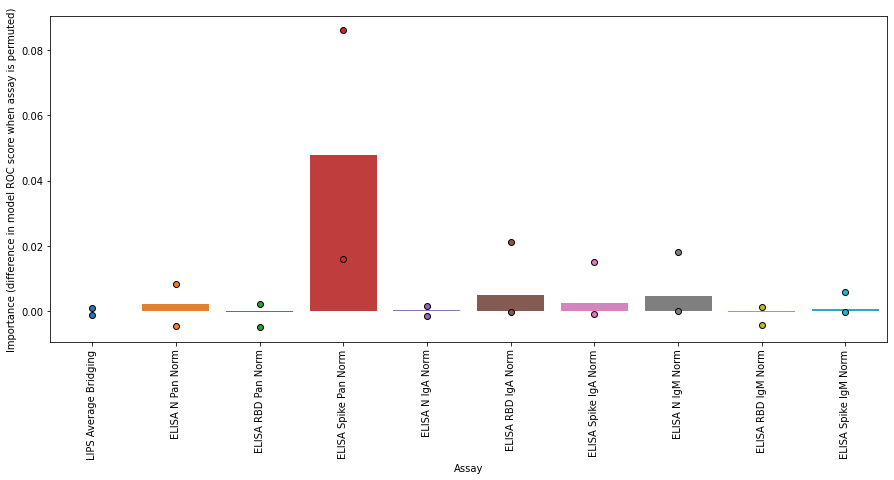

<Figure size 432x288 with 0 Axes>

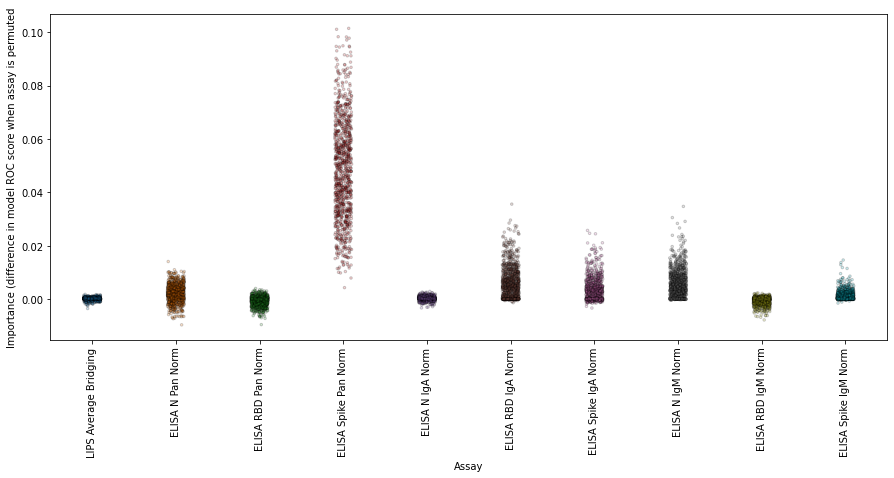

<Figure size 432x288 with 0 Axes>

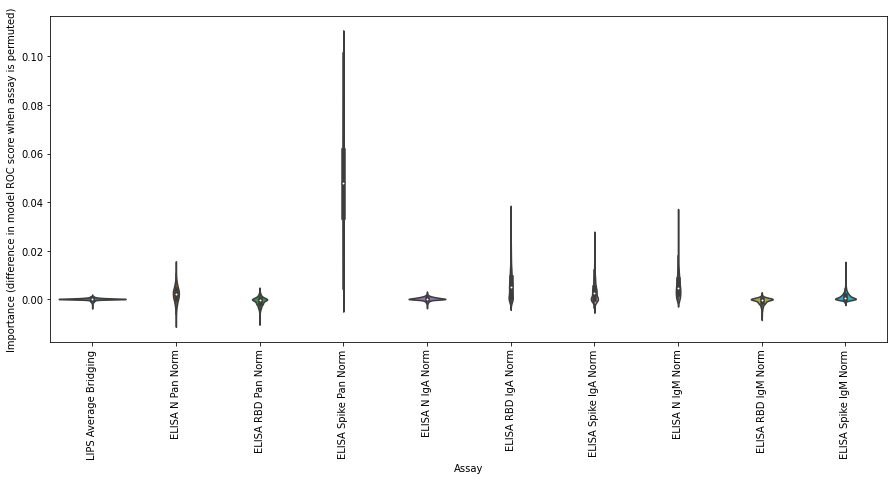

Balanced


<Figure size 432x288 with 0 Axes>

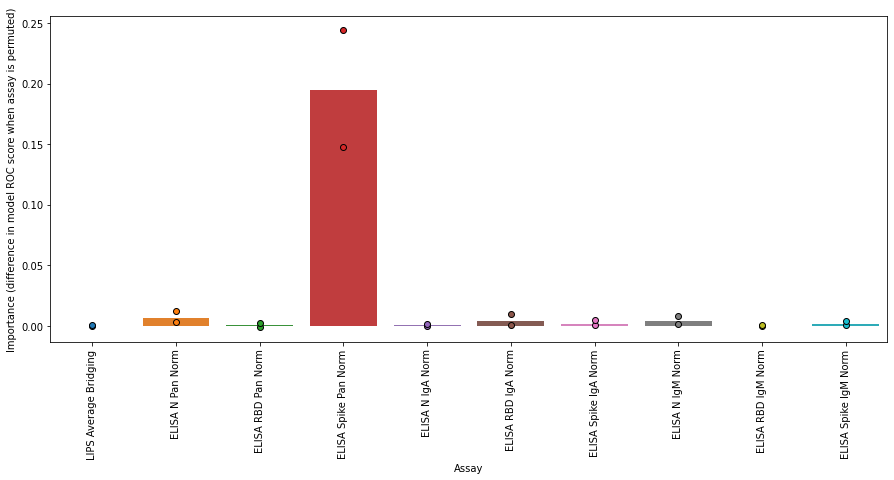

<Figure size 432x288 with 0 Axes>

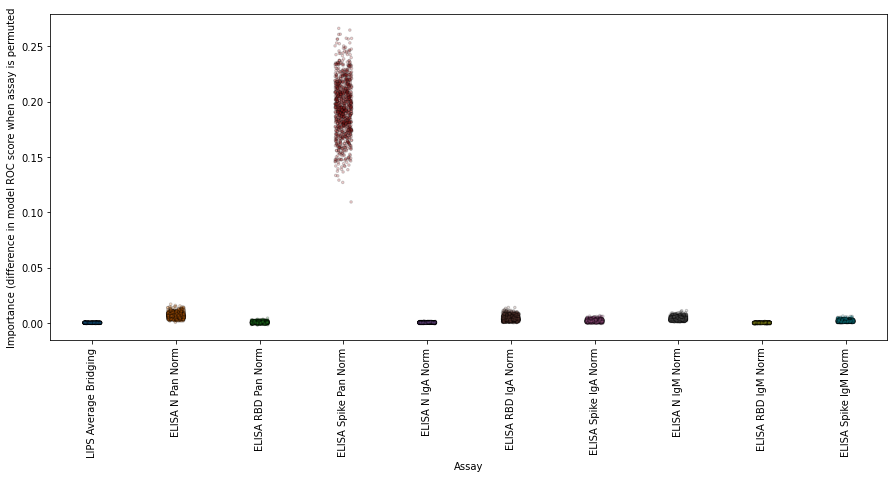

<Figure size 432x288 with 0 Axes>

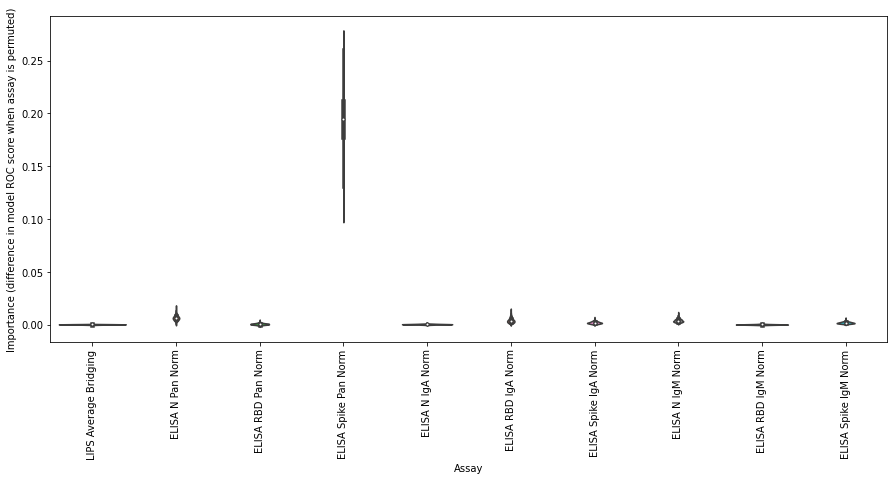




Validation
[0.95372051 0.95467332 0.95422425 0.95386438 0.95390975 0.95390975
 0.95390975]
{'C': 1.0, 'dual': False}
Unbalanced


<Figure size 432x288 with 0 Axes>

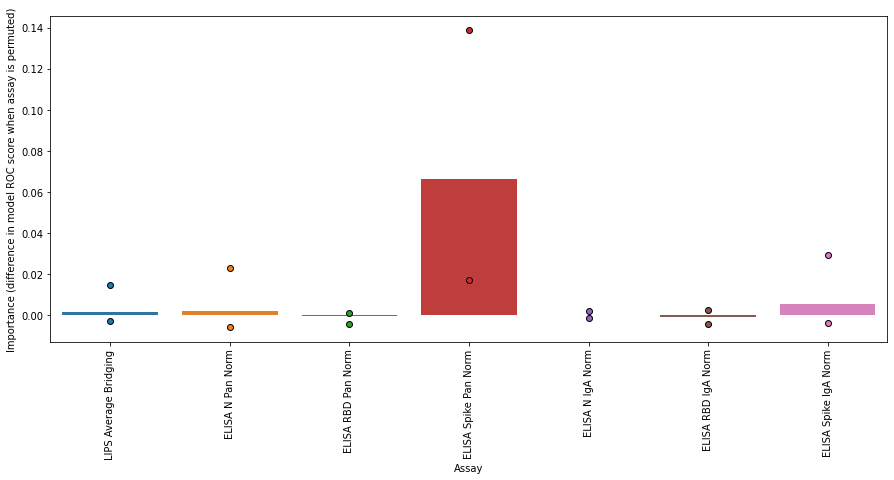

<Figure size 432x288 with 0 Axes>

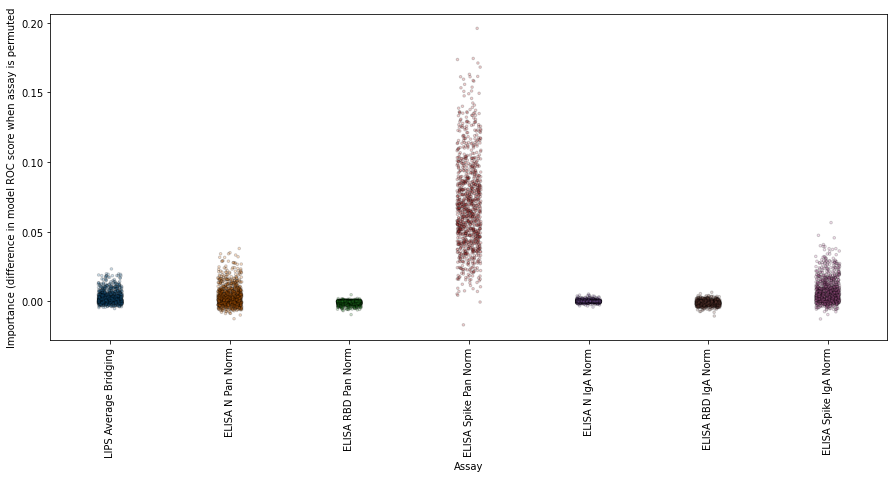

<Figure size 432x288 with 0 Axes>

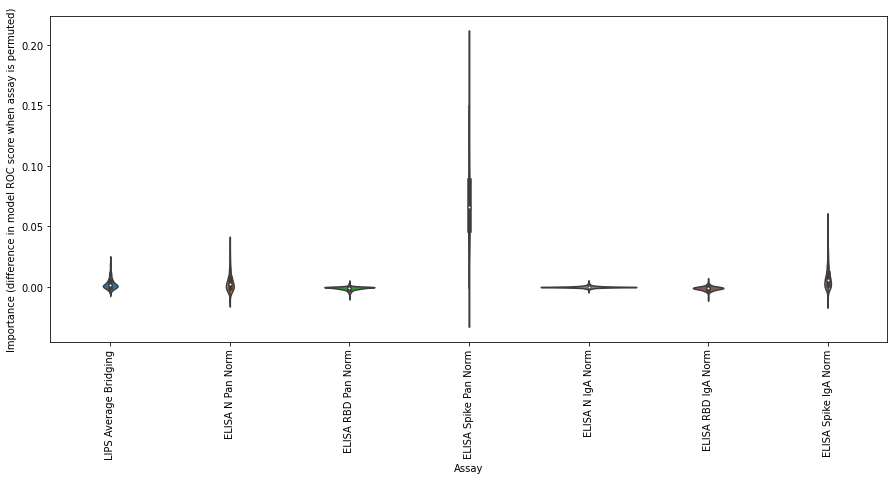

Balanced


<Figure size 432x288 with 0 Axes>

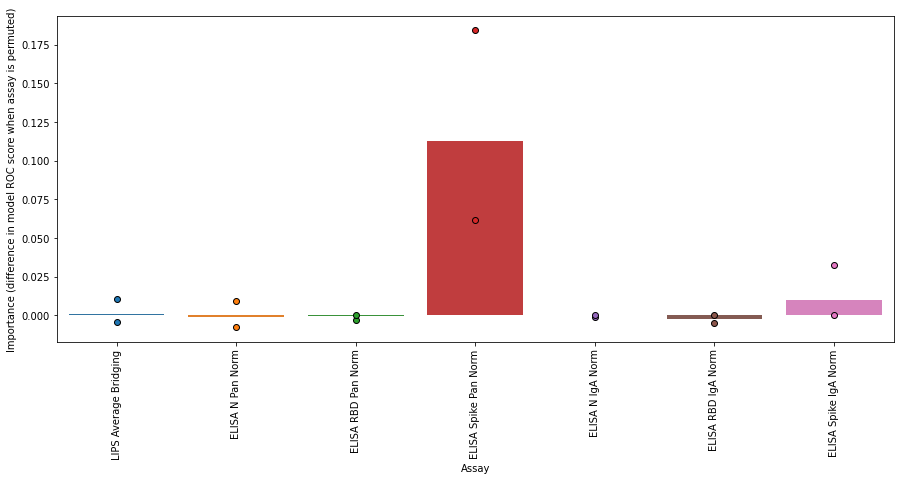

<Figure size 432x288 with 0 Axes>

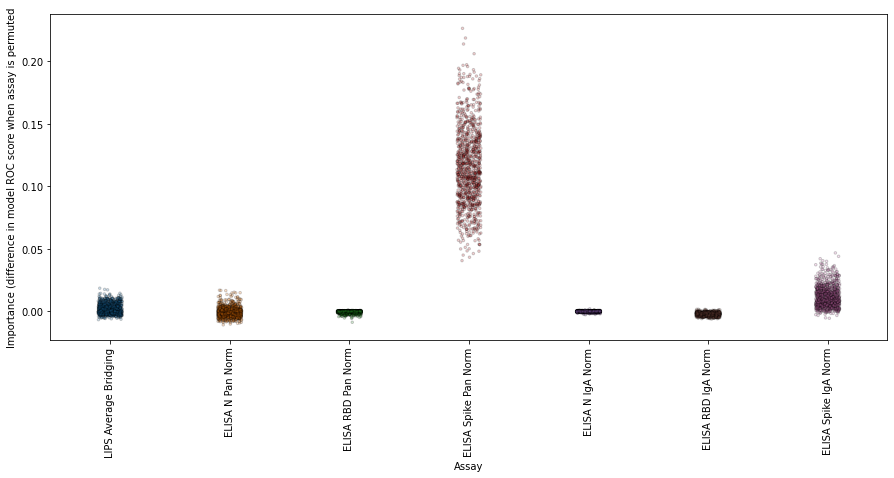

<Figure size 432x288 with 0 Axes>

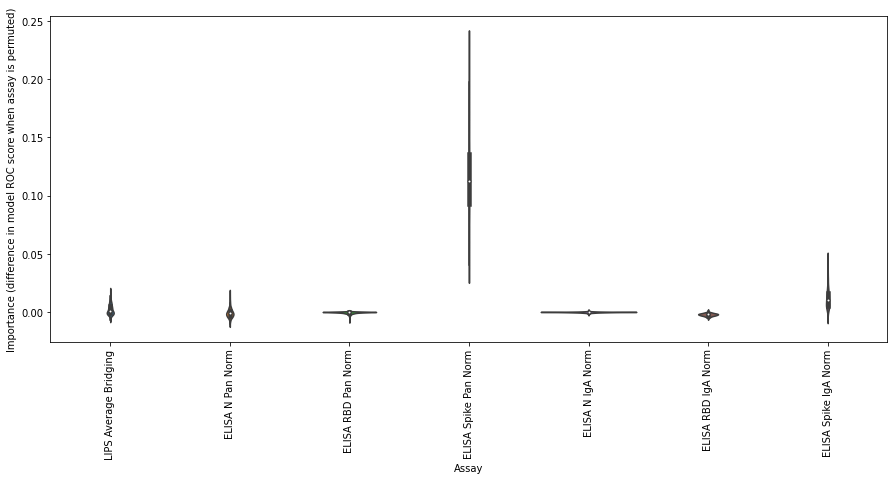




All data
[0.95645026 0.95520119 0.95482292 0.95471244 0.95500229 0.95555971
 0.95567119]
{'C': 0.1, 'dual': False}
Unbalanced


<Figure size 432x288 with 0 Axes>

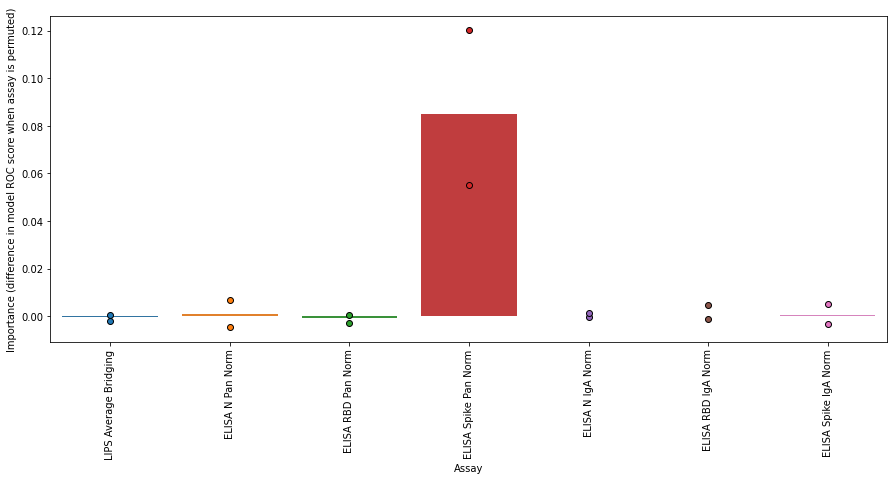

<Figure size 432x288 with 0 Axes>

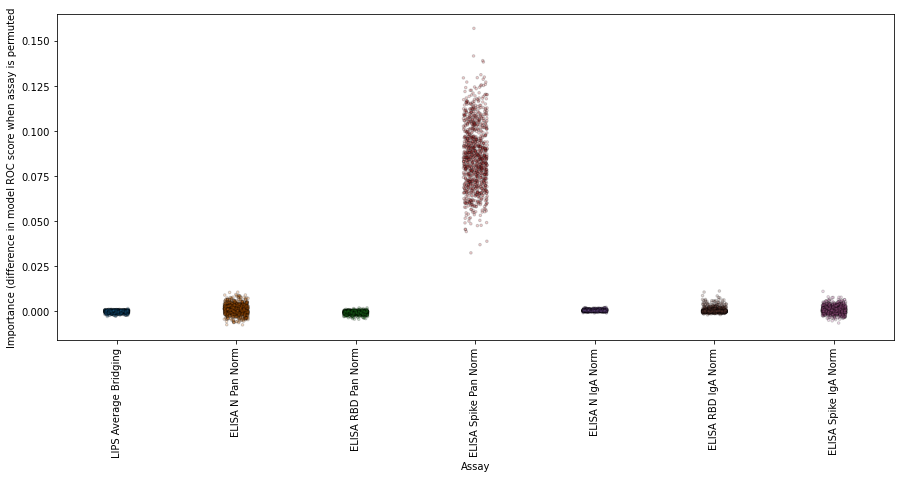

<Figure size 432x288 with 0 Axes>

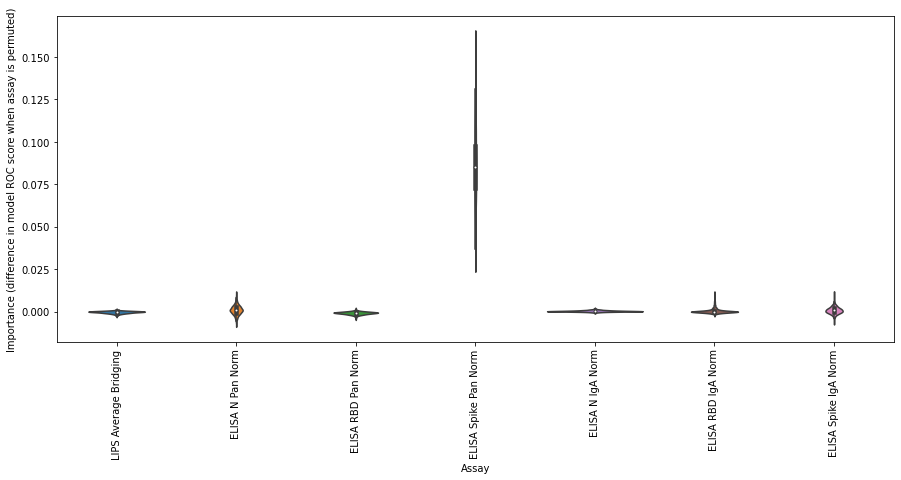

Balanced


<Figure size 432x288 with 0 Axes>

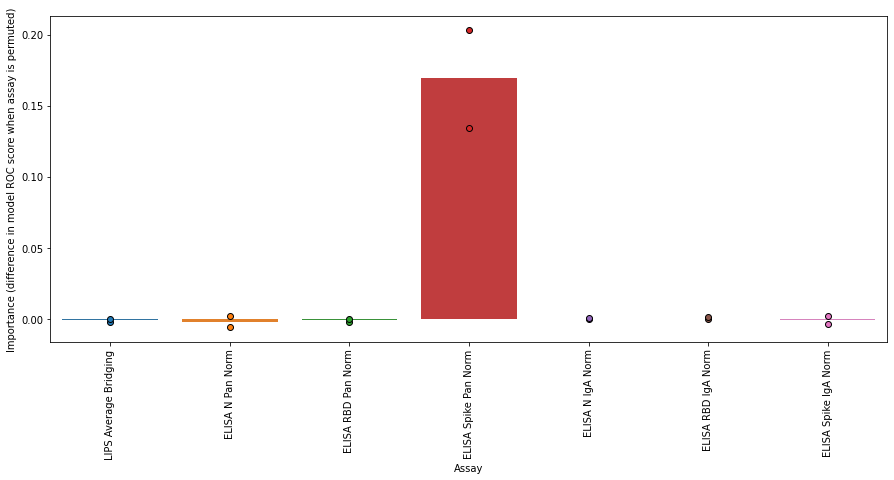

<Figure size 432x288 with 0 Axes>

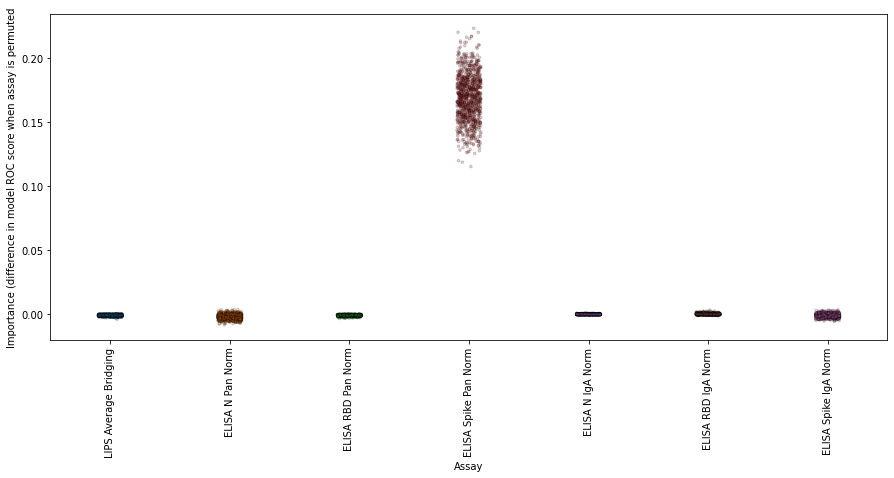

<Figure size 432x288 with 0 Axes>

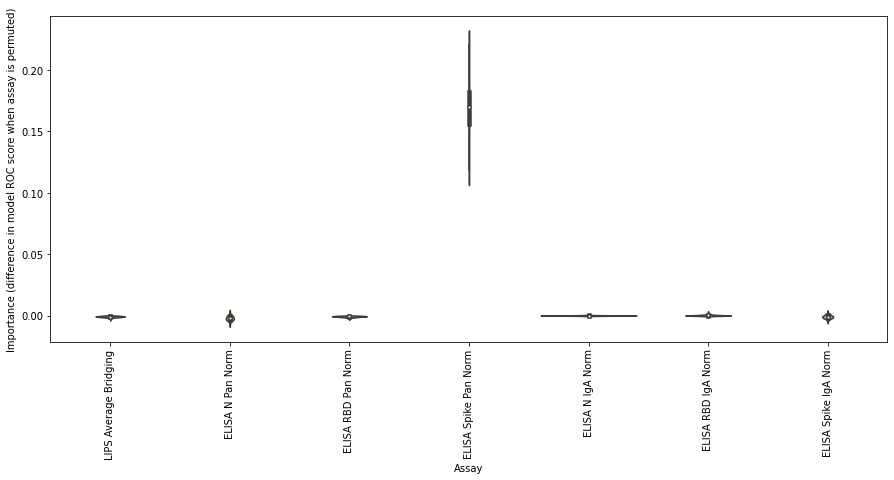

In [94]:
# In permutation feature importance, compare performance of trained model with all features and with one feature
# randomly scrambled => difference in performance = importance score for that feature

# SVM doesn't assume normality (provided don't use rbf kernel), but does assume independent and identically
# distributed data (i.e. patients are independent of each other (holds), and identically distributed (i.e. if
# we were to look at a different sample of patients, their distribution would match that of the current sample,
# in other words the samples are all drawn from the same underlying distribution))

# Note that SVM is deterministic => will get same result every time. However, permutation is random, plus
# bootstrapping/resampling of dataset => confidence limits

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    if label == 'Threshold':
        cols = thresh_upd_cont_cols
    else:
        cols = val_upd_cont_cols
        
    # Use grid search to determine optimal parameters to train model. To ensure the code runs in a reasonable
    # period of time, run gridsearch once for each dataset, rather than for each individual resampled and/or
    # rebalanced dataset - approx. optimal parameters for entire dataset should also work well for the resampled
    # and/or balanced datasets
    ml_x = copy.deepcopy(ml_x_dict[label])
    ml_y = copy.deepcopy(ml_y_dict[label])[['Status']]
    ml_y = [0 if ml_y['Status'][n] == 'Pre-pandemic' else 1 for n in range(ml_y.shape[0])]

    svc = LinearSVC()
    parameters = {'C': np.logspace(-1, 5, num=7, base=10),
                  'dual': [False]}
    grid_search = GridSearchCV(
        estimator=svc, param_grid=parameters, error_score=np.nan, scoring='roc_auc'
    )
    grid_search.fit(X=ml_x, y=ml_y)
    print(grid_search.cv_results_['mean_test_score'])
    print(grid_search.best_params_)

    for balance_method in ['unbalanced', 'balanced']:
        print(balance_method.capitalize())

        permutation_feature_importances = {}
        for col in cols:
            permutation_feature_importances[col] = ['']*1000

        for n in range(1000):
            ml_x = copy.deepcopy(ml_x_dict[label])
            ml_y = copy.deepcopy(ml_y_dict[label])[['Status']]
            ml_y['Status'] = [0 if ml_y['Status'][n] == 'Pre-pandemic' else 1 for n in range(ml_y.shape[0])]

            if balance_method == 'balanced':
                over = SMOTE(sampling_strategy=0.5)
                under = RandomUnderSampler(sampling_strategy=1)
                steps = [('o', over), ('u', under)]
                pipeline = Pipeline(steps=steps)
                ml_x, ml_y = pipeline.fit_resample(ml_x, ml_y['Status'].tolist())
            else:
                random_rows = []
                for m in range(ml_x.shape[0]):
                    random_rows.append(random.randint(0, ml_x.shape[0]-1))
                ml_x = ml_x.iloc[random_rows].reset_index(drop=True)
                ml_y = ml_y.iloc[random_rows].reset_index(drop=True)['Status'].tolist()

            # Train model (on all data) with optimal parameters, determine which features are making the
            # greatest contribution to model performance
            svc = LinearSVC(**grid_search.best_params_)
            svc.fit(ml_x, ml_y)
            results = permutation_importance(svc, ml_x, ml_y, scoring='roc_auc', n_jobs=-1)  # Selected
            # roc_auc because dataset is imbalanced
            importances = results.importances_mean
            for col, importance in enumerate(importances):
                col = ml_x.columns[col]
                permutation_feature_importances[col][n] = importance

        cols_all = []
        permutation_all = []
        permutation_median = []
        permutation_lower_conf_limit = []
        permutation_upper_conf_limit = []
        for col, importances in permutation_feature_importances.items():
            permutation_median.append(np.median(importances))
            permutation_lower_conf_limit.append(np.percentile(importances, 2.5))
            permutation_upper_conf_limit.append(np.percentile(importances, 97.5))
            for importance in importances:
                cols_all.append(col)
                permutation_all.append(importance)
        
        plt.clf()
        plt.figure(figsize=(15,6))
        sns.barplot(x=cols, y=permutation_median)
        sns.stripplot(x=cols, y=permutation_lower_conf_limit, edgecolor='k', linewidth=1, s=6, jitter=False)
        sns.stripplot(x=cols, y=permutation_upper_conf_limit, edgecolor='k', linewidth=1, s=6, jitter=False)
        plt.xticks(np.arange(len(cols)), cols, rotation='vertical')
        plt.xlabel('Assay')
        plt.ylabel('Importance (difference in model ROC score when assay is permuted)')
        if label == 'All data':
            plt.savefig('All_data_SVC_{}_permutation_importance_barplot.svg'.format(balance_method))
        plt.show()

        plt.clf()
        plt.figure(figsize=(15,6))
        sns.stripplot(x=cols_all, y=permutation_all, edgecolor='k', linewidth=1, size=2.5, alpha=0.2)
        plt.xticks(np.arange(len(cols)), cols, rotation='vertical')
        plt.xlabel('Assay')
        plt.ylabel('Importance (difference in model ROC score when assay is permuted')
        if label == 'All data':
            plt.savefig('All_data_SVC_{}_permutation_importance_stripplot.svg'.format(balance_method))
        plt.show()

        plt.clf()
        plt.figure(figsize=(15,6))
        sns.violinplot(x=cols_all, y=permutation_all)
        plt.xticks(np.arange(len(cols)), cols, rotation='vertical')
        plt.xlabel('Assay')
        plt.ylabel('Importance (difference in model ROC score when assay is permuted)')
        plt.show()

So, results obtained with SVC are very different from those obtained with the two decision tree-based methods tested above. The tree-based methods assign the greatest importance to the LIPS assay, followed by the ELISA Spike PanIg assay. In contrast, when training an SVC on the data, the ELISA Spike PanIg assay provides the most information, whilst the importance scores of the other assays are negligible in most cases. (Note however that the importance of the LIPS assay increases when higher values of C are selected during parameter tuning - data not shown since such parameter values lead to poorer model performance.) Like the tree-based methods however, the raw importance scores are found to be larger for the balanced datasets, which is likely an artefact of the balancing itself.

Consequently, it is clear that assay importance scores vary depending upon the algorithm selected. In addition, when performing manual tuning of the SVC parameters (not shown here), it is evident that parameter values can also hugely influence the importance scores of different assays.




1
{'n_estimators': 300}
['LIPS Average Bridging']
LIPS Average Bridging:   0.9735951991271141
{'n_estimators': 300}
['ELISA Spike Pan Norm']
ELISA Spike Pan Norm:   0.9442444080741953
{'n_estimators': 300}
['LIPS Average Bridging']
LIPS Average Bridging:   0.9513935340022298
{'n_estimators': 10}
['LIPS Average Bridging']
LIPS Average Bridging:   0.9445602105724938
{'n_estimators': 1000}
['LIPS Average Bridging']
LIPS Average Bridging:   0.9574468085106382



2
{'n_estimators': 30}
['ELISA Spike Pan Norm', 'LIPS Average Bridging']
ELISA Spike Pan Norm_LIPS Average Bridging:   0.9629569012547736
{'n_estimators': 1000}
['LIPS Average Bridging', 'ELISA N Pan Norm']
LIPS Average Bridging_ELISA N Pan Norm:   0.9655210038188762
{'n_estimators': 100}
['ELISA Spike Pan Norm', 'LIPS Average Bridging']
ELISA Spike Pan Norm_LIPS Average Bridging:   0.9456521739130435
{'n_estimators': 300}
['LIPS Average Bridging', 'ELISA Spike Pan Norm']
LIPS Average Bridging_ELISA Spike Pan Norm:   0.973568765

<Figure size 432x288 with 0 Axes>

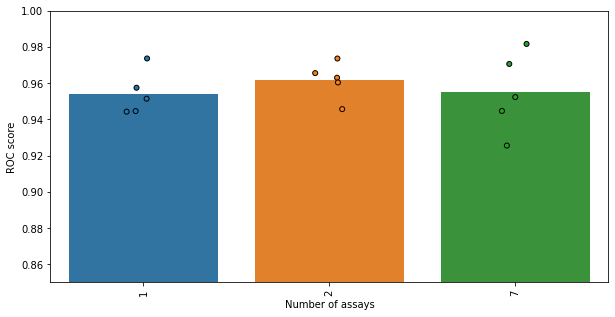

In [95]:
# Since I'm only interested in the relative performances of combinations as compared to individual assay
# performances, could argue that I can test the features identified from the above analysis as being the most
# important. However, since I am assuming that the results could then be applied to future data (i.e. what subset
# of assays should Alice et al. take forwards if they want to screen more patients), this means I don't want the
# models I train and the results I get from them to be biased towards this particular dataset => perform parameter
# tuning, feature selection, model training and testing in a cross-validation loop. Use permutation feature
# analysis to select the two most important features in each loop.
# Compare performances of models trained with individual assays to those trained with two assays selected by
# permutation feature analysis to those trained with all assays

# Don't balance the dataset, as previous analysis has indicated little difference in results for balanced +
# unbalanced datasets

model_roc_scores = {}

for col_num in [1, 2, 7]:
    print('\n\n\n{}'.format(col_num))
    model_roc_scores[str(col_num)] = []

    # Since am now training and testing, perform scaling separately on training and testing data to avoid
    # introducing bias
    ml_x = copy.deepcopy(cont_comb_df).drop(['Status', 'Dataset ID'], axis=1)
    ml_y = copy.deepcopy(cont_comb_df)[['Status']]
    ml_y['Status'] = [0 if ml_y['Status'][n] == 'Pre-pandemic' else 1 for n in range(ml_y.shape[0])]

    skf = StratifiedKFold(n_splits=5, shuffle=True)
    splits = skf.split(X=ml_x, y=ml_y)

    for split in splits:
        train_x = ml_x.iloc[list(split[0])].reset_index(drop=True)
        test_x = ml_x.iloc[list(split[1])].reset_index(drop=True)
        train_y = ml_y.iloc[list(split[0])].reset_index(drop=True)['Status'].tolist()
        test_y = ml_y.iloc[list(split[1])].reset_index(drop=True)['Status'].tolist()
        
        # Scale data
        train_x_vals = MinMaxScaler().fit_transform(train_x)
        test_x_vals = MinMaxScaler().fit_transform(test_x)
        train_x = pd.DataFrame(train_x_vals, columns=train_x.columns)
        test_x = pd.DataFrame(test_x_vals, columns=test_x.columns)
        
        # Grid search to find optimal parameters
        ada_boost = AdaBoostClassifier()
        parameters = {'n_estimators': [10, 30, 100, 300, 1000]}
        grid_search = GridSearchCV(
            estimator=ada_boost, param_grid=parameters, error_score=np.nan, scoring='roc_auc'
        )
        grid_search.fit(X=train_x, y=train_y)
        print(grid_search.best_params_)

        # Determine most informative features
        ada_boost = AdaBoostClassifier(**grid_search.best_params_)
        ada_boost.fit(train_x, train_y)
        results = permutation_importance(ada_boost, train_x, train_y, scoring='roc_auc', n_jobs=-1)  # Selected
        # roc_auc because dataset is imbalanced
        importances = results.importances_mean

        sel_assays = []
        for n in range(col_num):
            assay_index = np.argmax(importances)
            assay = ml_x.columns[assay_index]
            sel_assays.append(assay)
            importances[assay_index] = -100000
        print(sel_assays)

        # Train model using the selected assay(s) and assess model performance
        train_x = train_x[sel_assays]
        test_x = test_x[sel_assays]
        ada_boost = AdaBoostClassifier(**grid_search.best_params_)
        ada_boost.fit(train_x, train_y)
        predictions = ada_boost.predict(X=test_x)
        roc_score = roc_auc_score(y_true=test_y, y_score=predictions)
        print('{}:   {}'.format('_'.join(sel_assays), roc_score))
        model_roc_scores[str(col_num)].append((sel_assays, roc_score))

x = []
y = []
x_mean = []
y_mean = []
for assay_num in model_roc_scores.keys():
    roc_scores = []
    for assay_comb, roc_score in model_roc_scores[assay_num]:
        x.append(assay_num)
        y.append(roc_score)
        roc_scores.append(roc_score)
    x_mean.append(assay_num)
    y_mean.append(np.mean(roc_scores))

plt.clf()
plt.figure(figsize=(10,5))
sns.barplot(x=x_mean, y=y_mean)
sns.stripplot(x=x, y=y, edgecolor='k', linewidth=1)
plt.xlabel('Number of assays')
plt.ylabel('ROC score')
plt.ylim(0.85, 1.0)
plt.xticks(rotation=90)
plt.savefig('AdaBoost_performance_1_2_7_assays.svg')
plt.show()

In [96]:
# Run 5x2 CV with consistently selected model parameters and features to see if there is a significant difference
# in model performance with the different assay combinations. From permutation analysis above, most consistently
# selected assay pair is the LIPS assay and the Spike PanIg assay.
# Beware comparing numerous assays with a particular p value (e.g. 0.05), because by chance will expect a
# fraction (e.g. 1 in 20) of comparisons to have a p value below this threshold just by chance. (Bonferroni
# correction for alpha = 0.05 and 3 tests => alpha = 0.015.)

class ManualFeatureSelection(BaseEstimator, TransformerMixin):
    """
    """

    def __init__(self, sel_feat):
        """
        """

        self.sel_feat = sel_feat

    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        """
        """

        X_vals = MinMaxScaler().fit_transform(X)
        X = pd.DataFrame(X_vals, columns=X.columns)
        X = X[self.sel_feat]
        return X
    

def train_clf(clf, x, y, sel_col):
    transform_and_sel_feat = ManualFeatureSelection(sel_feat=sel_col)
    clf = Pipeline([('transform_and_select_features', transform_and_sel_feat),
                    (type(clf).__name__, clf)])
    clf.fit(X=x, y=y)
    return clf


# Runs 5x2 CV
ada_boost = AdaBoostClassifier()
parameters = {'n_estimators': [10, 30, 100, 300, 1000]}
grid_search = GridSearchCV(
    estimator=ada_boost, param_grid=parameters, error_score=np.nan, scoring='roc_auc'
)
grid_search.fit(X=copy.deepcopy(cont_comb_df).drop(['Status', 'Dataset ID'], axis=1),
                y=copy.deepcopy(cont_comb_df)['Status'])
print(grid_search.best_params_)

for comb in [(['LIPS Average Bridging'], ['LIPS Average Bridging', 'ELISA Spike Pan Norm']),
             (['ELISA Spike Pan Norm'], ['LIPS Average Bridging', 'ELISA Spike Pan Norm']),
             (['LIPS Average Bridging', 'ELISA Spike Pan Norm'], 'All')]:
    cols_1 = comb[0]
    cols_2 = comb[1]
    
    if cols_2 == 'All':
        cols_2 = cont_comb_df.drop(['Status', 'Dataset ID'], axis=1).columns.tolist()

    # Run 5x2 CV test
    clf_1 = train_clf(AdaBoostClassifier(**grid_search.best_params_),
                      copy.deepcopy(cont_comb_df).drop(['Status', 'Dataset ID'], axis=1),
                      copy.deepcopy(cont_comb_df)['Status'], cols_1)
    clf_2 = train_clf(AdaBoostClassifier(**grid_search.best_params_),
                      copy.deepcopy(cont_comb_df).drop(['Status', 'Dataset ID'], axis=1),
                      copy.deepcopy(cont_comb_df)['Status'], cols_2)
    F, p = combined_ftest_5x2cv(estimator1=clf_1,
                                estimator2=clf_2,
                                X=copy.deepcopy(cont_comb_df).drop(['Status', 'Dataset ID'], axis=1),
                                y=copy.deepcopy(cont_comb_df)['Status'],
                                scoring='roc_auc')
    print('Significant difference between {} and {}?\nF = {}; p = {}'.format(
        '_'.join(cols_1), '_'.join(cols_2), F, p)
    )

{'n_estimators': 10}
Significant difference between LIPS Average Bridging and LIPS Average Bridging_ELISA Spike Pan Norm?
F = 3.12739546052017; p = 0.11003412501570263
Significant difference between ELISA Spike Pan Norm and LIPS Average Bridging_ELISA Spike Pan Norm?
F = 1.104456560643441; p = 0.485786480909572
Significant difference between LIPS Average Bridging_ELISA Spike Pan Norm and LIPS Average Bridging_ELISA N Pan Norm_ELISA RBD Pan Norm_ELISA Spike Pan Norm_ELISA N IgA Norm_ELISA RBD IgA Norm_ELISA Spike IgA Norm?
F = 1.3690824984403527; p = 0.38328177289528703


So, observe no difference in the ability of an AdaBoost algorithm to distinguish between positive and negative individuals when:
- train with two assays rather than one
- train with all seven assays rather than one
- train with all seven assays rather than two

(From the bar plot it appears that we might achieve a minor improvement when training the classifier with two assays, but when looking at the overlap between the point plots showing the individual ROC AUC scores measured across the 5 CV splits (the bar plots show the mean average of these 5 values), this difference may well not be replicable if I were to repeat the analysis.)




1
{'min_samples_leaf': 10, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1}
['LIPS Average Bridging']
LIPS Average Bridging:   0.9336061102018549
{'min_samples_leaf': 25, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1}
['LIPS Average Bridging']
LIPS Average Bridging:   0.9893617021276595
{'min_samples_leaf': 5, 'min_samples_split': 25, 'n_estimators': 300, 'n_jobs': -1}
['LIPS Average Bridging']
LIPS Average Bridging:   0.9322185061315496
{'min_samples_leaf': 10, 'min_samples_split': 50, 'n_estimators': 10, 'n_jobs': -1}
['ELISA Spike Pan Norm']
ELISA Spike Pan Norm:   0.9603531476200923
{'min_samples_leaf': 5, 'min_samples_split': 5, 'n_estimators': 300, 'n_jobs': -1}
['LIPS Average Bridging']
LIPS Average Bridging:   0.981629743364773



2
{'min_samples_leaf': 10, 'min_samples_split': 10, 'n_estimators': 30, 'n_jobs': -1}
['LIPS Average Bridging', 'ELISA Spike Pan Norm']
LIPS Average Bridging_ELISA Spike Pan Norm:   0.9574468085106382
{'min_samples_leaf': 5,

<Figure size 432x288 with 0 Axes>

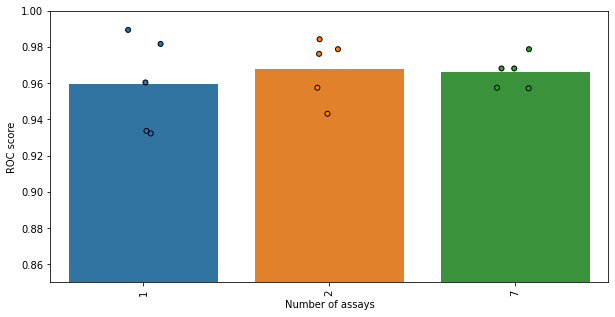

In [97]:
# Since I'm only interested in the relative performances of combinations as compared to individual assay
# performances, could argue that I can test the features identified from the above analysis as being the most
# important. However, since I am assuming that the results could then be applied to future data (i.e. what subset
# of assays should Alice et al. take forwards if they want to screen more patients), this means I don't want the
# models I train and the results I get from them to be biased towards this particular dataset => perform parameter
# tuning, feature selection, model training and testing in a cross-validation loop. Use permutation feature
# analysis to select the two most important features in each loop.
# Compare performances of models trained with individual assays to those trained with two assays selected by
# permutation feature analysis to those trained with all assays

# Don't balance the dataset, as previous analysis has indicated little difference in results for balanced +
# unbalanced datasets

model_roc_scores = {}

for col_num in [1, 2, 7]:
    print('\n\n\n{}'.format(col_num))
    model_roc_scores[str(col_num)] = []

    # Since am now training and testing, perform scaling separately on training and testing data to avoid
    # introducing bias
    ml_x = copy.deepcopy(cont_comb_df).drop(['Status', 'Dataset ID'], axis=1)
    ml_y = copy.deepcopy(cont_comb_df)[['Status']]
    ml_y['Status'] = [0 if ml_y['Status'][n] == 'Pre-pandemic' else 1 for n in range(ml_y.shape[0])]

    skf = StratifiedKFold(n_splits=5, shuffle=True)
    splits = skf.split(X=ml_x, y=ml_y)

    for split in splits:
        train_x = ml_x.iloc[list(split[0])].reset_index(drop=True)
        test_x = ml_x.iloc[list(split[1])].reset_index(drop=True)
        train_y = ml_y.iloc[list(split[0])].reset_index(drop=True)['Status'].tolist()
        test_y = ml_y.iloc[list(split[1])].reset_index(drop=True)['Status'].tolist()
        
        # Scale data
        train_x_vals = MinMaxScaler().fit_transform(train_x)
        test_x_vals = MinMaxScaler().fit_transform(test_x)
        train_x = pd.DataFrame(train_x_vals, columns=train_x.columns)
        test_x = pd.DataFrame(test_x_vals, columns=test_x.columns)
        
        # Grid search to find optimal parameters
        random_forest = RandomForestClassifier(n_jobs=-1)
        parameters = {'n_estimators': [10, 30, 100, 300],
                      'min_samples_split': [5, 10, 25, 50, 100],
                      'min_samples_leaf': [5, 10, 25, 50],
                      'n_jobs': [-1]}
        grid_search = GridSearchCV(
            estimator=random_forest, param_grid=parameters, error_score=np.nan, scoring='roc_auc'
        )
        grid_search.fit(X=train_x, y=train_y)
        print(grid_search.best_params_)

        # Determine two most informative assays
        random_forest = RandomForestClassifier(**grid_search.best_params_)
        random_forest.fit(train_x, train_y)
        results = permutation_importance(random_forest, train_x, train_y, scoring='roc_auc', n_jobs=-1)
        # Selected roc_auc because dataset is imbalanced
        importances = results.importances_mean

        sel_assays = []
        for n in range(col_num):
            assay_index = np.argmax(importances)
            assay = ml_x.columns[assay_index]
            sel_assays.append(assay)
            importances[assay_index] = -100000
        print(sel_assays)

        # Train model using the selected assay(s) and assess model performance
        train_x = train_x[sel_assays]
        test_x = test_x[sel_assays]
        random_forest = RandomForestClassifier(**grid_search.best_params_)
        random_forest.fit(train_x, train_y)
        predictions = random_forest.predict(X=test_x)
        roc_score = roc_auc_score(y_true=test_y, y_score=predictions)
        print('{}:   {}'.format('_'.join(sel_assays), roc_score))
        model_roc_scores[str(col_num)].append((sel_assays, roc_score))

x = []
y = []
x_mean = []
y_mean = []
for assay_num in model_roc_scores.keys():
    roc_scores = []
    for assay_comb, roc_score in model_roc_scores[assay_num]:
        x.append(assay_num)
        y.append(roc_score)
        roc_scores.append(roc_score)
    x_mean.append(assay_num)
    y_mean.append(np.mean(roc_scores))

plt.clf()
plt.figure(figsize=(10,5))
sns.barplot(x=x_mean, y=y_mean)
sns.stripplot(x=x, y=y, edgecolor='k', linewidth=1)
plt.xlabel('Number of assays')
plt.ylabel('ROC score')
plt.ylim(0.85, 1.0)
plt.xticks(rotation=90)
plt.savefig('RandomForest_performance_1_2_7_assays.svg')
plt.show()

In [98]:
# Run 5x2 CV with consistently selected model parameters and features to see if there is a significant difference
# in model performance with the different assay combinations. From permutation analysis above, most consistently
# selected assay pair is the LIPS assay and the Spike PanIg assay.
# Beware comparing numerous assays with a particular p value (e.g. 0.05), because by chance will expect a
# fraction (e.g. 1 in 20) of comparisons to have a p value below this threshold just by chance. (Bonferroni
# correction for alpha = 0.05 and 3 tests => alpha = 0.015.)
 
# Runs 5x2 CV
random_forest = RandomForestClassifier()
parameters = {'n_estimators': [10, 30, 100, 300],
              'min_samples_split': [5, 10, 25, 50, 100],
              'min_samples_leaf': [5, 10, 25, 50],
              'n_jobs': [-1]}
grid_search = GridSearchCV(
    estimator=random_forest, param_grid=parameters, error_score=np.nan, scoring='roc_auc'
)
grid_search.fit(X=copy.deepcopy(cont_comb_df).drop(['Status', 'Dataset ID'], axis=1),
                y=copy.deepcopy(cont_comb_df)['Status'])
print(grid_search.best_params_)

for comb in [(['LIPS Average Bridging'], ['LIPS Average Bridging', 'ELISA Spike Pan Norm']),
             (['ELISA Spike Pan Norm'], ['LIPS Average Bridging', 'ELISA Spike Pan Norm']),
             (['LIPS Average Bridging', 'ELISA Spike Pan Norm'], 'All')]:
    cols_1 = comb[0]
    cols_2 = comb[1]
    
    if cols_2 == 'All':
        cols_2 = cont_comb_df.drop(['Status', 'Dataset ID'], axis=1).columns.tolist()

    clf_1 = train_clf(RandomForestClassifier(**grid_search.best_params_),
                      copy.deepcopy(cont_comb_df).drop(['Status', 'Dataset ID'], axis=1),
                      copy.deepcopy(cont_comb_df)['Status'], cols_1)
    clf_2 = train_clf(RandomForestClassifier(**grid_search.best_params_),
                      copy.deepcopy(cont_comb_df).drop(['Status', 'Dataset ID'], axis=1),
                      copy.deepcopy(cont_comb_df['Status']), cols_2)
    F, p = combined_ftest_5x2cv(estimator1=clf_1,
                                estimator2=clf_2,
                                X=copy.deepcopy(cont_comb_df).drop(['Status', 'Dataset ID'], axis=1),
                                y=copy.deepcopy(cont_comb_df)['Status'],
                                scoring='roc_auc')
    print('Significant difference between {} and {}?\nF = {}; p = {}'.format(
        '_'.join(cols_1), '_'.join(cols_2), F, p)
    )

{'min_samples_leaf': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1}
Significant difference between LIPS Average Bridging and LIPS Average Bridging_ELISA Spike Pan Norm?
F = 7.69843320027318; p = 0.01805316537741408
Significant difference between ELISA Spike Pan Norm and LIPS Average Bridging_ELISA Spike Pan Norm?
F = 1.9209443726124753; p = 0.244119526358218
Significant difference between LIPS Average Bridging_ELISA Spike Pan Norm and LIPS Average Bridging_ELISA N Pan Norm_ELISA RBD Pan Norm_ELISA Spike Pan Norm_ELISA N IgA Norm_ELISA RBD IgA Norm_ELISA Spike IgA Norm?
F = 0.7189491698375714; p = 0.6934398149103225


5x2 CV test indicates we obtain a small improvement in performance when we train a random forest classifier with the ELISA Spike Pan Ig assay and the LIPS bridging assay as compared to the LIPS bridging assay on its own. However, although the p-value is lower than 0.05, it is slightly larger than the Bonferroni-corrected threshold for three tests (0.015). We observe no/minimal difference between the ELISA Spike PanIg assay on its own and the combination of LIPS bridging and ELISA Spike PanIg assays, or between the former two assays as compared to all seven. 

So, depending on the algorithm, in some cases it might be worth using two assays rather than one to get better discrimination between positive and negative patients. Whether combining assays would be worthwhile will depend upon how useful the small improvement in performance is, balanced against the increased difficulty of performing two assays as compared to one. I suspect the difference here is not large enough to merit running two assays per patient.




1
{'C': 0.1, 'dual': False}
['ELISA Spike Pan Norm']
ELISA Spike Pan Norm:   0.9361702127659575
{'C': 100000.0, 'dual': False}
['LIPS Average Bridging']
LIPS Average Bridging:   0.9442444080741953
{'C': 10.0, 'dual': False}
['ELISA Spike Pan Norm']
ELISA Spike Pan Norm:   0.9456521739130435
{'C': 0.1, 'dual': False}
['ELISA Spike Pan Norm']
ELISA Spike Pan Norm:   0.9761460846676904
{'C': 0.1, 'dual': False}
['ELISA Spike Pan Norm']
ELISA Spike Pan Norm:   0.9361702127659575



2
{'C': 100000.0, 'dual': False}
['LIPS Average Bridging', 'ELISA Spike IgA Norm']
LIPS Average Bridging_ELISA Spike IgA Norm:   0.9523186033824332
{'C': 0.1, 'dual': False}
['ELISA Spike Pan Norm', 'ELISA N Pan Norm']
ELISA Spike Pan Norm_ELISA N Pan Norm:   0.9893617021276595
{'C': 0.1, 'dual': False}
['ELISA Spike Pan Norm', 'ELISA Spike IgA Norm']
ELISA Spike Pan Norm_ELISA Spike IgA Norm:   0.9430880713489409
{'C': 0.1, 'dual': False}
['ELISA Spike Pan Norm', 'ELISA RBD IgA Norm']
ELISA Spike Pan Norm_EL

<Figure size 432x288 with 0 Axes>

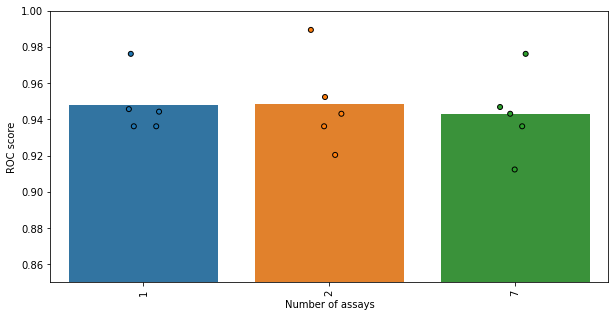

In [99]:
# Since I'm only interested in the relative performances of combinations as compared to individual assay
# performances, could argue that I can test the features identified from the above analysis as being the most
# important. However, since I am assuming that the results could then be applied to future data (i.e. what subset
# of assays should Alice et al. take forwards if they want to screen more patients), this means I don't want the
# models I train and the results I get from them to be biased towards this particular dataset => perform parameter
# tuning, feature selection, model training and testing in a cross-validation loop. Use permutation feature
# analysis to select the two most important features in each loop.
# Compare performances of models trained with individual assays to those trained with two assays selected by
# permutation feature analysis to those trained with all assays

# Don't balance the dataset, as previous analysis has indicated little difference in results for balanced +
# unbalanced datasets

model_roc_scores = {}

for col_num in [1, 2, 7]:
    print('\n\n\n{}'.format(col_num))
    model_roc_scores[str(col_num)] = []

    # Since am now training and testing, perform scaling separately on training and testing data to avoid
    # introducing bias
    ml_x = copy.deepcopy(cont_comb_df).drop(['Status', 'Dataset ID'], axis=1)
    ml_y = copy.deepcopy(cont_comb_df)[['Status']]
    ml_y['Status'] = [0 if ml_y['Status'][n] == 'Pre-pandemic' else 1 for n in range(ml_y.shape[0])]

    skf = StratifiedKFold(n_splits=5, shuffle=True)
    splits = skf.split(X=ml_x, y=ml_y)

    for split in splits:
        train_x = ml_x.iloc[list(split[0])].reset_index(drop=True)
        test_x = ml_x.iloc[list(split[1])].reset_index(drop=True)
        train_y = ml_y.iloc[list(split[0])].reset_index(drop=True)['Status'].tolist()
        test_y = ml_y.iloc[list(split[1])].reset_index(drop=True)['Status'].tolist()
        
        # Scale data
        train_x_vals = MinMaxScaler().fit_transform(train_x)
        test_x_vals = MinMaxScaler().fit_transform(test_x)
        train_x = pd.DataFrame(train_x_vals, columns=train_x.columns)
        test_x = pd.DataFrame(test_x_vals, columns=test_x.columns)

        # Grid search to find optimal parameters
        svc = LinearSVC()
        parameters = {'C': np.logspace(-1, 5, num=7, base=10),
                      'dual': [False]}
        grid_search = GridSearchCV(
            estimator=svc, param_grid=parameters, error_score=np.nan, scoring='roc_auc'
        )
        grid_search.fit(X=train_x, y=train_y)
        print(grid_search.best_params_)

        # Determine two most informative assays
        svc = LinearSVC(**grid_search.best_params_)
        svc.fit(train_x, train_y)
        results = permutation_importance(svc, train_x, train_y, scoring='roc_auc', n_jobs=-1)  # Selected
        # roc_auc because dataset is imbalanced
        importances = results.importances_mean

        sel_assays = []
        for n in range(col_num):
            assay_index = np.argmax(importances)
            assay = ml_x.columns[assay_index]
            sel_assays.append(assay)
            importances[assay_index] = -100000
        print(sel_assays)

        # Train model using the selected assay(s) and assess model performance
        train_x = train_x[sel_assays]
        test_x = test_x[sel_assays]
        svc = LinearSVC(**grid_search.best_params_)
        svc.fit(train_x, train_y)
        predictions = svc.predict(X=test_x)
        roc_score = roc_auc_score(y_true=test_y, y_score=predictions)
        print('{}:   {}'.format('_'.join(sel_assays), roc_score))
        model_roc_scores[str(col_num)].append((sel_assays, roc_score))

x = []
y = []
x_mean = []
y_mean = []
for assay_num in model_roc_scores.keys():
    roc_scores = []
    for assay_comb, roc_score in model_roc_scores[assay_num]:
        x.append(assay_num)
        y.append(roc_score)
        roc_scores.append(roc_score)
    x_mean.append(assay_num)
    y_mean.append(np.mean(roc_scores))

plt.clf()
plt.figure(figsize=(10,5))
sns.barplot(x=x_mean, y=y_mean)
sns.stripplot(x=x, y=y, edgecolor='k', linewidth=1)
plt.xlabel('Number of assays')
plt.ylabel('ROC score')
plt.ylim(0.85, 1.0)
plt.xticks(rotation=90)
plt.savefig('SVC_performance_1_2_7_assays.svg')
plt.show()

In [100]:
# Run 5x2 CV with consistently selected model parameters and features to see if there is a significant difference
# in model performance with the different assay combinations. Is quite a lot of variation in the pair of assays
# selected as the most important in the above permutation analysis (is dependent upon the value of C selected by
# the prior grid search), have decided to select the combination of the Spike PanIg assay and the Spike IgA assay.
# Beware comparing numerous assays with a particular p value (e.g. 0.05), because by chance will expect a
# fraction (e.g. 1 in 20) of comparisons to have a p value below this threshold just by chance. (Bonferroni
# correction for alpha = 0.05 and 3 tests => alpha = 0.015.)
 
# Runs 5x2 CV
svc = LinearSVC()
parameters = {'C': np.logspace(-1, 5, num=7, base=10),
              'dual': [False]}
grid_search = GridSearchCV(
    estimator=svc, param_grid=parameters, error_score=np.nan, scoring='roc_auc'
)
grid_search.fit(X=copy.deepcopy(cont_comb_df).drop(['Status', 'Dataset ID'], axis=1),
                y=copy.deepcopy(cont_comb_df)['Status'])
print(grid_search.best_params_)

for comb in [(['ELISA Spike Pan Norm'], ['ELISA Spike Pan Norm', 'ELISA Spike IgA Norm']),
             (['ELISA Spike IgA Norm'], ['ELISA Spike Pan Norm', 'ELISA Spike IgA Norm']),
             (['ELISA Spike Pan Norm', 'ELISA Spike IgA Norm'], 'All')]:
    cols_1 = comb[0]
    cols_2 = comb[1]
    
    if cols_2 == 'All':
        cols_2 = cont_comb_df.drop(['Status', 'Dataset ID'], axis=1).columns.tolist()
        
    clf_1 = train_clf(LinearSVC(**grid_search.best_params_),
                      copy.deepcopy(cont_comb_df).drop(['Status', 'Dataset ID'], axis=1),
                      copy.deepcopy(cont_comb_df)['Status'], cols_1)
    clf_2 = train_clf(LinearSVC(**grid_search.best_params_),
                      copy.deepcopy(cont_comb_df).drop(['Status', 'Dataset ID'], axis=1),
                      copy.deepcopy(cont_comb_df)['Status'], cols_2)
    F, p = combined_ftest_5x2cv(estimator1=clf_1,
                                estimator2=clf_2,
                                X=copy.deepcopy(cont_comb_df).drop(['Status', 'Dataset ID'], axis=1),
                                y=copy.deepcopy(cont_comb_df)['Status'],
                                scoring='roc_auc')
    print('Significant difference between {} and {}?\nF = {}; p = {}'.format(
        '_'.join(cols_1), '_'.join(cols_2), F, p)
    )

{'C': 0.1, 'dual': False}
Significant difference between ELISA Spike Pan Norm and ELISA Spike Pan Norm_ELISA Spike IgA Norm?
F = 7.717967175081789; p = 0.017953749722637736
Significant difference between ELISA Spike IgA Norm and ELISA Spike Pan Norm_ELISA Spike IgA Norm?
F = 2.1145009475799994; p = 0.2113693213848148
Significant difference between ELISA Spike Pan Norm_ELISA Spike IgA Norm and LIPS Average Bridging_ELISA N Pan Norm_ELISA RBD Pan Norm_ELISA Spike Pan Norm_ELISA N IgA Norm_ELISA RBD IgA Norm_ELISA Spike IgA Norm?
F = 0.5651868873604929; p = 0.7931034365034402


Again, like the results of the random forest analysis, 5x2 CV test indicates a small difference in performance when we train a support vector classifier with the ELISA Spike PanIg and IgA assays as compared to the Spike PanIg assay on its own. However, although the p-value is lower than 0.05, it is slightly larger than the Bonferroni-corrected threshold for three tests (0.015). We observe no/minimal difference between the Spike IgA assay and the combination of Spike IgA and PanIg assays, or the Spike IgA and PanIg assays as compared to all seven assays.

In contrast, the bar plot (where, unlike the 5x2 CV test, the assay combination selected in each split of the CV can vary (because it is selected by permutation analysis on that particular split)) shows minimal difference between the models trained with 1, 2 or 7 assays. 

So, would summarise that observe no/only a small difference in model performance when use multiple assays as compared to a single assay to train a support vector classifier.

Interestingly therefore, although the analysis in previous sections (rank comparison analysis and Spearman's rank/Kendall's tau correlation coefficients) indicate that the different assays provide different information, there doesn't appear to be much benefit to combining the assays when training a model to distinguish between positive and negative patients. This is probably an artefact of the fact that most of the individual assays perform really well at distinguishing between positive and negative patients - consequently there is not much further performance to be gained. The two assays that are consistently selected as the most informative are the LIPS average bridging assay and the ELISA Spike PanIg assay, and if you look at the line plots and heat maps earlier in this notebook you can see that not only are they the best assays at distinguishing positive from negative samples, but also that they largely distinguish the same samples as positive. Consequently, whilst they may provide unique information with respect to the order in which they rank the positive samples, the information they provide about which samples are postive is largely the same. I suspect that if I were to combine two of the more poorly performing assays, that disagree more in the samples that they identify as positive, we would see a greater benefit to combining assays.

#### Q4: Are there any variables (e.g. age, sex etc.) that correlate with disease severity in positive patients? 




Threshold
Number of samples: 43
Kendall tau correlation coefficient: KendalltauResult(correlation=-0.17088578500114607, pvalue=0.11106228972052853)


<Figure size 432x288 with 0 Axes>

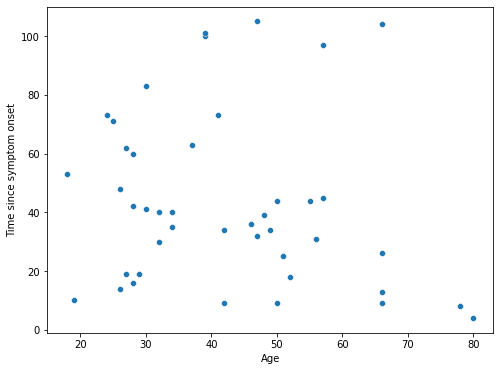

Kendall tau correlation coefficient: KendalltauResult(correlation=-0.2132720090231625, pvalue=0.09746885482286642)


<Figure size 432x288 with 0 Axes>

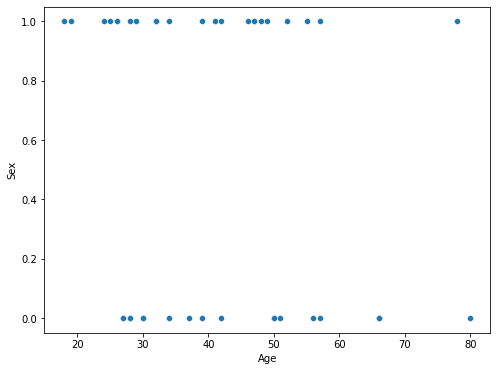

Kendall tau correlation coefficient: KendalltauResult(correlation=0.02493615846573844, pvalue=0.8455024540768197)


<Figure size 432x288 with 0 Axes>

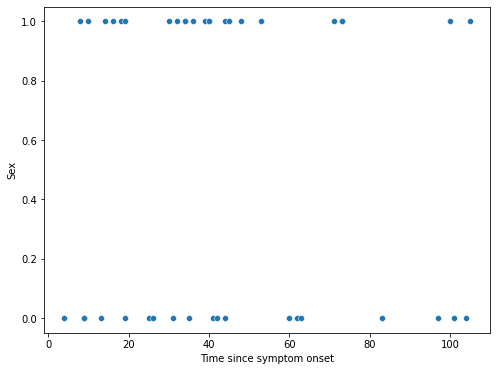




Validation
Number of samples: 188
Kendall tau correlation coefficient: KendalltauResult(correlation=0.022659533533793255, pvalue=0.6469317296889578)


<Figure size 432x288 with 0 Axes>

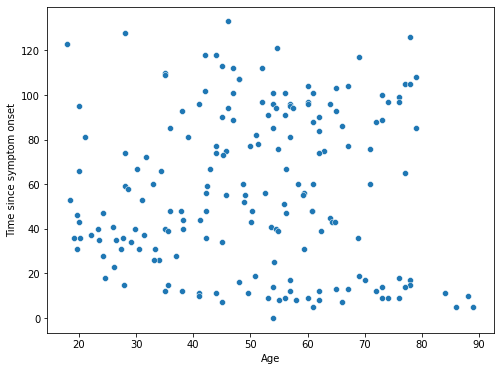

Kendall tau correlation coefficient: KendalltauResult(correlation=-0.16180127880398534, pvalue=0.007046162500056677)


<Figure size 432x288 with 0 Axes>

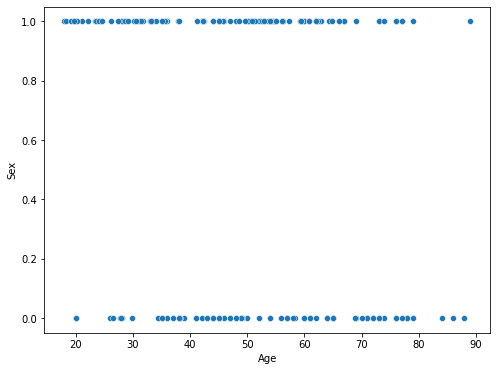

Kendall tau correlation coefficient: KendalltauResult(correlation=0.4578083817126012, pvalue=1.0510948601206523e-15)


<Figure size 432x288 with 0 Axes>

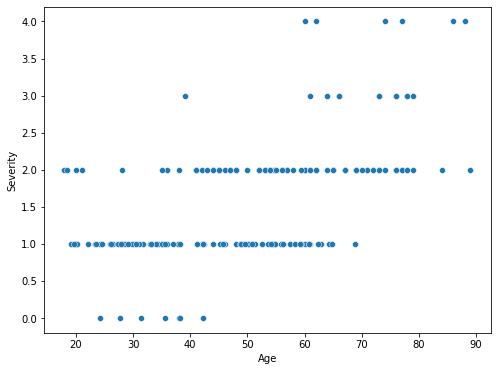

Kendall tau correlation coefficient: KendalltauResult(correlation=0.42507801412451857, pvalue=1.4489319458900823e-12)


<Figure size 432x288 with 0 Axes>

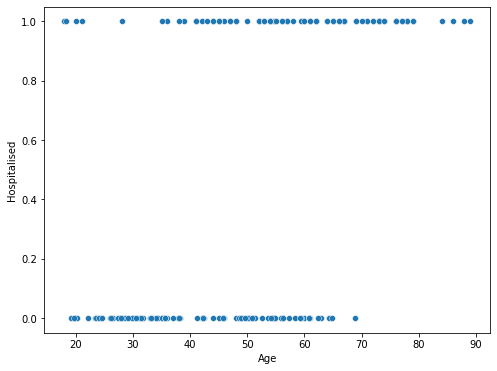

Kendall tau correlation coefficient: KendalltauResult(correlation=-0.024246376788374765, pvalue=0.6704710563677836)


<Figure size 432x288 with 0 Axes>

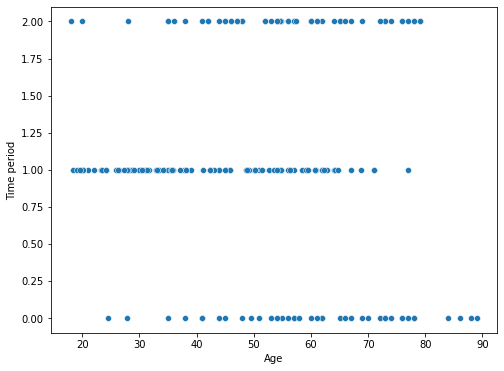

Kendall tau correlation coefficient: KendalltauResult(correlation=-0.023493677579836125, pvalue=0.696227532107522)


<Figure size 432x288 with 0 Axes>

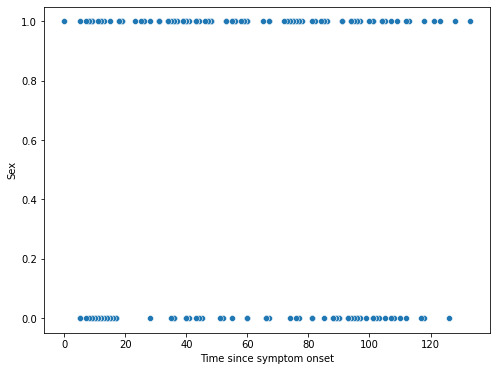

Kendall tau correlation coefficient: KendalltauResult(correlation=0.04405442858951083, pvalue=0.4412065206791348)


<Figure size 432x288 with 0 Axes>

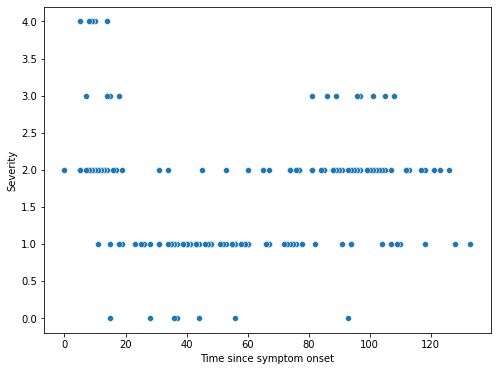

Kendall tau correlation coefficient: KendalltauResult(correlation=0.06316942212218177, pvalue=0.2938333246290389)


<Figure size 432x288 with 0 Axes>

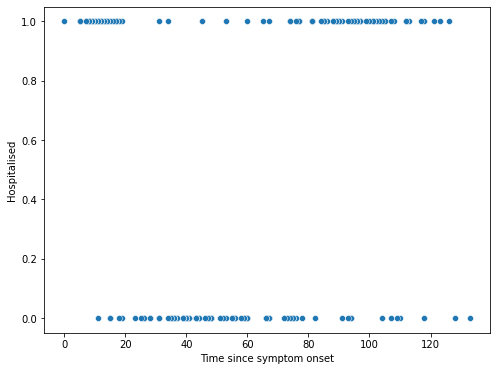

Kendall tau correlation coefficient: KendalltauResult(correlation=0.7983996645230247, pvalue=2.040023857428751e-44)


<Figure size 432x288 with 0 Axes>

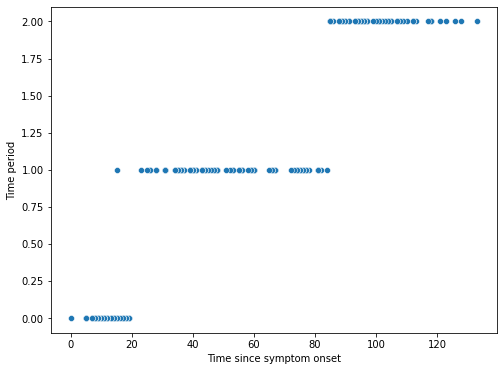

Kendall tau correlation coefficient: KendalltauResult(correlation=-0.3474099039630382, pvalue=5.759247465373491e-07)


<Figure size 432x288 with 0 Axes>

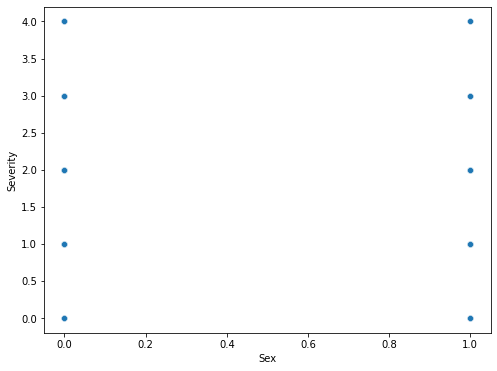

Kendall tau correlation coefficient: KendalltauResult(correlation=-0.38759097527998554, pvalue=1.1565886948075384e-07)


<Figure size 432x288 with 0 Axes>

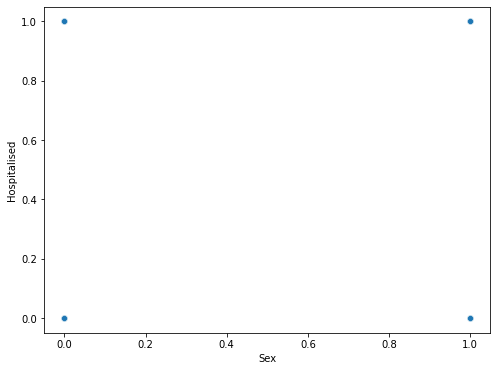

Kendall tau correlation coefficient: KendalltauResult(correlation=-0.007370176423402255, pvalue=0.9153979479930605)


<Figure size 432x288 with 0 Axes>

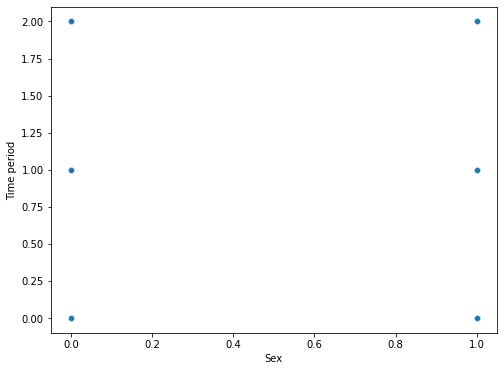

Kendall tau correlation coefficient: KendalltauResult(correlation=0.8984641040246387, pvalue=3.103452013240032e-38)


<Figure size 432x288 with 0 Axes>

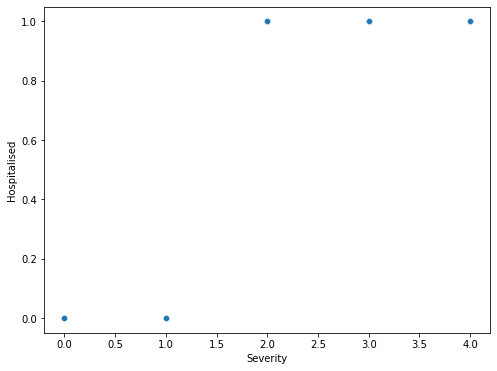

Kendall tau correlation coefficient: KendalltauResult(correlation=-0.007986561375884814, pvalue=0.9035902562998539)


<Figure size 432x288 with 0 Axes>

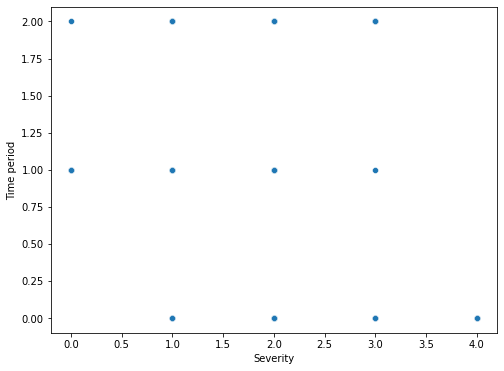

Kendall tau correlation coefficient: KendalltauResult(correlation=0.024849150011402858, pvalue=0.7202151539001149)


<Figure size 432x288 with 0 Axes>

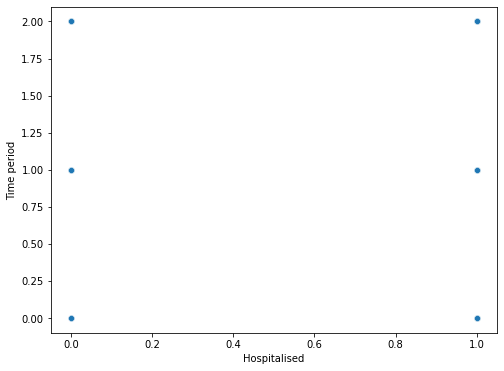




All data
Number of samples: 231
Kendall tau correlation coefficient: KendalltauResult(correlation=0.011851428469286268, pvalue=0.7903791489975267)


<Figure size 432x288 with 0 Axes>

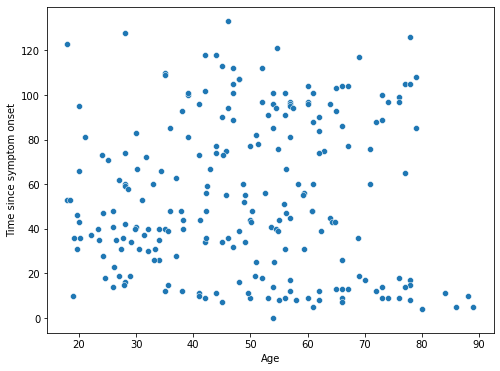

Kendall tau correlation coefficient: KendalltauResult(correlation=-0.15908502467299948, pvalue=0.003297422893437493)


<Figure size 432x288 with 0 Axes>

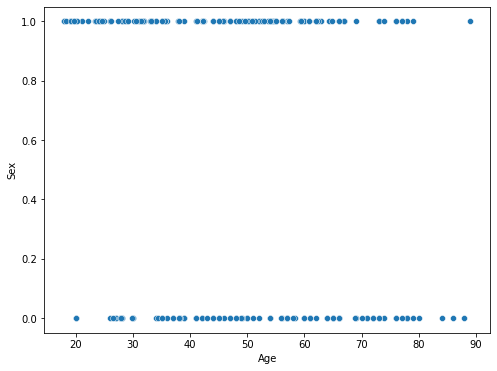

Kendall tau correlation coefficient: KendalltauResult(correlation=-0.008538629947378555, pvalue=0.8749313909251478)


<Figure size 432x288 with 0 Axes>

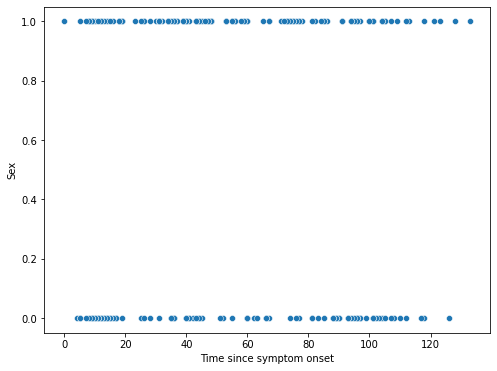

In [101]:
# To what extent is there an even distribution of patients across the different non-assay features?

for label in ['Threshold', 'Validation', 'All data']:
    print('\n\n\n{}'.format(label))
    if label == 'Validation':
            cols = ['Age', 'Time since symptom onset', 'Sex', 'Severity', 'Hospitalised', 'Time period']
    else:
        cols = ['Age', 'Time since symptom onset', 'Sex']
    ml_x = copy.deepcopy(pos_ml_x_all_dict[label])
    sex_conv_dict = {'M': 0,
                     'F': 1}
    severity_conv_dict = {'Asymptomatic': 0,
                          'Mild': 1,
                          'Hospitalised, no ventilatory support': 2,
                          'Hospitalised, required ventilatory support/High care': 3,
                          'Died': 4}
    hospitalised_conv_dict = {'No': 0,
                              'Yes': 1}
    time_period_conv_dict = {'Acute': 0,
                             'Early Convalescent': 1,
                             'Late Convalescent': 2}

    # Converts data into suitable format
    # Ages are recorded as strings in threshold dataset
    ages = []
    for age in ml_x['Age']:
        if type(age) == str:
            if '+' in age:
                ages.append(np.nan)
            elif '-' in age:
                low_age = float(age.split('-')[0])
                high_age = float(age.split('-')[1])
                mean_age = (low_age + high_age) / 2
                ages.append(int(mean_age))
            else:
                ages.append(int(float(age)))
        else:
            ages.append(age)
    ml_x['Age'] = ages
    ml_x['Sex'] = [sex_conv_dict[ml_x['Sex'][n]] if type(ml_x['Sex'][n]) == str else np.nan
                   for n in range(ml_x.shape[0])]
    ml_x['Time since symptom onset'] = [float(time) if not np.isnan(time) else np.nan
                                        for time in ml_x['Time since symptom onset']]

    if label == 'Validation':
        ml_x['Severity'] = [severity_conv_dict[ml_x['Severity'][n]]
                            if type(ml_x['Severity'][n]) == str else np.nan
                            for n in range(ml_x.shape[0])]
        ml_x['Hospitalised'] = [hospitalised_conv_dict[ml_x['Hospitalised'][n]]
                                if type(ml_x['Hospitalised'][n]) == str else np.nan
                                for n in range(ml_x.shape[0])]
        ml_x['Time period'] = [time_period_conv_dict[ml_x['Time period'][n]]
                               if type(ml_x['Time period'][n]) == str else np.nan
                               for n in range(ml_x.shape[0])]

    # Removes NaN values
    ml_x = ml_x.dropna().reset_index(drop=True)
    print('Number of samples: {}'.format(ml_x.shape[0]))
    
    pairs = combinations(cols, 2)
    for pair in pairs:
        assay_1 = pair[0]
        assay_2 = pair[1]
        
        correlation_coefficient = kendalltau(x=ml_x[assay_1], y=ml_x[assay_2])
        print('Kendall tau correlation coefficient: {}'.format(correlation_coefficient))

        plt.clf()
        plt.figure(figsize=(8, 6))
        sns.scatterplot(x=ml_x[assay_1], y=ml_x[assay_2])
        plt.xlabel(assay_1)
        plt.ylabel(assay_2)
        if label == 'All data':
            plt.savefig('All_data_scatter_plot_{}_{}.svg'.format(assay_1, assay_2))
        plt.show()

So, overall, distribution of individuals across these non-assay features is pretty even. In particular, observe no/only weak correlation between age, time since symptom onset and sex. 

In the case of the validation dataset, for which three extra features are available (time period, hospitalised and severity), observe strong correlations between the features known to be related, namely time period and time since symptom onset, plus severity and hospitalised. 

In addition, observe positive correlation between severity (and accordingly also hospitalised) and age, which is not unexpected given that older people tend to get sicker, but will need to bear this in mind in the following importance analysis. Also, although correlation coefficient between time since symptom onset and age is low (because correlation coefficient calculation assumes a monotonic relationship between x and y), by eye can see that   patients in the "early convalescent" (time period = 1) time period are more likely to be younger, whereas in the "acute" (time period = 0) and "late convalescent" (time period = 2) phases they are slightly older. There is also a medium negative correlation between severity (and accordingly hospitalised) with sex - women are more likely to be less sick. This probably stems from the fact that many of the non-hospitalised samples were collected from hospital staff, who are more likely to be female. Otherwise however, there is no/only weak correlations between the validation dataset non-assay features.




Threshold, LIPS Average Bridging
Number of samples: 43
[[0.45561718 0.36865737 0.17572545]
 [0.24129034 0.54759556 0.2111141 ]
 [0.45943877 0.35244889 0.18811234]
 ...
 [0.36946369 0.46323459 0.16730172]
 [0.36174915 0.25225686 0.38599399]
 [0.31856394 0.53785103 0.14358504]]
                    Feature     Score
0  Time since symptom onset  0.443978
1                       Age  0.386051
2                       Sex  0.168931


<Figure size 432x288 with 0 Axes>

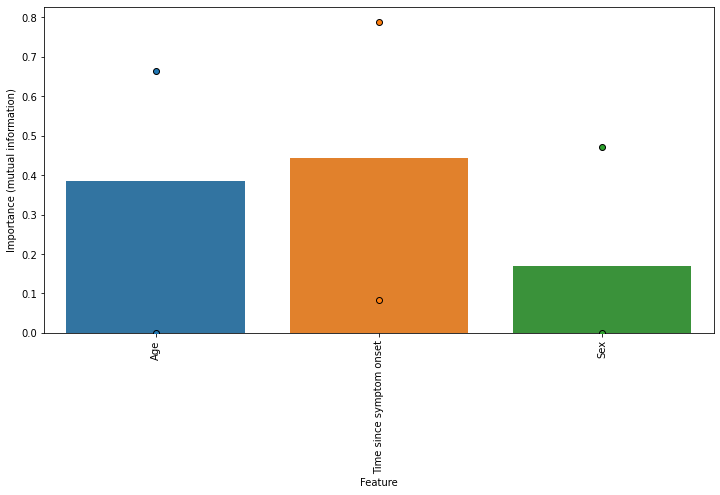

<Figure size 432x288 with 0 Axes>

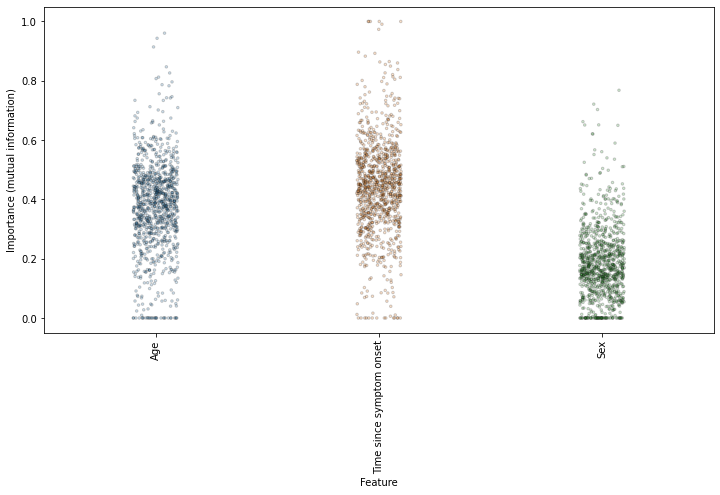

<Figure size 432x288 with 0 Axes>

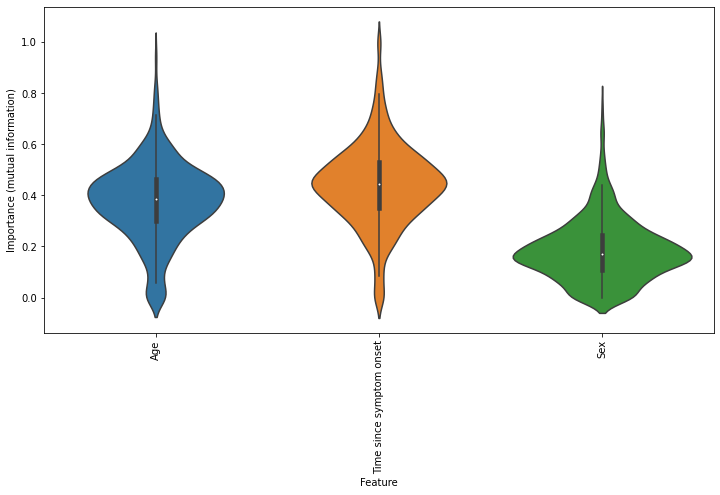




Threshold, ELISA Spike Pan Norm
Number of samples: 43
[[0.38601932 0.61398068 0.        ]
 [0.23916184 0.66084991 0.09998824]
 [0.41017071 0.58982929 0.        ]
 ...
 [0.45526654 0.21778915 0.32694431]
 [0.36501429 0.44477716 0.19020855]
 [0.50491266 0.36975728 0.12533006]]
                    Feature     Score
0  Time since symptom onset  0.415168
1                       Age  0.414551
2                       Sex  0.159205


<Figure size 432x288 with 0 Axes>

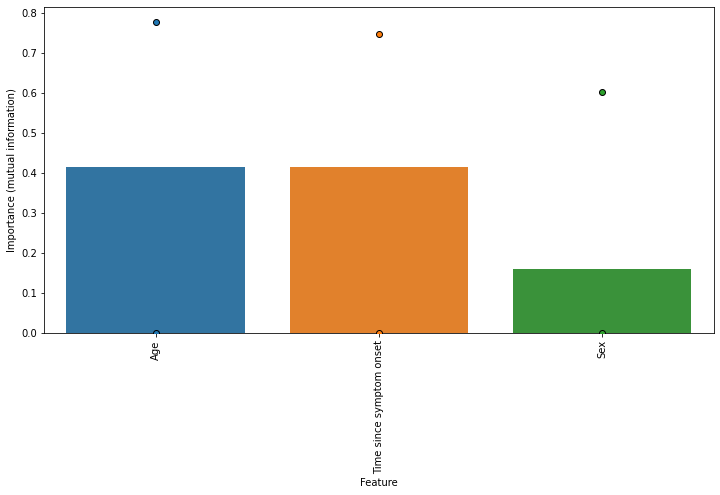

<Figure size 432x288 with 0 Axes>

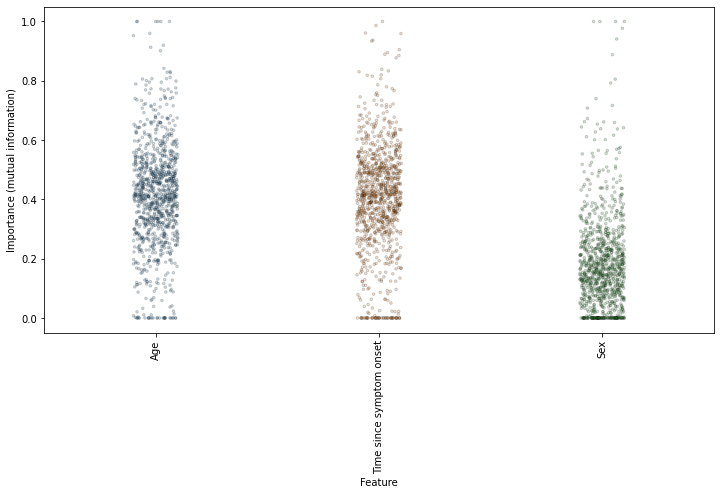

<Figure size 432x288 with 0 Axes>

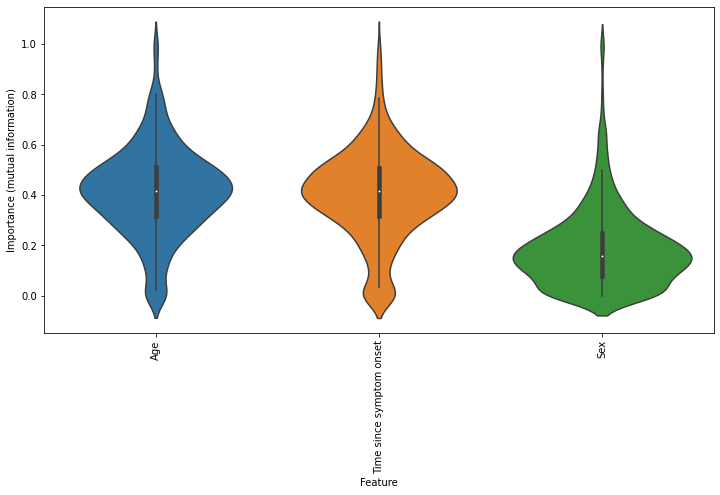




Validation, LIPS Average Bridging
Number of samples: 188
[[0.25078745 0.28157982 0.06491774 0.13041354 0.09870086 0.17360059]
 [0.21277319 0.30765124 0.05296674 0.16829384 0.10799166 0.15032333]
 [0.23674107 0.29979259 0.05791365 0.16656755 0.10955262 0.12943251]
 ...
 [0.21983818 0.28903712 0.05680358 0.15633515 0.11154582 0.16644014]
 [0.23423264 0.31466891 0.07686447 0.14903049 0.09330834 0.13189515]
 [0.24343524 0.28802068 0.06266065 0.14230093 0.10166568 0.16191682]]
                    Feature     Score
0  Time since symptom onset  0.295738
1                       Age  0.222324
2               Time period  0.161640
3                  Severity  0.149211
4              Hospitalised  0.103599
5                       Sex  0.066226


<Figure size 432x288 with 0 Axes>

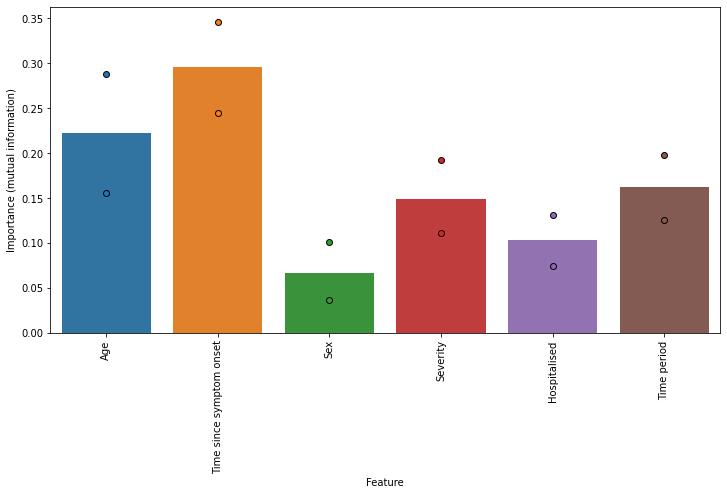

<Figure size 432x288 with 0 Axes>

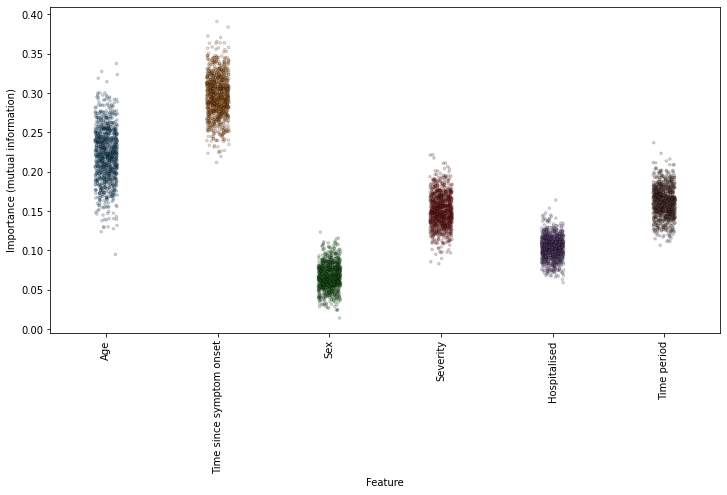

<Figure size 432x288 with 0 Axes>

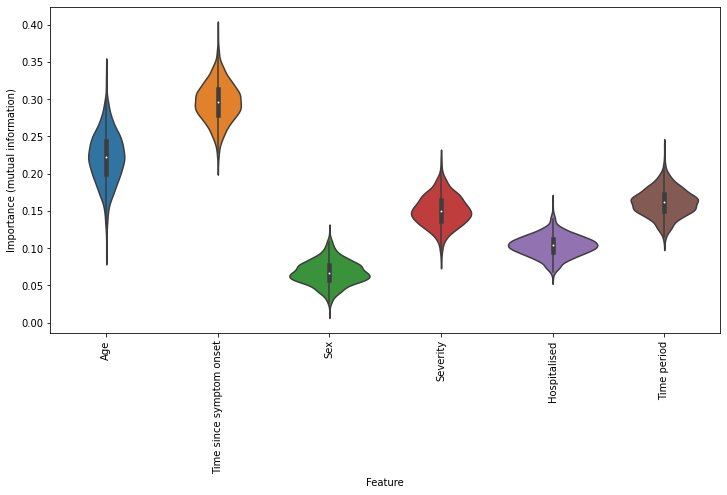




Validation, ELISA Spike Pan Norm
Number of samples: 188
[[0.31633936 0.27486719 0.0793096  0.11994801 0.08198512 0.12755072]
 [0.28390103 0.26532415 0.13196091 0.16817953 0.09096208 0.0596723 ]
 [0.35996221 0.3253855  0.05798315 0.07101894 0.0758502  0.1098    ]
 ...
 [0.30969936 0.24179589 0.10795845 0.14452741 0.0788306  0.11718829]
 [0.34767441 0.30146737 0.07180931 0.11651331 0.07879199 0.08374361]
 [0.32945174 0.33171855 0.05882136 0.1133521  0.04408138 0.12257488]]
                    Feature     Score
0                       Age  0.322020
1  Time since symptom onset  0.293458
2                  Severity  0.116566
3               Time period  0.108587
4                       Sex  0.083911
5              Hospitalised  0.073851


<Figure size 432x288 with 0 Axes>

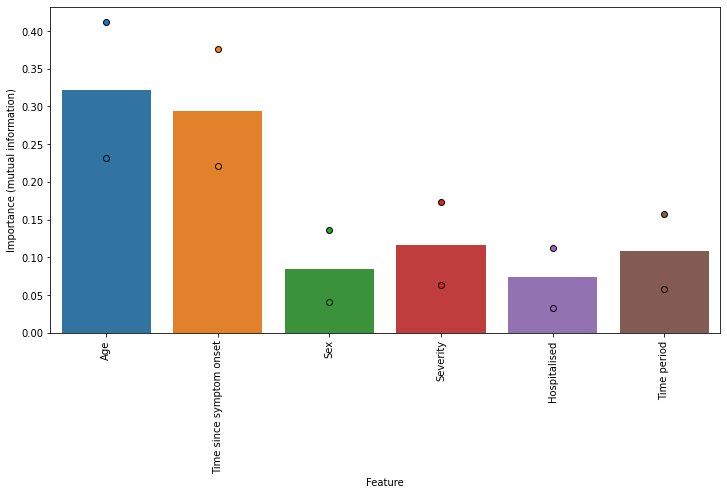

<Figure size 432x288 with 0 Axes>

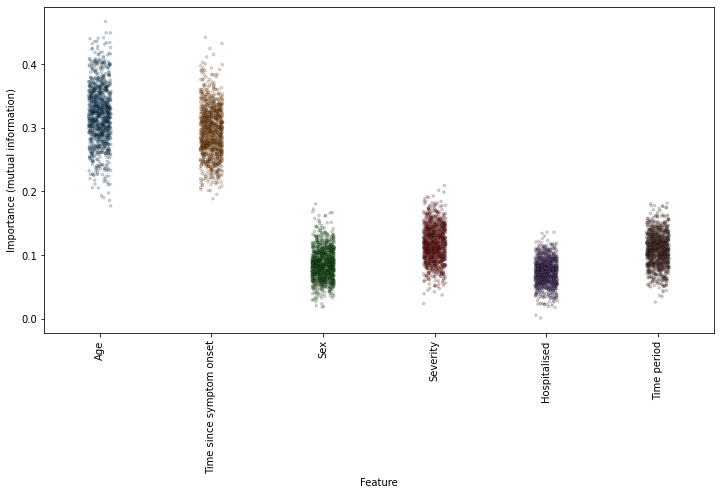

<Figure size 432x288 with 0 Axes>

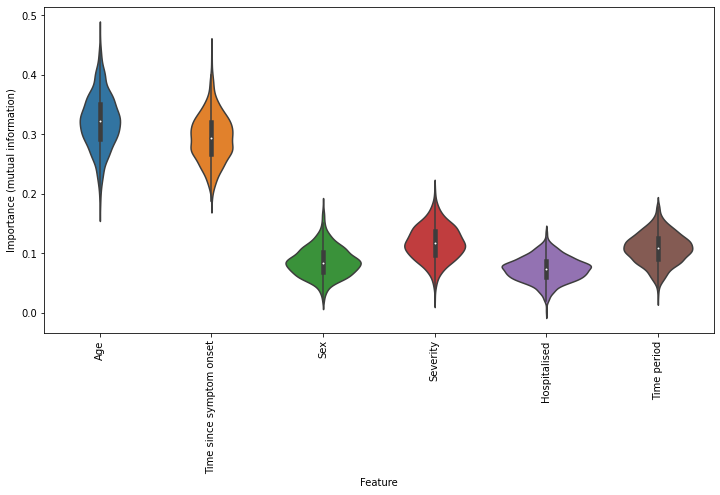




All data, LIPS Average Bridging
Number of samples: 231
[[0.34319937 0.55128094 0.10551969]
 [0.33423174 0.51705412 0.14871415]
 [0.41434075 0.49518769 0.09047157]
 ...
 [0.4135252  0.47159289 0.11488191]
 [0.32376249 0.57637145 0.09986606]
 [0.34845265 0.55740523 0.09414212]]
                    Feature     Score
0  Time since symptom onset  0.497363
1                       Age  0.393354
2                       Sex  0.110734


<Figure size 432x288 with 0 Axes>

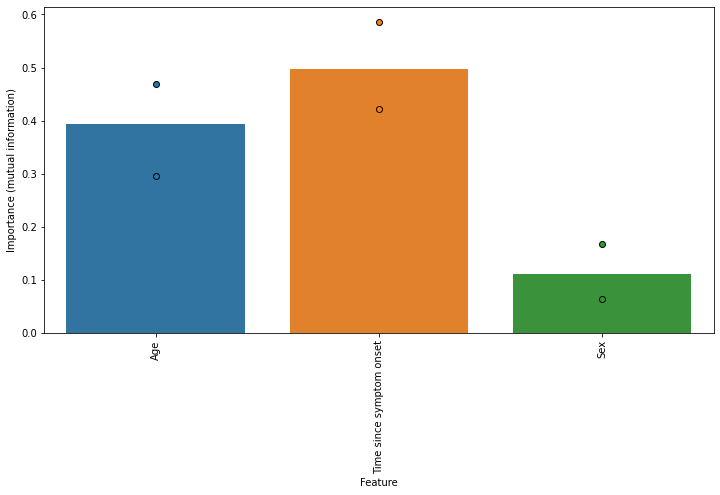

<Figure size 432x288 with 0 Axes>

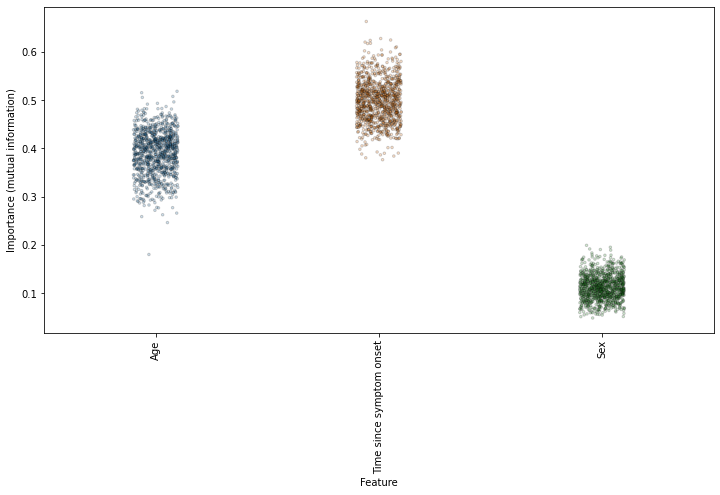

<Figure size 432x288 with 0 Axes>

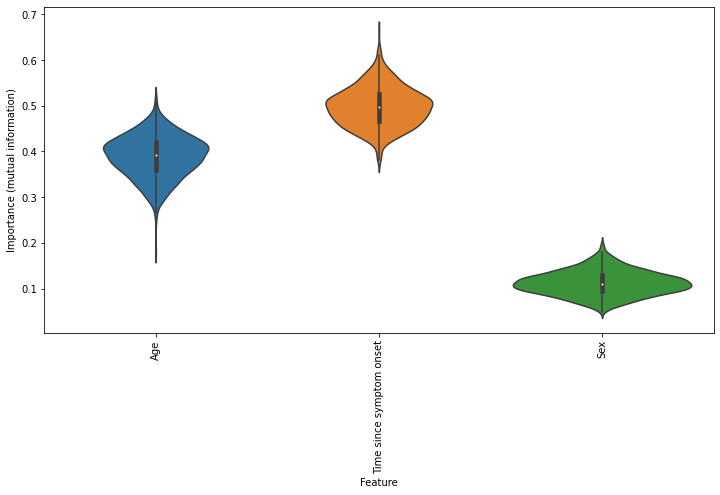




All data, ELISA Spike Pan Norm
Number of samples: 231
[[0.44295171 0.47184189 0.08520639]
 [0.45956351 0.4574443  0.08299219]
 [0.33984109 0.47651262 0.18364629]
 ...
 [0.46388285 0.412985   0.12313214]
 [0.47921244 0.41448817 0.10629939]
 [0.38603164 0.49107592 0.12289244]]
                    Feature     Score
0                       Age  0.443090
1  Time since symptom onset  0.439495
2                       Sex  0.116404


<Figure size 432x288 with 0 Axes>

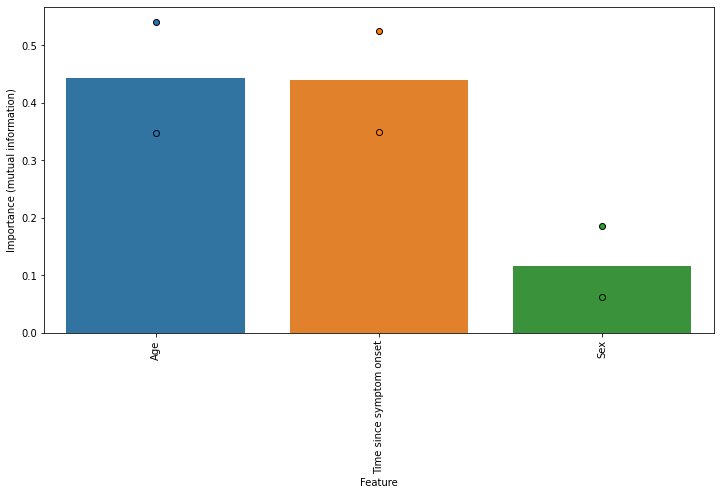

<Figure size 432x288 with 0 Axes>

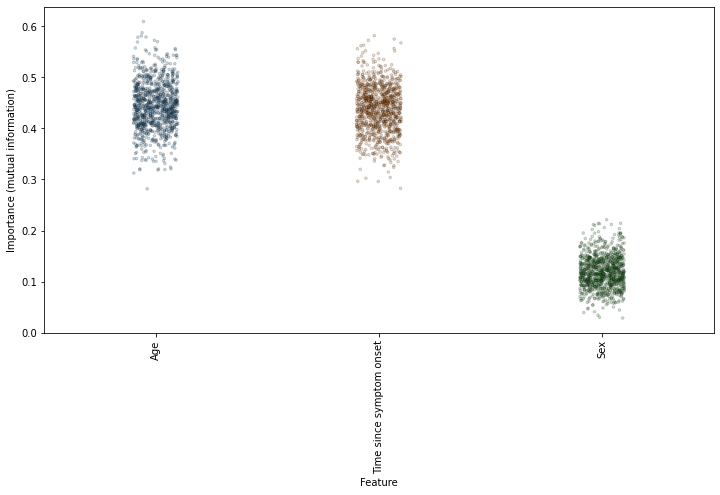

<Figure size 432x288 with 0 Axes>

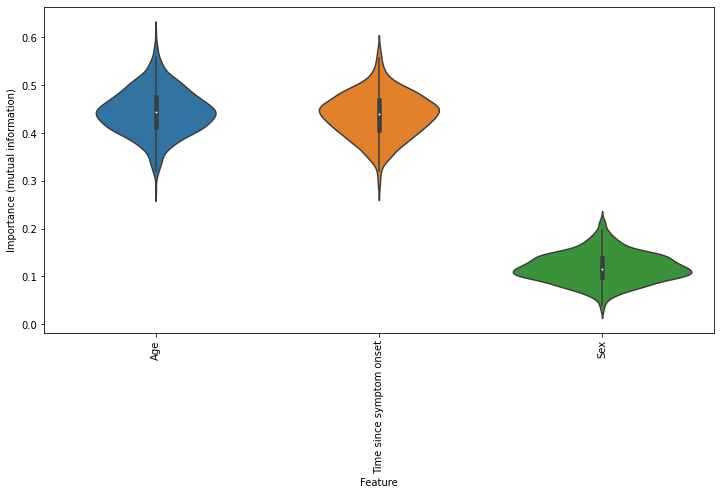

In [102]:
# Calculate assay "importances" via univariate analysis using KBest method, with bootstrapped 95% confidence
# limits. Note such univariate methods assume that the assay results are independent (which is definitely not
# the case!), and thus could pick 2 or more assays as highly important when in fact they all give the same
# information (and so will not work better in combination than individually)
# mutual_info_regression => no assumption of linearity
# (No need for balancing since is now a regression problem)

kbest_score_dfs = {}

for label in ['Threshold', 'Validation', 'All data']:
    for assay in ['LIPS Average Bridging', 'ELISA Spike Pan Norm']:
        print('\n\n\n{}, {}'.format(label, assay))
        if label == 'Validation':
            cols = ['Age', 'Time since symptom onset', 'Sex', 'Severity', 'Hospitalised', 'Time period']
        else:
            cols = ['Age', 'Time since symptom onset', 'Sex']
        ml_x = copy.deepcopy(pos_ml_x_all_dict[label])[cols]
        # Am using the min-max scaled data as the y data for model training - won't affect results
        ml_y = copy.deepcopy(pos_ml_x_all_dict[label])[[assay]]
        
        sex_conv_dict = {'M': 0,
                         'F': 1}
        severity_conv_dict = {'Asymptomatic': 0,
                              'Mild': 1,
                              'Hospitalised, no ventilatory support': 2,
                              'Hospitalised, required ventilatory support/High care': 3,
                              'Died': 4}
        hospitalised_conv_dict = {'No': 0,
                                  'Yes': 1}
        time_period_conv_dict = {'Acute': 0,
                                 'Early Convalescent': 1,
                                 'Late Convalescent': 2}

        # Converts data into suitable format
        # Ages are recorded as strings in threshold dataset
        ages = []
        for age in ml_x['Age']:
            if type(age) == str:
                if '+' in age:
                    ages.append(np.nan)
                elif '-' in age:
                    low_age = float(age.split('-')[0])
                    high_age = float(age.split('-')[1])
                    mean_age = (low_age + high_age) / 2
                    ages.append(int(mean_age))
                else:
                    ages.append(int(float(age)))
            else:
                ages.append(age)
        ml_x['Age'] = ages
        ml_x['Sex'] = [sex_conv_dict[ml_x['Sex'][n]] if type(ml_x['Sex'][n]) == str else np.nan
                       for n in range(ml_x.shape[0])]
        ml_x['Time since symptom onset'] = [float(time) if not np.isnan(time) else np.nan
                                            for time in ml_x['Time since symptom onset']]

        if label == 'Validation':
            ml_x['Severity'] = [severity_conv_dict[ml_x['Severity'][n]]
                                if type(ml_x['Severity'][n]) == str else np.nan
                                for n in range(ml_x.shape[0])]
            ml_x['Hospitalised'] = [hospitalised_conv_dict[ml_x['Hospitalised'][n]]
                                    if type(ml_x['Hospitalised'][n]) == str else np.nan
                                    for n in range(ml_x.shape[0])]
            ml_x['Time period'] = [time_period_conv_dict[ml_x['Time period'][n]]
                                   if type(ml_x['Time period'][n]) == str else np.nan
                                   for n in range(ml_x.shape[0])]

        # Removes NaN values
        comb_df = pd.concat([ml_x, ml_y], axis=1)
        comb_df = comb_df.dropna().reset_index(drop=True)
        ml_x = comb_df[cols]
        ml_y = comb_df[[assay]]
        print('Number of samples: {}'.format(ml_x.shape[0]))
        
        # Scales data
        ml_x_vals = MinMaxScaler().fit_transform(ml_x)
        ml_x = pd.DataFrame(ml_x_vals, columns=ml_x.columns)

        y_scores = np.empty([1000, len(cols)])
        x_swarm_list = []
        y_swarm_list = []
        for i in range(1000):
            random_rows = []
            for n in range(ml_x.shape[0]):
                random_rows.append(random.randint(0, ml_x.shape[0]-1))
            bootstrap_ml_x = copy.deepcopy(ml_x).iloc[random_rows].reset_index(drop=True)
            bootstrap_ml_y = copy.deepcopy(ml_y).iloc[random_rows].reset_index(drop=True)

            model = SelectKBest(score_func=mutual_info_regression, k='all')
            model.fit(X=bootstrap_ml_x.values, y=bootstrap_ml_y[assay])

            total_y = np.sum(model.scores_)
            norm_y = model.scores_ / total_y

            for j, y in np.ndenumerate(norm_y):
                y_scores[i][j] = y
                x_swarm_list.append(ml_x.columns[j])
                y_swarm_list.append(y)

        print(y_scores)
        mut_info_median = np.median(y_scores, axis=0)
        mut_info_lower_conf_limit = np.percentile(y_scores, 2.5, axis=0)
        mut_info_upper_conf_limit = np.percentile(y_scores, 97.5, axis=0)

        kbest_score_df = pd.DataFrame({'Feature': ml_x.columns, 'Score': mut_info_median})
        kbest_score_df = kbest_score_df.sort_values(by=['Score'], axis=0, ascending=False).reset_index(drop=True)
        kbest_score_dfs[label] = kbest_score_df

        print(kbest_score_df)

        plt.clf()
        plt.figure(figsize=(12,6))
        sns.barplot(x=ml_x.columns, y=mut_info_median)
        sns.stripplot(x=ml_x.columns, y=mut_info_lower_conf_limit, edgecolor='k', linewidth=1, s=6, jitter=False)
        sns.stripplot(x=ml_x.columns, y=mut_info_upper_conf_limit, edgecolor='k', linewidth=1, s=6, jitter=False)
        plt.xticks(np.arange(len(ml_x.columns)), ml_x.columns, rotation='vertical')
        plt.xlabel('Feature')
        plt.ylabel('Importance (mutual information)')
        plt.show()

        plt.clf()
        plt.figure(figsize=(12,6))
        sns.stripplot(x=x_swarm_list, y=y_swarm_list, edgecolor='k', linewidth=1, size=2.5, alpha=0.2)
        plt.xticks(np.arange(len(ml_x.columns)), ml_x.columns, rotation='vertical')
        plt.xlabel('Feature')
        plt.ylabel('Importance (mutual information)')
        plt.show()

        plt.clf()
        plt.figure(figsize=(12,6))
        sns.violinplot(x=x_swarm_list, y=y_swarm_list)
        plt.xticks(np.arange(len(ml_x.columns)), ml_x.columns, rotation='vertical')
        plt.xlabel('Feature')
        plt.ylabel('Importance (mutual information)')
        plt.show()

So, univariate feature importance analysis indicates that "age" and "time since symptom onset" provide the most infomation. This result is consistently observed across both the threshold and validation datasets, for both the LIPS assay and the ELISA Spike PanIg assay. The extra features ("severity", "hospitalised" and "time period") available for the validation dataset have lower importance scores, slightly higher than that of "sex" but lower than "age" or "time since symptom onset".

Is interesting that "time period" does not have similar importance to "time since symptom onset", since these two variables are related to each other - this difference demonstrates the extra information available from and hence the greater importance of the continuous variable "time since symptom onset" as compared to the discrete variable "time period". This difference is likely exacerbated by the fact that this is a regression as opposed to a classification problem.




Threshold, LIPS Average Bridging
Number of samples: 43
[0.31026586 0.28513807 0.30603389 0.29839546 0.29555283]
{'n_estimators': 10}


<Figure size 432x288 with 0 Axes>

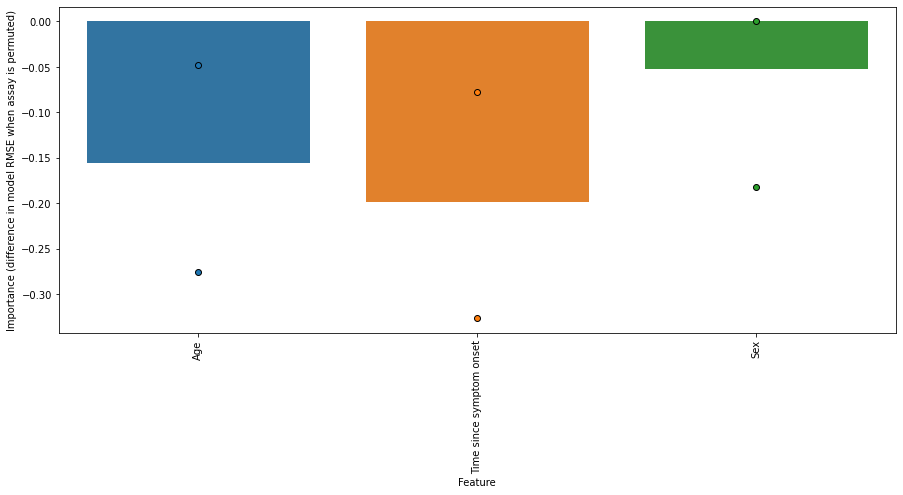

<Figure size 432x288 with 0 Axes>

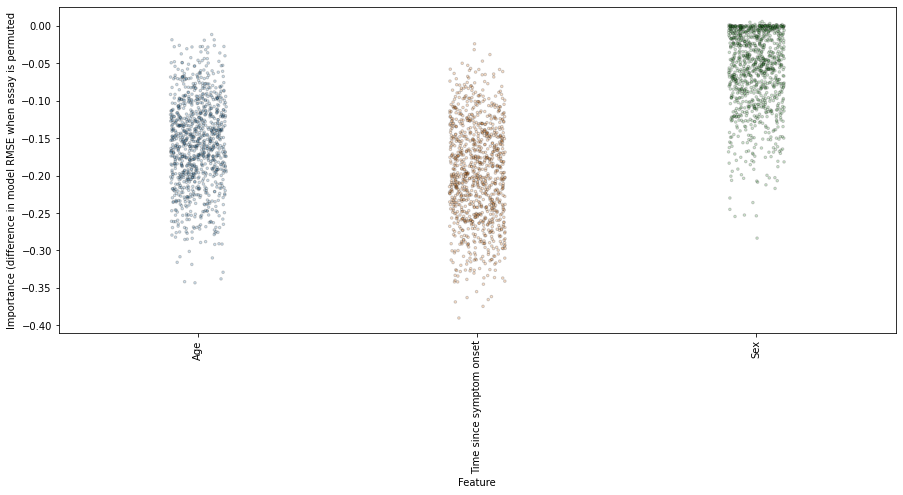

<Figure size 432x288 with 0 Axes>

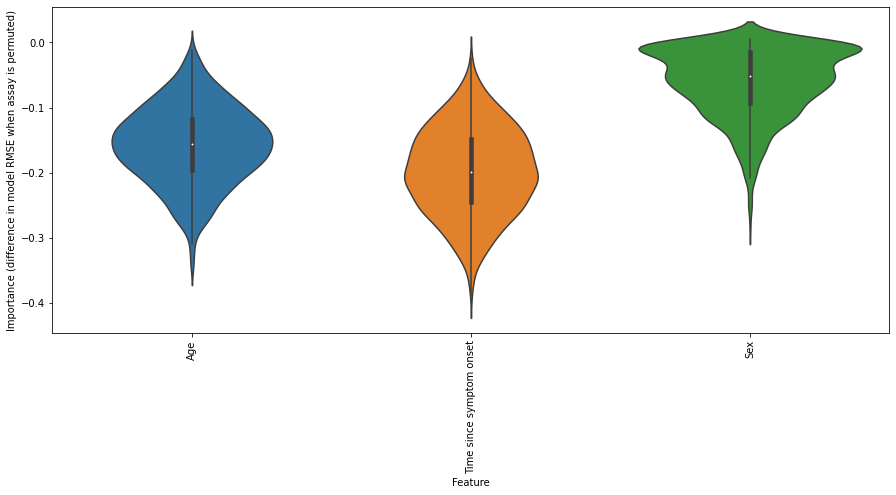




Threshold, ELISA Spike Pan Norm
Number of samples: 43
[0.30917408 0.31091528 0.32099676 0.31458213 0.32168848]
{'n_estimators': 1000}


<Figure size 432x288 with 0 Axes>

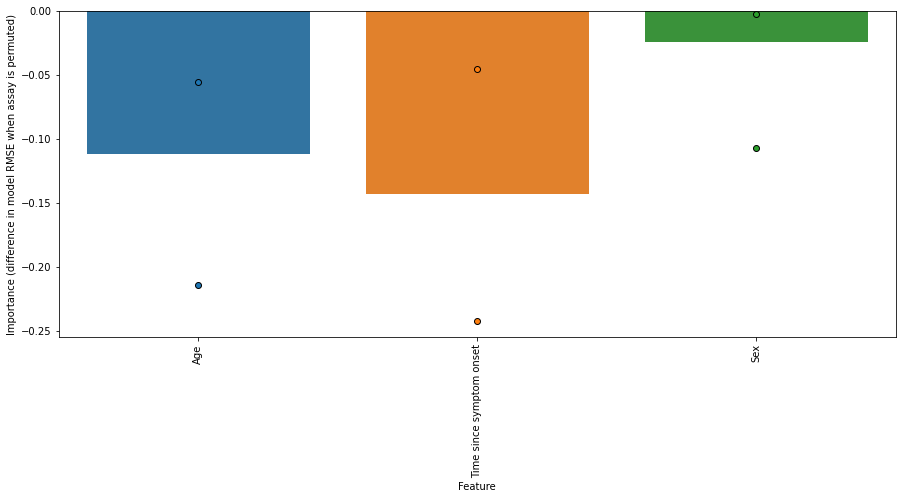

<Figure size 432x288 with 0 Axes>

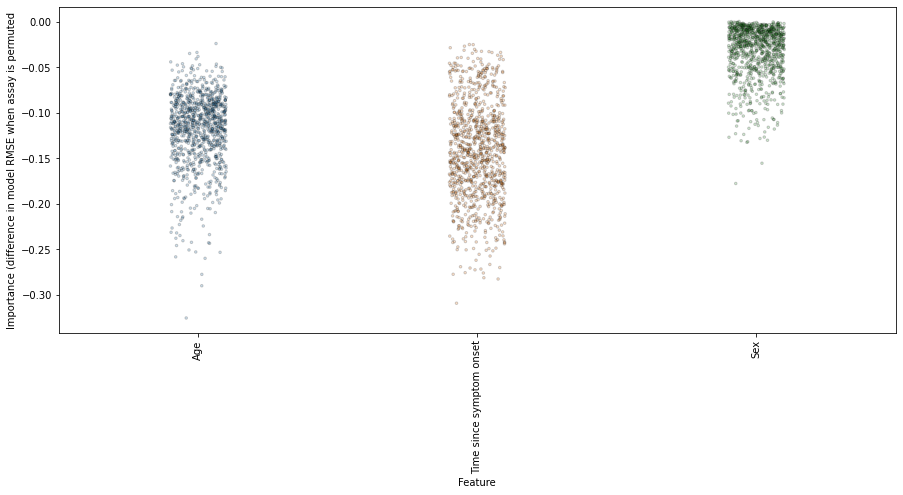

<Figure size 432x288 with 0 Axes>

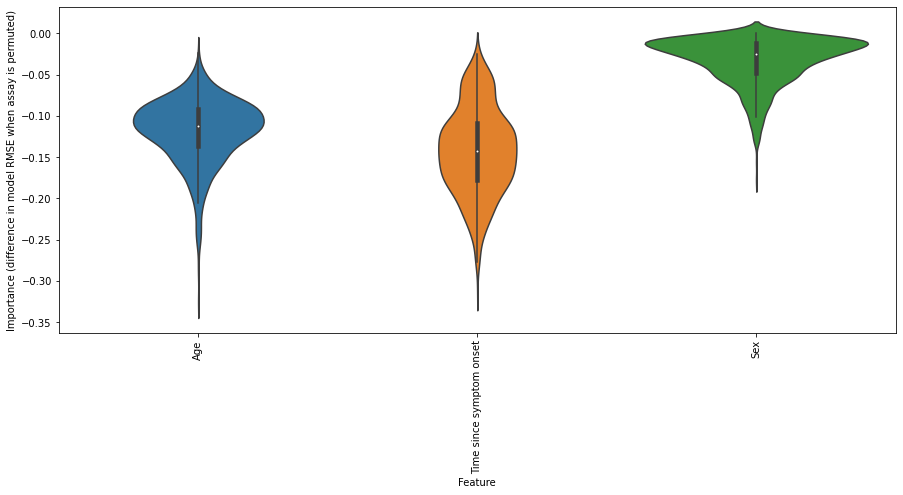




Validation, LIPS Average Bridging
Number of samples: 188
[0.21210928 0.21305542 0.22320901 0.21031739 0.20746021]
{'n_estimators': 100}


<Figure size 432x288 with 0 Axes>

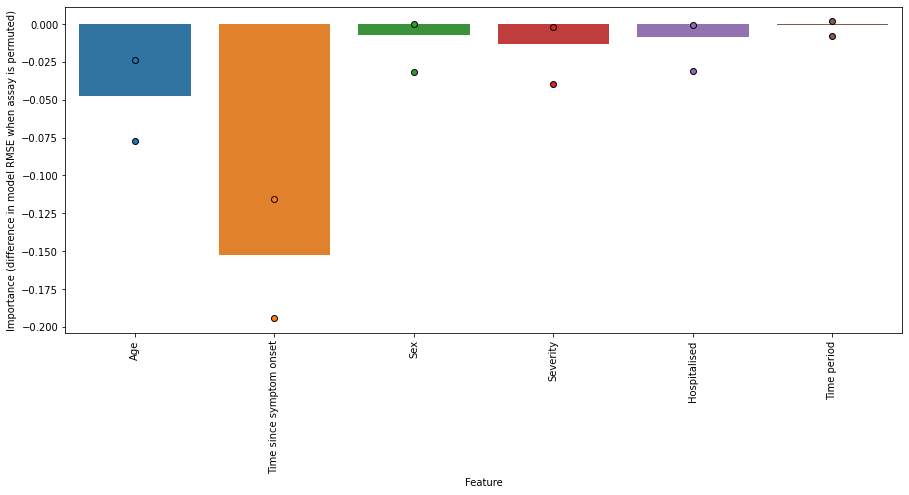

<Figure size 432x288 with 0 Axes>

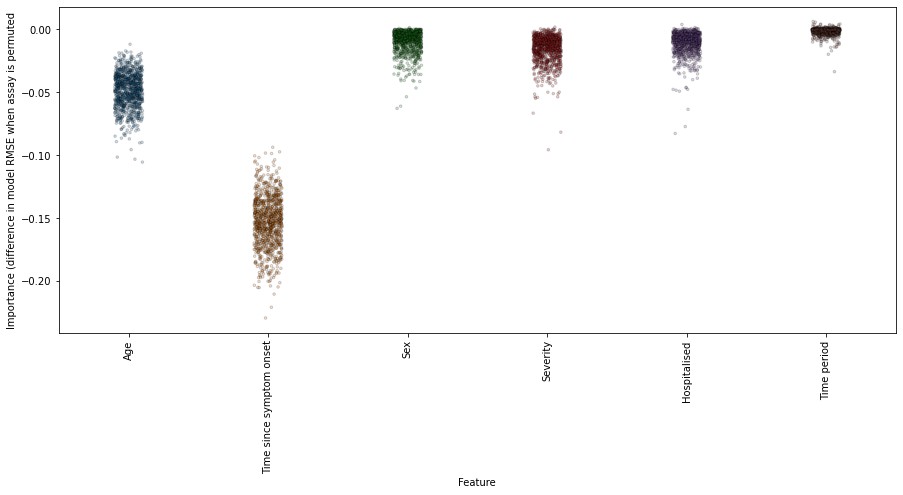

<Figure size 432x288 with 0 Axes>

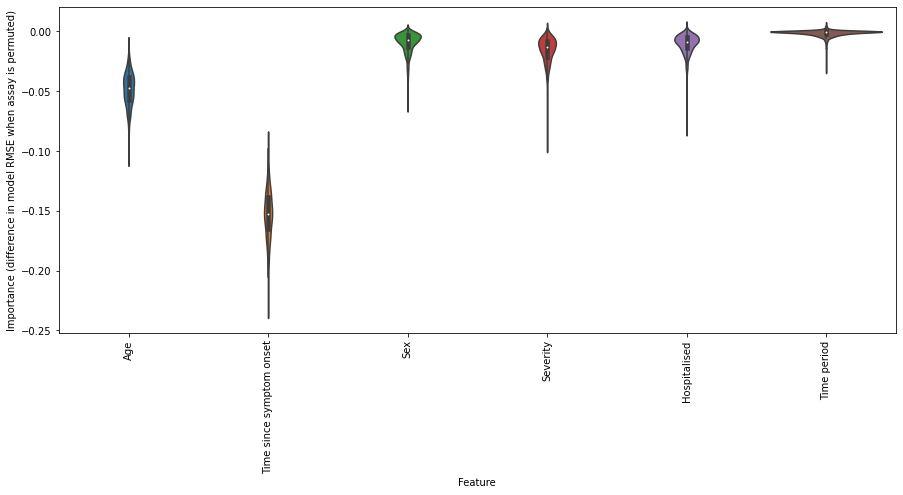




Validation, ELISA Spike Pan Norm
Number of samples: 188
[0.18815762 0.19658506 0.19893338 0.18742844 0.18948064]
{'n_estimators': 100}


<Figure size 432x288 with 0 Axes>

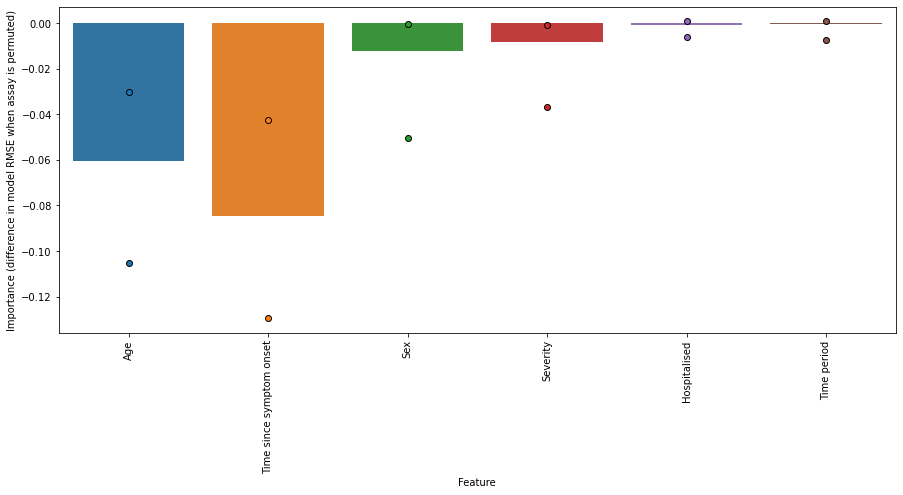

<Figure size 432x288 with 0 Axes>

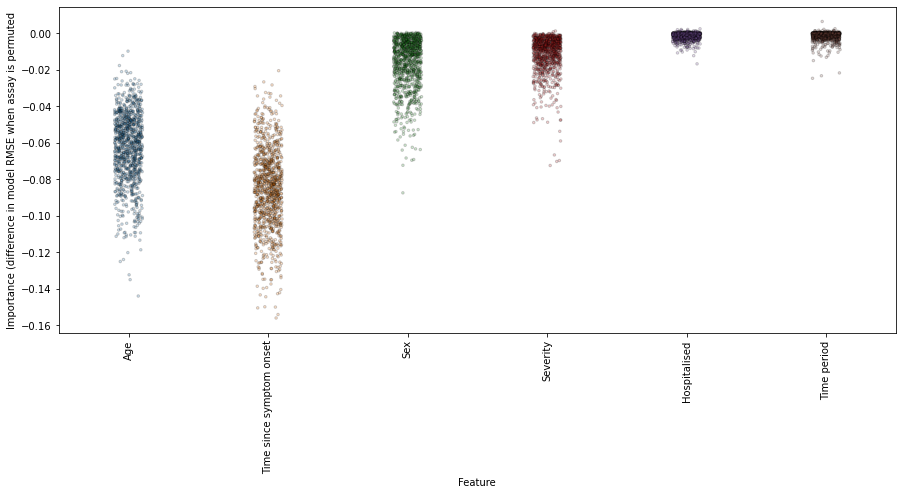

<Figure size 432x288 with 0 Axes>

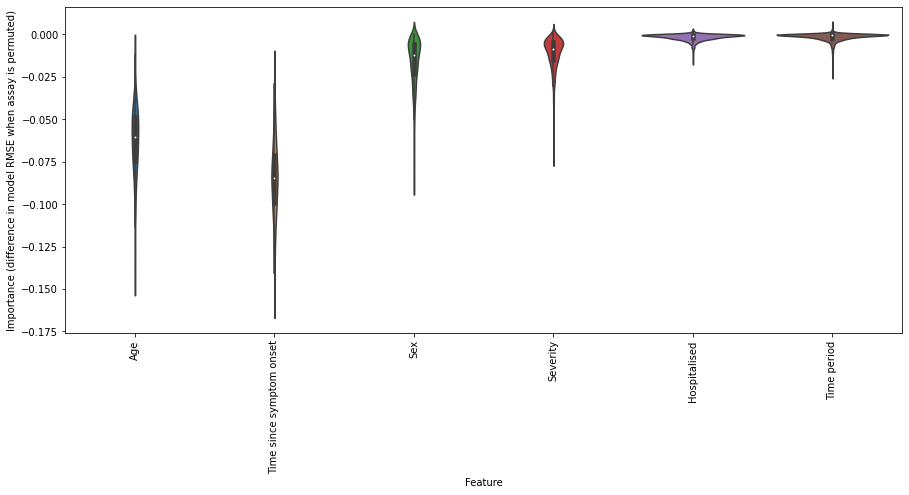




All data, LIPS Average Bridging
Number of samples: 231
[0.1938568  0.20689984 0.19540759 0.19937087 0.20914813]
{'n_estimators': 1000}


<Figure size 432x288 with 0 Axes>

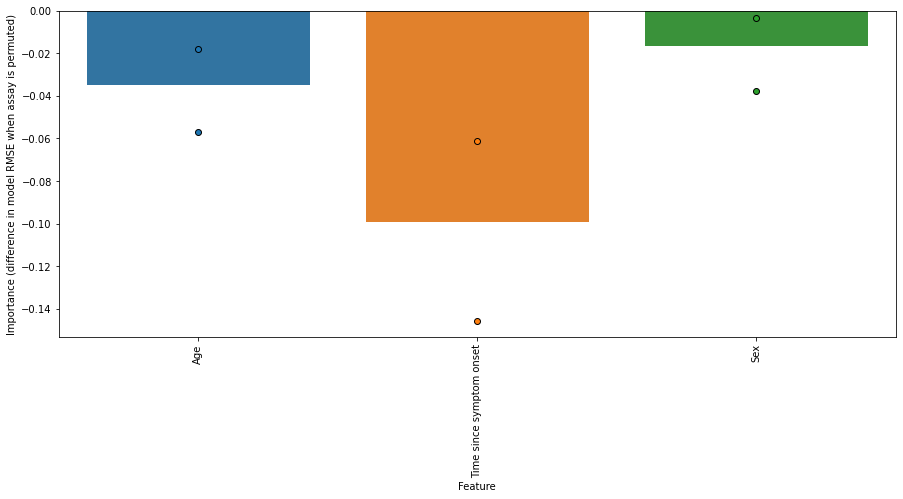

<Figure size 432x288 with 0 Axes>

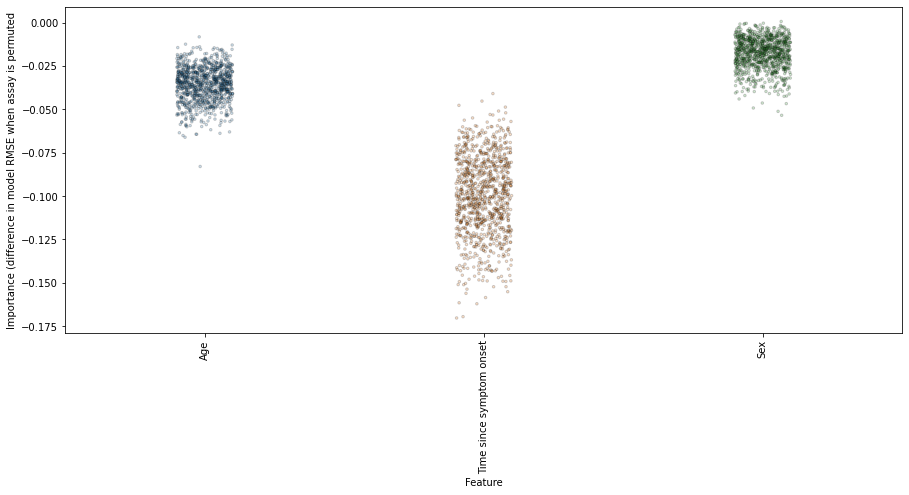

<Figure size 432x288 with 0 Axes>

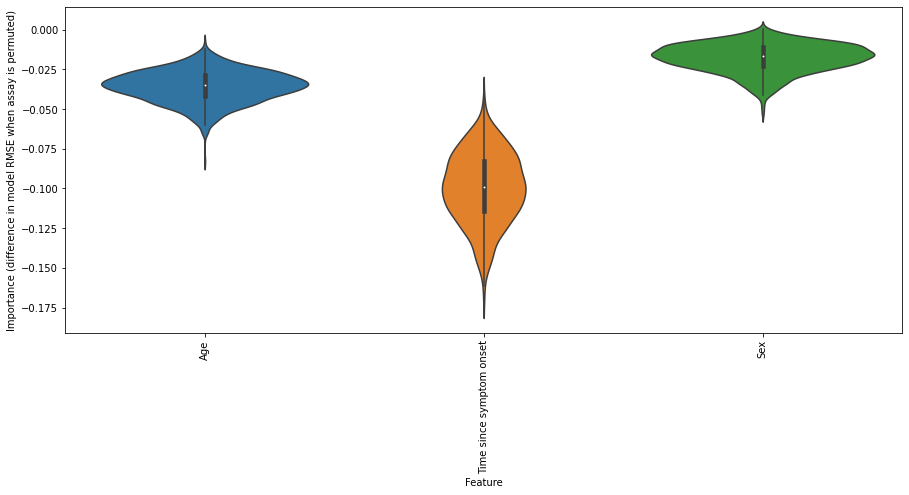




All data, ELISA Spike Pan Norm
Number of samples: 231
[0.18757366 0.19909266 0.19812415 0.19307527 0.19126621]
{'n_estimators': 30}


<Figure size 432x288 with 0 Axes>

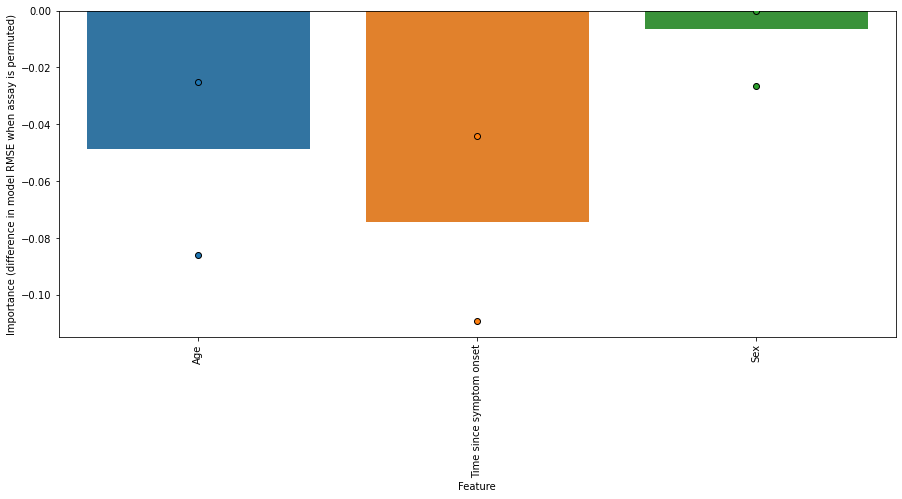

<Figure size 432x288 with 0 Axes>

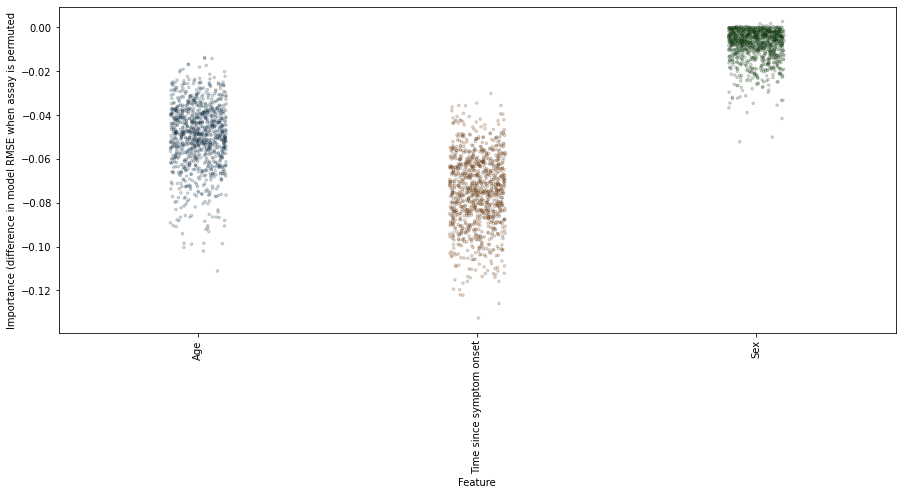

<Figure size 432x288 with 0 Axes>

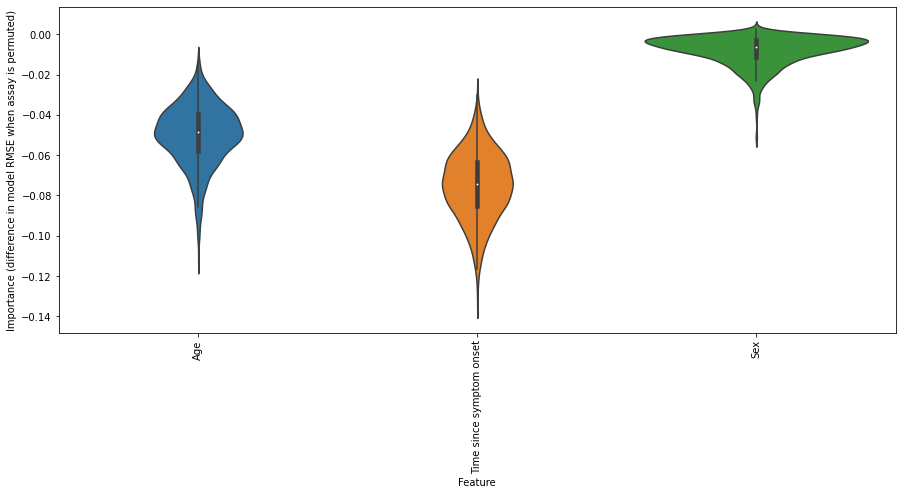

In [103]:
# Use permutation analysis to measure importance of 'Age', 'Sex', 'Severity', 'Hospitalised?', 'Time period' and
# 'Time since symptom onset' when training a regression model to predict "positivity" (measured by signal in
# the LIPS bridging assay / the ELISA Spike PanIg assay)
# (No need for balancing since is now a regression problem)

for label in ['Threshold', 'Validation', 'All data']:
    for assay in ['LIPS Average Bridging', 'ELISA Spike Pan Norm']:
        print('\n\n\n{}, {}'.format(label, assay))
        if label == 'Validation':
            cols = ['Age', 'Time since symptom onset', 'Sex', 'Severity', 'Hospitalised', 'Time period']
        else:
            cols = ['Age', 'Time since symptom onset', 'Sex']

        ml_x = copy.deepcopy(pos_ml_x_all_dict[label])[cols]
        # Am using the min-max scaled data as the y data for model training - won't affect results
        ml_y = copy.deepcopy(pos_ml_x_all_dict[label])[[assay]]

        sex_conv_dict = {'M': 0,
                         'F': 1}
        severity_conv_dict = {'Asymptomatic': 0,
                              'Mild': 1,
                              'Hospitalised, no ventilatory support': 2,
                              'Hospitalised, required ventilatory support/High care': 3,
                              'Died': 4}
        hospitalised_conv_dict = {'No': 0,
                                  'Yes': 1}
        time_period_conv_dict = {'Acute': 0,
                                 'Early Convalescent': 1,
                                 'Late Convalescent': 2}

        # Converts data into suitable format
        # Ages are recorded as strings in threshold dataset
        ages = []
        for age in ml_x['Age']:
            if type(age) == str:
                if '+' in age:
                    ages.append(np.nan)
                elif '-' in age:
                    low_age = float(age.split('-')[0])
                    high_age = float(age.split('-')[1])
                    mean_age = (low_age + high_age) / 2
                    ages.append(int(mean_age))
                else:
                    ages.append(int(float(age)))
            else:
                ages.append(age)
        ml_x['Age'] = ages
        ml_x['Sex'] = [sex_conv_dict[ml_x['Sex'][n]] if type(ml_x['Sex'][n]) == str else np.nan
                       for n in range(ml_x.shape[0])]
        ml_x['Time since symptom onset'] = [float(time) if not np.isnan(time) else np.nan
                                            for time in ml_x['Time since symptom onset']]

        if label == 'Validation':
            ml_x['Severity'] = [severity_conv_dict[ml_x['Severity'][n]]
                                if type(ml_x['Severity'][n]) == str else np.nan
                                for n in range(ml_x.shape[0])]
            ml_x['Hospitalised'] = [hospitalised_conv_dict[ml_x['Hospitalised'][n]]
                                    if type(ml_x['Hospitalised'][n]) == str else np.nan
                                    for n in range(ml_x.shape[0])]
            ml_x['Time period'] = [time_period_conv_dict[ml_x['Time period'][n]]
                                   if type(ml_x['Time period'][n]) == str else np.nan
                                   for n in range(ml_x.shape[0])]

        # Removes NaN values
        comb_df = pd.concat([ml_x, ml_y], axis=1)
        comb_df = comb_df.dropna().reset_index(drop=True)
        ml_x = comb_df[cols]
        ml_y = comb_df[[assay]]
        print('Number of samples: {}'.format(ml_x.shape[0]))
        
        # Scales data
        ml_x_vals = MinMaxScaler().fit_transform(ml_x)
        ml_x = pd.DataFrame(ml_x_vals, columns=ml_x.columns)

        # Use grid search to determine optimal parameters to train model. To ensure the code runs in a reasonable
        # period of time, run gridsearch once for each dataset, rather than for each individual dataset - approx.
        # optimal parameters for entire dataset should also work well for the resampled datasets
        ada_boost = AdaBoostRegressor()
        parameters = {'n_estimators': [10, 30, 100, 300, 1000]}
        rmse = make_scorer(mean_squared_error, squared=False)
        grid_search = GridSearchCV(
            estimator=ada_boost, param_grid=parameters, error_score=np.nan, scoring=rmse
        )
        grid_search.fit(X=ml_x, y=ml_y[assay].tolist())
        print(grid_search.cv_results_['mean_test_score'])
        print(grid_search.best_params_)

        permutation_feature_importances = {}
        for col in cols:
            permutation_feature_importances[col] = ['']*1000

        for n in range(1000):
            copy_ml_x = copy.deepcopy(ml_x)
            copy_ml_y = copy.deepcopy(ml_y)[[assay]]

            # Generates bootstrap sample
            random_rows = []
            for m in range(copy_ml_x.shape[0]):
                random_rows.append(random.randint(0, copy_ml_x.shape[0]-1))
            copy_ml_x = copy_ml_x.iloc[random_rows].reset_index(drop=True)
            copy_ml_y = copy_ml_y.iloc[random_rows].reset_index(drop=True)[assay].tolist()

            # Train model (on all data) with optimal parameters, determine which features are making the
            # greatest contribution to model performance
            ada_boost = AdaBoostRegressor(**grid_search.best_params_)
            ada_boost.fit(copy_ml_x, copy_ml_y)
            rmse = make_scorer(mean_squared_error, squared=False)
            results = permutation_importance(ada_boost, copy_ml_x, copy_ml_y, scoring=rmse, n_jobs=-1)
            importances = results.importances_mean
            for col, importance in enumerate(importances):
                col = ml_x.columns[col]
                permutation_feature_importances[col][n] = importance

        cols_all = []
        permutation_all = []
        permutation_median = []
        permutation_lower_conf_limit = []
        permutation_upper_conf_limit = []
        for col, importances in permutation_feature_importances.items():
            permutation_median.append(np.median(importances))
            permutation_lower_conf_limit.append(np.percentile(importances, 2.5))
            permutation_upper_conf_limit.append(np.percentile(importances, 97.5))
            for importance in importances:
                cols_all.append(col)
                permutation_all.append(importance)

        plt.clf()
        plt.figure(figsize=(15,6))
        sns.barplot(x=cols, y=permutation_median)
        sns.stripplot(x=cols, y=permutation_lower_conf_limit, edgecolor='k', linewidth=1, s=6, jitter=False)
        sns.stripplot(x=cols, y=permutation_upper_conf_limit, edgecolor='k', linewidth=1, s=6, jitter=False)
        plt.xticks(np.arange(len(cols)), cols, rotation='vertical')
        plt.xlabel('Feature')
        plt.ylabel('Importance (difference in model RMSE when assay is permuted)')
        if label == 'All data':
            plt.savefig('AdaBoost_{}_feat_importance_barplot.svg'.format(assay))
        plt.show()

        plt.clf()
        plt.figure(figsize=(15,6))
        sns.stripplot(x=cols_all, y=permutation_all, edgecolor='k', linewidth=1, size=2.5, alpha=0.2)
        plt.xticks(np.arange(len(cols)), cols, rotation='vertical')
        plt.xlabel('Feature')
        plt.ylabel('Importance (difference in model RMSE when assay is permuted')
        if label == 'All data':
            plt.savefig('AdaBoost_{}_feat_importance_stripplot.svg'.format(assay))
        plt.show()

        plt.clf()
        plt.figure(figsize=(15,6))
        sns.violinplot(x=cols_all, y=permutation_all)
        plt.xticks(np.arange(len(cols)), cols, rotation='vertical')
        plt.xlabel('Feature')
        plt.ylabel('Importance (difference in model RMSE when assay is permuted)')
        plt.show()

Permutation analysis indicates that time since symptom onset is the most important feature, followed by age, whereas the importance scores of the other variables are much smaller/negligible. It's unlikely to be a coincidence that these low importance variables are all categorical, whereas the continuous variables (age and time since symptom onset) have higher importance scores. These results are consistent across both the threshold and validation datasets, and in predicting both the LIPS and the ELISA Spike PanIg assay score (even though earlier analysis showed that there is quite a low correlation between the ranks of the positive samples in these assays). 

As mentioned above, the additional features available for the validation dataset do not have high importance scores. I would be interested however to see how the importance scores of these variables would change if they were converted to a continuous scale where possible - e.g. compare the importance scores of "time since symptom onset" and "time period", which are effectively the same variable, except that the former is continuous and the latter is discrete.




Threshold, LIPS Average Bridging
Number of samples: 43
{'n_estimators': 100}
RMSE:   0.22314860772205813
{'n_estimators': 10}
RMSE:   0.21595392203121622
{'n_estimators': 30}
RMSE:   0.4592570041484334
{'n_estimators': 30}
RMSE:   0.3018310820896036
{'n_estimators': 300}
RMSE:   0.49449834551296
Pearson's correlation coefficient: (-0.14898542958854238, 0.34033153875633715)


<Figure size 432x288 with 0 Axes>

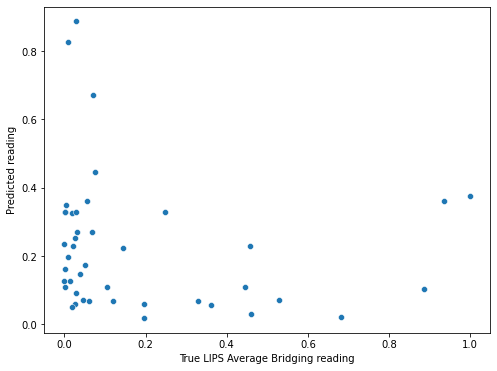




Threshold, ELISA Spike Pan Norm
Number of samples: 43
{'n_estimators': 10}
RMSE:   0.14063307263077945
{'n_estimators': 100}
RMSE:   0.3782723825833767
{'n_estimators': 1000}
RMSE:   0.20501946148892597
{'n_estimators': 10}
RMSE:   0.37187792596011576
{'n_estimators': 30}
RMSE:   0.4294700557200841
Pearson's correlation coefficient: (-0.20473509768761466, 0.18784603852035645)


<Figure size 432x288 with 0 Axes>

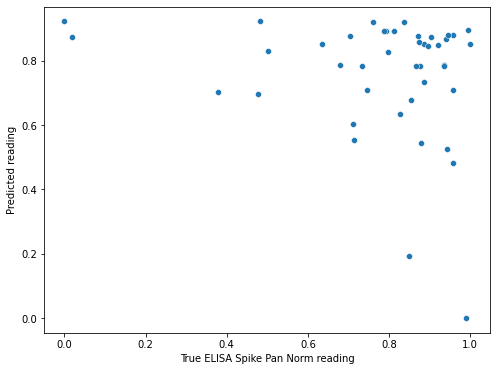




Validation, LIPS Average Bridging
Number of samples: 188
{'n_estimators': 300}
RMSE:   0.438539074065297
{'n_estimators': 100}
RMSE:   0.31616297099414736
{'n_estimators': 300}
RMSE:   0.24935007179545782
{'n_estimators': 100}
RMSE:   0.19289948451074912
{'n_estimators': 10}
RMSE:   0.3628876475533501
Pearson's correlation coefficient: (-0.02514731664889239, 0.7319316019912393)


<Figure size 432x288 with 0 Axes>

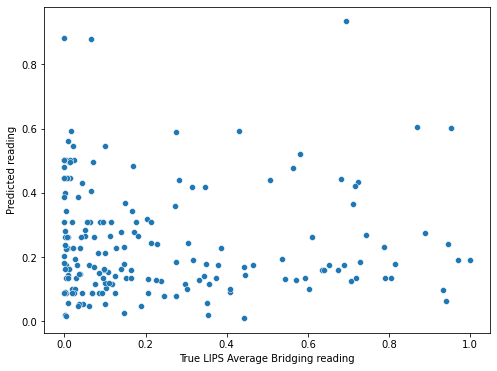




Validation, ELISA Spike Pan Norm
Number of samples: 188
{'n_estimators': 300}
RMSE:   0.2510912591714323
{'n_estimators': 1000}
RMSE:   0.20727536872541102
{'n_estimators': 300}
RMSE:   0.24503489645922985
{'n_estimators': 10}
RMSE:   0.1755190518874413
{'n_estimators': 10}
RMSE:   0.3560788604283897
Pearson's correlation coefficient: (-0.19298359416193714, 0.00796853482176062)


<Figure size 432x288 with 0 Axes>

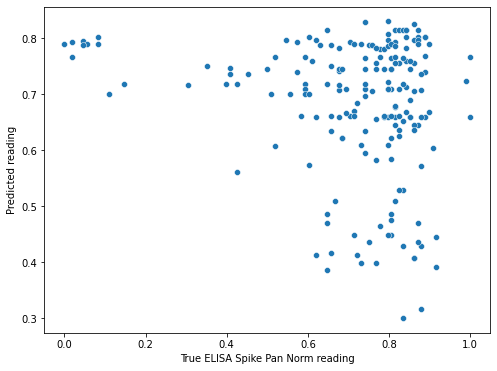




All data, LIPS Average Bridging
Number of samples: 231
{'n_estimators': 1000}
RMSE:   0.23725172310305268
{'n_estimators': 100}
RMSE:   0.2639541875669822
{'n_estimators': 1000}
RMSE:   0.21241964494726398
{'n_estimators': 1000}
RMSE:   0.16524164192252008
{'n_estimators': 1000}
RMSE:   0.22310779219202437
Pearson's correlation coefficient: (0.1988150592353897, 0.0023997974669324115)


<Figure size 432x288 with 0 Axes>

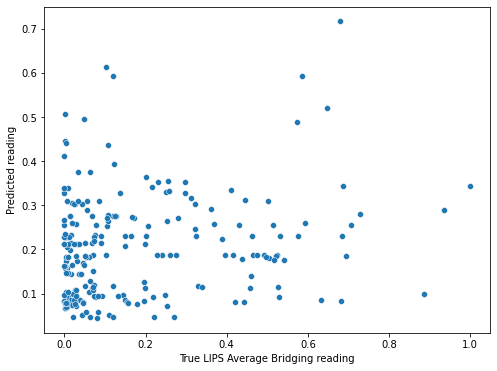




All data, ELISA Spike Pan Norm
Number of samples: 231
{'n_estimators': 100}
RMSE:   0.1955663594570458
{'n_estimators': 30}
RMSE:   0.27414078077597437
{'n_estimators': 300}
RMSE:   0.23063999791577966
{'n_estimators': 1000}
RMSE:   0.1927807506199673
{'n_estimators': 10}
RMSE:   0.2944697216058916
Pearson's correlation coefficient: (-0.038712361155222766, 0.5582756722809853)


<Figure size 432x288 with 0 Axes>

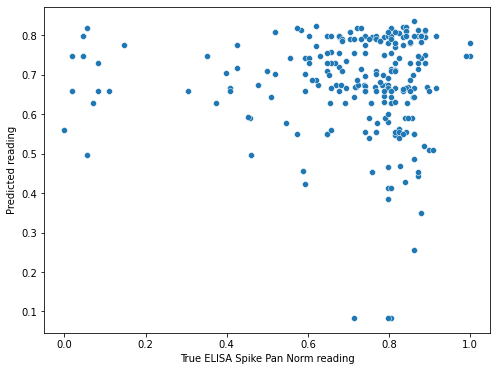

<Figure size 432x288 with 0 Axes>

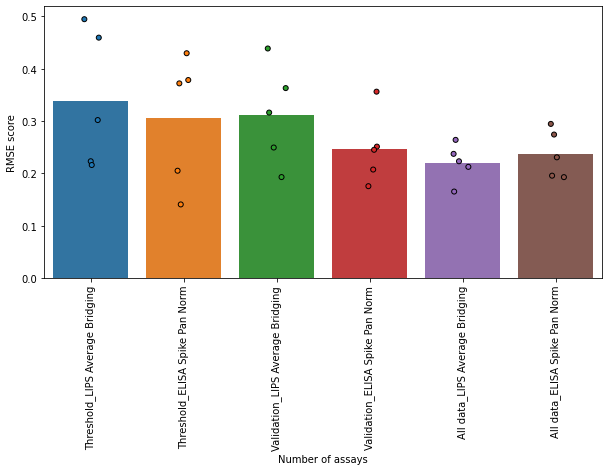

In [104]:
# Train model with these (non-assay) variables, see how well can predict "positivity" (as measured by LIPS/
# ELISA Spike PanIg score). Draw scatter plot of true LIPS/ELISA scores vs. predictions to see how well model
# performs, as well as calculating RMSE.

model_rmse_scores = {}

for label in ['Threshold', 'Validation', 'All data']:
    for assay in ['LIPS Average Bridging', 'ELISA Spike Pan Norm']:
        print('\n\n\n{}, {}'.format(label, assay))
        model_rmse_scores['{}_{}'.format(label, assay)] = []

        if label == 'Validation':
            cols = ['Age', 'Time since symptom onset', 'Sex', 'Severity', 'Hospitalised', 'Time period']
        else:
            cols = ['Age', 'Time since symptom onset', 'Sex']

        # Am using the min-max scaled data as the y data for model training - won't affect results
        ml_x = copy.deepcopy(pos_ml_x_all_dict[label])[cols]
        ml_y = copy.deepcopy(pos_ml_x_all_dict[label])[[assay]]

        sex_conv_dict = {'M': 0,
                         'F': 1}
        severity_conv_dict = {'Asymptomatic': 0,
                              'Mild': 1,
                              'Hospitalised, no ventilatory support': 2,
                              'Hospitalised, required ventilatory support/High care': 3,
                              'Died': 4}
        hospitalised_conv_dict = {'No': 0,
                                  'Yes': 1}
        time_period_conv_dict = {'Acute': 0,
                                 'Early Convalescent': 1,
                                 'Late Convalescent': 2}

        # Converts data into suitable format
        # Ages are recorded as strings in threshold dataset
        ages = []
        for age in ml_x['Age']:
            if type(age) == str:
                if '+' in age:
                    ages.append(np.nan)
                elif '-' in age:
                    low_age = float(age.split('-')[0])
                    high_age = float(age.split('-')[1])
                    mean_age = (low_age + high_age) / 2
                    ages.append(int(mean_age))
                else:
                    ages.append(int(float(age)))
            else:
                ages.append(age)
        ml_x['Age'] = ages
        ml_x['Sex'] = [sex_conv_dict[ml_x['Sex'][n]] if type(ml_x['Sex'][n]) == str else np.nan
                       for n in range(ml_x.shape[0])]
        ml_x['Time since symptom onset'] = [float(time) if not np.isnan(time) else np.nan
                                            for time in ml_x['Time since symptom onset']]

        if label == 'Validation':
            ml_x['Severity'] = [severity_conv_dict[ml_x['Severity'][n]]
                                if type(ml_x['Severity'][n]) == str else np.nan
                                for n in range(ml_x.shape[0])]
            ml_x['Hospitalised'] = [hospitalised_conv_dict[ml_x['Hospitalised'][n]]
                                    if type(ml_x['Hospitalised'][n]) == str else np.nan
                                    for n in range(ml_x.shape[0])]
            ml_x['Time period'] = [time_period_conv_dict[ml_x['Time period'][n]]
                                   if type(ml_x['Time period'][n]) == str else np.nan
                                   for n in range(ml_x.shape[0])]

        # Removes NaN values
        comb_df = pd.concat([ml_x, ml_y], axis=1)
        comb_df = comb_df.dropna().reset_index(drop=True)
        ml_x = comb_df[cols]
        ml_y = comb_df[[assay]]
        print('Number of samples: {}'.format(ml_x.shape[0]))
        
        kf = KFold(n_splits=5)
        splits = kf.split(X=ml_x, y=ml_y)

        obs = []
        exp = []
        for split in splits:
            train_x = ml_x.iloc[list(split[0])].reset_index(drop=True)
            test_x = ml_x.iloc[list(split[1])].reset_index(drop=True)
            train_y = ml_y.iloc[list(split[0])].reset_index(drop=True)[assay].tolist()
            test_y = ml_y.iloc[list(split[1])].reset_index(drop=True)[assay].tolist()
            
            # Scales data
            train_x_vals = MinMaxScaler().fit_transform(train_x)
            test_x_vals = MinMaxScaler().fit_transform(test_x)
            train_x = pd.DataFrame(train_x_vals, columns=train_x.columns)
            test_x = pd.DataFrame(test_x_vals, columns=test_x.columns)

            # Grid search to find optimal parameters
            ada_boost = AdaBoostRegressor()
            parameters = {'n_estimators': [10, 30, 100, 300, 1000]}
            rmse = make_scorer(mean_squared_error, squared=False)
            grid_search = GridSearchCV(
                estimator=ada_boost, param_grid=parameters, error_score=np.nan, scoring=rmse
            )
            grid_search.fit(X=train_x, y=train_y)
            print(grid_search.best_params_)

            # Train model with the selected parameters and assess model performance
            ada_boost = AdaBoostRegressor(**grid_search.best_params_)
            ada_boost.fit(train_x, train_y)
            predictions = ada_boost.predict(X=test_x)
            rmse_score = mean_squared_error(y_true=test_y, y_pred=predictions, squared=False)
            print('RMSE:   {}'.format(rmse_score))
            model_rmse_scores['{}_{}'.format(label, assay)].append(rmse_score)
            obs += test_y
            exp += list(predictions)
        correlation_coefficient = pearsonr(obs, exp)
        print('Pearson\'s correlation coefficient: {}'.format(correlation_coefficient))
        plt.clf()
        plt.figure(figsize=(8,6))
        sns.scatterplot(x=obs, y=exp)
        plt.xlabel('True {} reading'.format(assay))
        plt.ylabel('Predicted reading')
        if label == 'All data':
            plt.savefig('AdaBoost_{}_obs_vs_exp.svg'.format(assay))
        plt.show()

x = []
y = []
x_mean = []
y_mean = []
for assay in model_rmse_scores.keys():
    rmse_scores = []
    for rmse_score in model_rmse_scores[assay]:
        x.append(assay)
        y.append(rmse_score)
        rmse_scores.append(rmse_score)
    x_mean.append(assay)
    y_mean.append(np.mean(rmse_scores))

plt.clf()
plt.figure(figsize=(10,5))
sns.barplot(x=x_mean, y=y_mean)
sns.stripplot(x=x, y=y, edgecolor='k', linewidth=1)
plt.xlabel('Number of assays')
plt.ylabel('RMSE score')
plt.xticks(rotation=90)
plt.show()

So, can see that the non-assay features do a pretty poor job at predicting the reading a sample is likely to give on either of the assays. More data leads to a slight improvement in RMSE score, however the associated scatter plots demonstrate that the predictions are still poor. This likely explains the similar importance scores of the different features for both the LIPS and ELISA Spike PanIg assays even though the correlation between the scores of the positive samples across these two assays is low. The additional variables available for the validation dataset don't provide any improvement in prediction scores, which as described above is likely because they are all categorical rather than continuous variables. As an aside, need to bear in mind imbalances present in the dataset, and correlation vs. causation - e.g. is difficult to know whether in general older people are producing higher responses because they are older or because they are more severely ill, etc.